# load data

In [1]:
library(broom)
library(scales)
library(stringr)
library(arrow)
library(survival)
library(tidyr)
library(dplyr)
library(haven)
library(reshape2)
library(tidyverse)
library(data.table)
library(lubridate)
library(ggplot2)

Warning message:
“package ‘arrow’ was built under R version 4.4.1”

Attaching package: ‘arrow’


The following object is masked from ‘package:utils’:

    timestamp



Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union



Attaching package: ‘reshape2’


The following object is masked from ‘package:tidyr’:

    smiths


── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ forcats   1.0.0     ✔ purrr     1.0.2
✔ ggplot2   3.5.1     ✔ readr     2.1.5
✔ lubridate 1.9.3     ✔ tibble    3.2.1
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ readr::col_factor()   masks scales::col_factor()
✖ purrr::discard()      masks scales::discard()
✖ lubridate::duration() masks arrow::duration()
✖ dplyr::filter()       masks stats::filter()
✖ dplyr::lag()          masks stats::lag()
ℹ Use the conf

In [2]:
score_kz <- fread("sscore1206_All_combined.csv")

In [3]:
x <- load("UKB_data_all_1024.Rdata")
x

[1] "data_all_pheno_cox2"

In [4]:
data_all_pheno_cox2 <- data_all_pheno_cox2 %>%
  select(-c("Kienb\xf6ck's disease of adults*", "time_Kienb\xf6ck's disease of adults*"))

In [5]:
data_all_pheno_cox2 <- data_all_pheno_cox2 %>%
  mutate_at(vars(50:2444), ~ replace_na(., 0))

In [6]:
head(data_all_pheno_cox2)

ID_VUMC,min_date,baseline_age,age2,death,tto_death,CAD_death,cancer_death,infection_death,main_cause_of_death,⋯,mca_status,chip,surv_Sepsis,surv_SIRS,SIRS,surv_cll,cll,cf_max,cf_cat,mca_highrisk
<int>,<IDate>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<chr>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<fct>
1000013,2007-11-08,48,2304,0,5004,0,0,0,,⋯,0,0,13.70021,13.70021,0,13.70021,0,NA,0,0
1000024,2009-11-30,54,2916,0,4251,0,0,0,,⋯,0,0,11.63860,11.63860,0,11.63860,0,NA,0,0
1000036,2008-04-12,67,4489,0,4848,0,0,0,,⋯,0,0,13.27310,13.27310,0,13.27310,0,NA,0,0
1000048,2007-08-07,60,3600,0,5097,0,0,0,,⋯,0,0,13.95483,13.95483,0,13.95483,0,NA,0,0
1000055,2009-01-29,40,1600,0,4556,0,0,0,,⋯,0,0,12.47365,12.47365,0,12.47365,0,NA,0,0
1000067,2008-04-12,64,4096,0,4848,0,0,0,,⋯,0,0,13.27310,13.27310,0,13.27310,0,NA,0,0


In [7]:
fwrite(data_all_pheno_cox2, "data_all_pheno_coxUKB.tsv", sep = "\t", quote = FALSE)

In [8]:
system("gsutil cp data_all_pheno_coxUKB.tsv gs://bicklab-main-storage/Users/Kun_Zhao")

In [2]:
data_all_pheno_cox2 <- fread("data_all_pheno_coxUKB.tsv")

In [6]:
batch_logistic_regression <- function(data, snp_list, outcome, covariates = NULL) {
  # 初始化结果列表
  results <- list()
  
  # 基础公式部分
  base_formula <- paste0(outcome, " ~ ")
  
  # 循环每个 SNP
  for (snp in snp_list) {
    # 构建公式
    if (!is.null(covariates) && length(covariates) > 0) {
      formula <- as.formula(paste0(base_formula, snp, " + ", paste(covariates, collapse = " + ")))
    } else {
      formula <- as.formula(paste0(base_formula, snp))
    }
    
    # 打印公式以调试
    print(formula)
    
    # 尝试运行模型
    tryCatch({
      logistic_model <- glm(formula, data = data, family = binomial)
      summary_model <- summary(logistic_model)
      
      # 提取模型结果
      coef <- summary_model$coefficients[snp, "Estimate"]
      se <- summary_model$coefficients[snp, "Std. Error"]
      p_value <- summary_model$coefficients[snp, "Pr(>|z|)"]
      ci_lower <- exp(coef - 1.96 * se)
      ci_upper <- exp(coef + 1.96 * se)
      or <- exp(coef)
      
      # 保存结果
      results[[snp]] <- data.frame(
        SNP = snp,
        Beta = coef,
        OR = or,
        SE = se,
        CI_Lower = ci_lower,
        CI_Upper = ci_upper,
        P_Value = p_value
      )
    }, error = function(e) {
      warning(paste("Error in model for SNP:", snp, "- Skipping."))
    })
  }
  
  # 合并所有结果为一个数据框
  results_df <- do.call(rbind, results)
  return(results_df)
}

In [7]:
pro_list <- colnames(score_kz)[-1]

In [8]:
summary(score_kz$Interleukin18_receptor_1)
summary(score_kz$Interleukin18binding_protein)

    Min.  1st Qu.   Median     Mean  3rd Qu.     Max. 
-1.10510 -0.33552 -0.11862 -0.03028  0.31227  1.14434 

    Min.  1st Qu.   Median     Mean  3rd Qu.     Max. 
0.000000 0.000000 0.000000 0.008464 0.000000 1.688880 

# mCA & CLL

In [6]:
data_mca <- filter(data_all_pheno_cox2, data_all_pheno_cox2$mca_status==1)

In [7]:
data_mca <- data_mca[,c("ID_VUMC","cll","surv_cll","baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")]

In [8]:
data_mca_protein <- merge(data_mca, score_kz, by.x = "ID_VUMC" , by.y = "ID", all.x = T)

In [9]:
head(data_mca_protein)

ID_VUMC,cll,surv_cll,baseline_age,age2,genetic_sex,smoking_0,PC1,PC2,PC3,⋯,Zinc_finger_protein_276,Zinc_finger_protein_566,Zinc_finger_protein_774,Zinc_finger_protein_843,Zinc_finger_protein_SNAI2,Zinc_fingers_and_homeoboxes_protein_3,Zincalpha2glycoprotein,Zona_pellucida_spermbinding_protein_4,Zymogen_granule_membrane_protein_16,Zymogen_granule_protein_16_homolog_B
<int>,<dbl>,<dbl>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1000123,0,12.20260,64,4096,1,1,-12.59330,0.38201,1.630640,⋯,0.0544500,-0.0575937,0.388269,0.263718,0.000000,-0.361547,-0.2476830,-0.1012920,2.845382,0.17684000
1000386,0,12.18617,69,4761,1,1,-8.45409,5.01144,-2.561640,⋯,-0.0088700,-0.0985706,0.194135,0.175662,-0.637567,-0.111870,0.0838800,0.2595747,2.487199,-0.20572600
1001017,0,12.19165,64,4096,0,0,-11.27850,5.25642,-0.645689,⋯,-0.0093660,-0.1689250,0.386752,0.175662,0.000000,-0.357953,-0.0822713,0.0800500,2.441558,-0.00572086
1001112,0,11.66324,52,2704,1,0,-13.54070,2.31033,-4.348640,⋯,-0.0808859,-0.0610772,0.323561,0.175662,0.000000,-0.181612,-0.3991580,-0.2175332,2.782569,0.00240522
1001690,0,12.39151,69,4761,0,0,-14.05040,1.87039,-1.876440,⋯,0.1904018,-0.0409768,0.194135,0.351323,0.000000,-0.329190,0.0421819,0.1965997,2.685056,0.22636700
1001783,0,12.61602,59,3481,0,0,-13.87300,5.05959,-1.236010,⋯,-0.1702669,-0.0490928,0.388269,0.351323,0.000000,-0.353788,-0.1857315,-0.1051986,2.845382,0.31214100


In [56]:
data_mca_protein <- filter(data_mca_protein, data_mca_protein$surv_cll > 0)

In [57]:
dim(data_mca_protein)

[1] 15012  2085

In [60]:
table(data_mca_protein$cll, useNA= "always")


    0     1  <NA> 
14898   114     0 

In [13]:
#association

In [45]:
length(pro_list)

[1] 2073

In [21]:
logistic_mca <- batch_logistic_regression(
  data = data_mca_protein,
  snp_list = pro_list,
  outcome = "cll",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")
)
logistic_mca

cll ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ X25oligoadenylate_synthase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ X26S_proteasome_nonATPase_regulatory_subunit_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x580cba598290>
cll ~ X26S_proteasome_nonATPase_regulatory_subunit_9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x580cba598290>
cll ~ X2phosphoxylose_phosphatase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environmen

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


cll ~ Chondroitin_sulfate_Nacetylgalactosaminyltransferase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Chordin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Chordinlike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Chordinlike_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Choriogonadotropin_subunit_beta_variant_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x580cba598290>
cll ~ Chromobox_protein_homolog_5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Chromobox_protein_homolog_7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


cll ~ DnaJ_homolog_subfamily_B_member_14 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ DnaJ_homolog_subfamily_B_member_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ DnaJ_homolog_subfamily_B_member_9 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ DnaJ_homolog_subfamily_C_member_10 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ DnaJ_homolog_subfamily_C_member_17 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ DnaJ_homolog_subfamily_C_member_30 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ DNARNAbinding_protein_KIN17 + baseline_age + age2 + genetic_sex + 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


cll ~ Grobetagamma + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Group_10_secretory_phospholipase_A2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Group_IIE_secretory_phospholipase_A2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Group_XIIB_secretory_phospholipase_A2like_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x580cba598290>
cll ~ Growth_arrest_and_DNA_damageinducible_proteinsinteracting_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Growth_factor_receptorbound_protein_14 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x580cba598290>
cll ~ Growth_factor_re

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


cll ~ Interalphatrypsin_inhibitor_heavy_chain_H1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x580cba598290>
cll ~ Interalphatrypsin_inhibitor_heavy_chain_H2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x580cba598290>
cll ~ Interalphatrypsin_inhibitor_heavy_chain_H3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x580cba598290>
cll ~ Interalphatrypsin_inhibitor_heavy_chain_H4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x580cba598290>
cll ~ Interalphatrypsin_inhibitor_heavy_chain_H5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x580cba598290>
cll ~ Intercellular_adhesion_molecule_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


cll ~ Myc_target_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Myelin_protein_P0 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Myelin_regulatory_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Myeloblastin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Myeloid_cell_surface_antigen_CD33 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Myeloid_zinc_finger_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Myeloperoxidase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Myome

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


cll ~ Protein_disulfideisomerase_TMX3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Protein_DJ1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Protein_eva1_homolog_C + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Protein_FAM107A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Protein_FAM151A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Protein_FAM171A2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Protein_FAM171B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Protein_FAM177A1 + bas

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


cll ~ Roundabout_homolog_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Rspondin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Rspondin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Rspondin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Runtrelated_transcription_factor_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Sarcoplasmicendoplasmic_reticulum_calcium_ATPase_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x580cba598290>
cll ~ Scavenger_receptor_class_A_member_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


cll ~ Serine_protease_inhibitor_Kazaltype_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x580cba598290>
cll ~ Serineargininerich_splicing_factor_7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Serinerich_singlepass_membrane_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x580cba598290>
cll ~ Serinethreonineprotein_kinase_16 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Serinethreonineprotein_kinase_17B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Serinethreonineprotein_kinase_24 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Serinethreonineprotein_kinase_BRSK2 + baseline_a

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


cll ~ Serinethreonineprotein_kinase_DCLK3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Serinethreonineprotein_kinase_MRCK_alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x580cba598290>
cll ~ Serinethreonineprotein_kinase_MRCK_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x580cba598290>
cll ~ Serinethreonineprotein_kinase_Nek7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Serinethreonineprotein_kinase_PAK_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Serinethreonineprotein_kinase_PAK_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Serinethreonineprotein_kinase_PAK_6 + ba

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


cll ~ Serum_amyloid_A1_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Serum_amyloid_Pcomponent + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Serum_paraoxonasearylesterase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Set1Ash2_histone_methyltransferase_complex_subunit_ASH2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Sformylglutathione_hydrolase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ SH2_domaincontaining_protein_1A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ SH3_domainbinding_glutamic_acidrichlike_protein + baseline_age + 
    

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


cll ~ TLR4_interactor_with_leucine_rich_repeats + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x580cba598290>
cll ~ Tlymphocyte_surface_antigen_Ly9 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Tollinteracting_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Tollinterleukin1_receptor_domaincontaining_adapter_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Tolllike_receptor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x580cba598290>
cll ~ Tolllike_receptor_4Lymphocyte_antigen_96_complex + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x580cba598290>
cll ~ Tolloidlike_protein_1 + baseline_

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1,X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1,-0.57856795,0.5607007,0.5069123,0.20760542,1.5143407,0.25372134
X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2,X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2,-0.13356861,0.8749674,0.3349977,0.45377028,1.6871268,0.69010324
X25oligoadenylate_synthase_1,X25oligoadenylate_synthase_1,0.53354934,1.7049731,0.3909677,0.79235374,3.6687317,0.17235080
X26S_proteasome_nonATPase_regulatory_subunit_5,X26S_proteasome_nonATPase_regulatory_subunit_5,-0.81569826,0.4423304,0.5944207,0.13796396,1.4181685,0.16998327
X26S_proteasome_nonATPase_regulatory_subunit_9,X26S_proteasome_nonATPase_regulatory_subunit_9,-0.14679059,0.8634748,0.9639229,0.13053950,5.7115946,0.87896248
X2phosphoxylose_phosphatase_1,X2phosphoxylose_phosphatase_1,0.54274457,1.7207230,0.3996540,0.78617388,3.7661996,0.17445223
X39S_ribosomal_protein_L33_mitochondrial,X39S_ribosomal_protein_L33_mitochondrial,0.20094987,1.2225635,0.1733966,0.87030850,1.7173927,0.24649575
X39S_ribosomal_protein_L34_mitochondrial,X39S_ribosomal_protein_L34_mitochondrial,0.31982949,1.3768930,0.9201249,0.22681619,8.3584608,0.72814545
X3hydroxyanthranilate_34dioxygenase,X3hydroxyanthranilate_34dioxygenase,-0.11618159,0.8903135,0.1695857,0.63854093,1.2413585,0.49328659


In [22]:
logistic_mca <- logistic_mca %>% arrange(P_Value)
logistic_mca

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Protein_G6b,Protein_G6b,-2.0953423,0.12302813,0.5545898,0.041488526,0.3648218,0.0001579763
Cochlin,Cochlin,-1.1004484,0.33272185,0.3202391,0.177618541,0.6232673,0.0005896439
Carbonyl_reductase_NADPH_1,Carbonyl_reductase_NADPH_1,-0.8228194,0.43919166,0.2526169,0.267683902,0.7205861,0.0011252389
Plasminogen_activator_inhibitor_1,Plasminogen_activator_inhibitor_1,-2.1546936,0.11593870,0.6646609,0.031510672,0.4265788,0.0011877989
Polypeptide_Nacetylgalactosaminyltransferase_16,Polypeptide_Nacetylgalactosaminyltransferase_16,-1.6419244,0.19360710,0.5157606,0.070452603,0.5320415,0.0014550542
Plateletderived_growth_factor_subunit_A,Plateletderived_growth_factor_subunit_A,-2.3403071,0.09629806,0.7370333,0.022711307,0.4083127,0.0014967792
NKG2D_type_II_integral_membrane_protein,NKG2D_type_II_integral_membrane_protein,-3.2002478,0.04075210,1.0333657,0.005376893,0.3088650,0.0019554469
Angiopoietin1,Angiopoietin1,-1.8656640,0.15479339,0.6182559,0.046076810,0.5200229,0.0025476442
Endoplasmic_reticulum_mannosyloligosaccharide_12alphamannosidase,Endoplasmic_reticulum_mannosyloligosaccharide_12alphamannosidase,1.0472858,2.84990552,0.3516840,1.430444522,5.6779283,0.0029021415


In [29]:
logistic_mcasig <- filter(logistic_mca, logistic_mca$P_Value <= 0.05)
logistic_mcasig

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Protein_G6b,Protein_G6b,-2.0953423,0.12302813,0.5545898,0.041488526,0.3648218,0.0001579763
Cochlin,Cochlin,-1.1004484,0.33272185,0.3202391,0.177618541,0.6232673,0.0005896439
Carbonyl_reductase_NADPH_1,Carbonyl_reductase_NADPH_1,-0.8228194,0.43919166,0.2526169,0.267683902,0.7205861,0.0011252389
Plasminogen_activator_inhibitor_1,Plasminogen_activator_inhibitor_1,-2.1546936,0.11593870,0.6646609,0.031510672,0.4265788,0.0011877989
Polypeptide_Nacetylgalactosaminyltransferase_16,Polypeptide_Nacetylgalactosaminyltransferase_16,-1.6419244,0.19360710,0.5157606,0.070452603,0.5320415,0.0014550542
Plateletderived_growth_factor_subunit_A,Plateletderived_growth_factor_subunit_A,-2.3403071,0.09629806,0.7370333,0.022711307,0.4083127,0.0014967792
NKG2D_type_II_integral_membrane_protein,NKG2D_type_II_integral_membrane_protein,-3.2002478,0.04075210,1.0333657,0.005376893,0.3088650,0.0019554469
Angiopoietin1,Angiopoietin1,-1.8656640,0.15479339,0.6182559,0.046076810,0.5200229,0.0025476442
Endoplasmic_reticulum_mannosyloligosaccharide_12alphamannosidase,Endoplasmic_reticulum_mannosyloligosaccharide_12alphamannosidase,1.0472858,2.84990552,0.3516840,1.430444522,5.6779283,0.0029021415


In [24]:
logistic_mca2 <- filter(logistic_mca, logistic_mca$SNP == "Interleukin6")
logistic_mca2

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin6,Interleukin6,-1.412713,0.2434819,1.220852,0.02224621,2.664877,0.2472099


In [28]:
logistic_mca2 <- filter(logistic_mca, logistic_mca$SNP == "Tumor_necrosis_factor_receptor_superfamily_member_1A")
logistic_mca2

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Tumor_necrosis_factor_receptor_superfamily_member_1A,Tumor_necrosis_factor_receptor_superfamily_member_1A,0.5459738,1.726289,0.7277574,0.4146044,7.18775,0.4531258


# Overall CHIP

In [9]:
calls_chip <- fread('All_CHIP_calls_for_UKB_March112024.txt') #17026

In [10]:
x <- load("Users_Kun_Zhao_vumc_id_ukb.Rdata")

In [11]:
calls_chip <- merge(calls_chip,vumc_id, by.x = "ID", by.y = "ID_Broad", all.x = T)

In [12]:
table(data_all_pheno_cox2$chip)
table(data_all_pheno_cox2$`Acute myeloid leukemia`)
table(data_all_pheno_cox2$`Coronary atherosclerosis [Atherosclerotic heart disease]`)
table(data_all_pheno_cox2$`Myocardial infarction [Heart attack]`)
table(data_all_pheno_cox2$`Myelodysplastic syndrome`)


     0      1 
486474  15939 


     0      1 
502308    105 


     0      1 
500990   1423 


     0      1 
496437   5976 


     0      1 
502304    109 

In [13]:
data_chip <- filter(data_all_pheno_cox2, data_all_pheno_cox2$chip==1)

In [14]:
table(data_chip$`Myeloproliferative disorder`)


    0     1 
15797   142 

In [15]:
data_chip$CVD <- NA
data_chip$CVD <- ifelse(data_chip$`Coronary atherosclerosis [Atherosclerotic heart disease]`==1|
                        data_chip$`Myocardial infarction [Heart attack]`==1 |
                        data_chip$Stroke==1|
                        data_chip$`Heart failure`==1|
                        data_chip$`Angina pectoris`==1|
                        data_chip$`Peripheral vascular disease`==1,1, 0)

In [16]:
table(data_chip$CVD)


    0     1 
14984   955 

In [17]:
data_chip$ASCVD <- NA
data_chip$ASCVD <- ifelse(data_chip$`Coronary atherosclerosis [Atherosclerotic heart disease]`==1|
                        data_chip$`Myocardial infarction [Heart attack]`==1 |
                        data_chip$`Heart failure`==1|
                        data_chip$`Angina pectoris`==1|
                        data_chip$`Peripheral vascular disease`==1,1, 0)

In [18]:
data_chip$CAD <- NA
data_chip$CAD <- ifelse(data_chip$`Coronary atherosclerosis [Atherosclerotic heart disease]`==1|
                        data_chip$`Myocardial infarction [Heart attack]`==1 |
                        data_chip$`Angina pectoris`==1,1, 0)

In [19]:
data_chip$AML <- NA
data_chip$AML <- ifelse(data_chip$`Acute myeloid leukemia`==1|
                        data_chip$`Myelodysplastic syndrome`==1 |
                        data_chip$Myelofibrosis==1|
                        data_chip$`Myeloproliferative disorder`==1|
                        data_chip$`Polycythemia vera`==1|
                        data_chip$`Essential thrombocythemia`==1,1, 0)

In [20]:
data_chip$AID <- NA
data_chip$AID <- ifelse(data_chip$`Rheumatoid arthritis`==1|
                        data_chip$`Ankylosing spondylitis`==1 |
                        data_chip$`Systemic lupus erythematosus [SLE]`==1|
                        data_chip$Psoriasis==1|
                        data_chip$`Psoriatic arthropathy`==1,1, 0)
table(data_chip$AID)


    0     1 
15569   370 

In [21]:
data_chip$VTE <- NA
data_chip$VTE <- ifelse(data_chip$`Pulmonary embolism`==1|
                        data_chip$`Venous thromboembolism`==1 ,1, 0)

In [22]:
data_chip$MPN <- NA
data_chip$MPN <- ifelse(data_chip$`Myeloproliferative disorder`==1|
                        data_chip$VTE==1 |
                        data_chip$`Chronic myeloproliferative disease*` == 1 ,1, 0)

In [23]:
data_chip2 <- data_chip[,c("ID_VUMC","baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","BMI_0","baseline_HTN","baseline_DM","systolicBP_0","diastolicBP_0","ldl_0",
                          "Acute myeloid leukemia","Heart failure","AML","ASCVD","CVD","CAD","Myocardial infarction [Heart attack]","Stroke", "Thrombosis of cerebral or precerebral arteries","Venous thromboembolism","VTE","death","AID",
                          "Rheumatoid arthritis","Ankylosing spondylitis","Systemic lupus erythematosus [SLE]","Psoriasis","Psoriatic arthropathy","Myeloproliferative disorder", "MPN","Chronic myeloproliferative disease*")]

In [24]:
score_kz$ID <- as.character(score_kz$ID)
data_chip2$ID_VUMC <- as.character(data_chip2$ID_VUMC)

In [25]:
data_chip_protein <- merge(data_chip2, score_kz, by.x = "ID_VUMC" , by.y = "ID", all.x = T)

In [26]:
dim(data_chip_protein)

[1] 15939  2110

In [28]:
head(data_chip_protein)

ID_VUMC,baseline_age,age2,genetic_sex,smoking_0,PC1,PC2,PC3,PCD4,PC5,⋯,Zinc_finger_protein_276,Zinc_finger_protein_566,Zinc_finger_protein_774,Zinc_finger_protein_843,Zinc_finger_protein_SNAI2,Zinc_fingers_and_homeoboxes_protein_3,Zincalpha2glycoprotein,Zona_pellucida_spermbinding_protein_4,Zymogen_granule_membrane_protein_16,Zymogen_granule_protein_16_homolog_B
<chr>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1000349,50,2500,0,0,-11.5187,4.55878,-3.339840,-0.728848,-3.894040,⋯,-0.1745150,-0.0614622,0.388269,0.351323,0,-0.0965098,-0.23761780,-0.1050263,2.843805,0.29609900
1000484,63,3969,0,2,-12.5653,2.63247,-1.002950,2.041920,-7.082530,⋯,-0.1659856,-0.1727870,0.388269,0.351323,0,-0.3567190,-0.32140400,-0.1841953,2.843142,-0.18231100
1000543,51,2601,0,0,-10.5675,4.34124,-1.410800,-2.689070,-6.167020,⋯,-0.1217770,-0.0985706,0.388269,0.351323,0,-0.3615020,-0.36212100,-0.1721105,2.765219,-0.05420870
1000746,61,3721,0,0,-11.0866,1.48433,3.597000,1.436110,-6.485720,⋯,0.0541950,-0.0831087,0.194893,0.351323,0,-0.3613720,-0.08596121,0.0753220,2.764506,0.27343100
1000754,60,3600,0,0,-12.0704,2.92746,0.731529,1.163370,0.682129,⋯,0.0545600,-0.0819476,0.387511,0.351323,0,0.0217922,-0.20550100,-0.0349320,2.845382,-0.03170640
1001112,52,2704,1,0,-13.5407,2.31033,-4.348640,-0.251809,-5.871460,⋯,-0.0808859,-0.0610772,0.323561,0.175662,0,-0.1816120,-0.39915800,-0.2175332,2.782569,0.00240522


In [27]:
logistic_mca <- batch_logistic_regression(
  data = data_chip_protein,
  snp_list = pro_list,
  outcome = "CVD",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","BMI_0","baseline_DM","systolicBP_0","diastolicBP_0","ldl_0")
)

CVD ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + systolicBP_0 + diastolicBP_0 + 
    ldl_0
<environment: 0x58f97f650720>
CVD ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + systolicBP_0 + diastolicBP_0 + 
    ldl_0
<environment: 0x58f97f650720>
CVD ~ X25oligoadenylate_synthase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    systolicBP_0 + diastolicBP_0 + ldl_0
<environment: 0x58f97f650720>
CVD ~ X26S_proteasome_nonATPase_regulatory_subunit_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + systolicBP_0 + diastolicBP_0 + 
    ldl_0
<environment: 0x58f97f650720>
CVD ~ X26S_proteasome_nonATPase_regulat

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Myc_target_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    systolicBP_0 + diastolicBP_0 + ldl_0
<environment: 0x58f97f650720>
CVD ~ Myelin_protein_P0 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    systolicBP_0 + diastolicBP_0 + ldl_0
<environment: 0x58f97f650720>
CVD ~ Myelin_regulatory_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    systolicBP_0 + diastolicBP_0 + ldl_0
<environment: 0x58f97f650720>
CVD ~ Myeloblastin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + systolicBP_0 + 
    diastolicBP_0 + ldl_0
<environment: 0x58f97f650720>
CVD ~ Myeloid_cell_surface_antigen_CD33 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + systolicBP_0 + diastolicBP

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Protein_disulfideisomerase_TMX3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + systolicBP_0 + diastolicBP_0 + ldl_0
<environment: 0x58f97f650720>
CVD ~ Protein_DJ1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + systolicBP_0 + 
    diastolicBP_0 + ldl_0
<environment: 0x58f97f650720>
CVD ~ Protein_eva1_homolog_C + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    systolicBP_0 + diastolicBP_0 + ldl_0
<environment: 0x58f97f650720>
CVD ~ Protein_FAM107A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + systolicBP_0 + 
    diastolicBP_0 + ldl_0
<environment: 0x58f97f650720>
CVD ~ Protein_FAM151A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + systolicBP_0 + 
    diastolicBP_0 + ldl_0
<

In [28]:
logistic_mca <- logistic_mca %>% arrange(P_Value)
logistic_mca

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Acid_sphingomyelinaselike_phosphodiesterase_3a,Acid_sphingomyelinaselike_phosphodiesterase_3a,0.1718784,1.1875334,0.05703971,1.0619221,1.3280029,0.002584142
Spondin2,Spondin2,-0.6639791,0.5147988,0.22337041,0.3322774,0.7975800,0.002953398
Angiotensinogen,Angiotensinogen,0.6867830,1.9873121,0.23356888,1.2573270,3.1411157,0.003278019
EphrinB1,EphrinB1,-0.7295723,0.4821151,0.25410507,0.2929896,0.7933217,0.004089887
Interleukin6_receptor_subunit_alpha,Interleukin6_receptor_subunit_alpha,-0.1317005,0.8766035,0.04692849,0.7995707,0.9610579,0.005009728
Calcipressin1,Calcipressin1,-0.5319804,0.5874405,0.19124707,0.4038044,0.8545877,0.005408513
Prolactininducible_protein,Prolactininducible_protein,0.3344258,1.3971379,0.12030272,1.1036606,1.7686546,0.005438081
Protein_transport_protein_Sec61_subunit_gamma,Protein_transport_protein_Sec61_subunit_gamma,0.9285504,2.5308379,0.34051316,1.2984155,4.9330439,0.006392951
Tyrosineprotein_phosphatase_nonreceptor_type_4,Tyrosineprotein_phosphatase_nonreceptor_type_4,0.4331842,1.5421603,0.16187170,1.1229012,2.1179588,0.007448526


In [30]:
il17r <- filter(logistic_mca, logistic_mca$SNP == "Interleukin17_receptor_B" | logistic_mca$SNP == "Interleukin17_receptor_A")
il17r

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin17_receptor_A,Interleukin17_receptor_A,-0.07126890,0.9312115,0.04523343,0.8522065,1.017541,0.1151226
Interleukin17_receptor_B,Interleukin17_receptor_B,0.08710099,1.0910068,0.09767201,0.9009224,1.321197,0.3725161


In [29]:
write.csv(logistic_mca, file="AllCHIP_CVD_protein_adjusted_UKB.csv")

In [74]:
logistic_mca <- batch_logistic_regression(
  data = data_chip_protein,
  snp_list = "Interleukin18binding_protein",
  outcome = "`Venous thromboembolism`",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","BMI_0","baseline_DM","systolicBP_0","diastolicBP_0","ldl_0")
)
logistic_mca

`Venous thromboembolism` ~ Interleukin18binding_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + systolicBP_0 + diastolicBP_0 + 
    ldl_0
<environment: 0x5bca39ca45f0>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin18binding_protein,Interleukin18binding_protein,0.5572666,1.745894,0.4836069,0.6766487,4.504767,0.2491925


In [61]:
logistic_mca <- batch_logistic_regression(
  data = data_chip_protein,
  snp_list = pro_list,
  outcome = "ASCVD",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")
)
logistic_mca

ASCVD ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5597fdd2c170>
ASCVD ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5597fdd2c170>
ASCVD ~ X25oligoadenylate_synthase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597fdd2c170>
ASCVD ~ X26S_proteasome_nonATPase_regulatory_subunit_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5597fdd2c170>
ASCVD ~ X26S_proteasome_nonATPase_regulatory_subunit_9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5597fdd2c170>
ASCVD ~ X2phosphoxylose_phosphatase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


ASCVD ~ Myc_target_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597fdd2c170>
ASCVD ~ Myelin_protein_P0 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597fdd2c170>
ASCVD ~ Myelin_regulatory_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597fdd2c170>
ASCVD ~ Myeloblastin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597fdd2c170>
ASCVD ~ Myeloid_cell_surface_antigen_CD33 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597fdd2c170>
ASCVD ~ Myeloid_zinc_finger_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597fdd2c170>
ASCVD ~ Myeloperoxidase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597fdd2c17

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


ASCVD ~ Protein_disulfideisomerase_TMX3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597fdd2c170>
ASCVD ~ Protein_DJ1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597fdd2c170>
ASCVD ~ Protein_eva1_homolog_C + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597fdd2c170>
ASCVD ~ Protein_FAM107A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597fdd2c170>
ASCVD ~ Protein_FAM151A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597fdd2c170>
ASCVD ~ Protein_FAM171A2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597fdd2c170>
ASCVD ~ Protein_FAM171B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597fdd2c170>
ASCVD ~ Protei

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1,X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1,0.0042926825,1.0043019,0.19108318,0.6905752,1.460554,0.98207704
X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2,X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2,-0.0404205929,0.9603854,0.12709066,0.7486241,1.232047,0.75045053
X25oligoadenylate_synthase_1,X25oligoadenylate_synthase_1,0.0954948661,1.1002032,0.15394074,0.8136467,1.487681,0.53503710
X26S_proteasome_nonATPase_regulatory_subunit_5,X26S_proteasome_nonATPase_regulatory_subunit_5,0.3414684606,1.4070122,0.22503774,0.9051944,2.187026,0.12916999
X26S_proteasome_nonATPase_regulatory_subunit_9,X26S_proteasome_nonATPase_regulatory_subunit_9,0.0060048226,1.0060229,0.36754320,0.4894956,2.067602,0.98696496
X2phosphoxylose_phosphatase_1,X2phosphoxylose_phosphatase_1,-0.2201179628,0.8024241,0.15419105,0.5931355,1.085561,0.15341669
X39S_ribosomal_protein_L33_mitochondrial,X39S_ribosomal_protein_L33_mitochondrial,-0.1459035046,0.8642411,0.07450685,0.7468156,1.000130,0.05019994
X39S_ribosomal_protein_L34_mitochondrial,X39S_ribosomal_protein_L34_mitochondrial,0.0053302024,1.0053444,0.34863478,0.5076343,1.991035,0.98780179
X3hydroxyanthranilate_34dioxygenase,X3hydroxyanthranilate_34dioxygenase,-0.0702878072,0.9321255,0.06656258,0.8181165,1.062022,0.29098388


In [62]:
logistic_mca <- logistic_mca %>% arrange(P_Value)
logistic_mca

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Regenerating_isletderived_protein_4,Regenerating_isletderived_protein_4,-0.6457468,0.5242709,0.19545027,0.3574252,0.7690001,0.0009535225
Angiotensinogen,Angiotensinogen,0.7466748,2.1099722,0.24218363,1.3125803,3.3917795,0.0020486075
Transforming_growth_factorbetainduced_protein_igh3,Transforming_growth_factorbetainduced_protein_igh3,0.3381041,1.4022865,0.11877856,1.1110418,1.7698771,0.0044201599
Tubulin_polymerizationpromoting_protein_family_member_2,Tubulin_polymerizationpromoting_protein_family_member_2,0.8357391,2.3065181,0.29544265,1.2926204,4.1156908,0.0046727376
Glycoprotein_endoalpha12mannosidase,Glycoprotein_endoalpha12mannosidase,0.1647070,1.1790476,0.05878795,1.0507273,1.3230390,0.0050832032
Uncharacterized_family_31_glucosidase_KIAA1161,Uncharacterized_family_31_glucosidase_KIAA1161,0.4518311,1.5711866,0.16257697,1.1424559,2.1608075,0.0054495821
SLIT_and_NTRKlike_protein_5,SLIT_and_NTRKlike_protein_5,-1.2429179,0.2885410,0.44769699,0.1199831,0.6938969,0.0054990221
Carbonic_anhydrase_1,Carbonic_anhydrase_1,0.8278446,2.2883810,0.30197393,1.2661435,4.1359352,0.0061169817
Spondin2,Spondin2,-0.6315688,0.5317569,0.23349378,0.3364800,0.8403633,0.0068332478


In [63]:
write.csv(logistic_mca, file="CHIP_ASCVD_protein.csv")

In [95]:
table(data_chip_protein$`Heart failure`)


    0     1 
15782   157 

In [70]:
logistic_mca <- NA

logistic_mca <- batch_logistic_regression(
  data = data_chip_protein,
  snp_list = pro_list,
  outcome = "`Heart failure`",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")
)

`Heart failure` ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ X25oligoadenylate_synthase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a731338>
`Heart failure` ~ X26S_proteasome_nonATPase_regulatory_subunit_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ X26S_proteasome_nonATPase_regulatory_subunit_9 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ X2phosphoxylose_phosphatase_1 + baseline_age + 


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Heart failure` ~ Chondroitin_sulfate_Nacetylgalactosaminyltransferase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Chordin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Chordinlike_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Chordinlike_protein_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Choriogonadotropin_subunit_beta_variant_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Chromobox_protein_homolog_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a731338>
`Heart failure` 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Heart failure` ~ Chymotrypsinlike_protease_CTRL1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a731338>
`Heart failure` ~ Chymotrypsinogen_B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Chymotrypsinogen_B2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Ciliary_neurotrophic_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a731338>
`Heart failure` ~ Ciliary_neurotrophic_factor_receptor_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Ckbeta81 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Clathrin_interac

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Heart failure` ~ Glutathione_Stransferase_A4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a731338>
`Heart failure` ~ Glutathione_Stransferase_Mu_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a731338>
`Heart failure` ~ Glutathione_Stransferase_Mu_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a731338>
`Heart failure` ~ Glutathione_Stransferase_omega1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a731338>
`Heart failure` ~ Glutathione_Stransferase_P + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a731338>
`Heart failure` ~ Glyceraldehyde3phosphate_dehydrogenase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Heart failure` ~ Interalphatrypsin_inhibitor_heavy_chain_H1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Interalphatrypsin_inhibitor_heavy_chain_H2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Interalphatrypsin_inhibitor_heavy_chain_H3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Interalphatrypsin_inhibitor_heavy_chain_H4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Interalphatrypsin_inhibitor_heavy_chain_H5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Intercellular_adhesion_molecule_2 + baseline_age + 
    age2 + genetic_sex + smoki

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Heart failure` ~ Interleukin19 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Interleukin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Interleukin2_receptor_subunit_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a731338>
`Heart failure` ~ Interleukin21 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Interleukin21_receptor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Interleukin22 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Interleukin22_receptor_subunit_alpha1 + baseline_age + 
    age2 + genet

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Heart failure` ~ PolyA_RNA_polymerase_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a731338>
`Heart failure` ~ Polyadenylatebinding_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a731338>
`Heart failure` ~ Polyadenylatebinding_protein_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a731338>
`Heart failure` ~ Polyadenylatebinding_proteininteracting_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Polycomb_protein_SCMH1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Polycystin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Heart failure` ~ Protein_disulfideisomerase_TMX3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a731338>
`Heart failure` ~ Protein_DJ1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Protein_eva1_homolog_C + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Protein_FAM107A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Protein_FAM151A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Protein_FAM171A2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Protein_FAM171B + baseline_age + age2 + genetic_sex + 
    smoking_0 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Heart failure` ~ Sorting_nexin7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ SPARC + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ SPARClike_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ SPARCrelated_modular_calciumbinding_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Spectrin_alpha_chain_nonerythrocytic_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a731338>
`Heart failure` ~ Sperm_acrosome_membraneassociated_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Sperm

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Heart failure` ~ Sushi_von_Willebrand_factor_type_A_EGF_and_pentraxin_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Switchassociated_protein_70 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a731338>
`Heart failure` ~ Synaptotagmin11 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Synaptotagmin17 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Synaptotagminlike_protein_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a731338>
`Heart failure` ~ Syntaxin10 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Heart failure` ~ Tumor_necrosis_factor_receptor_superfamily_member_25 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Tumor_necrosis_factor_receptor_superfamily_member_27 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Tumor_necrosis_factor_receptor_superfamily_member_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Tumor_necrosis_factor_receptor_superfamily_member_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Tumor_necrosis_factor_receptor_superfamily_member_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a731338>
`Heart failure` ~ Tumor_necrosis_factor_receptor_supe

In [71]:
logistic_mca <- logistic_mca %>% arrange(P_Value)
logistic_mca

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Protocadherin_alpha7,Protocadherin_alpha7,0.9587882,2.6085336,0.23484256,1.64624477,4.1333146,4.451834e-05
Calpastatin,Calpastatin,-1.0673245,0.3439275,0.28875223,0.19528820,0.6057002,2.187358e-04
Alpha_and_gammaadaptinbinding_protein_p34,Alpha_and_gammaadaptinbinding_protein_p34,0.3073473,1.3598132,0.09372913,1.13160641,1.6340415,1.041382e-03
Cell_growth_regulator_with_EF_hand_domain_protein_1,Cell_growth_regulator_with_EF_hand_domain_protein_1,-0.9878731,0.3723678,0.32759242,0.19593854,0.7076597,2.565090e-03
Protein_transport_protein_Sec61_subunit_gamma,Protein_transport_protein_Sec61_subunit_gamma,1.7475845,5.7407192,0.60677966,1.74769254,18.8567819,3.975524e-03
Heat_shock_protein_beta1,Heat_shock_protein_beta1,-0.8619254,0.4223481,0.30194138,0.23369684,0.7632876,4.308946e-03
Adseverin,Adseverin,0.9800663,2.6646328,0.34809887,1.34688228,5.2716323,4.870404e-03
CC_motif_chemokine_15,CC_motif_chemokine_15,0.3162965,1.3720370,0.11297448,1.09951211,1.7121100,5.114749e-03
Transmembrane_protein_C1orf162,Transmembrane_protein_C1orf162,-1.0071499,0.3652585,0.36613455,0.17821339,0.7486182,5.945638e-03


In [72]:
write.csv(logistic_mca, file="CHIP_HF_protein.csv")

In [92]:
logistic_mca <- NA

logistic_mca <- batch_logistic_regression(
  data = data_chip_protein,
  snp_list = pro_list,
  outcome = "CAD",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")
)

CAD ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5598005cffa0>
CAD ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5598005cffa0>
CAD ~ X25oligoadenylate_synthase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5598005cffa0>
CAD ~ X26S_proteasome_nonATPase_regulatory_subunit_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5598005cffa0>
CAD ~ X26S_proteasome_nonATPase_regulatory_subunit_9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5598005cffa0>
CAD ~ X2phosphoxylose_phosphatase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environmen

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Myc_target_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5598005cffa0>
CAD ~ Myelin_protein_P0 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5598005cffa0>
CAD ~ Myelin_regulatory_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5598005cffa0>
CAD ~ Myeloblastin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5598005cffa0>
CAD ~ Myeloid_cell_surface_antigen_CD33 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5598005cffa0>
CAD ~ Myeloid_zinc_finger_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5598005cffa0>
CAD ~ Myeloperoxidase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5598005cffa0>
CAD ~ Myome

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_disulfideisomerase_TMX3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5598005cffa0>
CAD ~ Protein_DJ1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5598005cffa0>
CAD ~ Protein_eva1_homolog_C + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5598005cffa0>
CAD ~ Protein_FAM107A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5598005cffa0>
CAD ~ Protein_FAM151A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5598005cffa0>
CAD ~ Protein_FAM171A2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5598005cffa0>
CAD ~ Protein_FAM171B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5598005cffa0>
CAD ~ Protein_FAM177A1 + bas

In [93]:
logistic_mca <- logistic_mca %>% arrange(P_Value)
logistic_mca

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Regenerating_isletderived_protein_4,Regenerating_isletderived_protein_4,-0.8960793,0.4081668,0.23915947,0.25542363,0.6522504,0.0001791151
Transforming_growth_factorbetainduced_protein_igh3,Transforming_growth_factorbetainduced_protein_igh3,0.4744859,1.6071877,0.14215833,1.21635121,2.1236073,0.0008446628
Chymotrypsinogen_B,Chymotrypsinogen_B,0.2938702,1.3416097,0.09698542,1.10935500,1.6224893,0.0024451723
Coagulation_Factor_X,Coagulation_Factor_X,-0.4215246,0.6560459,0.14108573,0.49755330,0.8650253,0.0028106756
Acid_sphingomyelinaselike_phosphodiesterase_3a,Acid_sphingomyelinaselike_phosphodiesterase_3a,0.2114382,1.2354537,0.07231239,1.07219288,1.4235739,0.0034561340
Coagulation_factor_Xa,Coagulation_factor_Xa,-0.3999811,0.6703327,0.13709989,0.51237582,0.8769851,0.0035291435
Triggering_receptor_expressed_on_myeloid_cells_1,Triggering_receptor_expressed_on_myeloid_cells_1,0.3088460,1.3618526,0.10887739,1.10014978,1.6858092,0.0045590909
Immunoglobulin_lambdalike_polypeptide_1,Immunoglobulin_lambdalike_polypeptide_1,-0.3727493,0.6888379,0.13690793,0.52671860,0.9008561,0.0064765002
Tyrosineprotein_phosphatase_nonreceptor_type_4,Tyrosineprotein_phosphatase_nonreceptor_type_4,0.5471299,1.7282855,0.20111345,1.16526380,2.5633429,0.0065182567


In [94]:
write.csv(logistic_mca, file="CHIP_CAD_protein.csv")

In [97]:
logistic_mca <- batch_logistic_regression(
  data = data_chip_protein,
  snp_list = pro_list,
  outcome = "`Acute myeloid leukemia`",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")
)
logistic_mca

`Acute myeloid leukemia` ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ X25oligoadenylate_synthase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ X26S_proteasome_nonATPase_regulatory_subunit_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ X26S_proteasome_nonATPase_regulatory_subunit_9 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukem

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Arylamine_Nacetyltransferase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Arylsulfatase_B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Arylsulfatase_K + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Aspartate_aminotransferase_cytoplasmic + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ AspartatetRNA_ligase_cytoplasmic + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Aspartylasparaginyl_betahydroxylase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Bcell_lymphomaleukemia_10 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Bcell_receptorassociated_protein_29 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ BCL2adenovirus_E1B_19_kDa_proteininteracting_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ BDNFNT3_growth_factors_receptor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ BET1like_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Beta13galactosylOglycosylglycoprotein_beta16Nacetylglucosaminyltransferase_4 

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Beta2glycoprotein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Beta2microglobulin + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ betaadrenergic_receptor_kinase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ BetaAlaHis_dipeptidase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Betaarrestin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Betacellulin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myelo

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Betadefensin_112 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Betadefensin_113 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Betadefensin_119 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Betadefensin_128 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Betaendorphin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Betamannosidase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Betamicro

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Carbonic_anhydrase_5A_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Carbonic_anhydrase_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Carbonic_anhydraserelated_protein_10 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Carbonic_anhydraserelated_protein_11 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Carbonyl_reductase_NADPH_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Carbonyl_reductase_NADPH_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ CC_motif_chemokine_14 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ CC_motif_chemokine_15 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ CC_motif_chemokine_16 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ CC_motif_chemokine_17 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ CC_motif_chemokine_18 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ CC_motif_chemokine_19 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ CDGSH_ironsulfur_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Cell_cycle_progression_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Cell_growth_regulator_with_EF_hand_domain_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Cell_surface_glycoprotein_CD200_receptor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Cell_surface_glycoprotein_CD200_receptor_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Cellular_retinoic_acidbinding_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Centrin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Centromere_protein_V + baseline_age + 
    age2 + genetic_sex

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Chondroitin_sulfate_Nacetylgalactosaminyltransferase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Chordin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Chordinlike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Chordinlike_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Choriogonadotropin_subunit_beta_variant_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Chromobox_protein_homolog_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Chromobox_protein_homolog_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ ChromograninA + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Chymase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Chymotrypsinlike_protease_CTRL1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Chymotrypsinogen_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Chymotrypsinogen_B2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Ciliary_neurotrophic_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Ciliary_neurotrophic_factor_receptor_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Ckbeta81 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Complement_component_1_Q_subcomponentbinding_protein_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Complement_component_C7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Complement_component_C8 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Complement_component_C9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Complement_decayaccelerating_factor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Complement_factor_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Complement_factor_D + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Complement_factor_H + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Complement_factor_Hrelated_protein_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + P

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ CXC_motif_chemokine_11 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ CXC_motif_chemokine_16 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ CXC_motif_chemokine_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ CXC_motif_chemokine_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Cyclic_AMPdependent_transcription_factor_ATF6_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Cyclic_AMPresponsive_elementbinding_protein_3like_protein_4 + 
    baseline_age + age2 + genetic_sex 

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Cyclindependent_kinase_8CyclinC_complex + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Cyclindependent_kinase_inhibitor_1B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ CyclinH + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Cystatin8 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ CystatinC + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ CystatinD + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Cys

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Cytoglobin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Cytohesin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Cytohesin4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Cytokine_receptor_common_subunit_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Cytokine_receptorlike_factor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Cytokinelike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ DCN1like_protein_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Deathassociated_protein_kinase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Deathassociated_protein_kinase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Dedicator_of_cytokinesis_protein_9 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Deformed_epidermal_autoregulatory_factor_1_homolog + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Delta35Delta24dienoylCoA_isomerase_mitochondrial + 
    baseline_age + a

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Desmoglein2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Dglucuronyl_C5epimerase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Diablo_homolog_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Diacylglycerol_kinase_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Diamine_acetyltransferase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Diamine_acetyltransferase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environmen

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ DNA_repair_protein_RAD51_homolog_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ DNA_repair_protein_XRCC4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ DNA3methyladenine_glycosylase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ DNAapurinic_or_apyrimidinic_site_lyase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ DNAbinding_protein_inhibitor_ID1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ DNAbinding_protein_SATB1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + P

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ DnaJ_homolog_subfamily_B_member_14 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ DnaJ_homolog_subfamily_B_member_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ DnaJ_homolog_subfamily_B_member_9 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ DnaJ_homolog_subfamily_C_member_10 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ DnaJ_homolog_subfamily_C_member_17 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ DnaJ_homolog_subfamily_C_member_30 + 
    baseline_age + age2 + geneti

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Drebrinlike_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Dual_adapter_for_phosphotyrosine_and_3phosphotyrosine_and_3phosphoinositide + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Dual_specificity_mitogenactivated_protein_kinase_kinase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Dual_specificity_mitogenactivated_protein_kinase_kinase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Dual_specificity_mitogenactivated_protein_kinase_kinase_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ E3_ubiquitinprotein_ligase_CBL + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ E3_ubiquitinprotein_ligase_DTX3L + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ E3_ubiquitinprotein_ligase_NEURL1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ E3_ubiquitinprotein_ligase_parkin + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ E3_ubiquitinprotein_ligase_pellino_homolog_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ E3_ubiquitinprotein_ligase_RBBP6 + 
    baseline_age + age2 + gene

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ E3_ubiquitinprotein_ligase_RNF128 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ E3_ubiquitinprotein_ligase_RNF13 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ E3_ubiquitinprotein_ligase_RNF149 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ E3_ubiquitinprotein_ligase_RNF34 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ E3_ubiquitinprotein_ligase_RNF43 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ E3_ubiquitinprotein_ligase_RNF8 + 
    baseline_age + age2 + genetic_sex + s

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ EctoADPribosyltransferase_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ EctoADPribosyltransferase_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ EctodysplasinA_secreted_form + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Ectonucleoside_triphosphate_diphosphohydrolase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Ectonucleoside_triphosphate_diphosphohydrolase_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Ectonucleoside_triphosphate_diphosphohydrolase_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Ectonucleoside_triphosphate_diphosphohydrolase_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Ectonucleotide_pyrophosphatasephosphodiesterase_family_member_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Ectonucleotide_pyrophosphatasephosphodiesterase_family_member_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ EGFcontaining_fibulinlike_extracellular_matrix_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ EphrinA4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ EphrinA5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ EphrinB1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ EphrinB3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Epidermal_growth_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Epididymalspecific_lipocalin10 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Epididymisspecific_alphamannosidase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Epiregulin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leuk

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Eukaryotic_initiation_factor_4AIII + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Eukaryotic_translation_initiation_factor_1A_Xchromosomal + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Eukaryotic_translation_initiation_factor_1b + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Eukaryotic_translation_initiation_factor_3_subunit_G + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Eukaryotic_translation_initiation_factor_3_subunit_J + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ E

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Exosome_complex_component_RRP40 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Exostosinlike_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Extracellular_matrix_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Extracellular_sulfatase_Sulf2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Extracellular_superoxide_dismutase_CuZn + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Ezrin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environm

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Fibroblast_growth_factor_16 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Fibroblast_growth_factor_17 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Fibroblast_growth_factor_18 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Fibroblast_growth_factor_19 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Fibroblast_growth_factor_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Fibroblast_growth_factor_8_isoform_A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Glutamate_receptor_ionotropic_delta1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Glutamate_receptor_ionotropic_delta2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Glutaminylpeptide_cyclotransferaselike_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Glutaredoxin2_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Glutaredoxinlike_protein_C5orf63 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Glutathione_peroxidase_7 + baseline_age + 
    age2 + genetic

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Glutathione_Stransferase_A4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Glutathione_Stransferase_Mu_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Glutathione_Stransferase_Mu_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Glutathione_Stransferase_omega1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Glutathione_Stransferase_P + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Glyceraldehyde3phosphate_dehydrogenase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Gremlin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Gremlin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Grobetagamma + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Group_10_secretory_phospholipase_A2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Group_IIE_secretory_phospholipase_A2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Group_XIIB_secretory_phospholipase_A2like_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Heterogeneous_nuclear_ribonucleoprotein_AB + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Heterogeneous_nuclear_ribonucleoprotein_Dlike + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Heterogeneous_nuclear_ribonucleoprotein_H + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Heterogeneous_nuclear_ribonucleoprotein_M + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Heterogeneous_nuclear_ribonucleoprotein_Q + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Heterogeneous_nuclear_ribonu

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Hexokinase2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ High_mobility_group_protein_B1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ High_mobility_group_protein_B2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ High_mobility_group_protein_B3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Histatin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Histatin3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Histone_deacetylase_complex_subunit_SAP18 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Histone_H1x + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Histonelysine_Nmethyltransferase_2C + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Histonelysine_Nmethyltransferase_EHMT2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Histonelysine_Nmethyltransferase_SETMAR + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Histonelysine_Nmethyltransferase_SUV420H2 + 
    baseline_age + age2 + genetic_

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ HLA_class_II_histocompatibility_antigen_gamma_chain + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ HoloTranscobalamin2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Homeobox_protein_NANOG + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Homeodomaininteracting_protein_kinase_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Homer_protein_homolog_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Hsp90_cochaperone_Cdc37 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 +

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Hydroxycarboxylic_acid_receptor_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ ICOS_ligand + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ IgLON_family_member_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Immunoglobulin_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Immunoglobulin_D + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Immunoglobulin_E + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute mye

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Integrin_beta5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Integrin_beta7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Interalphatrypsin_inhibitor_heavy_chain_H1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Interalphatrypsin_inhibitor_heavy_chain_H2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Interalphatrypsin_inhibitor_heavy_chain_H3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Interalphatrypsin_inhibitor_heavy_chain_H4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Interalphatrypsin_inhibitor_heavy_chain_H5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Intercellular_adhesion_molec

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Interleukin18_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Interleukin18binding_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Interleukin19 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Interleukin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Interleukin2_receptor_subunit_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Interleukin21 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute my

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Interleukin34 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Interleukin37 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Interleukin4_receptor_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Interleukin5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Interleukin5_receptor_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Interleukin6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Interleukin6_receptor_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Interleukin6_receptor_subunit_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 +

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Kinesinlike_protein_KIF22 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Kinesinlike_protein_KIF23 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Kinetochore_protein_NDC80_homolog + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Kininogen1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Kit_ligand + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Kremen_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Kremen_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Kunitztype_protease_inhibitor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Kunitztype_protease_inhibitor_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Kunitztype_protease_inhibitor_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Kv_channelinteracting_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Kv_channelinteracting_protein_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Kynureninase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Laminaassociated_polypeptide_2_isoforms_betagamma + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ LaminB1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Laminin_subunit_alpha4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Laminin_subunit_gamma2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ LanClike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Layilin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ LEM_domaincontaining_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Leptin_receptor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Leucinerich_repeat_and_fibronectin_type_III_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Leucinerich_repeat_and_transmembrane_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Leucinerich_repeat_immunoglobulinlike_domain_and_transmembrane_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Ac

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Luteinizing_hormone + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Lutropin_subunit_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Lymphatic_vessel_endothelial_hyaluronic_acid_receptor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Lymphocyte_activation_gene_3_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Lymphocyte_antigen_6_complex_locus_protein_G6c + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Lymphotactin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Lymphotoxin_alpha2beta1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ LysM_and_putative_peptidoglycanbinding_domaincontaining_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Lysophosphatidic_acid_phosphatase_type_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Lysophosphatidylcholine_acyltransferase_2 + 
    baseline

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ MAGUK_p55_subfamily_member_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ MAGUK_p55_subfamily_member_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Major_prion_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Malate_dehydrogenase_cytoplasmic + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Malignant_Tcellamplified_sequence_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ MammaglobinB + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Mannanbinding_lectin_serine_protease_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Mannosebinding_protein_C + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Mannosyloligosaccharide_12alphamannosidase_IB + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Mannosyloligosaccharide_12alphamannosidase_IC + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ MANSC_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ MANSC_domaincontaining_protein_4 + 
    baseline_age +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Membrane_protein_FAM174A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Membraneassociated_progesterone_receptor_component_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Mesothelin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Metalloproteinase_inhibitor_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Methionine_aminopeptidase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Methionine_aminopeptidase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Myc_target_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Myelin_protein_P0 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Myelin_regulatory_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Myeloblastin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Myeloid_cell_surface_antigen_CD33 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Myeloid_zinc_finger_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Myosinbinding_protein_C_slowtype + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Myotubularinrelated_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Myotubularinrelated_protein_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Nacetylatedalphalinked_acidic_dipeptidase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ NacetylDglucosamine_kinase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Nacetylglucosamine1phosphodiester_alphaNacetylglucosaminidase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Nacetylglucosamine1phosphotransferase_subunit_gamma + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Nacetylglucosamine6sulfatase

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Neurensin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Neurexin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Neurexin2beta + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Neurexin3beta + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Neurexophilin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Neuroendocrine_convertase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Neuroepithelial_celltransformi

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Odorantbinding_protein_2b + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Olfactomedin4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Olfactomedinlike_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Oligoribonuclease_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ OncostatinM + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ OncostatinMspecific_receptor_subunit_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Opalin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ OPGS000008 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Origin_recognition_complex_subunit_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Osteocalcin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Osteoclastassociated_immunoglobulinlike_receptor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environmen

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Out_at_first_protein_homolog + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Oxidized_lowdensity_lipoprotein_receptor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Oxidoreductase_HTATIP2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Oxysterols_receptor_LXRbeta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Oxytocinneurophysin_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ p53_and_DNA_damageregulated_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 +

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Peptide_chain_release_factor_1like_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Peptidoglycan_recognition_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Peptidylglycine_alphaamidating_monooxygenase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Peptidylprolyl_cistrans_isomerase_A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Peptidylprolyl_cistrans_isomerase_D + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Peptidylprolyl_cistrans_isomerase_E + 
  

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Phosphoglucomutase1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Phosphoglycerate_kinase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Phosphoglycerate_mutase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Phospholipase_A2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Phospholipase_A2_membrane_associated + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Phospholipase_Blike_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<envir

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Protein_DEPP + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Protein_DGCR14 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Protein_disulfideisomerase_A5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Protein_disulfideisomerase_A6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Protein_disulfideisomerase_TMX3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Protein_DJ1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Protein_eva1_homolog_C + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Protein_FAM107A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Protein_FAM151A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Protein_FAM171A2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Protein_unc45_homolog_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Protein_unc93_homolog_B1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Protein_WFDC11 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Protein_Wnt7a + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Protein_Zdependent_protease_inhibitor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Proteinglutamine_gammaglutamyltransferase_E + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<env

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Protooncogene_vav + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Pselectin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Pselectin_glycoprotein_ligand_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Pseudokinase_FAM20A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Pterin4alphacarbinolamine_dehydratase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Pterin4alphacarbinolamine_dehydratase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Receptor_tyrosineprotein_kinase_erbB3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Receptortype_tyrosineprotein_kinase_FLT3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Receptortype_tyrosineprotein_phosphatase_delta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Receptortype_tyrosineprotein_phosphatase_eta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Receptortype_tyrosineprotein_phosphatase_R + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ RecQmediated_genome_instability_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Redoxregulatory_protein_FAM213A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Regenerating_isletderived_protein_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Regulation_of_nuclear_premRNA_domaincontaining_protein_1A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Regulator_of_Gprotein_signaling_18 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Regulator_of_Gprotein_signaling_19 + 
  

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Rhophilin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Rhorelated_GTPbinding_protein_Rho6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Rhorelated_GTPbinding_protein_RhoG + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Riboflavin_kinase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Ribonuclease_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Ribonuclease_K6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute my

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ RNAbinding_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ RNAbinding_protein_39 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ RNAbinding_protein_EWS + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ RNAbinding_protein_Nova1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Roundabout_homolog_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Rspondin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute 

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Scavenger_receptor_class_A_member_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Scavenger_receptor_class_F_member_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Scavenger_receptor_class_F_member_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Scavenger_receptor_cysteinerich_type_1_protein_M130 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ SCP2_sterolbinding_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Secretagogin + baseline_age + age2 + 

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Secreted_and_transmembrane_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Secreted_frizzledrelated_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Secreted_frizzledrelated_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Secreted_frizzledrelated_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Secretogranin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Secretogranin3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Semaphorin4D + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Semaphorin6A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Semaphorin6B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Semaphorin6C + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Semaphorin7A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Semenogelin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Septin10 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Septin11 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Serine_protease_inhibitor_Kazaltype_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Serine_protease_inhibitor_Kazaltype_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Serine_protease_inhibitor_Kazaltype_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Serineargininerich_splicing_factor_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Serinerich_singlepass_membrane_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Serinethreonineprotein_kinase_16 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Serinethreonineprotein_kinase_17B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Serinethreonineprotein_kinase_24 + 
    baseline_age + age2 

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Sodium_and_chloridedependent_neutral_and_basic_amino_acid_transporter_B0 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Sodium_channel_subunit_beta4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Sodiumcoupled_monocarboxylate_transporter_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Sodiumpotassiumtransporting_ATPase_subunit_beta3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Solute_carrier_family_22_member_16 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Solute_carrier_family_35_member_G2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Solute_carrier_family_41_member_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Somatostatin28 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Son_of_sevenless_homolog_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Sorcin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environmen

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Sorting_nexin4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Sorting_nexin7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ SPARC + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ SPARClike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ SPARCrelated_modular_calciumbinding_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Spectrin_alpha_chain_nonerythrocytic_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Sperm_acrosome_membraneassociated_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Sperm_acrosome_membraneassociated_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Spermassociated_antigen_11A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Spermassociated_antigen_11B + baseline_age

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Syntaxin7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Syntaxin8 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Tachykinin4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Talin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Tapasin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Tapasinrelated_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Tartrateresistant_acid_phosphatase_type_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ TATAboxbinding_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Tax1binding_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute my

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Tcell_surface_glycoprotein_CD4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Tcomplex_protein_1_subunit_epsilon + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ TenascinR + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ TenascinX + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Teneurin3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Tensin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Tensin4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Teratocarcinomaderived_growth_factor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Testican1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Testican2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Testican3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Testisexpressed_sequence_29_protein +

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Thrombin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Thrombopoietin_Receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Thrombospondin_type1_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Thrombospondin_type1_domaincontaining_protein_7A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Thrombospondin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Thrombospondin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<enviro

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Thymidylate_synthase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Thymocyte_nuclear_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Thyroid_peroxidase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Thyroid_Stimulating_Hormone + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Thyroxinebinding_globulin + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Tight_junction_protein_ZO1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Tissue_Factor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Tissue_factor_pathway_inhibitor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Titin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Transcription_factor_RelB + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Transcription_factor_TFIIIB_component_B_homolog + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Transcription_regulator_protein_BACH1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Transferrin_receptor_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Transformer2_protein_homolog_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Transforming_growth_factor_beta3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Transforming_growth_factorbetainduced_protein_igh3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Transforming_protein_RhoA + baseline_age + 
    age2 + g

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Tremlike_transcript_2_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Triggering_receptor_expressed_on_myeloid_cells_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Triosephosphate_isomerase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ tRNA_guanineN7methyltransferase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Tropomyosin_beta_chain + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Troponin_I_cardiac_muscle + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Troponin_I_fast_skeletal_muscle + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Trypsin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Tryptase_beta2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Tryptase_gamma + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ TryptophantRNA_ligase_cytoplasmic + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute m

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Tumor_necrosis_factor_receptor_superfamily_member_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Tumor_necrosis_factor_receptor_superfamily_member_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Tumor_necrosis_factor_receptor_superfamily_member_6B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Tumor_necrosis_factor_receptor_superfamily_member_EDAR + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Tumor_necrosis_factor_receptor_type_1associated_DEATH_domain_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Tumor_necrosis_factorinducible_gene_6_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Tyrosineprotein_kinase_SYK + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Tyrosineprotein_kinase_transmembrane_receptor_ROR2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Tyrosineprotein_kinase_ZAP70 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Tyrosineprotein_phosphatase_nonreceptor_type_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Tyrosineprotein_phosphatase_nonreceptor_type_11 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Tyrosineprotein_phosphatase_nonreceptor_t

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Uncharacterized_protein_C1orf115 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Uncharacterized_protein_C1orf185 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Uncharacterized_protein_C2orf66 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Uncharacterized_protein_C4orf32 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Uncharacterized_protein_C7orf69 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Uncharacterized_protein_KIAA0040 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Uncharacterized_protein_KIAA2013 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Unique_cartilage_matrixassociated_protein + 
    baseline_age + age2 + genetic_se

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ UroporphyrinogenIII_synthase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Urotensin2_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Urotensin2B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ UTPglucose1phosphate_uridylyltransferase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ UV_excision_repair_protein_RAD23_homolog_A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ UV_excision_repair_protein_RAD23_homolog_B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Vacuolar_protein_sortingassociated_protein_29 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Vacuolar_protein_sortingassociated_protein_4A + 
    baseline_a

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Zinc_finger_protein_264 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Zinc_finger_protein_276 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Zinc_finger_protein_566 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Zinc_finger_protein_774 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Zinc_finger_protein_843 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Zinc_finger_protein_SNAI2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environ

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Acute myeloid leukemia` ~ Zinc_fingers_and_homeoboxes_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Zincalpha2glycoprotein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Zona_pellucida_spermbinding_protein_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Zymogen_granule_membrane_protein_16 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>
`Acute myeloid leukemia` ~ Zymogen_granule_protein_16_homolog_B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559613553f00>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1,X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1,-0.195895794,8.220979e-01,1.0124945,1.129980e-01,5.981033e+00,0.84658433
X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2,X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2,-0.135935975,8.728985e-01,0.6740096,2.329352e-01,3.271089e+00,0.84016492
X25oligoadenylate_synthase_1,X25oligoadenylate_synthase_1,0.659011979,1.932882e+00,0.7825392,4.169601e-01,8.960166e+00,0.39970643
X26S_proteasome_nonATPase_regulatory_subunit_5,X26S_proteasome_nonATPase_regulatory_subunit_5,0.865718581,2.376713e+00,1.1643252,2.425957e-01,2.328469e+01,0.45715679
X26S_proteasome_nonATPase_regulatory_subunit_9,X26S_proteasome_nonATPase_regulatory_subunit_9,0.651168349,1.917780e+00,1.8746472,4.864821e-02,7.560156e+01,0.72832453
X2phosphoxylose_phosphatase_1,X2phosphoxylose_phosphatase_1,0.189535576,1.208688e+00,0.8093428,2.473932e-01,5.905284e+00,0.81484172
X39S_ribosomal_protein_L33_mitochondrial,X39S_ribosomal_protein_L33_mitochondrial,0.552723227,1.737979e+00,0.3122239,9.424846e-01,3.204904e+00,0.07668081
X39S_ribosomal_protein_L34_mitochondrial,X39S_ribosomal_protein_L34_mitochondrial,-0.305439338,7.367996e-01,1.8027387,2.151926e-02,2.522734e+01,0.86545785
X3hydroxyanthranilate_34dioxygenase,X3hydroxyanthranilate_34dioxygenase,-0.004440240,9.955696e-01,0.3495225,5.018248e-01,1.975109e+00,0.98986416


In [98]:
logistic_mca <- logistic_mca %>% arrange(P_Value)
logistic_mca

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
VIP36like_protein,VIP36like_protein,-4.8169720,8.091251e-03,1.3912321,0.0005293891,1.236677e-01,0.0005354239
Lysosomal_acid_phosphatase,Lysosomal_acid_phosphatase,1.6588333,5.253178e+00,0.5261643,1.8730183085,1.473338e+01,0.0016177322
Myeloid_cell_surface_antigen_CD33,Myeloid_cell_surface_antigen_CD33,-0.8223847,4.393826e-01,0.2624289,0.2626992618,7.348976e-01,0.0017259200
Interferon_alpha10,Interferon_alpha10,-3.6045019,2.720099e-02,1.2210318,0.0024843994,2.978160e-01,0.0031570956
Radiationinducible_immediateearly_gene_IEX1,Radiationinducible_immediateearly_gene_IEX1,2.7649968,1.587899e+01,0.9474894,2.4791546099,1.017050e+02,0.0035201878
Fractalkine,Fractalkine,1.7534706,5.774609e+00,0.6016664,1.7757172219,1.877896e+01,0.0035642237
Dual_specificity_protein_phosphatase_16,Dual_specificity_protein_phosphatase_16,-3.3068604,3.663100e-02,1.1460936,0.0038750226,3.462767e-01,0.0039100110
Complement_factor_D,Complement_factor_D,1.6254139,5.080522e+00,0.5706587,1.6601746796,1.554758e+01,0.0043951854
Complement_factor_I,Complement_factor_I,-2.3979805,9.090134e-02,0.8509468,0.0171486419,4.818489e-01,0.0048321629


In [111]:
logistic_mca <- batch_logistic_regression(
  data = data_chip_protein,
  snp_list = pro_list,
  outcome = "AML",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")
)
logistic_mca

AML ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ X25oligoadenylate_synthase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ X26S_proteasome_nonATPase_regulatory_subunit_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559ae80a9a08>
AML ~ X26S_proteasome_nonATPase_regulatory_subunit_9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559ae80a9a08>
AML ~ X2phosphoxylose_phosphatase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environmen

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


AML ~ Chymotrypsinlike_protease_CTRL1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Chymotrypsinogen_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Chymotrypsinogen_B2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Ciliary_neurotrophic_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Ciliary_neurotrophic_factor_receptor_subunit_alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559ae80a9a08>
AML ~ Ckbeta81 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Clathrin_interactor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<env

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


AML ~ Interalphatrypsin_inhibitor_heavy_chain_H1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559ae80a9a08>
AML ~ Interalphatrypsin_inhibitor_heavy_chain_H2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559ae80a9a08>
AML ~ Interalphatrypsin_inhibitor_heavy_chain_H3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559ae80a9a08>
AML ~ Interalphatrypsin_inhibitor_heavy_chain_H4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559ae80a9a08>
AML ~ Interalphatrypsin_inhibitor_heavy_chain_H5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559ae80a9a08>
AML ~ Intercellular_adhesion_molecule_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


AML ~ Myc_target_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Myelin_protein_P0 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Myelin_regulatory_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Myeloblastin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Myeloid_cell_surface_antigen_CD33 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Myeloid_zinc_finger_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Myeloperoxidase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Myome

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


AML ~ Protein_disulfideisomerase_TMX3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Protein_DJ1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Protein_eva1_homolog_C + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Protein_FAM107A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Protein_FAM151A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Protein_FAM171A2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Protein_FAM171B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Protein_FAM177A1 + bas

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


AML ~ Serine_protease_inhibitor_Kazaltype_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559ae80a9a08>
AML ~ Serineargininerich_splicing_factor_7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Serinerich_singlepass_membrane_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559ae80a9a08>
AML ~ Serinethreonineprotein_kinase_16 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Serinethreonineprotein_kinase_17B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Serinethreonineprotein_kinase_24 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Serinethreonineprotein_kinase_BRSK2 + baseline_a

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


AML ~ Tyrosineprotein_kinase_SYK + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Tyrosineprotein_kinase_transmembrane_receptor_ROR2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559ae80a9a08>
AML ~ Tyrosineprotein_kinase_ZAP70 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Tyrosineprotein_phosphatase_nonreceptor_type_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559ae80a9a08>
AML ~ Tyrosineprotein_phosphatase_nonreceptor_type_11 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559ae80a9a08>
AML ~ Tyrosineprotein_phosphatase_nonreceptor_type_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559ae80a9a08>
AML ~ Tyros

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


AML ~ Uncharacterized_protein_C2orf66 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Uncharacterized_protein_C4orf32 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Uncharacterized_protein_C7orf69 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Uncharacterized_protein_KIAA0040 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Uncharacterized_protein_KIAA2013 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559ae80a9a08>
AML ~ Unique_cartilage_matrixassociated_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559ae80a9a08>
AML ~ UPF0577_protein_KIAA1324 + baseline_age + age2 + genetic_sex + 
 

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1,X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1,0.28851615,1.3344459,0.4075881,0.60028158,2.9665176,0.47903088
X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2,X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2,0.12260445,1.1304372,0.2699188,0.66601946,1.9186950,0.64966532
X25oligoadenylate_synthase_1,X25oligoadenylate_synthase_1,0.78877809,2.2007057,0.3207761,1.17357767,4.1267875,0.01393372
X26S_proteasome_nonATPase_regulatory_subunit_5,X26S_proteasome_nonATPase_regulatory_subunit_5,0.07147397,1.0740902,0.4887371,0.41211586,2.7993821,0.88373022
X26S_proteasome_nonATPase_regulatory_subunit_9,X26S_proteasome_nonATPase_regulatory_subunit_9,0.42839326,1.5347895,0.7796332,0.33297504,7.0743410,0.58267571
X2phosphoxylose_phosphatase_1,X2phosphoxylose_phosphatase_1,0.33273867,1.3947828,0.3334551,0.72554415,2.6813240,0.31835140
X39S_ribosomal_protein_L33_mitochondrial,X39S_ribosomal_protein_L33_mitochondrial,-0.13337477,0.8751371,0.1605937,0.63881623,1.1988813,0.40625021
X39S_ribosomal_protein_L34_mitochondrial,X39S_ribosomal_protein_L34_mitochondrial,-0.15079052,0.8600278,0.7495721,0.19790824,3.7373274,0.84056658
X3hydroxyanthranilate_34dioxygenase,X3hydroxyanthranilate_34dioxygenase,0.11178877,1.1182766,0.1452810,0.84116965,1.4866711,0.44161668


In [112]:
logistic_mca <- logistic_mca %>% arrange(P_Value)
logistic_mca

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Gremlin2,Gremlin2,1.5847573,4.8781073,0.4609947,1.97626294,12.0408727,0.0005866971
Group_XIIB_secretory_phospholipase_A2like_protein,Group_XIIB_secretory_phospholipase_A2like_protein,-1.0057984,0.3657525,0.3036340,0.20171064,0.6632019,0.0009245432
Complement_factor_I,Complement_factor_I,-1.1027412,0.3319599,0.3393245,0.17070520,0.6455419,0.0011548079
Complement_C1q_tumor_necrosis_factorrelated_protein_1,Complement_C1q_tumor_necrosis_factorrelated_protein_1,-0.5233269,0.5925460,0.1682050,0.42613095,0.8239503,0.0018630037
Proteintyrosine_sulfotransferase_1,Proteintyrosine_sulfotransferase_1,1.9650295,7.1351230,0.6523327,1.98666522,25.6258473,0.0025926600
CMPNacetylneuraminatebetagalactosamidealpha23sialyltransferase_1,CMPNacetylneuraminatebetagalactosamidealpha23sialyltransferase_1,-1.3879965,0.2495748,0.4750994,0.09835309,0.6333059,0.0034836536
Argininosuccinate_lyase,Argininosuccinate_lyase,2.7830600,16.1684201,0.9553337,2.48582838,105.1632569,0.0035776711
Lysosomal_protective_protein,Lysosomal_protective_protein,-0.8758530,0.4165066,0.3089094,0.22733844,0.7630815,0.0045781704
Serine_protease_inhibitor_Kazaltype_6,Serine_protease_inhibitor_Kazaltype_6,-0.4500024,0.6376266,0.1604417,0.46558148,0.8732472,0.0050352213


# TET2

In [27]:
d3a <- filter(calls_chip, calls_chip$Gene.refGene == "DNMT3A")
tet2 <-filter(calls_chip, calls_chip$Gene.refGene == "TET2")
jak2 <-filter(calls_chip, calls_chip$Gene.refGene == "JAK2")

In [28]:
data_chip_protein$d3a <- ifelse(data_chip_protein$ID_VUMC %in% d3a$ID_VUMC , 1, 0)
data_chip_protein$tet2 <- ifelse(data_chip_protein$ID_VUMC %in% tet2$ID_VUMC , 1, 0)
data_chip_protein$jak2 <- ifelse(data_chip_protein$ID_VUMC %in% jak2$ID_VUMC , 1, 0)

In [52]:
logistic_jak2 <- NA
logistic_jak2 <- batch_logistic_regression(
  data = data_chip_protein,
  snp_list = "Interleukin17_receptor_A",
  outcome = "jak2",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")
)
logistic_jak2

jak2 ~ Interleukin17_receptor_A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59f9c6058008>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin17_receptor_A,Interleukin17_receptor_A,-0.052351,0.9489957,0.09289248,0.7910293,1.138508,0.5730499


In [55]:
summary(data_chip_protein$Interleukin17_receptor_A)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
-1.0957  0.3345  0.9577  0.9581  1.5607  3.1549      32 

In [56]:
data_chip_protein2 <- filter(data_chip_protein,is.na(data_chip_protein$Interleukin17_receptor_A)==F)
data_chip_protein2$il17ra_low <- 0
data_chip_protein2$il17ra_low[data_chip_protein2$Interleukin17_receptor_A < quantile(data_chip_protein2$Interleukin17_receptor_A,0.2)] <- 1
table(data_chip_protein2$il17ra_low)


    0     1 
12725  3182 

In [59]:
table(data_chip_protein2$il17ra_low, data_chip_protein2$jak2)

   
        0     1
  0 12570   155
  1  3145    37

In [58]:
logistic_jak2 <- NA
logistic_jak2 <- batch_logistic_regression(
  data = data_chip_protein2,
  snp_list = "il17ra_low",
  outcome = "jak2",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")
)
logistic_jak2

jak2 ~ il17ra_low + PC5
<environment: 0x59fe512e9d80>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
il17ra_low,il17ra_low,-0.04864617,0.9525181,0.1840667,0.6640373,1.366325,0.7915599


In [30]:
data_tet2 <- filter(data_chip_protein, data_chip_protein$tet2 == 1)

In [35]:
logistic_mca <- NA

logistic_mca <- batch_logistic_regression(
  data = data_tet2,
  snp_list = pro_list,
  outcome = "CAD",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")
)

CAD ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ X25oligoadenylate_synthase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ X26S_proteasome_nonATPase_regulatory_subunit_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ X26S_proteasome_nonATPase_regulatory_subunit_9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ X2phosphoxylose_phosphatase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ X39S_ribosomal_protein_L33_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ X39S_ribosomal_protein_L34_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ X3hydroxyanthranilate_34dioxygenase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ X3hydroxyisobutyrylCoA_hydrolase_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ X3phosphoinositidedependent_protein_kinase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ X40S_ribosomal_protein_S10 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ X40S_ribosomal_protein_S3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ X40S_ribosomal_protein_S3a + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ X40S_ribosomal_protein_S4_X_isoform + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ X40S_ribosomal_protein_S7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ X40S_ribosomal_protein_SA + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ X53deoxyribonucleotidase_cytosolic_type + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ X5formyltetrahydrofolate_cycloligase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ X60S_ribosomal_protein_L30 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ X6phosphogluconate_dehydrogenase_decarboxylating + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ X6pyruvoyl_tetrahydrobiopterin_synthase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ X72_kDa_inositol_polyphosphate_5phosphatase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ X72_kDa_type_IV_collagenase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ A_disintegrin_and_metalloproteinase_with_thrombospondin_motifs_13 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ A_disintegrin_and_metalloproteinase_with_thrombospondin_motifs_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ A_disintegrin_and_metalloproteinase_with_thrombospondin_motifs_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ A_disintegrin_and_metalloproteinase_with_thrombospondin_motifs_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Abelson_tyrosineprotein_kinase_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Acid_ceramidase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Acid_sphingomyelinaselike_phosphodiesterase_3a + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Acidic_leucinerich_nuclear_phosphoprotein_32_family_member_B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Actinrelated_protein_23_complex_subunit_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Activating_signal_cointegrator_1_complex_subunit_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Activator_of_90_kDa_heat_shock_protein_ATPase_homolog_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Activin_receptor_type1B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ AcylCoAbinding_domaincontaining_protein_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ AcylCoAbinding_domaincontaining_protein_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Acylphosphatase2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Adenine_phosphoribosyltransferase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Adenosine_deaminase_CECR1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Adenosylhomocysteinase_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Adenylate_kinase_2_mitochondrial + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Adenylosuccinate_synthetase_isozyme_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Adhesion_G_proteincoupled_receptor_E2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Adhesion_G_proteincoupled_receptor_F5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Adhesion_Gprotein_coupled_receptor_F1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Adipocyte_plasma_membraneassociated_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Adiponectin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ADM2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ADPribose_pyrophosphatase_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ADPribosyl_cyclasecyclic_ADPribose_hydrolase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ADPribosylation_factor_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ADPribosylation_factor_GTPaseactivating_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ADPribosylation_factorbinding_protein_GGA1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ADPribosylation_factorbinding_protein_GGA3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ADPribosylation_factorlike_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ADPribosylation_factorlike_protein_11 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ADPribosylation_factorlike_protein_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Adrenomedullin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Adseverin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Advanced_glycosylation_end_productspecific_receptor_soluble + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Afamin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Aflatoxin_B1_aldehyde_reductase_member_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Agoutirelated_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Agoutisignaling_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ AH_receptorinteracting_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ AlaninetRNA_ligase_cytoplasmic + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Alcohol_dehydrogenase_1B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Alcohol_dehydrogenase_class3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Alcohol_dehydrogenase_NADP + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Aldehyde_dehydrogenase_dimeric_NADPpreferring + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Aldehyde_dehydrogenase_family_3_member_B1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Aldoketo_reductase_family_1_member_C1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Aldose_reductase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ALK_and_LTK_ligand_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Alkaline_phosphatase_tissuenonspecific_isozyme + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Allergin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Allograft_inflammatory_factor_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Alpha_and_gammaadaptinbinding_protein_p34 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Alpha13fucosyltransferase_10 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Alpha13fucosyltransferase_5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Alpha13fucosyltransferase_9 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Alpha13mannosylglycoprotein_4betaNacetylglucosaminyltransferase_B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Alpha16mannosylglycoprotein_2betaNacetylglucosaminyltransferase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Alpha1antichymotrypsin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Alpha1antichymotrypsin_complex + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Alpha1antitrypsin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Alpha28sialyltransferase_8F + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Alpha2antiplasmin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Alpha2HSglycoprotein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Alpha2macroglobulin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ alpha2macroglobulin_receptorassociated_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Alphaamylase_1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Alphaamylase_2B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Alphaenolase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ AlphaLiduronidase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ AlphaNacetylgalactosaminide_alpha26sialyltransferase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ AlphaNacetylgalactosaminide_alpha26sialyltransferase_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Alphasynuclein + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Alphataxilin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Aminopeptidase_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ AMP_Kinase_alpha2beta2gamma1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Amphoterininduced_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ AMSHlike_protease + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Amyloid_beta_A4_precursor_proteinbinding_family_B_member_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Amyloid_beta_A4_precursor_proteinbinding_family_B_member_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Amyloidlike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Amyloidlike_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Angiogenic_factor_with_G_patch_and_FHA_domains_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Angiogenin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Angiopoietin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Angiopoietin1_receptor_soluble + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Angiopoietinrelated_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Angiopoietinrelated_protein_7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Angiostatin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Angiotensinogen + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ankyrin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Annexin_A1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Annexin_A10 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Annexin_A2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Annexin_A5 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Annexin_A9 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Anosmin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Antigenpresenting_glycoprotein_CD1d + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Antileukoproteinase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ AntithrombinIII + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ AP1_complex_subunit_gammalike_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ AP2_complex_subunit_alpha2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ AP4_complex_accessory_subunit_tepsin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ AP4_complex_subunit_mu1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ APOBEC1_complementation_factor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Apolipoprotein_AI + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Apolipoprotein_AV + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Apolipoprotein_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Apolipoprotein_D + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Apolipoprotein_E + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Apolipoprotein_F + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Apolipoprotein_L1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Apolipoprotein_M + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Apoptotic_proteaseactivating_factor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Arachidonate_15lipoxygenase_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Arfaptin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Arfaptin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ArfGAP_domain_and_FG_repeatcontaining_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ArfGAP_with_coiledcoil_ANK_repeat_and_PH_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ArfGAP_with_SH3_domain_ANK_repeat_and_PH_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Arginase1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Argininosuccinate_lyase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Armadillo_repeatcontaining_protein_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Arylamine_Nacetyltransferase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Arylsulfatase_B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Arylsulfatase_K + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Aspartate_aminotransferase_cytoplasmic + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ AspartatetRNA_ligase_cytoplasmic + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Aspartylasparaginyl_betahydroxylase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Asporin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ATPase_family_AAA_domaincontaining_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ATPcitrate_synthase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ATPdependent_RNA_helicase_DDX19B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ATPdependent_RNA_helicase_DDX25 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ATPdependent_RNA_helicase_DHX8 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Augurin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Aurora_kinase_B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Autophagy_protein_5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Axin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ B_melanoma_antigen_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ B_melanoma_antigen_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Bactericidal_permeabilityincreasing_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Baculoviral_IAP_repeatcontaining_protein_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ BAG_family_molecular_chaperone_regulator_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Basal_Cell_Adhesion_Molecule + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Basic_leucine_zipper_transcriptional_factor_ATFlike_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Bcell_antigen_receptor_complexassociated_protein_alpha_chain + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Bcell_antigen_receptor_complexassociated_protein_beta_chain + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Bcell_lymphoma_6_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Bcell_lymphomaleukemia_10 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Bcell_receptorassociated_protein_29 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ BCL2adenovirus_E1B_19_kDa_proteininteracting_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ BDNFNT3_growth_factors_receptor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ BET1like_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Beta13galactosylOglycosylglycoprotein_beta16Nacetylglucosaminyltransferase_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Beta13galactosyltransferase_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Beta13Nacetylglucosaminyltransferase_radical_fringe + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Beta14galactosyltransferase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Beta14galactosyltransferase_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Beta14galactosyltransferase_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Beta14galactosyltransferase_7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Beta2glycoprotein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Beta2microglobulin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ betaadrenergic_receptor_kinase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ BetaAlaHis_dipeptidase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Betaarrestin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Betacellulin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Betacrystallin_B2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Betadefensin_1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Betadefensin_104 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Betadefensin_106 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Betadefensin_108B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Betadefensin_112 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Betadefensin_113 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Betadefensin_119 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Betadefensin_128 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Betaendorphin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Betamannosidase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Betamicroseminoprotein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Betasoluble_NSF_attachment_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ BH3interacting_domain_death_agonist + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Bifunctional_heparan_sulfate_NdeacetylaseNsulfotransferase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Bifunctional_polynucleotide_phosphatasekinase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Biglycan + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Bile_saltactivated_lipase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Biliverdin_reductase_A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Biotinidase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Bis5adenosyltriphosphatase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Bombesin_receptoractivated_protein_C6orf89 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Bone_morphogenetic_protein_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Bone_morphogenetic_protein_7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Bone_sialoprotein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ BPI_foldcontaining_family_A_member_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ BPI_foldcontaining_family_B_member_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Brainderived_neurotrophic_factor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Brainspecific_serine_protease_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Breast_cancer_antiestrogen_resistance_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Brevican_core_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ BRICHOS_domaincontaining_protein_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Bromodomaincontaining_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Brorin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Brother_of_CDO + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ C1GALT1specific_chaperone_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ C4bbinding_protein_alpha_chain + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cadherin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cadherin15 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cadherin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cadherin5 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cadherin6 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cadherin7 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cadherinrelated_family_member_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Calbindin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Calcineurin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Calcineurin_B_homologous_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Calcineurin_B_homologous_protein_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Calcineurin_subunit_B_type_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Calcipressin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Calcium_uptake_protein_2_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Calciumactivated_potassium_channel_subunit_beta3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Calciumcalmodulindependent_protein_kinase_type_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Calciumcalmodulindependent_protein_kinase_type_1D + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Calciumcalmodulindependent_protein_kinase_type_II_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Calciumcalmodulindependent_protein_kinase_type_II_subunit_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Calciumcalmodulindependent_protein_kinase_type_II_subunit_delta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Calcyclinbinding_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Calmegin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Calnexin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Calpain_I + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Calpain2_catalytic_subunit + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Calpastatin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ cAMPdependent_protein_kinase_catalytic_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ cAMPdependent_protein_kinase_type_Ibeta_regulatory_subunit + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ cAMPregulated_phosphoprotein_19 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Carbohydrate_sulfotransferase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Carbohydrate_sulfotransferase_11 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Carbohydrate_sulfotransferase_15 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Carbohydrate_sulfotransferase_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Carbohydrate_sulfotransferase_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Carbohydrate_sulfotransferase_9 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Carbonic_anhydrase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Carbonic_anhydrase_13 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Carbonic_anhydrase_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Carbonic_anhydrase_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Carbonic_anhydrase_5A_mitochondrial + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Carbonic_anhydrase_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Carbonic_anhydraserelated_protein_10 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Carbonic_anhydraserelated_protein_11 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Carbonyl_reductase_NADPH_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Carbonyl_reductase_NADPH_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Carboxypeptidase_A2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Carboxypeptidase_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Carboxypeptidase_B2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Carboxypeptidase_E + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Carboxypeptidase_M + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Carboxypeptidase_N_subunit_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Carboxypeptidase_Z + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cardiotrophin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cartilage_acidic_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cartilage_intermediate_layer_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cartilage_oligomeric_matrix_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Casein_kinase_I_isoform_delta + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Casein_kinase_I_isoform_gamma2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Casein_kinase_II_2alpha2beta_heterotetramer + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Caspase_recruitment_domaincontaining_protein_19 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Caspase10 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Caspase3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Catalase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cathelicidin_antimicrobial_peptide + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cathepsin_D + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cathepsin_F + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cathepsin_H + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cathepsin_L2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cathepsin_S + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cathepsin_Z + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cationindependent_mannose6phosphate_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CC_motif_chemokine_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CC_motif_chemokine_14 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CC_motif_chemokine_15 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CC_motif_chemokine_16 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CC_motif_chemokine_17 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CC_motif_chemokine_18 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CC_motif_chemokine_19 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CC_motif_chemokine_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CC_motif_chemokine_21 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CC_motif_chemokine_22 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CC_motif_chemokine_23 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CC_motif_chemokine_24 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CC_motif_chemokine_25 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CC_motif_chemokine_26 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CC_motif_chemokine_28 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CC_motif_chemokine_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CC_motif_chemokine_3like_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CC_motif_chemokine_4like + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CC_motif_chemokine_5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CC_motif_chemokine_7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CC_motif_chemokine_8 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CD166_antigen + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CD177_antigen + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CD209_antigen + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CD226_antigen + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CD27_antigen + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CD48_antigen + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CD5_antigenlike + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CD63_antigen + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CD97_antigen + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CDGSH_ironsulfur_domaincontaining_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cell_cycle_progression_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cell_growth_regulator_with_EF_hand_domain_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cell_surface_glycoprotein_CD200_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cell_surface_glycoprotein_CD200_receptor_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cellular_retinoic_acidbinding_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Centrin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Centromere_protein_V + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Centromere_protein_W + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cerebellin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cerebellin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cerebral_dopamine_neurotrophic_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ cGMPdependent_protein_kinase_1_beta_isozyme + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ cGMPinhibited_35cyclic_phosphodiesterase_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Charged_multivesicular_body_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Chitinase3like_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Chitinase3like_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Chitotriosidase1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Chloride_intracellular_channel_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Chloride_intracellular_channel_protein_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cholecystokinin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cholineethanolamine_kinase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Chondroadherin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Chondroitin_sulfate_Nacetylgalactosaminyltransferase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Chordin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Chordinlike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Chordinlike_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Choriogonadotropin_subunit_beta_variant_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Chromobox_protein_homolog_5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Chromobox_protein_homolog_7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ChromograninA + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Chymase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Chymotrypsinlike_protease_CTRL1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Chymotrypsinogen_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Chymotrypsinogen_B2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ciliary_neurotrophic_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ciliary_neurotrophic_factor_receptor_subunit_alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ckbeta81 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Clathrin_interactor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CMPNacetylneuraminatebetagalactosamidealpha23sialyltransferase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CMRF35like_molecule_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CMRF35like_molecule_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CMRF35like_molecule_8 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Coagulation_Factor_V + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Coagulation_factor_VII + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Coagulation_Factor_VIII + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Coagulation_Factor_X + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Coagulation_factor_Xa + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Coagulation_Factor_XI + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cochlin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cofilin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Coiledcoil_domaincontaining_protein_126 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Coiledcoil_domaincontaining_protein_134 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Coiledcoilhelixcoiledcoilhelix_domaincontaining_protein_10_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cold_shock_domaincontaining_protein_C2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Coldinducible_RNAbinding_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Colipase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Collagen_alpha1I_chain + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Collagen_alpha1VI_chain + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Collagen_alpha1XV_chain + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Collagen_alpha2XI_chain + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Collagen_alpha3VI_chain + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Collagenase_3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Collectin10 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Collectin11 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Collectin12 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ COMM_domaincontaining_protein_7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Complement_C1q_and_tumor_necrosis_factorrelated_protein_9A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Complement_C1q_subcomponent_subunit_C + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Complement_C1q_tumor_necrosis_factorrelated_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Complement_C1q_tumor_necrosis_factorrelated_protein_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Complement_C1qlike_protein_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Complement_C1r_subcomponent + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Complement_C1r_subcomponentlike_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Complement_C1s_subcomponent + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Complement_C2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Complement_C3b_inactivated + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Complement_C3d_fragment + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Complement_C4b + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Complement_C5 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Complement_C5bC6_complex + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Complement_component_1_Q_subcomponentbinding_protein_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Complement_component_C7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Complement_component_C8 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Complement_component_C9 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Complement_decayaccelerating_factor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Complement_factor_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Complement_factor_D + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Complement_factor_H + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Complement_factor_Hrelated_protein_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Complement_factor_I + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Connective_tissueactivating_peptide_III + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Contactin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Contactin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Contactin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Contactin5 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ COP9_signalosome_complex_subunit_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ COP9_signalosome_complex_subunit_7b + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Copine1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Copper_chaperone_for_superoxide_dismutase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Corebinding_factor_subunit_beta + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Corneodesmosin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Corticotropinreleasing_factorbinding_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Creactive_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Creatine_kinase_Mtype + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CREBbinding_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Crklike_protein + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cryptic_protein + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ctype_lectin_domain_family_1_member_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ctype_lectin_domain_family_10_member_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ctype_lectin_domain_family_2_member_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ctype_lectin_domain_family_2_member_D + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ctype_lectin_domain_family_4_member_K + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ctype_lectin_domain_family_4_member_M + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ctype_lectin_domain_family_6_member_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ctype_lectin_domain_family_7_member_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ctype_mannose_receptor_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CUB_and_sushi_domaincontaining_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CUB_and_zona_pellucidalike_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cullin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cullin9 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CXADRlike_membrane_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CXC_motif_chemokine_10 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CXC_motif_chemokine_11 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CXC_motif_chemokine_16 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CXC_motif_chemokine_5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CXC_motif_chemokine_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cyclic_AMPdependent_transcription_factor_ATF6_alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cyclic_AMPresponsive_elementbinding_protein_3like_protein_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cyclindependent_kinase_2CyclinA2_complex + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cyclindependent_kinase_4_inhibitor_D + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cyclindependent_kinase_5Cyclindependent_kinase_5_activator_1_complex + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cyclindependent_kinase_8CyclinC_complex + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cyclindependent_kinase_inhibitor_1B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CyclinH + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cystatin8 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CystatinC + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CystatinD + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CystatinF + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CystatinM + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CystatinS + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CystatinSA + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ CystatinSN + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cysteinerich_secretory_protein_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cysteinerich_secretory_protein_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cysteinerich_secretory_protein_LCCL_domaincontaining_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cysteinerich_with_EGFlike_domain_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cytochrome_bc1_complex_subunit_7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cytochrome_c + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cytochrome_c_oxidase_assembly_factor_3_homolog_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cytochrome_c_oxidase_subunit_4_isoform_2_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cytochrome_c_oxidase_subunit_6C + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cytochrome_c_oxidase_subunit_7Arelated_protein_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cytochrome_P450_3A4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cytoglobin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cytohesin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cytohesin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cytokine_receptor_common_subunit_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cytokine_receptorlike_factor_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cytokinelike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cytoplasmic_protein_NCK1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cytoplasmic_protein_NCK2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cytoskeletonassociated_protein_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cytosol_aminopeptidase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Cytosolic_nonspecific_dipeptidase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ DCN1like_protein_5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Deathassociated_protein_kinase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Deathassociated_protein_kinase_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dedicator_of_cytokinesis_protein_9 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Deformed_epidermal_autoregulatory_factor_1_homolog + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Delta35Delta24dienoylCoA_isomerase_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Deltalike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Deltalike_protein_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Deoxycytidine_kinase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Deoxynucleoside_triphosphate_triphosphohydrolase_SAMHD1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Deoxyuridine_5triphosphate_nucleotidohydrolase_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dermatopontin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dermokine + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Desmocollin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Desmocollin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Desmoglein1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Desmoglein2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dglucuronyl_C5epimerase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Diablo_homolog_mitochondrial + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Diacylglycerol_kinase_beta + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Diamine_acetyltransferase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Diamine_acetyltransferase_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dickkopflike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dickkopfrelated_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dickkopfrelated_protein_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dickkopfrelated_protein_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Differentially_expressed_in_FDCP_6_homolog + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dihydrofolate_reductase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dihydropteridine_reductase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dipeptidase_2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dipeptidyl_peptidase_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Diphosphoinositol_polyphosphate_phosphohydrolase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Disintegrin_and_metalloproteinase_domaincontaining_protein_11 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Disintegrin_and_metalloproteinase_domaincontaining_protein_22 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Disintegrin_and_metalloproteinase_domaincontaining_protein_23 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Disintegrin_and_metalloproteinase_domaincontaining_protein_32 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Disintegrin_and_metalloproteinase_domaincontaining_protein_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Disks_large_homolog_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ DNA_dCdUediting_enzyme_APOBEC3G + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ DNA_polymerase_epsilon_subunit_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ DNA_repair_protein_RAD51_homolog_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ DNA_repair_protein_RAD51_homolog_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ DNA_repair_protein_XRCC4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ DNA3methyladenine_glycosylase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ DNAapurinic_or_apyrimidinic_site_lyase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ DNAbinding_protein_inhibitor_ID1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ DNAbinding_protein_SATB1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ DNAdirected_DNARNA_polymerase_mu + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ DNAdirected_RNA_polymerases_I_and_III_subunit_RPAC1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ DnaJ_homolog_subfamily_B_member_11 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ DnaJ_homolog_subfamily_B_member_12 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ DnaJ_homolog_subfamily_B_member_14 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ DnaJ_homolog_subfamily_B_member_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ DnaJ_homolog_subfamily_B_member_9 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ DnaJ_homolog_subfamily_C_member_10 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ DnaJ_homolog_subfamily_C_member_17 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ DnaJ_homolog_subfamily_C_member_30 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ DNARNAbinding_protein_KIN17 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Docking_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dolichyldiphosphooligosaccharideprotein_glycosyltransferase_subunit_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Double_C2like_domaincontaining_protein_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Doublestranded_RNAbinding_protein_Staufen_homolog_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Doublestranded_RNAbinding_protein_Staufen_homolog_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Down_syndrome_cell_adhesion_molecule + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Drebrinlike_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dual_adapter_for_phosphotyrosine_and_3phosphotyrosine_and_3phosphoinositide + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dual_specificity_mitogenactivated_protein_kinase_kinase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dual_specificity_mitogenactivated_protein_kinase_kinase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dual_specificity_mitogenactivated_protein_kinase_kinase_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dual_specificity_mitogenactivated_protein_kinase_kinase_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dual_specificity_protein_kinase_CLK2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dual_specificity_protein_phosphatase_13_isoform_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dual_specificity_protein_phosphatase_16 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dual_specificity_protein_phosphatase_26 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dual_specificity_protein_phosphatase_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dual_specificity_tyrosinephosphorylationregulated_kinase_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dynactin_subunit_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dynein_light_chain_1_cytoplasmic + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dynein_light_chain_2_cytoplasmic + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Dynein_light_chain_roadblocktype_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ E3_ISG15protein_ligase_HERC5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ E3_ubiquitinprotein_ligase_CBL + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ E3_ubiquitinprotein_ligase_DTX3L + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ E3_ubiquitinprotein_ligase_NEURL1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ E3_ubiquitinprotein_ligase_parkin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ E3_ubiquitinprotein_ligase_pellino_homolog_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ E3_ubiquitinprotein_ligase_RBBP6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ E3_ubiquitinprotein_ligase_RNF128 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ E3_ubiquitinprotein_ligase_RNF13 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ E3_ubiquitinprotein_ligase_RNF149 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ E3_ubiquitinprotein_ligase_RNF34 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ E3_ubiquitinprotein_ligase_RNF43 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ E3_ubiquitinprotein_ligase_RNF8 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ E3_ubiquitinprotein_ligase_ZNRF3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Early_endosome_antigen_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ EctoADPribosyltransferase_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ EctoADPribosyltransferase_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ EctodysplasinA_secreted_form + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ectonucleoside_triphosphate_diphosphohydrolase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ectonucleoside_triphosphate_diphosphohydrolase_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ectonucleoside_triphosphate_diphosphohydrolase_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ectonucleoside_triphosphate_diphosphohydrolase_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ectonucleotide_pyrophosphatasephosphodiesterase_family_member_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ectonucleotide_pyrophosphatasephosphodiesterase_family_member_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ EGFcontaining_fibulinlike_extracellular_matrix_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ EH_domainbinding_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ EKCKEOPS_complex_subunit_TPRKB + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Elafin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ELAVlike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ EMILIN3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ EnaVASPlike_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Endogenous_retrovirus_group_V_member_1_Env_polyprotein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Endoglin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Endoplasmic_reticulum_aminopeptidase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Endoplasmic_reticulum_aminopeptidase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Endoplasmic_reticulum_mannosyloligosaccharide_12alphamannosidase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Endoplasmic_reticulum_resident_protein_29 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Endoplasmic_reticulum_resident_protein_44 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Endoplasmin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Endostatin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Endothelial_cellselective_adhesion_molecule + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Endothelial_cellspecific_molecule_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Endothelial_differentiationrelated_factor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Endothelial_monocyteactivating_polypeptide_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Endothelin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Endothelinconverting_enzyme_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Enhancer_of_rudimentary_homolog + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ EnoylCoA_delta_isomerase_2_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Enteropeptidase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Eotaxin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ephrin_typeA_receptor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ephrin_typeA_receptor_5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ephrin_typeB_receptor_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ephrin_typeB_receptor_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ephrin_typeB_receptor_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ EphrinA3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ EphrinA4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ EphrinA5 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ EphrinB1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ EphrinB3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Epidermal_growth_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Epididymalspecific_lipocalin10 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Epididymisspecific_alphamannosidase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Epiregulin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ER_membrane_protein_complex_subunit_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ER_membrane_protein_complex_subunit_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Erlin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ERO1like_protein_alpha + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ERO1like_protein_beta + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Erythrocyte_band_7_integral_membrane_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Erythroid_membraneassociated_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Erythropoietin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Eselectin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Estrogen_sulfotransferase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ETS_domaincontaining_protein_Elk1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ETS_domaincontaining_protein_Elk3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ETS_homologous_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Eukaryotic_initiation_factor_4AIII + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Eukaryotic_translation_initiation_factor_1A_Xchromosomal + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Eukaryotic_translation_initiation_factor_1b + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Eukaryotic_translation_initiation_factor_3_subunit_G + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Eukaryotic_translation_initiation_factor_3_subunit_J + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Eukaryotic_translation_initiation_factor_4_gamma_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Eukaryotic_translation_initiation_factor_4B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Eukaryotic_translation_initiation_factor_4E_type_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Eukaryotic_translation_initiation_factor_4H + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Eukaryotic_translation_initiation_factor_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Eukaryotic_translation_initiation_factor_5A1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Exosome_complex_component_CSL4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Exosome_complex_component_RRP40 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Exostosinlike_2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Extracellular_matrix_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Extracellular_sulfatase_Sulf2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Extracellular_superoxide_dismutase_CuZn + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ezrin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Factincapping_protein_subunit_alpha1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ FADdependent_oxidoreductase_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Fanconi_anemia_group_F_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Fatty_acidbinding_protein_liver + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Fbox_only_protein_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ FboxLRRrepeat_protein_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Fc_receptorlike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Fc_receptorlike_protein_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Fc_receptorlike_protein_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Fc_receptorlike_protein_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ferritin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ FetuinB + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Fibroblast_growth_factor_10 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Fibroblast_growth_factor_16 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Fibroblast_growth_factor_17 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Fibroblast_growth_factor_18 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Fibroblast_growth_factor_19 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Fibroblast_growth_factor_7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Fibroblast_growth_factor_8_isoform_A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Fibroblast_growth_factor_8_isoform_B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Fibroblast_growth_factor_receptor_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Fibroblast_growth_factor_receptor_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Fibroblast_growth_factor_receptor_substrate_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Fibronectin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Fibronectin_Fragment_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ficolin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ficolin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ficolin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Follistatinrelated_protein_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Forkhead_box_protein_J2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Forkhead_box_protein_L2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Formimidoyltransferasecyclodeaminase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Fourjointed_box_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Fractalkine + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Fragile_X_mental_retardation_syndromerelated_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Fructose16bisphosphatase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Fructose26bisphosphatase_TIGAR + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Fructosebisphosphate_aldolase_A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Furin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ G2mitoticspecific_cyclinB1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Galactoside_34Lfucosyltransferase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Galactosylgalactosylxylosylprotein_3betaglucuronosyltransferase_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Galaninlike_peptide + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Galectin10 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Galectin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Galectin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Galectin3binding_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Galectin7 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Galectin9 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Gammaaminobutyric_acid_receptorassociated_proteinlike_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Gammaaminobutyric_acid_receptorassociated_proteinlike_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Gammaaminobutyric_acid_type_B_receptor_subunit_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Gammacrystallin_D + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Gammaenolase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Gammaglutamyl_hydrolase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Gammainterferoninducible_protein_16 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Gap_junction_alpha1_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Gap_junction_delta2_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Gastrinreleasing_peptide + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Gastrokine2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ GDH6PGL_endoplasmic_bifunctional_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ GDNF_family_receptor_alpha1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ GDNF_family_receptor_alpha2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ GDNF_family_receptor_alphalike + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ GDPfucose_protein_Ofucosyltransferase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ General_transcription_factor_III + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glia_maturation_factor_gamma + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Gliaderived_nexin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glucagon + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glucagonlike_peptide_1_receptor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glucokinase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glucokinase_regulatory_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glucosamine_6phosphate_Nacetyltransferase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glucosamine6phosphate_isomerase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glucose6phosphate_isomerase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glucosidase_2_subunit_beta + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glucoside_xylosyltransferase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glutamate_carboxypeptidase_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glutamate_receptor_ionotropic_delta1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glutamate_receptor_ionotropic_delta2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glutaminylpeptide_cyclotransferaselike_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glutaredoxin2_mitochondrial + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glutaredoxinlike_protein_C5orf63 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glutathione_peroxidase_7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glutathione_Stransferase_A1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glutathione_Stransferase_A3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glutathione_Stransferase_A4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glutathione_Stransferase_Mu_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glutathione_Stransferase_Mu_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glutathione_Stransferase_omega1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glutathione_Stransferase_P + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glyceraldehyde3phosphate_dehydrogenase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glycerol3phosphate_dehydrogenase_1like_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glycine_Nmethyltransferase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glycogen_phosphorylase_liver_form + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glycogen_synthase_kinase3_alphabeta + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glycolipid_transfer_protein_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glycoprotein_endoalpha12mannosidase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glycoprotein_hormone_alpha2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glycosaminoglycan_xylosylkinase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glycosyltransferase_8_domaincontaining_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glycosyltransferaselike_protein_LARGE1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glycylpeptide_Ntetradecanoyltransferase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glypican1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glypican3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Glypican5 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Golgi_membrane_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Golgi_SNAP_receptor_complex_member_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ GRAM_domaincontaining_protein_1C + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Grancalcin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Granulins + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Granulocyte_colonystimulating_factor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Granulocytemacrophage_colonystimulating_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Granulysin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Granzyme_A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Granzyme_B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Granzyme_H + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Granzyme_K + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Granzyme_M + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ GRB2related_adapter_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Gremlin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Gremlin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Grobetagamma + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Group_10_secretory_phospholipase_A2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Group_IIE_secretory_phospholipase_A2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Group_XIIB_secretory_phospholipase_A2like_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Growth_arrest_and_DNA_damageinducible_proteinsinteracting_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Growth_factor_receptorbound_protein_14 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Growth_factor_receptorbound_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Growth_factor_receptorbound_protein_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Growth_hormone_receptor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Growthdifferentiation_factor_118 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Growthdifferentiation_factor_15 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Growthdifferentiation_factor_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Growthdifferentiation_factor_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Growthdifferentiation_factor_8 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Growthregulated_alpha_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ GSK3beta_interaction_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ GTPbinding_nuclear_protein_Ran + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ GTPbinding_protein_GEM + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Guanine_nucleotidebinding_protein_Gk_subunit_alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Guanylate_cyclase_activator_2B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Guanylatebinding_protein_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Guanylyl_cyclaseactivating_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Haloacid_dehalogenaselike_hydrolase_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Heat_shock_70_kDa_protein_1like + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Heat_shock_70_kDa_protein_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Heat_shock_cognate_71_kDa_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Heat_shock_protein_beta1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Hematopoietic_prostaglandin_D_synthase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Heme_oxygenase_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ HemK_methyltransferase_family_member_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Hemoglobin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Hemoglobin_subunit_theta1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Hemojuvelin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ HEPACAM_family_member_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Heparan_sulfate_glucosamine_3Osulfotransferase_3A1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Heparansulfate_6Osulfotransferase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Heparansulfate_6Osulfotransferase_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Heparin_cofactor_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Heparinbinding_EGFlike_growth_factor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Hepatitis_A_virus_cellular_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Hepatitis_A_virus_cellular_receptor_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Hepatocyte_growth_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Hepatocyte_growth_factor_activator + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Hepatocyte_growth_factor_receptor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Hepatocyte_growth_factorlike_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Hepatocyte_nuclear_factor_4alpha + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Hephaestinlike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Heterogeneous_nuclear_ribonucleoprotein_AB + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Heterogeneous_nuclear_ribonucleoprotein_Dlike + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Heterogeneous_nuclear_ribonucleoprotein_H + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Heterogeneous_nuclear_ribonucleoprotein_M + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Heterogeneous_nuclear_ribonucleoprotein_Q + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Heterogeneous_nuclear_ribonucleoproteins_A2B1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Heterogeneous_nuclear_ribonucleoproteins_C1C2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Hexokinase1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Hexokinase2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ High_mobility_group_protein_B1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ High_mobility_group_protein_B2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ High_mobility_group_protein_B3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Histatin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Histatin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Histidine_triad_nucleotidebinding_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Histidinerich_glycoprotein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Histoblood_group_ABO_system_transferase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Histone_acetyltransferase_KAT6A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Histone_deacetylase_complex_subunit_SAP18 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Histone_H1x + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Histonelysine_Nmethyltransferase_2C + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Histonelysine_Nmethyltransferase_EHMT2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Histonelysine_Nmethyltransferase_SETMAR + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Histonelysine_Nmethyltransferase_SUV420H2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ HLA_class_II_histocompatibility_antigen_gamma_chain + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ HoloTranscobalamin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Homeobox_protein_NANOG + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Homeodomaininteracting_protein_kinase_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Homer_protein_homolog_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Hsp90_cochaperone_Cdc37 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Human_Chorionic_Gonadotropin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Hyaluronan_and_proteoglycan_link_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Hydroxycarboxylic_acid_receptor_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ICOS_ligand + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ IgLON_family_member_5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Immunoglobulin_A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Immunoglobulin_D + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Immunoglobulin_E + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Immunoglobulin_G + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Immunoglobulin_J_chain + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Immunoglobulin_lambdalike_polypeptide_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Immunoglobulin_M + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Immunoglobulin_superfamily_containing_leucinerich_repeat_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Immunoglobulin_superfamily_DCC_subclass_member_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Immunoglobulin_superfamily_DCC_subclass_member_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Immunoglobulin_superfamily_member_8 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Immunoglobulinbinding_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Importin_subunit_alpha1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Inactive_gammaglutamyltranspeptidase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Inactive_pancreatic_lipaserelated_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Inactive_peptidylprolyl_cistrans_isomerase_FKBP6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Inactive_tyrosineprotein_kinase_transmembrane_receptor_ROR1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Indoleamine_23dioxygenase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Inhibin_beta_C_chain + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Inhibitor_of_growth_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Inorganic_pyrophosphatase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Inosine5monophosphate_dehydrogenase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Inosine5monophosphate_dehydrogenase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Inositol_145trisphosphate_receptorinteracting_proteinlike_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Inositol_monophosphatase_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Inositol_oxygenase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Inositol_polyphosphate_5phosphatase_OCRL1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Insulin_growth_factorlike_family_member_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Insulin_receptor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Insulinlike_3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Insulinlike_growth_factor_1_receptor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Insulinlike_growth_factor_I + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Insulinlike_growth_factorbinding_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Insulinlike_growth_factorbinding_protein_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Insulinlike_growth_factorbinding_protein_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Insulinlike_growth_factorbinding_protein_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Integral_membrane_protein_2A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Integral_membrane_protein_2C + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Integral_membrane_protein_DGCR2IDD + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Integrin_alphaI_beta1_complex + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Integrin_alphaL + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Integrin_beta5 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Integrin_beta7 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interalphatrypsin_inhibitor_heavy_chain_H1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interalphatrypsin_inhibitor_heavy_chain_H2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interalphatrypsin_inhibitor_heavy_chain_H3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interalphatrypsin_inhibitor_heavy_chain_H4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interalphatrypsin_inhibitor_heavy_chain_H5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Intercellular_adhesion_molecule_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Intercellular_adhesion_molecule_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Intercellular_adhesion_molecule_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interferon_alpha10 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interferon_alpha14 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interferon_alphabeta_receptor_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interferon_gamma_receptor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interferon_gamma_receptor_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interferon_lambda2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interferon_regulatory_factor_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interferon_regulatory_factor_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interferon_regulatory_factor_6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interferoninduced_protein_with_tetratricopeptide_repeats_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interferoninduced_protein_with_tetratricopeptide_repeats_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin1_beta + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin1_Receptor_accessory_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin1_receptor_antagonist_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin1_receptor_type_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin1_receptorlike_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin10 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin10_receptor_subunit_alpha + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin10_receptor_subunit_beta + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin11_receptor_subunit_alpha + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin12_receptor_subunit_beta1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin12_receptor_subunit_beta2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin15_receptor_subunit_alpha + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin16 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin17_receptor_A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin17_receptor_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin17_receptor_D + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin17A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin18_receptor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin18binding_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin19 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin2_receptor_subunit_beta + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin21 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin21_receptor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin22 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin22_receptor_subunit_alpha1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin23 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin23_receptor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin25 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin27 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin27_receptor_subunit_alpha + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin3_receptor_subunit_alpha + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin31 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin32 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin34 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin37 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin4_receptor_subunit_alpha + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin5 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin5_receptor_subunit_alpha + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin6 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin6_receptor_subunit_alpha + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin6_receptor_subunit_beta + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin7 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interleukin7_receptor_subunit_alpha + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Intersectin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Interstitial_collagenase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Intestinaltype_alkaline_phosphatase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Isochorismatase_domaincontaining_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ IST1_homolog + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Isthmin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Janus_kinase_and_microtubuleinteracting_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Junctional_adhesion_molecule_C + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Junctional_adhesion_moleculelike + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Kallikrein11 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Kallikrein12 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Kallikrein13 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Kallikrein14 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Kallikrein4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Kallikrein6 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Kallikrein7 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Kallikrein8 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Kallikrein9 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Kallistatin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ KDEL_motifcontaining_protein_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Kelchlike_protein_13 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Keratin_type_II_cytoskeletal_72 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Keratinassociated_protein_24 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Keratinocyte_differentiationassociated_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ KIF1binding_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Killer_cell_immunoglobulinlike_receptor_2DL2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Killer_cell_immunoglobulinlike_receptor_2DL4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Killer_cell_immunoglobulinlike_receptor_2DL5A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Killer_cell_immunoglobulinlike_receptor_2DS2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Killer_cell_lectinlike_receptor_subfamily_F_member_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Kin_of_IRRElike_protein_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Kinesinlike_protein_KIF16B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Kinesinlike_protein_KIF22 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Kinesinlike_protein_KIF23 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Kinetochore_protein_NDC80_homolog + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Kininogen1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Kit_ligand + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Kremen_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Kremen_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Kunitztype_protease_inhibitor_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Kunitztype_protease_inhibitor_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Kunitztype_protease_inhibitor_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Kv_channelinteracting_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Kv_channelinteracting_protein_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Kynureninase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Kynurenineoxoglutarate_transaminase_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Lactadherin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Lactoperoxidase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Lactotransferrin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Lactoylglutathione_lyase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Laminaassociated_polypeptide_2_isoforms_betagamma + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ LaminB1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Laminin_subunit_alpha4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Laminin_subunit_gamma2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ LanClike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Layilin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ LEM_domaincontaining_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Leptin_receptor + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Leucinerich_repeat_and_fibronectin_type_III_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Leucinerich_repeat_and_transmembrane_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Leucinerich_repeat_immunoglobulinlike_domain_and_transmembrane_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Leucinerich_repeat_neuronal_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Leucinerich_repeat_serinethreonineprotein_kinase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Leucinerich_repeat_transmembrane_protein_FLRT2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Leucinerich_repeat_transmembrane_protein_FLRT3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Leucinerich_repeatcontaining_protein_15 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Leucinerich_repeatcontaining_protein_37A2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Leucinerich_repeatcontaining_protein_4C + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Leucinerich_repeatcontaining_protein_74A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Leucinerich_repeats_and_immunoglobulinlike_domains_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Leukemia_inhibitory_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Leukemia_inhibitory_factor_receptor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Leukocyte_elastase_inhibitor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Leukocyte_immunoglobulinlike_receptor_subfamily_A_member_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Leukocyte_immunoglobulinlike_receptor_subfamily_A_member_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Leukocyte_immunoglobulinlike_receptor_subfamily_A_member_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Leukocyte_immunoglobulinlike_receptor_subfamily_B_member_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Leukocyte_immunoglobulinlike_receptor_subfamily_B_member_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Leukocyte_immunoglobulinlike_receptor_subfamily_B_member_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Leukocyte_immunoglobulinlike_receptor_subfamily_B_member_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Leukocytespecific_transcript_1_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Limbic_systemassociated_membrane_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Lipopolysaccharidebinding_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Liprinalpha1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Lithostathine1alpha + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Liverexpressed_antimicrobial_peptide_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Llactate_dehydrogenase_A_chain + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Llactate_dehydrogenase_B_chain + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Lon_protease_homolog_mitochondrial + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Low_affinity_immunoglobulin_epsilon_Fc_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Low_affinity_immunoglobulin_gamma_Fc_region_receptor_IIa + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Low_affinity_immunoglobulin_gamma_Fc_region_receptor_IIb + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Low_affinity_immunoglobulin_gamma_Fc_region_receptor_IIIB + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Low_molecular_weight_phosphotyrosine_protein_phosphatase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Lowdensity_lipoprotein_receptor_class_A_domaincontaining_protein_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Lowdensity_lipoprotein_receptorrelated_protein_1_soluble + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Lowdensity_lipoprotein_receptorrelated_protein_1B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ LSelectin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Lumican + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Luteinizing_hormone + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Lutropin_subunit_beta + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Lymphatic_vessel_endothelial_hyaluronic_acid_receptor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Lymphocyte_activation_gene_3_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Lymphocyte_antigen_6_complex_locus_protein_G6c + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Lymphotactin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Lymphotoxin_alpha2beta1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ LysM_and_putative_peptidoglycanbinding_domaincontaining_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Lysophosphatidic_acid_phosphatase_type_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Lysophosphatidylcholine_acyltransferase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Lysosomal_acid_phosphatase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Lysosomal_alphaglucosidase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Lysosomal_protective_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Lysosomal_ProX_carboxypeptidase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Lysozyme_glike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Lysozymelike_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Lysyl_oxidase_homolog_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Macrophage_colonystimulating_factor_1_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Macrophage_mannose_receptor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Macrophage_metalloelastase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Macrophage_migration_inhibitory_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Macrophage_scavenger_receptor_types_I_and_II + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Macrophagecapping_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Macrophagestimulating_protein_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ MAGUK_p55_subfamily_member_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ MAGUK_p55_subfamily_member_7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Major_prion_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Malate_dehydrogenase_cytoplasmic + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Malignant_Tcellamplified_sequence_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ MammaglobinB + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Mannanbinding_lectin_serine_protease_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Mannosebinding_protein_C + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Mannosyloligosaccharide_12alphamannosidase_IB + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Mannosyloligosaccharide_12alphamannosidase_IC + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ MANSC_domaincontaining_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ MANSC_domaincontaining_protein_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ MAP_kinaseactivated_protein_kinase_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ MAP_kinaseactivated_protein_kinase_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ MAP_kinaseactivated_protein_kinase_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Maspardin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Mast_cellexpressed_membrane_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Matrilin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Matrilin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Matrilysin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Matrix_Gla_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Matrix_metalloproteinase16 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Matrix_metalloproteinase9 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Matrixremodelingassociated_protein_7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Matrixremodelingassociated_protein_8 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ MAX_geneassociated_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Mediator_of_RNA_polymerase_II_transcription_subunit_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Mediator_of_RNA_polymerase_II_transcription_subunit_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Melanocortin2_receptor_accessory_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Melanocyte_protein_PMEL + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Melanomaassociated_antigen_10 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Melanomaassociated_antigen_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Melanomaderived_growth_regulatory_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Membrane_frizzledrelated_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Membrane_protein_FAM174A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Membraneassociated_progesterone_receptor_component_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Mesothelin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Metalloproteinase_inhibitor_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Methionine_aminopeptidase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Methionine_aminopeptidase_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ MICALlike_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Microfibrilassociated_glycoprotein_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Microfibrillarassociated_protein_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Microtubuleassociated_protein_RPEB_family_member_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Microtubuleassociated_proteins_1A1B_light_chain_3B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Mineralocorticoid_receptor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Mitochondrial_import_inner_membrane_translocase_subunit_TIM14 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Mitochondrial_ubiquitin_ligase_activator_of_NFKB_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Mitogenactivated_protein_kinase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Mitogenactivated_protein_kinase_13 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Mitogenactivated_protein_kinase_14 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Mitogenactivated_protein_kinase_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Mitogenactivated_protein_kinase_8 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Mitogenactivated_protein_kinase_kinase_kinase_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Mitogenactivated_protein_kinase_kinase_kinase_kinase_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Mitotic_checkpoint_serinethreonineprotein_kinase_BUB1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Mitotic_spindle_assembly_checkpoint_protein_MAD1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Moesin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Mono_ADPribose_polymerase_PARP16 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Monocyte_differentiation_antigen_CD14 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Mothers_against_decapentaplegic_homolog_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Mothers_against_decapentaplegic_homolog_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Mothers_against_decapentaplegic_homolog_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Mothers_against_decapentaplegic_homolog_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Mphase_inducer_phosphatase_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Mucin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Muellerianinhibiting_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Multimerin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Multiple_inositol_polyphosphate_phosphatase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Myc_boxdependentinteracting_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Myc_protooncogene_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Myc_target_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Myelin_protein_P0 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Myelin_regulatory_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Myeloblastin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Myeloid_cell_surface_antigen_CD33 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Myeloid_zinc_finger_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Myeloperoxidase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Myomesin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Myosinbinding_protein_C_slowtype + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Myotubularinrelated_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Myotubularinrelated_protein_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nacetylatedalphalinked_acidic_dipeptidase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ NacetylDglucosamine_kinase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nacetylglucosamine1phosphodiester_alphaNacetylglucosaminidase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nacetylglucosamine1phosphotransferase_subunit_gamma + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nacetylglucosamine6sulfatase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nacetyllactosaminide_beta13Nacetylglucosaminyltransferase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ NacetylmuramoylLalanine_amidase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nacetylserotonin_Omethyltransferaselike_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nacetyltransferase_14 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nacylethanolaminehydrolyzing_acid_amidase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ NAD_kinase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ NADdependent_protein_deacetylase_sirtuin2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ NADdependent_protein_deacylase_sirtuin5_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ NADH_dehydrogenase_ubiquinone_1_beta_subcomplex_subunit_11_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ NADH_dehydrogenase_ubiquinone_1_beta_subcomplex_subunit_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ NADH_dehydrogenase_ubiquinone_flavoprotein_2_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ NADPH_dehydrogenase_quinone_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Natural_cytotoxicity_triggering_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Natural_cytotoxicity_triggering_receptor_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neogenin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nesprin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Netrin_receptor_UNC5C + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Netrin_receptor_UNC5D + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Netrin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Netrin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ NetrinG1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neural_cell_adhesion_molecule_1_120_kDa_isoform + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neural_cell_adhesion_molecule_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neural_cell_adhesion_molecule_L1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neural_cell_adhesion_molecule_L1like_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neuralizedlike_protein_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neuregulin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neurensin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neurexin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neurexin2beta + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neurexin3beta + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neurexophilin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neuroendocrine_convertase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neuroepithelial_celltransforming_gene_1_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neurofascin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neurofilament_heavy_polypeptide + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neurogenic_locus_notch_homolog_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neuronal_cell_adhesion_molecule + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neuronal_growth_regulator_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neuronal_pentraxin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neuronal_pentraxin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neuronspecific_vesicular_protein_calcyon + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neuropeptide_S + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neuropeptide_W + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neuropilin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neuropilin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neurotrophin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neutral_ceramidase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neutrophil_collagenase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neutrophil_cytosol_factor_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neutrophil_cytosol_factor_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neutrophil_defensin_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neutrophil_elastase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neutrophil_gelatinaseassociated_lipocalin + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Neutrophilactivating_peptide_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Next_to_BRCA1_gene_1_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ NHL_repeatcontaining_protein_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ NHP2like_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nicotinamide_phosphoribosyltransferase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nidogen2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nischarin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ NKG2D_type_II_integral_membrane_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ NKG2E_type_II_integral_membrane_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ NKG2F_type_II_integral_membrane_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nlysine_methyltransferase_SMYD2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ NmrAlike_family_domaincontaining_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nonhistone_chromosomal_protein_HMG14 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nonsecretory_ribonuclease + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Normal_mucosa_of_esophagusspecific_gene_1_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nterminal_proBNP + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nterminal_XaaProLys_Nmethyltransferase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ NTF2related_export_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nuclear_factor_erythroid_2related_factor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nuclear_migration_protein_nudC + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nuclear_pore_complexinteracting_protein_family_member_B3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nuclear_protein_localization_protein_4_homolog + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nuclear_receptor_coactivator_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nuclear_receptor_subfamily_1_group_D_member_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nuclear_receptorbinding_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nuclear_RNA_export_factor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nucleolin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nucleoside_diphosphate_kinase_A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nucleoside_diphosphate_kinase_B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nucleosome_assembly_protein_1like_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ NudC_domaincontaining_protein_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Nutritionallyregulated_adipose_and_cardiac_enriched_protein_homolog + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ OacetylADPribose_deacetylase_MACROD1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Obglike_ATPase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ OCIA_domaincontaining_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Odorantbinding_protein_2b + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Olfactomedin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Olfactomedinlike_protein_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Oligoribonuclease_mitochondrial + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ OncostatinM + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ OncostatinMspecific_receptor_subunit_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Opalin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ OPGS000008 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Origin_recognition_complex_subunit_6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Osteocalcin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Osteoclastassociated_immunoglobulinlike_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ OTU_domaincontaining_protein_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Out_at_first_protein_homolog + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Oxidized_lowdensity_lipoprotein_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Oxidoreductase_HTATIP2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Oxysterols_receptor_LXRbeta + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Oxytocinneurophysin_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ p53_and_DNA_damageregulated_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Palmitoylprotein_thioesterase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Pancreatic_hormone + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Pappalysin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Parathyroid_hormone + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Parathyroid_hormoneparathyroid_hormonerelated_peptide_receptor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Parathyroid_hormonerelated_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ PAXinteracting_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Peptidase_inhibitor_15 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Peptide_chain_release_factor_1like_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Peptidoglycan_recognition_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Peptidylglycine_alphaamidating_monooxygenase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Peptidylprolyl_cistrans_isomerase_A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Peptidylprolyl_cistrans_isomerase_D + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Peptidylprolyl_cistrans_isomerase_E + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Peptidylprolyl_cistrans_isomerase_FKBP14 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Peptidylprolyl_cistrans_isomerase_FKBP1B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Peptidylprolyl_cistrans_isomerase_FKBP2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Peptidylprolyl_cistrans_isomerase_FKBP7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Peptidylprolyl_cistrans_isomerase_H + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Peptidylprolyl_cistrans_isomerase_NIMAinteracting_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Peptidylprolyl_cistrans_isomeraselike_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Peptidylprolyl_cistrans_isomeraselike_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ PeptidyltRNA_hydrolase_ICT1_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Periostin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Peroxidasin_homolog + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Peroxiredoxin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Peroxiredoxin6 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Peroxisomal_carnitine_Ooctanoyltransferase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Peroxisomal_NADH_pyrophosphatase_NUDT12 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Persephin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Persulfide_dioxygenase_ETHE1_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Pescadillo_homolog + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ PH_and_SEC7_domaincontaining_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ PH_and_SEC7_domaincontaining_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ PhenylalaninetRNA_ligase_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Phosducinlike_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Phosphatidylethanolaminebinding_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Phosphatidylinositol_345trisphosphate_3phosphatase_and_dualspecificity_protein_phosphatase_PTEN + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Phosphatidylinositol_4phosphate_3kinase_C2_domaincontaining_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Phosphatidylinositol_transfer_protein_beta_isoform + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Phosphoglucomutase1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Phosphoglycerate_kinase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Phosphoglycerate_mutase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Phospholipase_A2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Phospholipase_A2_membrane_associated + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Phospholipase_Blike_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Phosphomevalonate_kinase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Pigment_epitheliumderived_factor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ PILR_alphaassociated_neural_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Pirin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Plasma_kallikrein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Plasma_protease_C1_inhibitor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Plasma_serine_protease_inhibitor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Plasminogen + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Plasminogen_activator_inhibitor_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Plastin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Platelet_endothelial_aggregation_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Platelet_factor_4_variant + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Platelet_glycoprotein_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Platelet_glycoprotein_Ib_alpha_chain + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Platelet_glycoprotein_V + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Plateletactivating_factor_acetylhydrolase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Plateletactivating_factor_acetylhydrolase_IB_subunit_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Plateletderived_growth_factor_D + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Plateletderived_growth_factor_receptor_alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Plateletderived_growth_factor_receptorlike_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Plateletderived_growth_factor_subunit_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Plateletderived_growth_factor_subunit_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Pleckstrin_homology_domaincontaining_family_A_member_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Pleiotrophin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Plexin_domaincontaining_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Plexin_domaincontaining_protein_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ PlexinA1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ PlexinB2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ PlexinC1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ PolyA_RNA_polymerase_mitochondrial + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Polyadenylatebinding_protein_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Polyadenylatebinding_protein_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Polyadenylatebinding_proteininteracting_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Polycomb_protein_SCMH1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Polycystin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Polymeric_immunoglobulin_receptor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Polypeptide_Nacetylgalactosaminyltransferase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Polypeptide_Nacetylgalactosaminyltransferase_10 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Polypeptide_Nacetylgalactosaminyltransferase_16 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ PolyrCbinding_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ PolyUbindingsplicing_factor_PUF60 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ PolyUbiquitin_K48linked + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ PolyUspecific_endoribonuclease + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Potassium_voltagegated_channel_subfamily_E_regulatory_beta_subunit_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Potassium_voltagegated_channel_subfamily_F_member_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Potassiumtransporting_ATPase_subunit_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ PR_domain_zinc_finger_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Prefoldin_subunit_5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Pregnancy_zone_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Pregnancyspecific_beta1glycoprotein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Pregnancyspecific_beta1glycoprotein_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Pregnancyspecific_beta1glycoprotein_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Pregnancyspecific_beta1glycoprotein_9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ PremRNAsplicing_factor_ATPdependent_RNA_helicase_PRP16 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Prenylcysteine_oxidase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Prenylcysteine_oxidaselike + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Proactivator_polypeptidelike_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Probable_ATPdependent_RNA_helicase_DDX58 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Probable_ATPdependent_RNA_helicase_DDX6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Probable_ATPdependent_RNA_helicase_DHX58 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Probable_carboxypeptidase_X1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Probable_dimethyladenosine_transferase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Probable_Gprotein_coupled_receptor_135 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Probable_RNAbinding_protein_23 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Probable_RNAbinding_protein_EIF1AD + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Probable_serine_carboxypeptidase_CPVL + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Procollagen_Cendopeptidase_enhancer_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Procollagen_Cendopeptidase_enhancer_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Procollagen_galactosyltransferase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ProFMRFamiderelated_neuropeptide_FF + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Progonadoliberin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Progonadoliberin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Programmed_cell_death_1_ligand_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Programmed_cell_death_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Programmed_cell_death_protein_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Prokineticin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Prolactin_receptor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Prolactininducible_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Proliferationassociated_protein_2G4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Prolowdensity_lipoprotein_receptorrelated_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Prolyl_4hydroxylase_subunit_alpha1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Prolyl_4hydroxylase_subunit_alpha2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Promotilin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Properdin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Proprotein_convertase_subtilisinkexin_type_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Proprotein_convertase_subtilisinkexin_type_9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Prostaglandin_F2_receptor_negative_regulator + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Prostaglandin_GH_synthase_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Prostaglandin_reductase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Prostate_and_testis_expressed_protein_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Prostateassociated_microseminoprotein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protachykinin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Proteasome_activator_complex_subunit_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Proteasome_subunit_alpha_type1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Proteasome_subunit_beta_type1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_ABHD14A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_CEI + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_Cets2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_CREG1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_delta_homolog_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_delta_homolog_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_DEPP + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_DGCR14 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_disulfideisomerase_A5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_disulfideisomerase_A6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_disulfideisomerase_TMX3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_DJ1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_eva1_homolog_C + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_FAM107A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_FAM151A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_FAM171A2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_FAM171B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_FAM177A1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_FAM189A2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_FAM19A3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_FAM19A4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_FAM19A5 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_FAM210A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_FAM24B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_FAM3B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_FAM3D + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_FEV + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_G6b + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_jagged1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_jagged2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_kinase_C_alpha_type + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_kinase_C_and_casein_kinase_substrate_in_neurons_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_kinase_C_beta_type_splice_variant_betaII + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_kinase_C_delta_type + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_kinase_C_iota_type + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_kinase_C_zeta_type + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_kinase_Cbinding_protein_NELL1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_Largen + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_LDOC1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_LEG1_homolog + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_max + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_MENT + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_MRVI1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_NDNF + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_NDRG4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_NOV_homolog + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_Oglucosyltransferase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_Olinkedmannose_beta12Nacetylglucosaminyltransferase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_Olinkedmannose_beta14Nacetylglucosaminyltransferase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_p13_MTCP1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_RIC3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_ripply1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_S100A11 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_S100A12 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_S100A13 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_S100A4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_S100A5 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_S100A6 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_S100A7 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_S100A9 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_SEC13_homolog + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_sel1_homolog_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_SERAC1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_TMEPAI + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_transport_protein_Sec61_subunit_gamma + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_unc45_homolog_A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_unc93_homolog_B1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_WFDC11 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_Wnt7a + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protein_Zdependent_protease_inhibitor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Proteinglutamine_gammaglutamyltransferase_E + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Proteintyrosine_kinase_2beta + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Proteintyrosine_kinase_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Proteintyrosine_sulfotransferase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Proteintyrosine_sulfotransferase_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protocadherin_alpha4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protocadherin_alpha7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protocadherin_beta10 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protocadherin_beta2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protocadherin_gammaB1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protocadherin_gammaC3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protocadherin_gammaC5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protocadherin10 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protooncogene_tyrosineprotein_kinase_receptor_Ret + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protooncogene_tyrosineprotein_kinase_Src + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Protooncogene_vav + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Pselectin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Pselectin_glycoprotein_ligand_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Pseudokinase_FAM20A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Pterin4alphacarbinolamine_dehydratase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Pterin4alphacarbinolamine_dehydratase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Pulmonary_surfactantassociated_protein_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Pulmonary_surfactantassociated_protein_D + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Purine_nucleoside_phosphorylase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Putative_POTE_ankyrin_domain_family_member_M + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Pyridoxal_kinase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Pyruvate_dehydrogenase_acetyltransferring_kinase_isozyme_1_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Pyruvate_kinase_PKLR + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Pyruvate_kinase_PKM + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Quinone_oxidoreductase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Quinone_oxidoreductaselike_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rab_GDP_dissociation_inhibitor_beta + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ RAB6interacting_golgin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rab9_effector_protein_with_kelch_motifs + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ RACalphabetagamma_serinethreonineprotein_kinase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ RACbeta_serinethreonineprotein_kinase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Radiationinducible_immediateearly_gene_IEX1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ragulator_complex_protein_LAMTOR3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ranbinding_protein_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rap_guanine_nucleotide_exchange_factor_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rap1_GTPaseactivating_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ras_GTPaseactivating_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rasrelated_C3_botulinum_toxin_substrate_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rasrelated_C3_botulinum_toxin_substrate_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rasrelated_GTPbinding_protein_C + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rasrelated_protein_Rab14 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rasrelated_protein_Rab26 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rasrelated_protein_Rab27A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rasrelated_protein_Rab35 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rasrelated_protein_Rab39B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rasrelated_protein_Rab5C + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rasrelated_protein_Rab7b + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Receptor_tyrosineprotein_kinase_erbB3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Receptortype_tyrosineprotein_kinase_FLT3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Receptortype_tyrosineprotein_phosphatase_delta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Receptortype_tyrosineprotein_phosphatase_eta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Receptortype_tyrosineprotein_phosphatase_R + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ RecQmediated_genome_instability_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Redoxregulatory_protein_FAM213A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Regenerating_isletderived_protein_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Regulation_of_nuclear_premRNA_domaincontaining_protein_1A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Regulator_of_Gprotein_signaling_18 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Regulator_of_Gprotein_signaling_19 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Regulator_of_Gprotein_signaling_8 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Regulator_of_microtubule_dynamics_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Regulatory_factor_Xassociated_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Relaxin_receptor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ RELTlike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Renin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Replication_initiator_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Repulsive_guidance_molecule_A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Resistin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Reticulon4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Reticulon4_receptor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Retinal_rod_rhodopsinsensitive_cGMP_35cyclic_phosphodiesterase_subunit_delta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Retinaldehydebinding_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Retinoblastomabinding_protein_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Retinoblastomalike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Retinoic_acid_receptor_responder_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Retinoic_acid_receptor_responder_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Retinoic_acid_receptor_responder_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Retinoidbinding_protein_7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Retinol_dehydrogenase_16 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Retinolbinding_protein_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Retrovirallike_aspartic_protease_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ RGM_domain_family_member_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rho_GDPdissociation_inhibitor_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rho_GDPdissociation_inhibitor_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rho_GTPaseactivating_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rho_GTPaseactivating_protein_25 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rho_GTPaseactivating_protein_30 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rho_GTPaseactivating_protein_45 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rho_guanine_nucleotide_exchange_factor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rho_guanine_nucleotide_exchange_factor_10 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rho_guanine_nucleotide_exchange_factor_25 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rho_guanine_nucleotide_exchange_factor_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rhophilin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rhorelated_GTPbinding_protein_Rho6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rhorelated_GTPbinding_protein_RhoG + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Riboflavin_kinase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ribonuclease_4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ribonuclease_K6 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ribonuclease_pancreatic + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ribonuclease_UK114 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ribonucleosidediphosphate_reductase_large_subunit + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ribonucleosidediphosphate_reductase_subunit_M2_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ribose5phosphate_isomerase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ribosomal_protein_S6_kinase_alpha3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ribosomal_protein_S6_kinase_alpha6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ribosome_maturation_protein_SBDS + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ribosomerecycling_factor_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ribosyldihydronicotinamide_dehydrogenase_quinone + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ribulosephosphate_3epimerase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rieske_domaincontaining_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ RING_finger_protein_122 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ RISCloading_complex_subunit_TARBP2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ RNA_polymerase_II_elongation_factor_ELL + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ RNA_polymerase_II_subunit_A_Cterminal_domain_phosphatase_SSU72 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ RNAbinding_protein_24 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ RNAbinding_protein_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ RNAbinding_protein_39 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ RNAbinding_protein_EWS + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ RNAbinding_protein_Nova1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Roundabout_homolog_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rspondin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rspondin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Rspondin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Runtrelated_transcription_factor_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sarcoplasmicendoplasmic_reticulum_calcium_ATPase_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Scavenger_receptor_class_A_member_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Scavenger_receptor_class_A_member_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Scavenger_receptor_class_F_member_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Scavenger_receptor_class_F_member_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Scavenger_receptor_cysteinerich_type_1_protein_M130 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ SCP2_sterolbinding_domaincontaining_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Secretagogin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Secreted_and_transmembrane_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Secreted_frizzledrelated_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Secreted_frizzledrelated_protein_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Secreted_frizzledrelated_protein_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Secretogranin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Secretogranin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Secretory_phospholipase_A2_receptor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Segment_polarity_protein_dishevelled_homolog_DVL2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Selenide_water_dikinase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Selenoprotein_S + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Semaphorin3A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Semaphorin3B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Semaphorin3C + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Semaphorin3E + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Semaphorin3G + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Semaphorin4C + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Semaphorin4D + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Semaphorin6A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Semaphorin6B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Semaphorin6C + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Semaphorin7A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Semenogelin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Septin10 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Septin11 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serine_protease_inhibitor_Kazaltype_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serine_protease_inhibitor_Kazaltype_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serine_protease_inhibitor_Kazaltype_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serineargininerich_splicing_factor_7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serinerich_singlepass_membrane_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serinethreonineprotein_kinase_16 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serinethreonineprotein_kinase_17B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serinethreonineprotein_kinase_24 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serinethreonineprotein_kinase_BRSK2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serinethreonineprotein_kinase_DCLK3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serinethreonineprotein_kinase_MRCK_alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serinethreonineprotein_kinase_MRCK_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serinethreonineprotein_kinase_Nek7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serinethreonineprotein_kinase_PAK_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serinethreonineprotein_kinase_PAK_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serinethreonineprotein_kinase_PAK_6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serinethreonineprotein_kinase_pim1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serinethreonineprotein_kinase_VRK1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serinethreonineprotein_phosphatase_2A_56_kDa_regulatory_subunit_alpha_isoform + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serinethreonineprotein_phosphatase_2A_65_kDa_regulatory_subunit_A_alpha_isoform + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serinethreonineprotein_phosphatase_2A_regulatory_subunit_B_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serpin_A11 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serpin_A12 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serpin_A9 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serum_albumin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serum_amyloid_A1_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serum_amyloid_Pcomponent + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Serum_paraoxonasearylesterase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Set1Ash2_histone_methyltransferase_complex_subunit_ASH2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sformylglutathione_hydrolase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ SH2_domaincontaining_protein_1A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ SH3_domainbinding_glutamic_acidrichlike_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ SH3_domainbinding_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ SHCtransforming_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sialate_Oacetylesterase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sialic_acidbinding_Iglike_lectin_11 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sialic_acidbinding_Iglike_lectin_12 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sialic_acidbinding_Iglike_lectin_14 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sialic_acidbinding_Iglike_lectin_6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sialic_acidbinding_Iglike_lectin_7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sialic_acidbinding_Iglike_lectin_9 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sialoadhesin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Signal_peptide_CUB_and_EGFlike_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Signal_transducer_and_activator_of_transcription_1alphabeta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Signal_transducer_and_activator_of_transcription_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Signal_transducer_and_activator_of_transcription_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Signalregulatory_protein_beta2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Signalregulatory_protein_gamma + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Signaltransducing_adaptor_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Single_Ig_IL1related_receptor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Skilike_protein + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ SLAM_family_member_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ SLAM_family_member_7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ SLIT_and_NTRKlike_protein_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ SLIT_and_NTRKlike_protein_5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Small_integral_membrane_protein_24 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Small_integral_membrane_protein_9 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Small_nuclear_ribonucleoprotein_F + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Small_ubiquitinrelated_modifier_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ SNAREassociated_protein_Snapin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sodium_and_chloridedependent_neutral_and_basic_amino_acid_transporter_B0 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sodium_channel_subunit_beta4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sodiumcoupled_monocarboxylate_transporter_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sodiumpotassiumtransporting_ATPase_subunit_beta3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Solute_carrier_family_22_member_16 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Solute_carrier_family_35_member_G2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Solute_carrier_family_41_member_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Somatostatin28 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Son_of_sevenless_homolog_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sorcin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sorting_nexin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sorting_nexin17 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sorting_nexin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sorting_nexin7 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ SPARC + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ SPARClike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ SPARCrelated_modular_calciumbinding_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Spectrin_alpha_chain_nonerythrocytic_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sperm_acrosome_membraneassociated_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sperm_acrosome_membraneassociated_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Spermassociated_antigen_11A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Spermassociated_antigen_11B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Spermatogenesisassociated_protein_20 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sphingosine_kinase_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Spliceosome_RNA_helicase_DDX39B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Splicing_factor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Spondin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Spondin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sproutyrelated_EVH1_domaincontaining_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Stabilin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Stanniocalcin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Stanniocalcin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Stathmin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Stathmin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Stathmin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Stem_cell_growth_factoralpha + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Stem_cell_growth_factorbeta + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Steroidogenic_acute_regulatory_protein_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sterol4alphacarboxylate_3dehydrogenase_decarboxylating + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Stomatinlike_protein_2_mitochondrial + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Stromal_cellderived_factor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Stromal_interaction_molecule_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Stromal_membraneassociated_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Stromelysin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Stromelysin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Structural_maintenance_of_chromosomes_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Submaxillary_gland_androgenregulated_protein_3A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sulfatasemodifying_factor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sulfatasemodifying_factor_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sulfhydryl_oxidase_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sulfiredoxin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sulfotransferase_4A1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sulfotransferase_family_cytosolic_1B_member_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ SUMOconjugating_enzyme_UBC9 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ SUN_domaincontaining_protein_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ SUN_domaincontaining_protein_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Suppressor_of_cytokine_signaling_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Suprabasin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Surfactantassociated_protein_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Surfeit_locus_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sushi_domaincontaining_protein_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Sushi_von_Willebrand_factor_type_A_EGF_and_pentraxin_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Switchassociated_protein_70 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Synaptotagmin11 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Synaptotagmin17 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Synaptotagminlike_protein_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Syntaxin10 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Syntaxin1A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Syntaxin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Syntaxin6 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Syntaxin7 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Syntaxin8 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tachykinin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Talin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tapasin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tapasinrelated_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tartrateresistant_acid_phosphatase_type_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ TATAboxbinding_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tax1binding_protein_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ TBC1_domain_family_member_5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tbox_transcription_factor_TBX22 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tcell_surface_glycoprotein_CD3_epsilon_chain + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tcell_surface_glycoprotein_CD3_gamma_chain + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tcell_surface_glycoprotein_CD4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tcomplex_protein_1_subunit_epsilon + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ TenascinR + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ TenascinX + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Teneurin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tensin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tensin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Teratocarcinomaderived_growth_factor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Testican1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Testican2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Testican3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Testisexpressed_sequence_29_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Testisspecific_chromodomain_protein_Y_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Thioredoxin_domaincontaining_protein_15 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Thioredoxin_domaincontaining_protein_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Thioredoxin_reductase_1_cytoplasmic + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Thioredoxininteracting_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Thrombin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Thrombopoietin_Receptor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Thrombospondin_type1_domaincontaining_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Thrombospondin_type1_domaincontaining_protein_7A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Thrombospondin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Thrombospondin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Thrombospondin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Thymidine_kinase_cytosolic + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Thymidylate_synthase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Thymocyte_nuclear_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Thyroid_peroxidase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Thyroid_Stimulating_Hormone + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Thyroxinebinding_globulin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tight_junction_protein_ZO1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tissue_Factor + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tissue_factor_pathway_inhibitor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Titin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ TLR4_interactor_with_leucine_rich_repeats + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tlymphocyte_surface_antigen_Ly9 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tollinteracting_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tollinterleukin1_receptor_domaincontaining_adapter_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tolllike_receptor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tolllike_receptor_4Lymphocyte_antigen_96_complex + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tolloidlike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ TOM1like_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ TOMM20like_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Torsin1Ainteracting_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ TRAF_family_memberassociated_NFkappaB_activator + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transaldolase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transcobalamin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transcription_factor_IIIB_90_kDa_subunit + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transcription_factor_RelB + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transcription_factor_TFIIIB_component_B_homolog + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transcription_regulator_protein_BACH1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transferrin_receptor_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transformer2_protein_homolog_beta + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transforming_growth_factor_beta3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transforming_growth_factorbetainduced_protein_igh3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transforming_protein_RhoA + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transgelin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transketolase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Translation_initiation_factor_eIF2B_subunit_alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Translation_initiation_factor_IF3_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Translational_activator_of_cytochrome_c_oxidase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Translationallycontrolled_tumor_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transmembrane_emp24_domaincontaining_protein_10 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transmembrane_gammacarboxyglutamic_acid_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transmembrane_glycoprotein_NMB + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transmembrane_protease_serine_11A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transmembrane_protease_serine_11D + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transmembrane_protein_106A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transmembrane_protein_106B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transmembrane_protein_132A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transmembrane_protein_132B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transmembrane_protein_132C + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transmembrane_protein_132D + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transmembrane_protein_154 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transmembrane_protein_190 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transmembrane_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transmembrane_protein_230 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transmembrane_protein_59like + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transmembrane_protein_70_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transmembrane_protein_87B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Transmembrane_protein_C1orf162 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Trefoil_factor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Trefoil_factor_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tremlike_transcript_1_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tremlike_transcript_2_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Triggering_receptor_expressed_on_myeloid_cells_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Triosephosphate_isomerase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ tRNA_guanineN7methyltransferase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tropomyosin_beta_chain + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Troponin_I_cardiac_muscle + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Troponin_I_fast_skeletal_muscle + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Trypsin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tryptase_beta2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tryptase_gamma + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ TryptophantRNA_ligase_cytoplasmic + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ tSNARE_domaincontaining_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tuberoinfundibular_peptide_of_39_residues + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tubulin_polymerizationpromoting_protein_family_member_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tubulinspecific_chaperone_A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tubulinspecific_chaperone_E + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tubulintyrosine_ligase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tudorinteracting_repair_regulator_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tuftelin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tumor_necrosis_factor_alphainduced_protein_8 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tumor_necrosis_factor_ligand_superfamily_member_14 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tumor_necrosis_factor_ligand_superfamily_member_6_soluble_form + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tumor_necrosis_factor_ligand_superfamily_member_8 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tumor_necrosis_factor_receptor_superfamily_member_10B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tumor_necrosis_factor_receptor_superfamily_member_11B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tumor_necrosis_factor_receptor_superfamily_member_13C + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tumor_necrosis_factor_receptor_superfamily_member_16 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tumor_necrosis_factor_receptor_superfamily_member_17 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tumor_necrosis_factor_receptor_superfamily_member_19 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tumor_necrosis_factor_receptor_superfamily_member_19L + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tumor_necrosis_factor_receptor_superfamily_member_1A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tumor_necrosis_factor_receptor_superfamily_member_1B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tumor_necrosis_factor_receptor_superfamily_member_21 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tumor_necrosis_factor_receptor_superfamily_member_25 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tumor_necrosis_factor_receptor_superfamily_member_27 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tumor_necrosis_factor_receptor_superfamily_member_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tumor_necrosis_factor_receptor_superfamily_member_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tumor_necrosis_factor_receptor_superfamily_member_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tumor_necrosis_factor_receptor_superfamily_member_6B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tumor_necrosis_factor_receptor_superfamily_member_EDAR + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tumor_necrosis_factor_receptor_type_1associated_DEATH_domain_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tumor_necrosis_factorinducible_gene_6_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tumor_protein_p53inducible_protein_11 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tumor_susceptibility_gene_101_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tumorassociated_calcium_signal_transducer_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Twisted_gastrulation_protein_homolog_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Type_2_lactosamine_alpha23sialyltransferase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Type_II_inositol_145trisphosphate_5phosphatase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tyrosineprotein_kinase_BTK + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tyrosineprotein_kinase_CSK + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tyrosineprotein_kinase_Fer + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tyrosineprotein_kinase_Fgr + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tyrosineprotein_kinase_Fyn + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tyrosineprotein_kinase_JAK2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tyrosineprotein_kinase_Lck + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tyrosineprotein_kinase_Lyn + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tyrosineprotein_kinase_Lyn_isoform_B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tyrosineprotein_kinase_receptor_Tie1_soluble + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tyrosineprotein_kinase_receptor_TYRO3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tyrosineprotein_kinase_SYK + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tyrosineprotein_kinase_transmembrane_receptor_ROR2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tyrosineprotein_kinase_ZAP70 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tyrosineprotein_phosphatase_nonreceptor_type_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tyrosineprotein_phosphatase_nonreceptor_type_11 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tyrosineprotein_phosphatase_nonreceptor_type_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tyrosineprotein_phosphatase_nonreceptor_type_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tyrosineprotein_phosphatase_nonreceptor_type_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tyrosineprotein_phosphatase_nonreceptor_type_9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Tyrosineprotein_phosphatase_nonreceptor_type_substrate_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ U1_small_nuclear_ribonucleoprotein_A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ubiquilin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ubiquitin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ubiquitin_carboxylterminal_hydrolase_21 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ubiquitin_carboxylterminal_hydrolase_25 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ubiquitin_carboxylterminal_hydrolase_8 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ubiquitin_domaincontaining_protein_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ubiquitin1_truncated_mutation_for_UbB + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ubiquitinconjugating_enzyme_E2_B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ubiquitinconjugating_enzyme_E2_D4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ubiquitinconjugating_enzyme_E2_G2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ubiquitinconjugating_enzyme_E2_N + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ubiquitinconjugating_enzyme_E2_variant_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ubiquitinfold_modifier_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ubiquitinfold_modifierconjugating_enzyme_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ubiquitinlike_protein_4A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Ubiquitinlike_protein_ISG15 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ UBX_domaincontaining_protein_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ UDPGlcNAcbetaGal_beta13Nacetylglucosaminyltransferase_8 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ UDPglucuronosyltransferase_16 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ UDPglucuronosyltransferase_2A1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ UDPNacetylhexosamine_pyrophosphorylase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ UMPCMP_kinase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Uncharacterized_family_31_glucosidase_KIAA1161 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Uncharacterized_protein_C10orf35 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Uncharacterized_protein_C14orf93 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Uncharacterized_protein_C17orf78 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Uncharacterized_protein_C17orf89 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Uncharacterized_protein_C1orf115 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Uncharacterized_protein_C1orf185 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Uncharacterized_protein_C2orf66 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Uncharacterized_protein_C4orf32 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Uncharacterized_protein_C7orf69 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Uncharacterized_protein_KIAA0040 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Uncharacterized_protein_KIAA2013 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Unique_cartilage_matrixassociated_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ UPF0577_protein_KIAA1324 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ UPF0577_protein_KIAA1324like + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ UPF0606_protein_KIAA1549L + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ UPF0696_protein_C11orf68 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Urea_transporter_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Urokinase_plasminogen_activator_surface_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Urokinasetype_plasminogen_activator + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Uronyl_2sulfotransferase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Uroplakin3blike_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ UroporphyrinogenIII_synthase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Urotensin2_receptor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Urotensin2B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ UTPglucose1phosphate_uridylyltransferase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ UV_excision_repair_protein_RAD23_homolog_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ UV_excision_repair_protein_RAD23_homolog_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Vacuolar_protein_sortingassociated_protein_29 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Vacuolar_protein_sortingassociated_protein_4A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Vacuolar_protein_sortingassociated_protein_4B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Vacuolar_protein_sortingassociated_protein_VTA1_homolog + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ ValinetRNA_ligase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Vascular_cell_adhesion_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Vascular_endothelial_growth_factor_A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Vascular_endothelial_growth_factor_A_isoform_121 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Vascular_endothelial_growth_factor_C + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Vascular_endothelial_growth_factor_D + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Vascular_endothelial_growth_factor_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Vascular_endothelial_growth_factor_receptor_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Vascular_endothelial_growth_factor_receptor_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Very_longchain_acylCoA_synthetase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Vesicle_transport_through_interaction_with_tSNAREs_homolog_1A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Vesicle_transport_through_interaction_with_tSNAREs_homolog_1B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Vesicleassociated_membrane_proteinassociated_protein_A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Vesiclefusing_ATPase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Vesicular_integralmembrane_protein_VIP36 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Vigilin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ VIP36like_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Vitamin_Kdependent_protein_C + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Vitrin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Vitronectin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Voltagedependent_calcium_channel_subunit_alpha2delta3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Voltagegated_potassium_channel_subunit_beta2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ von_Willebrand_factor_A_domaincontaining_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ von_Willebrand_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Vset_and_immunoglobulin_domaincontaining_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Vset_and_transmembrane_domaincontaining_protein_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Vtype_immunoglobulin_domaincontaining_suppressor_of_Tcell_activation + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ WAP_fourdisulfide_core_domain_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ WAP_fourdisulfide_core_domain_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ WAP_Kazal_immunoglobulin_Kunitz_and_NTR_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ WNT1induciblesignaling_pathway_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ WNT1induciblesignaling_pathway_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ WSC_domaincontaining_protein_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Xray_repair_crosscomplementing_protein_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Xyloside_xylosyltransferase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Yboxbinding_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ YTH_domaincontaining_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Zinc_finger_protein_175 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Zinc_finger_protein_18 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Zinc_finger_protein_180 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Zinc_finger_protein_264 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Zinc_finger_protein_276 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Zinc_finger_protein_566 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Zinc_finger_protein_774 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Zinc_finger_protein_843 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Zinc_finger_protein_SNAI2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Zinc_fingers_and_homeoboxes_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Zincalpha2glycoprotein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Zona_pellucida_spermbinding_protein_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Zymogen_granule_membrane_protein_16 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CAD ~ Zymogen_granule_protein_16_homolog_B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59a92d3c5ac8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


In [36]:
logistic_mca <- logistic_mca %>% arrange(P_Value)
logistic_mca

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Alpha_and_gammaadaptinbinding_protein_p34,Alpha_and_gammaadaptinbinding_protein_p34,0.4376910,1.549126e+00,0.1270089,1.207743e+00,1.987005e+00,0.0005686455
IgLON_family_member_5,IgLON_family_member_5,-2.7505298,6.389400e-02,0.8688556,1.163792e-02,3.507881e-01,0.0015471412
Protocadherin_alpha7,Protocadherin_alpha7,0.9825202,2.671180e+00,0.3264877,1.408611e+00,5.065415e+00,0.0026179583
Sodiumcoupled_monocarboxylate_transporter_1,Sodiumcoupled_monocarboxylate_transporter_1,-2.0521649,1.284565e-01,0.6915403,3.312113e-02,4.982039e-01,0.0030020534
Carbonic_anhydrase_13,Carbonic_anhydrase_13,-3.0305649,4.828835e-02,1.0564541,6.089344e-03,3.829255e-01,0.0041226742
Transmembrane_protein_C1orf162,Transmembrane_protein_C1orf162,-1.4432378,2.361619e-01,0.5078217,8.728574e-02,6.389639e-01,0.0044829104
PhenylalaninetRNA_ligase_mitochondrial,PhenylalaninetRNA_ligase_mitochondrial,1.3102290,3.707022e+00,0.4861624,1.429537e+00,9.612914e+00,0.0070379406
Protein_eva1_homolog_C,Protein_eva1_homolog_C,-0.6670510,5.132199e-01,0.2518630,3.132661e-01,8.408017e-01,0.0080857616
Nidogen2,Nidogen2,-0.9240977,3.968894e-01,0.3556344,1.976730e-01,7.968776e-01,0.0093646102


In [37]:
write.csv(logistic_mca,file="tet2_cad_omicspred_ukb.csv")

In [122]:
logistic_mca <- NA

logistic_mca <- batch_logistic_regression(
  data = data_tet2,
  snp_list = pro_list,
  outcome = "ASCVD",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")
)

ASCVD ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ X25oligoadenylate_synthase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ X26S_proteasome_nonATPase_regulatory_subunit_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559616a04aa8>
ASCVD ~ X26S_proteasome_nonATPase_regulatory_subunit_9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559616a04aa8>
ASCVD ~ X2phosphoxylose_phosphatase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


ASCVD ~ Complement_decayaccelerating_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559616a04aa8>
ASCVD ~ Complement_factor_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Complement_factor_D + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Complement_factor_H + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Complement_factor_Hrelated_protein_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559616a04aa8>
ASCVD ~ Complement_factor_I + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Connective_tissueactivating_peptide_III + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


ASCVD ~ CXADRlike_membrane_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ CXC_motif_chemokine_10 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ CXC_motif_chemokine_11 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ CXC_motif_chemokine_16 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ CXC_motif_chemokine_5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ CXC_motif_chemokine_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Cyclic_AMPdependent_transcription_factor_ATF6_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


ASCVD ~ EphrinA4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ EphrinA5 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ EphrinB1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ EphrinB3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Epidermal_growth_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Epididymalspecific_lipocalin10 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Epididymisspecific_alphamannosidase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559616a04aa8>
ASCVD ~ Epireg

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


ASCVD ~ Gremlin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Gremlin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Grobetagamma + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Group_10_secretory_phospholipase_A2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559616a04aa8>
ASCVD ~ Group_IIE_secretory_phospholipase_A2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559616a04aa8>
ASCVD ~ Group_XIIB_secretory_phospholipase_A2like_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559616a04aa8>
ASCVD ~ Growth_arrest_and_DNA_damageinducible_proteinsinteracting_protein_1 + 
    baseline_age + a

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


ASCVD ~ Integrin_beta5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Integrin_beta7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


ASCVD ~ Interalphatrypsin_inhibitor_heavy_chain_H1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559616a04aa8>
ASCVD ~ Interalphatrypsin_inhibitor_heavy_chain_H2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559616a04aa8>
ASCVD ~ Interalphatrypsin_inhibitor_heavy_chain_H3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559616a04aa8>
ASCVD ~ Interalphatrypsin_inhibitor_heavy_chain_H4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559616a04aa8>
ASCVD ~ Interalphatrypsin_inhibitor_heavy_chain_H5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559616a04aa8>
ASCVD ~ Intercellular_adhesion_molecule_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a0

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


ASCVD ~ Membrane_protein_FAM174A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Membraneassociated_progesterone_receptor_component_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Mesothelin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Metalloproteinase_inhibitor_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Methionine_aminopeptidase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Methionine_aminopeptidase_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ MICALlike_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


ASCVD ~ Mothers_against_decapentaplegic_homolog_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559616a04aa8>
ASCVD ~ Mothers_against_decapentaplegic_homolog_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559616a04aa8>
ASCVD ~ Mothers_against_decapentaplegic_homolog_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559616a04aa8>
ASCVD ~ Mphase_inducer_phosphatase_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Mucin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Muellerianinhibiting_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Multimerin2 + baseline_age + age2 + genetic_sex + smoki

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


ASCVD ~ Prolyl_4hydroxylase_subunit_alpha2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Promotilin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Properdin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Proprotein_convertase_subtilisinkexin_type_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559616a04aa8>
ASCVD ~ Proprotein_convertase_subtilisinkexin_type_9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559616a04aa8>
ASCVD ~ Prostaglandin_F2_receptor_negative_regulator + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559616a04aa8>
ASCVD ~ Prostaglandin_GH_synthase_2 + baseline_age + age2 + ge

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


ASCVD ~ Protein_disulfideisomerase_TMX3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Protein_DJ1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Protein_eva1_homolog_C + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Protein_FAM107A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Protein_FAM151A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Protein_FAM171A2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Protein_FAM171B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Protei

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


ASCVD ~ Serine_protease_inhibitor_Kazaltype_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559616a04aa8>
ASCVD ~ Serineargininerich_splicing_factor_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559616a04aa8>
ASCVD ~ Serinerich_singlepass_membrane_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559616a04aa8>
ASCVD ~ Serinethreonineprotein_kinase_16 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Serinethreonineprotein_kinase_17B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Serinethreonineprotein_kinase_24 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ Serinethreonineprotein_kinase

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


ASCVD ~ Urotensin2B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559616a04aa8>
ASCVD ~ UTPglucose1phosphate_uridylyltransferase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559616a04aa8>
ASCVD ~ UV_excision_repair_protein_RAD23_homolog_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559616a04aa8>
ASCVD ~ UV_excision_repair_protein_RAD23_homolog_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559616a04aa8>
ASCVD ~ Vacuolar_protein_sortingassociated_protein_29 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559616a04aa8>
ASCVD ~ Vacuolar_protein_sortingassociated_protein_4A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559616a04aa8>
ASCVD ~ Vacu

In [123]:
logistic_mca <- logistic_mca %>% arrange(P_Value)
logistic_mca

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Alpha_and_gammaadaptinbinding_protein_p34,Alpha_and_gammaadaptinbinding_protein_p34,0.5332716,1.704500e+00,0.1041241,1.3898397758,2.0903987,3.031110e-07
Protocadherin_alpha7,Protocadherin_alpha7,1.2992182,3.666429e+00,0.2596550,2.2040453575,6.0991040,5.625971e-07
Calpastatin,Calpastatin,-1.2889603,2.755571e-01,0.3374269,0.1422289681,0.5338696,1.334684e-04
Transmembrane_protein_C1orf162,Transmembrane_protein_C1orf162,-1.5922434,2.034686e-01,0.4229221,0.0888175733,0.4661182,1.666412e-04
IgLON_family_member_5,IgLON_family_member_5,-2.7614020,6.320309e-02,0.7431162,0.0147293989,0.2712012,2.024209e-04
Cytoglobin,Cytoglobin,5.0289314,1.527697e+02,1.5230833,7.7190255509,3023.5130267,9.606318e-04
CXC_motif_chemokine_16,CXC_motif_chemokine_16,-1.2948636,2.739352e-01,0.3962535,0.1259940561,0.5955876,1.084001e-03
Phosphoglycerate_kinase_1,Phosphoglycerate_kinase_1,1.5460664,4.692973e+00,0.4973476,1.7705055962,12.4393844,1.879610e-03
Adseverin,Adseverin,1.2006063,3.322130e+00,0.3981105,1.5224330027,7.2492851,2.563348e-03


In [124]:
logistic_mca <- NA

logistic_mca <- batch_logistic_regression(
  data = data_tet2,
  snp_list = pro_list,
  outcome = "CVD",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")
)

CVD ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ X25oligoadenylate_synthase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ X26S_proteasome_nonATPase_regulatory_subunit_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5597ff55a6f0>
CVD ~ X26S_proteasome_nonATPase_regulatory_subunit_9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5597ff55a6f0>
CVD ~ X2phosphoxylose_phosphatase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environmen

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Complement_decayaccelerating_factor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ Complement_factor_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ Complement_factor_D + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ Complement_factor_H + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ Complement_factor_Hrelated_protein_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ Complement_factor_I + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ Connective_tissueactivating_peptide_III + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ EphrinA4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ EphrinA5 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ EphrinB1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ EphrinB3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ Epidermal_growth_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ Epididymalspecific_lipocalin10 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ Epididymisspecific_alphamannosidase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ Epiregulin + baseline_age +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Interalphatrypsin_inhibitor_heavy_chain_H1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5597ff55a6f0>
CVD ~ Interalphatrypsin_inhibitor_heavy_chain_H2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5597ff55a6f0>
CVD ~ Interalphatrypsin_inhibitor_heavy_chain_H3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5597ff55a6f0>
CVD ~ Interalphatrypsin_inhibitor_heavy_chain_H4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5597ff55a6f0>
CVD ~ Interalphatrypsin_inhibitor_heavy_chain_H5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5597ff55a6f0>
CVD ~ Intercellular_adhesion_molecule_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Membrane_protein_FAM174A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ Membraneassociated_progesterone_receptor_component_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ Mesothelin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ Metalloproteinase_inhibitor_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ Methionine_aminopeptidase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ Methionine_aminopeptidase_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ MICALlike_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + P

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Prolyl_4hydroxylase_subunit_alpha2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ Promotilin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ Properdin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ Proprotein_convertase_subtilisinkexin_type_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5597ff55a6f0>
CVD ~ Proprotein_convertase_subtilisinkexin_type_9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5597ff55a6f0>
CVD ~ Prostaglandin_F2_receptor_negative_regulator + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5597ff55a6f0>
CVD ~ Prostaglandin_GH_synthase_2 + baseline_age + age2 + genetic_sex + 
 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Protein_disulfideisomerase_TMX3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ Protein_DJ1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ Protein_eva1_homolog_C + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ Protein_FAM107A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ Protein_FAM151A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ Protein_FAM171A2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ Protein_FAM171B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ Protein_FAM177A1 + bas

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Urotensin2B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5597ff55a6f0>
CVD ~ UTPglucose1phosphate_uridylyltransferase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5597ff55a6f0>
CVD ~ UV_excision_repair_protein_RAD23_homolog_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5597ff55a6f0>
CVD ~ UV_excision_repair_protein_RAD23_homolog_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5597ff55a6f0>
CVD ~ Vacuolar_protein_sortingassociated_protein_29 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5597ff55a6f0>
CVD ~ Vacuolar_protein_sortingassociated_protein_4A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5597ff55a6f0>
CVD ~ Vacuolar_protein_s

In [125]:
logistic_mca <- logistic_mca %>% arrange(P_Value)
logistic_mca

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Alpha_and_gammaadaptinbinding_protein_p34,Alpha_and_gammaadaptinbinding_protein_p34,0.4310799,1.53891847,0.09622839,1.274395870,1.8583472,7.472775e-06
Protocadherin_alpha7,Protocadherin_alpha7,1.0901069,2.97459190,0.24401483,1.843816836,4.7988481,7.918357e-06
Cytoglobin,Cytoglobin,5.2932404,198.98717006,1.36484037,13.710380156,2888.0230451,1.051953e-04
Transmembrane_protein_C1orf162,Transmembrane_protein_C1orf162,-1.4038902,0.24563952,0.38345958,0.115848617,0.5208415,2.511186e-04
Calpastatin,Calpastatin,-1.1289232,0.32338129,0.31191536,0.175471739,0.5959675,2.953720e-04
CystatinM,CystatinM,1.6105992,5.00580983,0.53043451,1.769943403,14.1575895,2.394397e-03
Forkhead_box_protein_L2,Forkhead_box_protein_L2,-2.7904203,0.06139540,0.93881125,0.009749977,0.3866056,2.955863e-03
Pregnancyspecific_beta1glycoprotein_5,Pregnancyspecific_beta1glycoprotein_5,-0.8904034,0.41049015,0.30861037,0.224185897,0.7516180,3.911622e-03
IgLON_family_member_5,IgLON_family_member_5,-2.0457273,0.12928613,0.71763479,0.031672975,0.5277339,4.362964e-03


# JAK2

In [29]:
data_jak2 <- filter(data_chip_protein, data_chip_protein$jak2 == 1)

In [31]:
table(data_jak2$CVD, useNA= "always")
table(data_jak2$AID, useNA= "always")
table(data_jak2$`Myeloproliferative disorder`, useNA= "always")


   0    1 <NA> 
 171   21    0 


   0    1 <NA> 
 185    7    0 


   0    1 <NA> 
 134   58    0 

In [32]:
data_jak2$CVDandDeath <- NA
data_jak2$CVDandDeath <- ifelse(data_jak2$CVD == 1 | data_jak2$death == 1, 1, 0)
table(data_jak2$CVDandDeath)


  0   1 
114  78 

In [130]:
logistic_mca <- batch_logistic_regression(
  data = data_jak2,
  snp_list = pro_list,
  outcome = "CVD",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")
)
logistic_mca

CVD ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ X25oligoadenylate_synthase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ X26S_proteasome_nonATPase_regulatory_subunit_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ X26S_proteasome_nonATPase_regulatory_subunit_9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ X2phosphoxylose_phosphatase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environmen

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Amyloid_beta_A4_precursor_proteinbinding_family_B_member_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Amyloid_beta_A4_precursor_proteinbinding_family_B_member_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Amyloidlike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Amyloidlike_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Angiogenic_factor_with_G_patch_and_FHA_domains_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Angiogenin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Angiopoietin1 + baseline_age + age2 +

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Apolipoprotein_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Apolipoprotein_D + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Apolipoprotein_E + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Apolipoprotein_F + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Apolipoprotein_L1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Apolipoprotein_M + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Apoptotic_proteaseactivating_factor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Arachido

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Chondroitin_sulfate_Nacetylgalactosaminyltransferase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Chordin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Chordinlike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Chordinlike_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Choriogonadotropin_subunit_beta_variant_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Chromobox_protein_homolog_5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Chromobox_protein_homolog_7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ ChromograninA + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Chymase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Chymotrypsinlike_protease_CTRL1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Chymotrypsinogen_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Chymotrypsinogen_B2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Ciliary_neurotrophic_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Ciliary_neurotrophic_factor_receptor_subunit_alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Ckbeta81 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Clathrin_interactor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<env

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Collagenase_3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Collectin10 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Collectin11 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Collectin12 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ COMM_domaincontaining_protein_7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Complement_C1q_and_tumor_necrosis_factorrelated_protein_9A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Complement_C1q_subcomponent_subunit_C + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ CXADRlike_membrane_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ CXC_motif_chemokine_10 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ CXC_motif_chemokine_11 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ CXC_motif_chemokine_16 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ CXC_motif_chemokine_5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ CXC_motif_chemokine_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Cyclic_AMPdependent_transcription_factor_ATF6_alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Cytoglobin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Cytohesin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Cytohesin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Cytokine_receptor_common_subunit_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Cytokine_receptorlike_factor_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Cytokinelike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Cytoplasmic_protein_NCK1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ DNA_dCdUediting_enzyme_APOBEC3G + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ DNA_polymerase_epsilon_subunit_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ DNA_repair_protein_RAD51_homolog_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ DNA_repair_protein_RAD51_homolog_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ DNA_repair_protein_XRCC4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ DNA3methyladenine_glycosylase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ DNAapurinic_or_apyrimidinic_site_lyase + baseline_age + 
    age2 + genetic_sex + sm

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ DnaJ_homolog_subfamily_B_member_14 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ DnaJ_homolog_subfamily_B_member_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ DnaJ_homolog_subfamily_B_member_9 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ DnaJ_homolog_subfamily_C_member_10 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ DnaJ_homolog_subfamily_C_member_17 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ DnaJ_homolog_subfamily_C_member_30 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ DNARNAbinding_protein_KIN17 + baseline_age + age2 + genetic_sex + 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ EphrinA4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ EphrinA5 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ EphrinB1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ EphrinB3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Epidermal_growth_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Epididymalspecific_lipocalin10 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Epididymisspecific_alphamannosidase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Epiregulin + baseline_age +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Fanconi_anemia_group_F_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Fatty_acidbinding_protein_liver + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Fbox_only_protein_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ FboxLRRrepeat_protein_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Fc_receptorlike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Fc_receptorlike_protein_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Fc_receptorlike_protein_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<envi

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Grobetagamma + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Group_10_secretory_phospholipase_A2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Group_IIE_secretory_phospholipase_A2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Group_XIIB_secretory_phospholipase_A2like_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Growth_arrest_and_DNA_damageinducible_proteinsinteracting_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Growth_factor_receptorbound_protein_14 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Growth_factor_re

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Heparin_cofactor_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Heparinbinding_EGFlike_growth_factor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Hepatitis_A_virus_cellular_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Hepatitis_A_virus_cellular_receptor_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Hepatocyte_growth_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Hepatocyte_growth_factor_activator + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Hepatocyte_growth_factor_receptor + baseline_age + age2 + 
    genetic_s

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Interleukin19 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Interleukin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Interleukin2_receptor_subunit_beta + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Interleukin21 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Interleukin21_receptor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Interleukin22 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Interleukin22_receptor_subunit_alpha1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Kinetochore_protein_NDC80_homolog + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Kininogen1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Kit_ligand + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Kremen_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Kremen_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Kunitztype_protease_inhibitor_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Kunitztype_protease_inhibitor_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Kunitztype_protease_inhibitor_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Kv_channelinteracting_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Kv_channelinteracting_protein_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Kynureninase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Kynurenineoxoglutarate_transaminase_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Lactadherin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Lactoperoxidase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Lactotransferrin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Lactoylglutathione_lyase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Laminaassociated_polypeptide_2_isoforms_betagamma + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ LaminB1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Laminin_subunit_alpha4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Laminin_subunit_gamma2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ LanClike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Layilin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ LEM_domaincontaining_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Leptin_receptor + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Leucinerich_repeat_and_fibronectin_type_III_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Luteinizing_hormone + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Lutropin_subunit_beta + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Lymphatic_vessel_endothelial_hyaluronic_acid_receptor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Lymphocyte_activation_gene_3_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Lymphocyte_antigen_6_complex_locus_protein_G6c + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Lymphotactin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Lymphotoxin_alpha2beta1 + baseline_age + age2 + genetic_sex + 
    sm

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Macrophage_mannose_receptor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Macrophage_metalloelastase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Macrophage_migration_inhibitory_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Macrophage_scavenger_receptor_types_I_and_II + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Macrophagecapping_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Macrophagestimulating_protein_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ MAGUK_p55_subfamily_member_6 + baseline_age + age2 + 

Warning message in value[[3L]](cond):
“Error in model for SNP: Myc_protooncogene_protein - Skipping.”


CVD ~ Myc_target_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Myelin_protein_P0 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Myelin_regulatory_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Myeloblastin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Myeloid_cell_surface_antigen_CD33 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Myeloid_zinc_finger_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Myeloperoxidase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Myome

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ NADPH_dehydrogenase_quinone_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Natural_cytotoxicity_triggering_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Natural_cytotoxicity_triggering_receptor_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Neogenin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Nesprin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Netrin_receptor_UNC5C + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Netrin_receptor_UNC5D + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<e

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Netrin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Netrin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ NetrinG1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Neural_cell_adhesion_molecule_1_120_kDa_isoform + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Neural_cell_adhesion_molecule_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Neural_cell_adhesion_molecule_L1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Neural_cell_adhesion_molecule_L1like_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    P

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Neurogenic_locus_notch_homolog_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Neuronal_cell_adhesion_molecule + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Neuronal_growth_regulator_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Neuronal_pentraxin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Neuronal_pentraxin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Neuronspecific_vesicular_protein_calcyon + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Neuropeptide_S + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Parathyroid_hormonerelated_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ PAXinteracting_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Peptidase_inhibitor_15 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Peptide_chain_release_factor_1like_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Peptidoglycan_recognition_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Peptidylglycine_alphaamidating_monooxygenase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Peptidylprolyl_cistrans_isomerase_A + baseline_age 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Prolyl_4hydroxylase_subunit_alpha2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Promotilin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Properdin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Proprotein_convertase_subtilisinkexin_type_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Proprotein_convertase_subtilisinkexin_type_9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Prostaglandin_F2_receptor_negative_regulator + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Prostaglandin_GH_synthase_2 + baseline_age + age2 + genetic_sex + 
 

Warning message in value[[3L]](cond):
“Error in model for SNP: Protein_disulfideisomerase_A6 - Skipping.”


CVD ~ Protein_disulfideisomerase_TMX3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Protein_DJ1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Protein_eva1_homolog_C + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Protein_FAM107A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Protein_FAM151A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Protein_FAM171A2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Protein_FAM171B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Protein_FAM177A1 + bas

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Protein_LDOC1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Protein_LEG1_homolog + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Protein_max + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Protein_MENT + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Protein_MRVI1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Protein_NDNF + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Protein_NDRG4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Protein_NOV_homolog + baseline_age + age2 + genetic_s

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Protooncogene_vav + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Pselectin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Pselectin_glycoprotein_ligand_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Pseudokinase_FAM20A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Pterin4alphacarbinolamine_dehydratase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Pterin4alphacarbinolamine_dehydratase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Pulmonary_surfactantassociated_protein_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Semaphorin4D + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Semaphorin6A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Semaphorin6B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Semaphorin6C + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Semaphorin7A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Semenogelin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Septin10 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Septin11 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Serine_protease_inhibitor_Kazaltype_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Serine_protease_inhibitor_Kazaltype_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Serine_protease_inhibitor_Kazaltype_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Serinethreonineprotein_kinase_MRCK_alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Serinethreonineprotein_kinase_MRCK_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Serinethreonineprotein_kinase_Nek7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Serinethreonineprotein_kinase_PAK_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Serinethreonineprotein_kinase_PAK_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Serinethreonineprotein_kinase_PAK_6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Serinethreonineprotein_kinase_pim1 + bas

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Serum_amyloid_A1_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Serum_amyloid_Pcomponent + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Serum_paraoxonasearylesterase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Set1Ash2_histone_methyltransferase_complex_subunit_ASH2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Sformylglutathione_hydrolase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ SH2_domaincontaining_protein_1A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ SH3_domainbinding_glutamic_acidrichlike_protein + baseline_age + 
    

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Signal_peptide_CUB_and_EGFlike_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Signal_transducer_and_activator_of_transcription_1alphabeta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Signal_transducer_and_activator_of_transcription_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Signal_transducer_and_activator_of_transcription_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Signalregulatory_protein_beta2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Signalregulatory_protein_gamma + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environ

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Sorting_nexin7 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ SPARC + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ SPARClike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ SPARCrelated_modular_calciumbinding_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Spectrin_alpha_chain_nonerythrocytic_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Sperm_acrosome_membraneassociated_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Sperm_acrosome_membraneassociated_protein_3 + baseline_age + 
    age2 + genetic_sex + sm

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Sushi_von_Willebrand_factor_type_A_EGF_and_pentraxin_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Switchassociated_protein_70 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Synaptotagmin11 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Synaptotagmin17 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Synaptotagminlike_protein_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Syntaxin10 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Syntaxin1A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Transaldolase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Transcobalamin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Transcription_factor_IIIB_90_kDa_subunit + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Transcription_factor_RelB + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Transcription_factor_TFIIIB_component_B_homolog + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Transcription_regulator_protein_BACH1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Transferrin_receptor_protein_1 + baseline_age + age2 + 
    genetic_sex + sm

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Tumor_necrosis_factor_receptor_superfamily_member_25 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Tumor_necrosis_factor_receptor_superfamily_member_27 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Tumor_necrosis_factor_receptor_superfamily_member_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Tumor_necrosis_factor_receptor_superfamily_member_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Tumor_necrosis_factor_receptor_superfamily_member_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Tumor_necrosis_factor_receptor_superfamily_member_6B + 
    baseline_age + age2 + genetic_sex + smoking_0 +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Tyrosineprotein_kinase_SYK + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Tyrosineprotein_kinase_transmembrane_receptor_ROR2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Tyrosineprotein_kinase_ZAP70 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Tyrosineprotein_phosphatase_nonreceptor_type_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Tyrosineprotein_phosphatase_nonreceptor_type_11 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Tyrosineprotein_phosphatase_nonreceptor_type_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Tyros

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Ubiquitinconjugating_enzyme_E2_D4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Ubiquitinconjugating_enzyme_E2_G2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Ubiquitinconjugating_enzyme_E2_N + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Ubiquitinconjugating_enzyme_E2_variant_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Ubiquitinfold_modifier_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Ubiquitinfold_modifierconjugating_enzyme_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Ubiquitinlike_protein_4A + baseline_age + age2 + genet

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Urotensin2B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ UTPglucose1phosphate_uridylyltransferase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ UV_excision_repair_protein_RAD23_homolog_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ UV_excision_repair_protein_RAD23_homolog_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Vacuolar_protein_sortingassociated_protein_29 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Vacuolar_protein_sortingassociated_protein_4A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ Vacuolar_protein_s

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Vtype_immunoglobulin_domaincontaining_suppressor_of_Tcell_activation + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ WAP_fourdisulfide_core_domain_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ WAP_fourdisulfide_core_domain_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ WAP_Kazal_immunoglobulin_Kunitz_and_NTR_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ WNT1induciblesignaling_pathway_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559612e7f810>
CVD ~ WNT1induciblesignaling_pathway_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Zinc_finger_protein_264 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Zinc_finger_protein_276 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Zinc_finger_protein_566 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Zinc_finger_protein_774 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Zinc_finger_protein_843 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Zinc_finger_protein_SNAI2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559612e7f810>
CVD ~ Zinc_fingers_and_homeoboxes_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1,X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1,-0.63474989,0.530068049,1.3253364,3.946231e-02,7.1200123,0.63198493
X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2,X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2,-0.92485156,0.396590283,0.9279147,6.434060e-02,2.4445504,0.31891068
X25oligoadenylate_synthase_1,X25oligoadenylate_synthase_1,-0.17139639,0.842487556,1.0609829,1.053020e-01,6.7404735,0.87166425
X26S_proteasome_nonATPase_regulatory_subunit_5,X26S_proteasome_nonATPase_regulatory_subunit_5,0.20277951,1.224802387,1.4242607,7.511226e-02,19.9719844,0.88678359
X26S_proteasome_nonATPase_regulatory_subunit_9,X26S_proteasome_nonATPase_regulatory_subunit_9,-2.61058307,0.073491681,2.6137480,4.378960e-04,12.3340412,0.31789686
X2phosphoxylose_phosphatase_1,X2phosphoxylose_phosphatase_1,-0.21818383,0.803977635,1.0162951,1.096872e-01,5.8929374,0.83001253
X39S_ribosomal_protein_L33_mitochondrial,X39S_ribosomal_protein_L33_mitochondrial,0.22679540,1.254573151,0.4247103,5.457268e-01,2.8841425,0.59334140
X39S_ribosomal_protein_L34_mitochondrial,X39S_ribosomal_protein_L34_mitochondrial,1.61169340,5.011290188,2.4346538,4.241606e-02,592.0641016,0.50798371
X3hydroxyanthranilate_34dioxygenase,X3hydroxyanthranilate_34dioxygenase,-0.70488897,0.494163439,0.4589790,2.009925e-01,1.2149583,0.12459328


In [131]:
logistic_mca <- logistic_mca %>% arrange(P_Value)
logistic_mca

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Alphaamylase_2B,Alphaamylase_2B,-3.4826713,3.072522e-02,1.0947045,3.594709e-03,2.626191e-01,0.001465751
Tryptase_beta2,Tryptase_beta2,-1.2169731,2.961252e-01,0.3916462,1.374356e-01,6.380449e-01,0.001887868
CD48_antigen,CD48_antigen,-3.8201638,2.192421e-02,1.3099392,1.682214e-03,2.857371e-01,0.003542200
Calcipressin1,Calcipressin1,-3.9689584,1.889310e-02,1.4465850,1.109035e-03,3.218558e-01,0.006075576
Interleukin17_receptor_A,Interleukin17_receptor_A,-0.9652625,3.808832e-01,0.3526609,1.908099e-01,7.602962e-01,0.006198643
Nonsecretory_ribonuclease,Nonsecretory_ribonuclease,-4.5613673,1.044776e-02,1.6922679,3.789098e-04,2.880785e-01,0.007030064
Ubiquitinlike_protein_ISG15,Ubiquitinlike_protein_ISG15,-4.6852995,9.229970e-03,1.7687819,2.881262e-04,2.956772e-01,0.008075786
Polypeptide_Nacetylgalactosaminyltransferase_1,Polypeptide_Nacetylgalactosaminyltransferase_1,-4.9253128,7.260455e-03,1.9394782,1.621984e-04,3.249982e-01,0.011100973
Bone_morphogenetic_protein_7,Bone_morphogenetic_protein_7,5.1078488,1.653143e+02,2.0680553,2.870426e+00,9.520829e+03,0.013515832


In [38]:
logistic_mca <- batch_logistic_regression(
  data = data_jak2,
  snp_list = pro_list,
  outcome = "CVD",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","BMI_0","baseline_DM","baseline_HTN","ldl_0")
)

CVD ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ X25oligoadenylate_synthase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ X26S_proteasome_nonATPase_regulatory_subunit_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ X26S_proteasome_nonATPase_regulatory_subunit_9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Amyloid_beta_A4_precursor_proteinbinding_family_B_member_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Amyloid_beta_A4_precursor_proteinbinding_family_B_member_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Amyloidlike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Amyloidlike_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Angiogenic_factor_with_G_patch_and_FHA_domains_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + base

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Apolipoprotein_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Apolipoprotein_D + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Apolipoprotein_E + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Apolipoprotein_F + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Apolipoprotein_L1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Apolipoprotein_M + baseline_age + age2 + genetic_sex + 
  

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Chondroitin_sulfate_Nacetylgalactosaminyltransferase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Chordin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Chordinlike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Chordinlike_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Choriogonadotropin_subunit_beta_variant_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Chromobox_protein_homolog_5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Chromobox_protein_homolog_7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ ChromograninA + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Chymase + 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Collagenase_3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Collectin10 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Collectin11 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Collectin12 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ COMM_domaincontaining_protein_7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Complement_C1q_and_tumor_necrosis_factorrelated_protein_9A + 


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Complement_decayaccelerating_factor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Complement_factor_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Complement_factor_D + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Complement_factor_H + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Complement_factor_Hrelated_protein_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Complement_

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ CXADRlike_membrane_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ CXC_motif_chemokine_10 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ CXC_motif_chemokine_11 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ CXC_motif_chemokine_16 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ CXC_motif_chemokine_5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ CXC_motif_chemokine_6 + ba

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Cytoglobin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Cytohesin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Cytohesin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Cytokine_receptor_common_subunit_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Cytokine_receptorlike_factor_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Cytokinelike_protein_1 + baseline_age + ag

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ DNA_dCdUediting_enzyme_APOBEC3G + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ DNA_polymerase_epsilon_subunit_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ DNA_repair_protein_RAD51_homolog_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ DNA_repair_protein_RAD51_homolog_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ DNA_repair_protein_XRCC4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f9

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ DnaJ_homolog_subfamily_B_member_14 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ DnaJ_homolog_subfamily_B_member_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ DnaJ_homolog_subfamily_B_member_9 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ DnaJ_homolog_subfamily_C_member_10 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ DnaJ_homolog_subfamily_C_member_17 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<enviro

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ EphrinA4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ EphrinA5 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ EphrinB1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ EphrinB3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Epidermal_growth_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Epididymalspecific_lipocalin10 + baseline_age + age2 + 
    genetic_sex + smoking_0 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Exosome_complex_component_RRP40 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Exostosinlike_2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Extracellular_matrix_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Extracellular_sulfatase_Sulf2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Extracellular_superoxide_dismutase_CuZn + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
C

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Fanconi_anemia_group_F_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Fatty_acidbinding_protein_liver + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Fbox_only_protein_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ FboxLRRrepeat_protein_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Fc_receptorlike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Fc_receptor

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Grobetagamma + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Group_10_secretory_phospholipase_A2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Group_IIE_secretory_phospholipase_A2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Group_XIIB_secretory_phospholipase_A2like_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Growth_arrest_and_DNA_damageinducible_proteinsinteracting_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + BMI_0 + baseline_DM

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Heparin_cofactor_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Heparinbinding_EGFlike_growth_factor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Hepatitis_A_virus_cellular_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Hepatitis_A_virus_cellular_receptor_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Hepatocyte_growth_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f1

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ HoloTranscobalamin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Homeobox_protein_NANOG + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Homeodomaininteracting_protein_kinase_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Homer_protein_homolog_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Hsp90_cochaperone_Cdc37 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Human_Chorion

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Interferon_alphabeta_receptor_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Interferon_gamma_receptor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Interferon_gamma_receptor_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Interferon_lambda2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Interferon_regulatory_factor_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Interf

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Interleukin19 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Interleukin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Interleukin2_receptor_subunit_beta + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Interleukin21 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Interleukin21_receptor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Interleukin22 + baseline_age + age2 + genetic

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Kinetochore_protein_NDC80_homolog + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Kininogen1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Kit_ligand + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Kremen_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Kremen_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Kunitztype_protease_inhibitor_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Kunitztype_protease_inhibitor_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Kunitztype_protease_inhibitor_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Kv_channelinteracting_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Kynureninase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Kynurenineoxoglutarate_transaminase_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Lactadherin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Lactoperoxidase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Lactotransferrin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Lactoylglutathione_lyase + baseline_age + age2 +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Laminaassociated_polypeptide_2_isoforms_betagamma + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ LaminB1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Laminin_subunit_alpha4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Laminin_subunit_gamma2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ LanClike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Layilin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ LEM_domaincontaining_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Leptin_receptor + baseline_age + age2 + 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Luteinizing_hormone + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Lutropin_subunit_beta + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Lymphatic_vessel_endothelial_hyaluronic_acid_receptor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Lymphocyte_activation_gene_3_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Lymphocyte_antigen_6_complex_locus_protein_G6c + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Macrophage_mannose_receptor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Macrophage_metalloelastase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Macrophage_migration_inhibitory_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Macrophage_scavenger_receptor_types_I_and_II + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Macrophagecapping_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment:

Warning message in value[[3L]](cond):
“Error in model for SNP: Myc_protooncogene_protein - Skipping.”


CVD ~ Myc_target_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Myelin_protein_P0 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Myelin_regulatory_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Myeloblastin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Myeloid_cell_surface_antigen_CD33 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Myeloid_zinc_finger_1 + baseline_

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ NADPH_dehydrogenase_quinone_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Natural_cytotoxicity_triggering_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Natural_cytotoxicity_triggering_receptor_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Neogenin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Nesprin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Netrin_rec

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Netrin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Netrin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ NetrinG1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Neural_cell_adhesion_molecule_1_120_kDa_isoform + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Neural_cell_adhesion_molecule_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Neural_cell_adhesion_molecule_L1 + base

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Neurogenic_locus_notch_homolog_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Neuronal_cell_adhesion_molecule + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Neuronal_growth_regulator_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Neuronal_pentraxin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Neuronal_pentraxin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Neu

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Parathyroid_hormonerelated_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ PAXinteracting_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Peptidase_inhibitor_15 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Peptide_chain_release_factor_1like_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Peptidoglycan_recognition_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ PolyA_RNA_polymerase_mitochondrial + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Polyadenylatebinding_protein_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Polyadenylatebinding_protein_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Polyadenylatebinding_proteininteracting_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Polycomb_protein_SCMH1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environme

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Prolyl_4hydroxylase_subunit_alpha2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Promotilin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Properdin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Proprotein_convertase_subtilisinkexin_type_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Proprotein_convertase_subtilisinkexin_type_9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD 

Warning message in value[[3L]](cond):
“Error in model for SNP: Protein_disulfideisomerase_A6 - Skipping.”


CVD ~ Protein_disulfideisomerase_TMX3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Protein_DJ1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Protein_eva1_homolog_C + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Protein_FAM107A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Protein_FAM151A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Protein_FAM171A2 + baseline_age + age2 + gene

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Protein_FAM3B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Protein_FAM3D + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Protein_FEV + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Protein_G6b + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Protein_jagged1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Protein_jagged2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Protein_LDOC1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Protein_LEG1_homolog + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Protein_max + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Protein_MENT + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Protein_MRVI1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Protein_NDNF + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Protooncogene_vav + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Pselectin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Pselectin_glycoprotein_ligand_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Pseudokinase_FAM20A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Pterin4alphacarbinolamine_dehydratase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Pterin4alphacarbinolamin

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Ribosomal_protein_S6_kinase_alpha3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Ribosomal_protein_S6_kinase_alpha6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Ribosome_maturation_protein_SBDS + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Ribosomerecycling_factor_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Ribosyldihydronicotinamide_dehydrogenase_quinone + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_H

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Rspondin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Rspondin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Rspondin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Runtrelated_transcription_factor_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Sarcoplasmicendoplasmic_reticulum_calcium_ATPase_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Scavenger_receptor_class_A_m

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Semaphorin4D + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Semaphorin6A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Semaphorin6B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Semaphorin6C + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Semaphorin7A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Semenogelin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Septin10 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Septin11 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Serine_protease_inhibitor_Kazaltype_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Serine_protease_inhibitor_Kazaltype_5 + baseline_age + 
    ag

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Serinethreonineprotein_kinase_MRCK_alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Serinethreonineprotein_kinase_MRCK_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Serinethreonineprotein_kinase_Nek7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Serinethreonineprotein_kinase_PAK_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Serinethreonineprotein_kinase_PAK_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Serum_amyloid_A1_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Serum_amyloid_Pcomponent + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Serum_paraoxonasearylesterase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Set1Ash2_histone_methyltransferase_complex_subunit_ASH2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Sformylglutathione_hydrolase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment:

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Signal_peptide_CUB_and_EGFlike_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Signal_transducer_and_activator_of_transcription_1alphabeta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Signal_transducer_and_activator_of_transcription_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Signal_transducer_and_activator_of_transcription_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Signalregulatory_protein_beta2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Sorting_nexin7 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ SPARC + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ SPARClike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ SPARCrelated_modular_calciumbinding_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Spectrin_alpha_chain_nonerythrocytic_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Sperm_acrosome_mem

Warning message in value[[3L]](cond):
“Error in model for SNP: Sulfotransferase_4A1 - Skipping.”


CVD ~ Sulfotransferase_family_cytosolic_1B_member_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ SUMOconjugating_enzyme_UBC9 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ SUN_domaincontaining_protein_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ SUN_domaincontaining_protein_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Suppressor_of_cytokine_signaling_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environm

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Sushi_von_Willebrand_factor_type_A_EGF_and_pentraxin_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Switchassociated_protein_70 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Synaptotagmin11 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Synaptotagmin17 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Synaptotagminlike_protein_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Transaldolase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Transcobalamin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ Transcription_factor_IIIB_90_kDa_subunit + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Transcription_factor_RelB + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Transcription_factor_TFIIIB_component_B_homolog + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Tumor_necrosis_factor_receptor_superfamily_member_10B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Tumor_necrosis_factor_receptor_superfamily_member_11B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Tumor_necrosis_factor_receptor_superfamily_member_13C + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Tumor_necrosis_factor_receptor_superfamily_member_16 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Tumor_necrosis_factor_receptor_superfamily_member_17 + 
    baseline_age + age2 + genetic_sex + smo

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Tumor_necrosis_factor_receptor_superfamily_member_25 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Tumor_necrosis_factor_receptor_superfamily_member_27 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Tumor_necrosis_factor_receptor_superfamily_member_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Tumor_necrosis_factor_receptor_superfamily_member_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Tumor_necrosis_factor_receptor_superfamily_member_6 + baseline_age + 
    age2 + genetic_sex + smoking_0

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Tyrosineprotein_kinase_SYK + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Tyrosineprotein_kinase_transmembrane_receptor_ROR2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Tyrosineprotein_kinase_ZAP70 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Tyrosineprotein_phosphatase_nonreceptor_type_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Tyrosineprotein_phosphatase_nonreceptor_type_11 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Ubiquitinconjugating_enzyme_E2_D4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Ubiquitinconjugating_enzyme_E2_G2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Ubiquitinconjugating_enzyme_E2_N + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Ubiquitinconjugating_enzyme_E2_variant_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Ubiquitinfold_modifier_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment:

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Urotensin2B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f97f177220>
CVD ~ UTPglucose1phosphate_uridylyltransferase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ UV_excision_repair_protein_RAD23_homolog_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ UV_excision_repair_protein_RAD23_homolog_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Vacuolar_protein_sortingassociated_protein_29 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + l

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Vtype_immunoglobulin_domaincontaining_suppressor_of_Tcell_activation + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ WAP_fourdisulfide_core_domain_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ WAP_fourdisulfide_core_domain_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ WAP_Kazal_immunoglobulin_Kunitz_and_NTR_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ WNT1induciblesignaling_pathway_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Zinc_finger_protein_264 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Zinc_finger_protein_276 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Zinc_finger_protein_566 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Zinc_finger_protein_774 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Zinc_finger_protein_843 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f97f177220>
CVD ~ Zinc_finger_protein_SNAI

In [39]:
logistic_mca <- logistic_mca %>% arrange(P_Value)
logistic_mca

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
CD48_antigen,CD48_antigen,-5.343994,4.776756e-03,1.7383621,1.582739e-04,1.441640e-01,0.002111001
SLIT_and_NTRKlike_protein_3,SLIT_and_NTRKlike_protein_3,-4.035734,1.767270e-02,1.3427161,1.271627e-03,2.456098e-01,0.002650139
Calcipressin1,Calcipressin1,-5.392372,4.551166e-03,1.8040753,1.325753e-04,1.562365e-01,0.002798969
Fractalkine,Fractalkine,3.681680,3.971307e+01,1.2556725,3.389092e+00,4.653540e+02,0.003367449
Polypeptide_Nacetylgalactosaminyltransferase_1,Polypeptide_Nacetylgalactosaminyltransferase_1,-6.936149,9.720052e-04,2.3812364,9.135225e-06,1.034232e-01,0.003581635
Interleukin17_receptor_A,Interleukin17_receptor_A,-1.240404,2.892674e-01,0.4292843,1.247054e-01,6.709863e-01,0.003858925
Tryptase_beta2,Tryptase_beta2,-1.417515,2.423155e-01,0.4935532,9.210012e-02,6.375322e-01,0.004078047
Advanced_glycosylation_end_productspecific_receptor_soluble,Advanced_glycosylation_end_productspecific_receptor_soluble,2.678448,1.456247e+01,0.9458773,2.280805e+00,9.297840e+01,0.004630017
Interleukin6,Interleukin6,7.499565,1.807256e+03,2.8935364,6.222886e+00,5.248651e+05,0.009546591


In [40]:
il17r <- filter(logistic_mca, logistic_mca$SNP == "Interleukin17_receptor_B" | logistic_mca$SNP == "Interleukin17_receptor_A")
il17r

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin17_receptor_A,Interleukin17_receptor_A,-1.2404037,0.2892674,0.4292843,0.1247054,0.6709863,0.003858925
Interleukin17_receptor_B,Interleukin17_receptor_B,0.7031573,2.0201207,0.6689301,0.5444682,7.4951813,0.293181915


In [36]:
logistic_mca <- batch_logistic_regression(
  data = data_jak2,
  snp_list = "Interleukin17_receptor_A",
  outcome = "CVD",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","BMI_0","baseline_DM","baseline_HTN","ldl_0","AID")
)
logistic_mca

CVD ~ Interleukin17_receptor_A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0 + AID
<environment: 0x57e4b0bd9ca8>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin17_receptor_A,Interleukin17_receptor_A,-1.533325,0.215817,0.4867763,0.0831253,0.5603224,0.001632944


In [67]:
table(data_jak2$Interleukin18binding_protein)


         0  0.0032986  0.0065972 0.00994733  0.0198947  0.0397378   0.546382 
       186          1          1          1          1          1          1 

In [66]:
logistic_mca <- batch_logistic_regression(
  data = data_jak2,
  snp_list = "Interleukin18binding_protein",
  outcome = "CVD",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","BMI_0","baseline_DM","baseline_HTN","ldl_0")
)
logistic_mca

CVD ~ Interleukin18binding_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x5bc7ff2e0e38>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin18binding_protein,Interleukin18binding_protein,-3468.319,0,351253.3,0,Inf,0.9921217


In [76]:
logistic_mca <- batch_logistic_regression(
  data = data_jak2,
  snp_list = "Interleukin18_receptor_1",
  outcome = "VTE",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","BMI_0","baseline_DM","baseline_HTN","ldl_0")
)
logistic_mca

VTE ~ Interleukin18_receptor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x5bc7aeaba638>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin18_receptor_1,Interleukin18_receptor_1,-0.235938,0.7898297,0.6938619,0.2027245,3.077235,0.7338295


In [100]:
logistic_mca <- batch_logistic_regression(
  data = data_jak2,
  snp_list = "Interleukin17_receptor_A",
  outcome = "AID",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","BMI_0","baseline_DM","baseline_HTN","ldl_0")
)
logistic_mca

AID ~ Interleukin17_receptor_A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x57e489d86168>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin17_receptor_A,Interleukin17_receptor_A,1.151289,3.162266,0.8539768,0.5930328,16.86235,0.1776101


In [39]:
table(data_all_pheno_cox2$`Myeloproliferative disorder`)
table(data_jak2$`Myeloproliferative disorder`)


     0      1 
501698    715 


  0   1 
134  58 

In [42]:
logistic_mca <- batch_logistic_regression(
  data = data_jak2,
  snp_list = c("Interleukin17_receptor_A","Interleukin17_receptor_B"),
  outcome = "`Myeloproliferative disorder`",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","BMI_0","baseline_DM","baseline_HTN","ldl_0","AID")
)
logistic_mca

`Myeloproliferative disorder` ~ Interleukin17_receptor_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0 + AID
<environment: 0x5cabdae06ad8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Myeloproliferative disorder` ~ Interleukin17_receptor_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0 + AID
<environment: 0x5cabdae06ad8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin17_receptor_A,Interleukin17_receptor_A,-0.07543075,0.9273440,0.2390114,0.58048393,1.4814653,0.75231015
Interleukin17_receptor_B,Interleukin17_receptor_B,-1.32950607,0.2646079,0.5742778,0.08585543,0.8155263,0.02060788


In [66]:
logistic_mca <- batch_logistic_regression(
  data = data_jak2,
  snp_list = c("Interleukin17_receptor_A","Interleukin17_receptor_B"),
  outcome = "MPN",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","BMI_0","baseline_DM","baseline_HTN","ldl_0","AID")
)
logistic_mca

MPN ~ Interleukin17_receptor_A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0 + AID
<environment: 0x5cabdac48a68>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


MPN ~ Interleukin17_receptor_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0 + AID
<environment: 0x5cabdac48a68>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin17_receptor_A,Interleukin17_receptor_A,-0.1898007,0.8271240,0.2362350,0.52057499,1.3141892,0.42172037
Interleukin17_receptor_B,Interleukin17_receptor_B,-1.4907231,0.2252098,0.5879038,0.07114648,0.7128875,0.01122362


In [48]:
logistic_mca <- batch_logistic_regression(
  data = data_jak2,
  snp_list = c("Interleukin17_receptor_A","Interleukin17_receptor_B"),
  outcome = "CVDandDeath",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","BMI_0","baseline_DM","baseline_HTN","ldl_0","AID")
)
logistic_mca

CVDandDeath ~ Interleukin17_receptor_A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0 + AID
<environment: 0x5cabd3cc99d8>
CVDandDeath ~ Interleukin17_receptor_B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0 + AID
<environment: 0x5cabd3cc99d8>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin17_receptor_A,Interleukin17_receptor_A,-0.3059460,0.7364264,0.2341504,0.4653894,1.165312,0.1913412
Interleukin17_receptor_B,Interleukin17_receptor_B,0.5861632,1.7970802,0.4976920,0.6775221,4.766630,0.2388911


In [140]:
logistic_mca <- batch_logistic_regression(
  data = data_jak2,
  snp_list = pro_list,
  outcome = "Stroke",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")
)
logistic_mca

Stroke ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ X25oligoadenylate_synthase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ X26S_proteasome_nonATPase_regulatory_subunit_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ X26S_proteasome_nonATPase_regulatory_subunit_9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ X2phosphoxylose_phosphatase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ X39S_ribosomal_protein_L33_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ X39S_ribosomal_protein_L34_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ X3hydroxyanthranilate_34dioxygenase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ X3hydroxyisobutyrylCoA_hydrolase_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ X3phosphoinositidedependent_protein_kinase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ X40S_ribosomal_protein_S10 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ X40S_ribosomal_protein_S3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ X40S_ribosomal_protein_S3a + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ X40S_ribosomal_protein_S4_X_isoform + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ X40S_ribosomal_protein_S7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ X40S_ribosomal_protein_SA + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ X53deoxyribonucleotidase_cytosolic_type + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ X5formyltetrahydrofolate_cycloligase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ X60S_ribosomal_protein_L30 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ X6phosphogluconate_dehydrogenase_decarboxylating + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ X6pyruvoyl_tetrahydrobiopterin_synthase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ X72_kDa_inositol_polyphosphate_5phosphatase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ X72_kDa_type_IV_collagenase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ A_disintegrin_and_metalloproteinase_with_thrombospondin_motifs_13 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ A_disintegrin_and_metalloproteinase_with_thrombospondin_motifs_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ A_disintegrin_and_metalloproteinase_with_thrombospondin_motifs_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ A_disintegrin_and_metalloproteinase_with_thrombospondin_motifs_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Abelson_tyrosineprotein_kinase_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Acid_ceramidase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Acid_sphingomyelinaselike_phosphodiesterase_3a + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Acidic_leucinerich_nuclear_phosphoprotein_32_family_member_B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Actinrelated_protein_23_complex_subunit_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Activating_signal_cointegrator_1_complex_subunit_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Activator_of_90_kDa_heat_shock_protein_ATPase_homolog_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Activin_receptor_type1B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ AcylCoAbinding_domaincontaining_protein_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ AcylCoAbinding_domaincontaining_protein_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Acylphosphatase2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Adenine_phosphoribosyltransferase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Adenosine_deaminase_CECR1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Adenosylhomocysteinase_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Adenylate_kinase_2_mitochondrial + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Adenylosuccinate_synthetase_isozyme_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Adhesion_G_proteincoupled_receptor_E2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Adhesion_G_proteincoupled_receptor_F5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Adhesion_Gprotein_coupled_receptor_F1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Adipocyte_plasma_membraneassociated_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Adiponectin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ADM2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ADPribose_pyrophosphatase_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ADPribosyl_cyclasecyclic_ADPribose_hydrolase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ADPribosylation_factor_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ADPribosylation_factor_GTPaseactivating_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ADPribosylation_factorbinding_protein_GGA1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ADPribosylation_factorbinding_protein_GGA3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ADPribosylation_factorlike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ADPribosylation_factorlike_protein_11 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ADPribosylation_factorlike_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Adrenomedullin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Adseverin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Advanced_glycosylation_end_productspecific_receptor_soluble + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Afamin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Aflatoxin_B1_aldehyde_reductase_member_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Agoutirelated_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Agoutisignaling_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ AH_receptorinteracting_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ AlaninetRNA_ligase_cytoplasmic + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Alcohol_dehydrogenase_1B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Alcohol_dehydrogenase_class3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Alcohol_dehydrogenase_NADP + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Aldehyde_dehydrogenase_dimeric_NADPpreferring + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Aldehyde_dehydrogenase_family_3_member_B1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Aldoketo_reductase_family_1_member_C1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Aldose_reductase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ALK_and_LTK_ligand_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Alkaline_phosphatase_tissuenonspecific_isozyme + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Allergin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Allograft_inflammatory_factor_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Alpha_and_gammaadaptinbinding_protein_p34 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Alpha13fucosyltransferase_10 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Alpha13fucosyltransferase_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Alpha13fucosyltransferase_9 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Alpha13mannosylglycoprotein_4betaNacetylglucosaminyltransferase_B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Alpha16mannosylglycoprotein_2betaNacetylglucosaminyltransferase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Alpha1antichymotrypsin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Alpha1antichymotrypsin_complex + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Alpha1antitrypsin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Alpha28sialyltransferase_8F + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Alpha2antiplasmin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Alpha2HSglycoprotein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Alpha2macroglobulin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ alpha2macroglobulin_receptorassociated_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Alphaamylase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Alphaamylase_2B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Alphaenolase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ AlphaLiduronidase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ AlphaNacetylgalactosaminide_alpha26sialyltransferase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ AlphaNacetylgalactosaminide_alpha26sialyltransferase_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Alphasynuclein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Alphataxilin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Aminopeptidase_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ AMP_Kinase_alpha2beta2gamma1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Amphoterininduced_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ AMSHlike_protease + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Amyloid_beta_A4_precursor_proteinbinding_family_B_member_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Amyloid_beta_A4_precursor_proteinbinding_family_B_member_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Amyloidlike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Amyloidlike_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Angiogenic_factor_with_G_patch_and_FHA_domains_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Angiogenin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Angiopoietin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Angiopoietin1_receptor_soluble + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Angiopoietinrelated_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Angiopoietinrelated_protein_7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Angiostatin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Angiotensinogen + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ankyrin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Annexin_A1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Annexin_A10 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Annexin_A2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Annexin_A5 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Annexin_A9 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Anosmin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Antigenpresenting_glycoprotein_CD1d + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Antileukoproteinase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ AntithrombinIII + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ AP1_complex_subunit_gammalike_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ AP2_complex_subunit_alpha2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ AP4_complex_accessory_subunit_tepsin + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ AP4_complex_subunit_mu1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ APOBEC1_complementation_factor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Apolipoprotein_AI + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Apolipoprotein_AV + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Apolipoprotein_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Apolipoprotein_D + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Apolipoprotein_E + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Apolipoprotein_F + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Apolipoprotein_L1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Apolipoprotein_M + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Apoptotic_proteaseactivating_factor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Arachidonate_15lipoxygenase_B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Arfaptin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Arfaptin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ArfGAP_domain_and_FG_repeatcontaining_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ArfGAP_with_coiledcoil_ANK_repeat_and_PH_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ArfGAP_with_SH3_domain_ANK_repeat_and_PH_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Arginase1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Argininosuccinate_lyase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Armadillo_repeatcontaining_protein_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Arylamine_Nacetyltransferase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Arylsulfatase_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Arylsulfatase_K + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Aspartate_aminotransferase_cytoplasmic + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ AspartatetRNA_ligase_cytoplasmic + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Aspartylasparaginyl_betahydroxylase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Asporin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ATPase_family_AAA_domaincontaining_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ATPcitrate_synthase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ATPdependent_RNA_helicase_DDX19B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ATPdependent_RNA_helicase_DDX25 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ATPdependent_RNA_helicase_DHX8 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Augurin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Aurora_kinase_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Autophagy_protein_5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Axin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ B_melanoma_antigen_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ B_melanoma_antigen_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Bactericidal_permeabilityincreasing_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Baculoviral_IAP_repeatcontaining_protein_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ BAG_family_molecular_chaperone_regulator_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Basal_Cell_Adhesion_Molecule + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Basic_leucine_zipper_transcriptional_factor_ATFlike_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Bcell_antigen_receptor_complexassociated_protein_alpha_chain + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Bcell_antigen_receptor_complexassociated_protein_beta_chain + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Bcell_lymphoma_6_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Bcell_lymphomaleukemia_10 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Bcell_receptorassociated_protein_29 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ BCL2adenovirus_E1B_19_kDa_proteininteracting_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ BDNFNT3_growth_factors_receptor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ BET1like_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Beta13galactosylOglycosylglycoprotein_beta16Nacetylglucosaminyltransferase_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Beta13galactosyltransferase_6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Beta13Nacetylglucosaminyltransferase_radical_fringe + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Beta14galactosyltransferase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Beta14galactosyltransferase_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Beta14galactosyltransferase_6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Beta14galactosyltransferase_7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Beta2glycoprotein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Beta2microglobulin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ betaadrenergic_receptor_kinase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ BetaAlaHis_dipeptidase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Betaarrestin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Betacellulin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Betacrystallin_B2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Betadefensin_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Betadefensin_104 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Betadefensin_106 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Betadefensin_108B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Betadefensin_112 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Betadefensin_113 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Betadefensin_119 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Betadefensin_128 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Betaendorphin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Betamannosidase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Betamicroseminoprotein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Betasoluble_NSF_attachment_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ BH3interacting_domain_death_agonist + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Bifunctional_heparan_sulfate_NdeacetylaseNsulfotransferase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Bifunctional_polynucleotide_phosphatasekinase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Biglycan + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Bile_saltactivated_lipase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Biliverdin_reductase_A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Biotinidase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Bis5adenosyltriphosphatase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Bombesin_receptoractivated_protein_C6orf89 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Bone_morphogenetic_protein_6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Bone_morphogenetic_protein_7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Bone_sialoprotein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ BPI_foldcontaining_family_A_member_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ BPI_foldcontaining_family_B_member_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Brainderived_neurotrophic_factor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Brainspecific_serine_protease_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Breast_cancer_antiestrogen_resistance_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Brevican_core_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ BRICHOS_domaincontaining_protein_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Bromodomaincontaining_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Brorin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Brother_of_CDO + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ C1GALT1specific_chaperone_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ C4bbinding_protein_alpha_chain + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cadherin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cadherin15 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cadherin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cadherin5 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cadherin6 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cadherin7 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cadherinrelated_family_member_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Calbindin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Calcineurin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Calcineurin_B_homologous_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Calcineurin_B_homologous_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Calcineurin_subunit_B_type_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Calcipressin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Calcium_uptake_protein_2_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Calciumactivated_potassium_channel_subunit_beta3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Calciumcalmodulindependent_protein_kinase_type_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Calciumcalmodulindependent_protein_kinase_type_1D + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Calciumcalmodulindependent_protein_kinase_type_II_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Calciumcalmodulindependent_protein_kinase_type_II_subunit_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Calciumcalmodulindependent_protein_kinase_type_II_subunit_delta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Calcyclinbinding_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Calmegin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Calnexin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Calpain_I + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Calpain2_catalytic_subunit + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Calpastatin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ cAMPdependent_protein_kinase_catalytic_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ cAMPdependent_protein_kinase_type_Ibeta_regulatory_subunit + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ cAMPregulated_phosphoprotein_19 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Carbohydrate_sulfotransferase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Carbohydrate_sulfotransferase_11 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Carbohydrate_sulfotransferase_15 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Carbohydrate_sulfotransferase_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Carbohydrate_sulfotransferase_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Carbohydrate_sulfotransferase_9 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Carbonic_anhydrase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Carbonic_anhydrase_13 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Carbonic_anhydrase_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Carbonic_anhydrase_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Carbonic_anhydrase_5A_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Carbonic_anhydrase_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Carbonic_anhydraserelated_protein_10 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Carbonic_anhydraserelated_protein_11 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Carbonyl_reductase_NADPH_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Carbonyl_reductase_NADPH_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Carboxypeptidase_A2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Carboxypeptidase_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Carboxypeptidase_B2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Carboxypeptidase_E + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Carboxypeptidase_M + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Carboxypeptidase_N_subunit_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Carboxypeptidase_Z + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cardiotrophin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cartilage_acidic_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cartilage_intermediate_layer_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cartilage_oligomeric_matrix_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Casein_kinase_I_isoform_delta + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Casein_kinase_I_isoform_gamma2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Casein_kinase_II_2alpha2beta_heterotetramer + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Caspase_recruitment_domaincontaining_protein_19 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Caspase10 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Caspase3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Catalase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cathelicidin_antimicrobial_peptide + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cathepsin_D + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cathepsin_F + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cathepsin_H + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cathepsin_L2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cathepsin_S + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cathepsin_Z + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cationindependent_mannose6phosphate_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CC_motif_chemokine_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CC_motif_chemokine_14 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CC_motif_chemokine_15 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CC_motif_chemokine_16 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CC_motif_chemokine_17 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CC_motif_chemokine_18 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CC_motif_chemokine_19 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CC_motif_chemokine_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CC_motif_chemokine_21 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CC_motif_chemokine_22 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CC_motif_chemokine_23 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CC_motif_chemokine_24 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CC_motif_chemokine_25 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CC_motif_chemokine_26 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CC_motif_chemokine_28 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CC_motif_chemokine_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CC_motif_chemokine_3like_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CC_motif_chemokine_4like + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CC_motif_chemokine_5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CC_motif_chemokine_7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CC_motif_chemokine_8 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CD166_antigen + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CD177_antigen + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CD209_antigen + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CD226_antigen + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CD27_antigen + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CD48_antigen + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CD5_antigenlike + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CD63_antigen + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CD97_antigen + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CDGSH_ironsulfur_domaincontaining_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cell_cycle_progression_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cell_growth_regulator_with_EF_hand_domain_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cell_surface_glycoprotein_CD200_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cell_surface_glycoprotein_CD200_receptor_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cellular_retinoic_acidbinding_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Centrin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Centromere_protein_V + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Centromere_protein_W + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cerebellin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cerebellin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cerebral_dopamine_neurotrophic_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ cGMPdependent_protein_kinase_1_beta_isozyme + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ cGMPinhibited_35cyclic_phosphodiesterase_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Charged_multivesicular_body_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Chitinase3like_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Chitinase3like_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Chitotriosidase1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Chloride_intracellular_channel_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Chloride_intracellular_channel_protein_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cholecystokinin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cholineethanolamine_kinase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Chondroadherin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Chondroitin_sulfate_Nacetylgalactosaminyltransferase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Chordin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Chordinlike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Chordinlike_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Choriogonadotropin_subunit_beta_variant_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Chromobox_protein_homolog_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Chromobox_protein_homolog_7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ChromograninA + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Chymase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Chymotrypsinlike_protease_CTRL1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Chymotrypsinogen_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Chymotrypsinogen_B2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ciliary_neurotrophic_factor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ciliary_neurotrophic_factor_receptor_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ckbeta81 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Clathrin_interactor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CMPNacetylneuraminatebetagalactosamidealpha23sialyltransferase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CMRF35like_molecule_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CMRF35like_molecule_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CMRF35like_molecule_8 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Coagulation_Factor_V + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Coagulation_factor_VII + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Coagulation_Factor_VIII + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Coagulation_Factor_X + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Coagulation_factor_Xa + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Coagulation_Factor_XI + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cochlin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cofilin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Coiledcoil_domaincontaining_protein_126 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Coiledcoil_domaincontaining_protein_134 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Coiledcoilhelixcoiledcoilhelix_domaincontaining_protein_10_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cold_shock_domaincontaining_protein_C2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Coldinducible_RNAbinding_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Colipase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Collagen_alpha1I_chain + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Collagen_alpha1VI_chain + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Collagen_alpha1XV_chain + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Collagen_alpha2XI_chain + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Collagen_alpha3VI_chain + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Collagenase_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Collectin10 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Collectin11 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Collectin12 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ COMM_domaincontaining_protein_7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Complement_C1q_and_tumor_necrosis_factorrelated_protein_9A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Complement_C1q_subcomponent_subunit_C + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Complement_C1q_tumor_necrosis_factorrelated_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Complement_C1q_tumor_necrosis_factorrelated_protein_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Complement_C1qlike_protein_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Complement_C1r_subcomponent + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Complement_C1r_subcomponentlike_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Complement_C1s_subcomponent + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Complement_C2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Complement_C3b_inactivated + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Complement_C3d_fragment + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Complement_C4b + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Complement_C5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Complement_C5bC6_complex + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Complement_component_1_Q_subcomponentbinding_protein_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Complement_component_C7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Complement_component_C8 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Complement_component_C9 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Complement_decayaccelerating_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Complement_factor_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Complement_factor_D + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Complement_factor_H + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Complement_factor_Hrelated_protein_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Complement_factor_I + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Connective_tissueactivating_peptide_III + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Contactin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Contactin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Contactin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Contactin5 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ COP9_signalosome_complex_subunit_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ COP9_signalosome_complex_subunit_7b + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Copine1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Copper_chaperone_for_superoxide_dismutase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Corebinding_factor_subunit_beta + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Corneodesmosin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Corticotropinreleasing_factorbinding_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Creactive_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Creatine_kinase_Mtype + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CREBbinding_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Crklike_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cryptic_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ctype_lectin_domain_family_1_member_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ctype_lectin_domain_family_10_member_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ctype_lectin_domain_family_2_member_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ctype_lectin_domain_family_2_member_D + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ctype_lectin_domain_family_4_member_K + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ctype_lectin_domain_family_4_member_M + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ctype_lectin_domain_family_6_member_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ctype_lectin_domain_family_7_member_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ctype_mannose_receptor_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CUB_and_sushi_domaincontaining_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CUB_and_zona_pellucidalike_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cullin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cullin9 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CXADRlike_membrane_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CXC_motif_chemokine_10 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CXC_motif_chemokine_11 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CXC_motif_chemokine_16 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CXC_motif_chemokine_5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CXC_motif_chemokine_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cyclic_AMPdependent_transcription_factor_ATF6_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cyclic_AMPresponsive_elementbinding_protein_3like_protein_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cyclindependent_kinase_2CyclinA2_complex + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cyclindependent_kinase_4_inhibitor_D + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cyclindependent_kinase_5Cyclindependent_kinase_5_activator_1_complex + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cyclindependent_kinase_8CyclinC_complex + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cyclindependent_kinase_inhibitor_1B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CyclinH + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cystatin8 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CystatinC + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CystatinD + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CystatinF + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CystatinM + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CystatinS + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CystatinSA + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ CystatinSN + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cysteinerich_secretory_protein_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cysteinerich_secretory_protein_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cysteinerich_secretory_protein_LCCL_domaincontaining_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cysteinerich_with_EGFlike_domain_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cytochrome_bc1_complex_subunit_7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cytochrome_c + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cytochrome_c_oxidase_assembly_factor_3_homolog_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cytochrome_c_oxidase_subunit_4_isoform_2_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cytochrome_c_oxidase_subunit_6C + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cytochrome_c_oxidase_subunit_7Arelated_protein_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cytochrome_P450_3A4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cytoglobin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cytohesin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cytohesin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cytokine_receptor_common_subunit_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cytokine_receptorlike_factor_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cytokinelike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cytoplasmic_protein_NCK1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cytoplasmic_protein_NCK2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cytoskeletonassociated_protein_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cytosol_aminopeptidase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Cytosolic_nonspecific_dipeptidase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ DCN1like_protein_5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Deathassociated_protein_kinase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Deathassociated_protein_kinase_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dedicator_of_cytokinesis_protein_9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Deformed_epidermal_autoregulatory_factor_1_homolog + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Delta35Delta24dienoylCoA_isomerase_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Deltalike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Deltalike_protein_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Deoxycytidine_kinase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Deoxynucleoside_triphosphate_triphosphohydrolase_SAMHD1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Deoxyuridine_5triphosphate_nucleotidohydrolase_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dermatopontin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dermokine + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Desmocollin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Desmocollin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Desmoglein1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Desmoglein2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dglucuronyl_C5epimerase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Diablo_homolog_mitochondrial + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Diacylglycerol_kinase_beta + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Diamine_acetyltransferase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Diamine_acetyltransferase_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dickkopflike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dickkopfrelated_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dickkopfrelated_protein_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dickkopfrelated_protein_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Differentially_expressed_in_FDCP_6_homolog + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dihydrofolate_reductase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dihydropteridine_reductase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dipeptidase_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dipeptidyl_peptidase_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Diphosphoinositol_polyphosphate_phosphohydrolase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Disintegrin_and_metalloproteinase_domaincontaining_protein_11 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Disintegrin_and_metalloproteinase_domaincontaining_protein_22 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Disintegrin_and_metalloproteinase_domaincontaining_protein_23 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Disintegrin_and_metalloproteinase_domaincontaining_protein_32 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Disintegrin_and_metalloproteinase_domaincontaining_protein_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Disks_large_homolog_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ DNA_dCdUediting_enzyme_APOBEC3G + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ DNA_polymerase_epsilon_subunit_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ DNA_repair_protein_RAD51_homolog_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ DNA_repair_protein_RAD51_homolog_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ DNA_repair_protein_XRCC4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ DNA3methyladenine_glycosylase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ DNAapurinic_or_apyrimidinic_site_lyase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ DNAbinding_protein_inhibitor_ID1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ DNAbinding_protein_SATB1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ DNAdirected_DNARNA_polymerase_mu + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ DNAdirected_RNA_polymerases_I_and_III_subunit_RPAC1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ DnaJ_homolog_subfamily_B_member_11 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ DnaJ_homolog_subfamily_B_member_12 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ DnaJ_homolog_subfamily_B_member_14 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ DnaJ_homolog_subfamily_B_member_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ DnaJ_homolog_subfamily_B_member_9 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ DnaJ_homolog_subfamily_C_member_10 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ DnaJ_homolog_subfamily_C_member_17 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ DnaJ_homolog_subfamily_C_member_30 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ DNARNAbinding_protein_KIN17 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Docking_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dolichyldiphosphooligosaccharideprotein_glycosyltransferase_subunit_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Double_C2like_domaincontaining_protein_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Doublestranded_RNAbinding_protein_Staufen_homolog_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Doublestranded_RNAbinding_protein_Staufen_homolog_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Down_syndrome_cell_adhesion_molecule + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Drebrinlike_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dual_adapter_for_phosphotyrosine_and_3phosphotyrosine_and_3phosphoinositide + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dual_specificity_mitogenactivated_protein_kinase_kinase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dual_specificity_mitogenactivated_protein_kinase_kinase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dual_specificity_mitogenactivated_protein_kinase_kinase_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dual_specificity_mitogenactivated_protein_kinase_kinase_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dual_specificity_protein_kinase_CLK2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dual_specificity_protein_phosphatase_13_isoform_A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dual_specificity_protein_phosphatase_16 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dual_specificity_protein_phosphatase_26 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dual_specificity_protein_phosphatase_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dual_specificity_tyrosinephosphorylationregulated_kinase_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dynactin_subunit_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dynein_light_chain_1_cytoplasmic + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dynein_light_chain_2_cytoplasmic + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Dynein_light_chain_roadblocktype_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ E3_ISG15protein_ligase_HERC5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ E3_ubiquitinprotein_ligase_CBL + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ E3_ubiquitinprotein_ligase_DTX3L + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ E3_ubiquitinprotein_ligase_NEURL1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ E3_ubiquitinprotein_ligase_parkin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ E3_ubiquitinprotein_ligase_pellino_homolog_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ E3_ubiquitinprotein_ligase_RBBP6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ E3_ubiquitinprotein_ligase_RNF128 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ E3_ubiquitinprotein_ligase_RNF13 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ E3_ubiquitinprotein_ligase_RNF149 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ E3_ubiquitinprotein_ligase_RNF34 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ E3_ubiquitinprotein_ligase_RNF43 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ E3_ubiquitinprotein_ligase_RNF8 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ E3_ubiquitinprotein_ligase_ZNRF3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Early_endosome_antigen_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ EctoADPribosyltransferase_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ EctoADPribosyltransferase_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ EctodysplasinA_secreted_form + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ectonucleoside_triphosphate_diphosphohydrolase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ectonucleoside_triphosphate_diphosphohydrolase_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ectonucleoside_triphosphate_diphosphohydrolase_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ectonucleoside_triphosphate_diphosphohydrolase_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ectonucleotide_pyrophosphatasephosphodiesterase_family_member_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ectonucleotide_pyrophosphatasephosphodiesterase_family_member_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ EGFcontaining_fibulinlike_extracellular_matrix_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ EH_domainbinding_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ EKCKEOPS_complex_subunit_TPRKB + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Elafin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ELAVlike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ EMILIN3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ EnaVASPlike_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Endogenous_retrovirus_group_V_member_1_Env_polyprotein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Endoglin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Endoplasmic_reticulum_aminopeptidase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Endoplasmic_reticulum_aminopeptidase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Endoplasmic_reticulum_mannosyloligosaccharide_12alphamannosidase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Endoplasmic_reticulum_resident_protein_29 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Endoplasmic_reticulum_resident_protein_44 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Endoplasmin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Endostatin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Endothelial_cellselective_adhesion_molecule + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Endothelial_cellspecific_molecule_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Endothelial_differentiationrelated_factor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Endothelial_monocyteactivating_polypeptide_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Endothelin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Endothelinconverting_enzyme_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Enhancer_of_rudimentary_homolog + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ EnoylCoA_delta_isomerase_2_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Enteropeptidase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Eotaxin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ephrin_typeA_receptor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ephrin_typeA_receptor_5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ephrin_typeB_receptor_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ephrin_typeB_receptor_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ephrin_typeB_receptor_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ EphrinA3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ EphrinA4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ EphrinA5 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ EphrinB1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ EphrinB3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Epidermal_growth_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Epididymalspecific_lipocalin10 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Epididymisspecific_alphamannosidase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Epiregulin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ER_membrane_protein_complex_subunit_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ER_membrane_protein_complex_subunit_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Erlin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ERO1like_protein_alpha + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ERO1like_protein_beta + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Erythrocyte_band_7_integral_membrane_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Erythroid_membraneassociated_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Erythropoietin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Eselectin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Estrogen_sulfotransferase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ETS_domaincontaining_protein_Elk1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ETS_domaincontaining_protein_Elk3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ETS_homologous_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Eukaryotic_initiation_factor_4AIII + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Eukaryotic_translation_initiation_factor_1A_Xchromosomal + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Eukaryotic_translation_initiation_factor_1b + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Eukaryotic_translation_initiation_factor_3_subunit_G + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Eukaryotic_translation_initiation_factor_3_subunit_J + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Eukaryotic_translation_initiation_factor_4_gamma_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Eukaryotic_translation_initiation_factor_4B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Eukaryotic_translation_initiation_factor_4E_type_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Eukaryotic_translation_initiation_factor_4H + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Eukaryotic_translation_initiation_factor_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Eukaryotic_translation_initiation_factor_5A1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Exosome_complex_component_CSL4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Exosome_complex_component_RRP40 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Exostosinlike_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Extracellular_matrix_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Extracellular_sulfatase_Sulf2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Extracellular_superoxide_dismutase_CuZn + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ezrin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Factincapping_protein_subunit_alpha1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ FADdependent_oxidoreductase_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Fanconi_anemia_group_F_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Fatty_acidbinding_protein_liver + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Fbox_only_protein_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ FboxLRRrepeat_protein_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Fc_receptorlike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Fc_receptorlike_protein_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Fc_receptorlike_protein_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Fc_receptorlike_protein_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ferritin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ FetuinB + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Fibroblast_growth_factor_10 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Fibroblast_growth_factor_16 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Fibroblast_growth_factor_17 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Fibroblast_growth_factor_18 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Fibroblast_growth_factor_19 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Fibroblast_growth_factor_7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Fibroblast_growth_factor_8_isoform_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Fibroblast_growth_factor_8_isoform_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Fibroblast_growth_factor_receptor_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Fibroblast_growth_factor_receptor_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Fibroblast_growth_factor_receptor_substrate_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Fibronectin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Fibronectin_Fragment_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ficolin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ficolin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ficolin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Follistatinrelated_protein_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Forkhead_box_protein_J2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Forkhead_box_protein_L2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Formimidoyltransferasecyclodeaminase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Fourjointed_box_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Fractalkine + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Fragile_X_mental_retardation_syndromerelated_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Fructose16bisphosphatase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Fructose26bisphosphatase_TIGAR + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Fructosebisphosphate_aldolase_A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Furin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ G2mitoticspecific_cyclinB1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Galactoside_34Lfucosyltransferase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Galactosylgalactosylxylosylprotein_3betaglucuronosyltransferase_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Galaninlike_peptide + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Galectin10 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Galectin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Galectin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Galectin3binding_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Galectin7 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Galectin9 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Gammaaminobutyric_acid_receptorassociated_proteinlike_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Gammaaminobutyric_acid_receptorassociated_proteinlike_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Gammaaminobutyric_acid_type_B_receptor_subunit_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Gammacrystallin_D + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Gammaenolase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Gammaglutamyl_hydrolase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Gammainterferoninducible_protein_16 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Gap_junction_alpha1_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Gap_junction_delta2_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Gastrinreleasing_peptide + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Gastrokine2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ GDH6PGL_endoplasmic_bifunctional_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ GDNF_family_receptor_alpha1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ GDNF_family_receptor_alpha2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ GDNF_family_receptor_alphalike + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ GDPfucose_protein_Ofucosyltransferase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ General_transcription_factor_III + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glia_maturation_factor_gamma + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Gliaderived_nexin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glucagon + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glucagonlike_peptide_1_receptor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glucokinase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glucokinase_regulatory_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glucosamine_6phosphate_Nacetyltransferase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glucosamine6phosphate_isomerase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glucose6phosphate_isomerase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glucosidase_2_subunit_beta + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glucoside_xylosyltransferase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glutamate_carboxypeptidase_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glutamate_receptor_ionotropic_delta1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glutamate_receptor_ionotropic_delta2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glutaminylpeptide_cyclotransferaselike_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glutaredoxin2_mitochondrial + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glutaredoxinlike_protein_C5orf63 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glutathione_peroxidase_7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glutathione_Stransferase_A1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glutathione_Stransferase_A3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glutathione_Stransferase_A4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glutathione_Stransferase_Mu_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glutathione_Stransferase_Mu_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glutathione_Stransferase_omega1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glutathione_Stransferase_P + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glyceraldehyde3phosphate_dehydrogenase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glycerol3phosphate_dehydrogenase_1like_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glycine_Nmethyltransferase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glycogen_phosphorylase_liver_form + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glycogen_synthase_kinase3_alphabeta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glycolipid_transfer_protein_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glycoprotein_endoalpha12mannosidase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glycoprotein_hormone_alpha2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glycosaminoglycan_xylosylkinase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glycosyltransferase_8_domaincontaining_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glycosyltransferaselike_protein_LARGE1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glycylpeptide_Ntetradecanoyltransferase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glypican1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glypican3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Glypican5 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Golgi_membrane_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Golgi_SNAP_receptor_complex_member_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ GRAM_domaincontaining_protein_1C + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Grancalcin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Granulins + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Granulocyte_colonystimulating_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Granulocytemacrophage_colonystimulating_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Granulysin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Granzyme_A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Granzyme_B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Granzyme_H + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Granzyme_K + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Granzyme_M + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ GRB2related_adapter_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Gremlin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Gremlin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Grobetagamma + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Group_10_secretory_phospholipase_A2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Group_IIE_secretory_phospholipase_A2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Group_XIIB_secretory_phospholipase_A2like_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Growth_arrest_and_DNA_damageinducible_proteinsinteracting_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Growth_factor_receptorbound_protein_14 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Growth_factor_receptorbound_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Growth_factor_receptorbound_protein_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Growth_hormone_receptor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Growthdifferentiation_factor_118 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Growthdifferentiation_factor_15 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Growthdifferentiation_factor_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Growthdifferentiation_factor_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Growthdifferentiation_factor_8 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Growthregulated_alpha_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ GSK3beta_interaction_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ GTPbinding_nuclear_protein_Ran + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ GTPbinding_protein_GEM + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Guanine_nucleotidebinding_protein_Gk_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Guanylate_cyclase_activator_2B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Guanylatebinding_protein_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Guanylyl_cyclaseactivating_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Haloacid_dehalogenaselike_hydrolase_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Heat_shock_70_kDa_protein_1like + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Heat_shock_70_kDa_protein_6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Heat_shock_cognate_71_kDa_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Heat_shock_protein_beta1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Hematopoietic_prostaglandin_D_synthase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Heme_oxygenase_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ HemK_methyltransferase_family_member_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Hemoglobin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Hemoglobin_subunit_theta1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Hemojuvelin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ HEPACAM_family_member_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Heparan_sulfate_glucosamine_3Osulfotransferase_3A1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Heparansulfate_6Osulfotransferase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Heparansulfate_6Osulfotransferase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Heparin_cofactor_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Heparinbinding_EGFlike_growth_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Hepatitis_A_virus_cellular_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Hepatitis_A_virus_cellular_receptor_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Hepatocyte_growth_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Hepatocyte_growth_factor_activator + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Hepatocyte_growth_factor_receptor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Hepatocyte_growth_factorlike_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Hepatocyte_nuclear_factor_4alpha + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Hephaestinlike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Heterogeneous_nuclear_ribonucleoprotein_AB + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Heterogeneous_nuclear_ribonucleoprotein_Dlike + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Heterogeneous_nuclear_ribonucleoprotein_H + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Heterogeneous_nuclear_ribonucleoprotein_M + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Heterogeneous_nuclear_ribonucleoprotein_Q + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Heterogeneous_nuclear_ribonucleoproteins_A2B1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Heterogeneous_nuclear_ribonucleoproteins_C1C2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Hexokinase1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Hexokinase2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ High_mobility_group_protein_B1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ High_mobility_group_protein_B2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ High_mobility_group_protein_B3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Histatin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Histatin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Histidine_triad_nucleotidebinding_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Histidinerich_glycoprotein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Histoblood_group_ABO_system_transferase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Histone_acetyltransferase_KAT6A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Histone_deacetylase_complex_subunit_SAP18 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Histone_H1x + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Histonelysine_Nmethyltransferase_2C + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Histonelysine_Nmethyltransferase_EHMT2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Histonelysine_Nmethyltransferase_SETMAR + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Histonelysine_Nmethyltransferase_SUV420H2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ HLA_class_II_histocompatibility_antigen_gamma_chain + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ HoloTranscobalamin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Homeobox_protein_NANOG + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Homeodomaininteracting_protein_kinase_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Homer_protein_homolog_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Hsp90_cochaperone_Cdc37 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Human_Chorionic_Gonadotropin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Hyaluronan_and_proteoglycan_link_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Hydroxycarboxylic_acid_receptor_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ICOS_ligand + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ IgLON_family_member_5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Immunoglobulin_A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Immunoglobulin_D + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Immunoglobulin_E + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Immunoglobulin_G + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Immunoglobulin_J_chain + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Immunoglobulin_lambdalike_polypeptide_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Immunoglobulin_M + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Immunoglobulin_superfamily_containing_leucinerich_repeat_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Immunoglobulin_superfamily_DCC_subclass_member_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Immunoglobulin_superfamily_DCC_subclass_member_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Immunoglobulin_superfamily_member_8 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Immunoglobulinbinding_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Importin_subunit_alpha1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Inactive_gammaglutamyltranspeptidase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Inactive_pancreatic_lipaserelated_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Inactive_peptidylprolyl_cistrans_isomerase_FKBP6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Inactive_tyrosineprotein_kinase_transmembrane_receptor_ROR1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Indoleamine_23dioxygenase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Inhibin_beta_C_chain + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Inhibitor_of_growth_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Inorganic_pyrophosphatase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Inosine5monophosphate_dehydrogenase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Inosine5monophosphate_dehydrogenase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Inositol_145trisphosphate_receptorinteracting_proteinlike_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Inositol_monophosphatase_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Inositol_oxygenase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Inositol_polyphosphate_5phosphatase_OCRL1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Insulin_growth_factorlike_family_member_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Insulin_receptor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Insulinlike_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Insulinlike_growth_factor_1_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Insulinlike_growth_factor_I + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Insulinlike_growth_factorbinding_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Insulinlike_growth_factorbinding_protein_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Insulinlike_growth_factorbinding_protein_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Insulinlike_growth_factorbinding_protein_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Integral_membrane_protein_2A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Integral_membrane_protein_2C + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Integral_membrane_protein_DGCR2IDD + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Integrin_alphaI_beta1_complex + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Integrin_alphaL + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Integrin_beta5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Integrin_beta7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interalphatrypsin_inhibitor_heavy_chain_H1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interalphatrypsin_inhibitor_heavy_chain_H2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interalphatrypsin_inhibitor_heavy_chain_H3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interalphatrypsin_inhibitor_heavy_chain_H4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interalphatrypsin_inhibitor_heavy_chain_H5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Intercellular_adhesion_molecule_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Intercellular_adhesion_molecule_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Intercellular_adhesion_molecule_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interferon_alpha10 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interferon_alpha14 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interferon_alphabeta_receptor_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interferon_gamma_receptor_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interferon_gamma_receptor_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interferon_lambda2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interferon_regulatory_factor_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interferon_regulatory_factor_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interferon_regulatory_factor_6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interferoninduced_protein_with_tetratricopeptide_repeats_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interferoninduced_protein_with_tetratricopeptide_repeats_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin1_beta + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin1_Receptor_accessory_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin1_receptor_antagonist_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin1_receptor_type_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin1_receptorlike_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin10 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin10_receptor_subunit_alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin10_receptor_subunit_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin11_receptor_subunit_alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin12_receptor_subunit_beta1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin12_receptor_subunit_beta2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin15_receptor_subunit_alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin16 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin17_receptor_A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin17_receptor_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin17_receptor_D + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin17A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin18_receptor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin18binding_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin19 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin2_receptor_subunit_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin21 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin21_receptor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin22 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin22_receptor_subunit_alpha1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin23 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin23_receptor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin25 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin27 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin27_receptor_subunit_alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin3_receptor_subunit_alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin31 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin32 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin34 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin37 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin4_receptor_subunit_alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin5 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin5_receptor_subunit_alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin6 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin6_receptor_subunit_alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin6_receptor_subunit_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin7 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interleukin7_receptor_subunit_alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Intersectin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Interstitial_collagenase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Intestinaltype_alkaline_phosphatase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Isochorismatase_domaincontaining_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ IST1_homolog + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Isthmin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Janus_kinase_and_microtubuleinteracting_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Junctional_adhesion_molecule_C + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Junctional_adhesion_moleculelike + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Kallikrein11 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Kallikrein12 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Kallikrein13 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Kallikrein14 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Kallikrein4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Kallikrein6 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Kallikrein7 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Kallikrein8 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Kallikrein9 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Kallistatin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ KDEL_motifcontaining_protein_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Kelchlike_protein_13 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Keratin_type_II_cytoskeletal_72 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Keratinassociated_protein_24 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Keratinocyte_differentiationassociated_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ KIF1binding_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Killer_cell_immunoglobulinlike_receptor_2DL2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Killer_cell_immunoglobulinlike_receptor_2DL4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Killer_cell_immunoglobulinlike_receptor_2DL5A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Killer_cell_immunoglobulinlike_receptor_2DS2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Killer_cell_lectinlike_receptor_subfamily_F_member_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Kin_of_IRRElike_protein_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Kinesinlike_protein_KIF16B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Kinesinlike_protein_KIF22 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Kinesinlike_protein_KIF23 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Kinetochore_protein_NDC80_homolog + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Kininogen1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Kit_ligand + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Kremen_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Kremen_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Kunitztype_protease_inhibitor_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Kunitztype_protease_inhibitor_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Kunitztype_protease_inhibitor_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Kv_channelinteracting_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Kv_channelinteracting_protein_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Kynureninase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Kynurenineoxoglutarate_transaminase_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Lactadherin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Lactoperoxidase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Lactotransferrin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Lactoylglutathione_lyase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Laminaassociated_polypeptide_2_isoforms_betagamma + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ LaminB1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Laminin_subunit_alpha4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Laminin_subunit_gamma2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ LanClike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Layilin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ LEM_domaincontaining_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Leptin_receptor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Leucinerich_repeat_and_fibronectin_type_III_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Leucinerich_repeat_and_transmembrane_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Leucinerich_repeat_immunoglobulinlike_domain_and_transmembrane_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Leucinerich_repeat_neuronal_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Leucinerich_repeat_serinethreonineprotein_kinase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Leucinerich_repeat_transmembrane_protein_FLRT2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Leucinerich_repeat_transmembrane_protein_FLRT3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Leucinerich_repeatcontaining_protein_15 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Leucinerich_repeatcontaining_protein_37A2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Leucinerich_repeatcontaining_protein_4C + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Leucinerich_repeatcontaining_protein_74A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Leucinerich_repeats_and_immunoglobulinlike_domains_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Leukemia_inhibitory_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Leukemia_inhibitory_factor_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Leukocyte_elastase_inhibitor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Leukocyte_immunoglobulinlike_receptor_subfamily_A_member_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Leukocyte_immunoglobulinlike_receptor_subfamily_A_member_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Leukocyte_immunoglobulinlike_receptor_subfamily_A_member_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Leukocyte_immunoglobulinlike_receptor_subfamily_B_member_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Leukocyte_immunoglobulinlike_receptor_subfamily_B_member_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Leukocyte_immunoglobulinlike_receptor_subfamily_B_member_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Leukocyte_immunoglobulinlike_receptor_subfamily_B_member_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Leukocytespecific_transcript_1_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Limbic_systemassociated_membrane_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Lipopolysaccharidebinding_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Liprinalpha1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Lithostathine1alpha + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Liverexpressed_antimicrobial_peptide_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Llactate_dehydrogenase_A_chain + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Llactate_dehydrogenase_B_chain + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Lon_protease_homolog_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Low_affinity_immunoglobulin_epsilon_Fc_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Low_affinity_immunoglobulin_gamma_Fc_region_receptor_IIa + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Low_affinity_immunoglobulin_gamma_Fc_region_receptor_IIb + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Low_affinity_immunoglobulin_gamma_Fc_region_receptor_IIIB + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Low_molecular_weight_phosphotyrosine_protein_phosphatase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Lowdensity_lipoprotein_receptor_class_A_domaincontaining_protein_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Lowdensity_lipoprotein_receptorrelated_protein_1_soluble + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Lowdensity_lipoprotein_receptorrelated_protein_1B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ LSelectin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Lumican + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Luteinizing_hormone + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Lutropin_subunit_beta + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Lymphatic_vessel_endothelial_hyaluronic_acid_receptor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Lymphocyte_activation_gene_3_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Lymphocyte_antigen_6_complex_locus_protein_G6c + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Lymphotactin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Lymphotoxin_alpha2beta1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ LysM_and_putative_peptidoglycanbinding_domaincontaining_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Lysophosphatidic_acid_phosphatase_type_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Lysophosphatidylcholine_acyltransferase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Lysosomal_acid_phosphatase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Lysosomal_alphaglucosidase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Lysosomal_protective_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Lysosomal_ProX_carboxypeptidase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Lysozyme_glike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Lysozymelike_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Lysyl_oxidase_homolog_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Macrophage_colonystimulating_factor_1_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Macrophage_mannose_receptor_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Macrophage_metalloelastase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Macrophage_migration_inhibitory_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Macrophage_scavenger_receptor_types_I_and_II + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Macrophagecapping_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Macrophagestimulating_protein_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ MAGUK_p55_subfamily_member_6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ MAGUK_p55_subfamily_member_7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Major_prion_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Malate_dehydrogenase_cytoplasmic + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Malignant_Tcellamplified_sequence_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ MammaglobinB + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Mannanbinding_lectin_serine_protease_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Mannosebinding_protein_C + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Mannosyloligosaccharide_12alphamannosidase_IB + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Mannosyloligosaccharide_12alphamannosidase_IC + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ MANSC_domaincontaining_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ MANSC_domaincontaining_protein_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ MAP_kinaseactivated_protein_kinase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ MAP_kinaseactivated_protein_kinase_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ MAP_kinaseactivated_protein_kinase_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Maspardin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Mast_cellexpressed_membrane_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Matrilin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Matrilin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Matrilysin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Matrix_Gla_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Matrix_metalloproteinase16 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Matrix_metalloproteinase9 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Matrixremodelingassociated_protein_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Matrixremodelingassociated_protein_8 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ MAX_geneassociated_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Mediator_of_RNA_polymerase_II_transcription_subunit_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Mediator_of_RNA_polymerase_II_transcription_subunit_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Melanocortin2_receptor_accessory_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Melanocyte_protein_PMEL + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Melanomaassociated_antigen_10 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Melanomaassociated_antigen_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Melanomaderived_growth_regulatory_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Membrane_frizzledrelated_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Membrane_protein_FAM174A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Membraneassociated_progesterone_receptor_component_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Mesothelin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Metalloproteinase_inhibitor_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Methionine_aminopeptidase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Methionine_aminopeptidase_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ MICALlike_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Microfibrilassociated_glycoprotein_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Microfibrillarassociated_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Microtubuleassociated_protein_RPEB_family_member_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Microtubuleassociated_proteins_1A1B_light_chain_3B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Mineralocorticoid_receptor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Mitochondrial_import_inner_membrane_translocase_subunit_TIM14 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Mitochondrial_ubiquitin_ligase_activator_of_NFKB_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Mitogenactivated_protein_kinase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Mitogenactivated_protein_kinase_13 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Mitogenactivated_protein_kinase_14 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Mitogenactivated_protein_kinase_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Mitogenactivated_protein_kinase_8 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Mitogenactivated_protein_kinase_kinase_kinase_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Mitogenactivated_protein_kinase_kinase_kinase_kinase_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Mitotic_checkpoint_serinethreonineprotein_kinase_BUB1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Mitotic_spindle_assembly_checkpoint_protein_MAD1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Moesin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Mono_ADPribose_polymerase_PARP16 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Monocyte_differentiation_antigen_CD14 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Mothers_against_decapentaplegic_homolog_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Mothers_against_decapentaplegic_homolog_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Mothers_against_decapentaplegic_homolog_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Mothers_against_decapentaplegic_homolog_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Mphase_inducer_phosphatase_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Mucin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Muellerianinhibiting_factor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Multimerin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Multiple_inositol_polyphosphate_phosphatase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Myc_boxdependentinteracting_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Myc_protooncogene_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message in value[[3L]](cond):
“Error in model for SNP: Myc_protooncogene_protein - Skipping.”


Stroke ~ Myc_target_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Myelin_protein_P0 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Myelin_regulatory_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Myeloblastin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Myeloid_cell_surface_antigen_CD33 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Myeloid_zinc_finger_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Myeloperoxidase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Myomesin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Myosinbinding_protein_C_slowtype + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Myotubularinrelated_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Myotubularinrelated_protein_6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nacetylatedalphalinked_acidic_dipeptidase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ NacetylDglucosamine_kinase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nacetylglucosamine1phosphodiester_alphaNacetylglucosaminidase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nacetylglucosamine1phosphotransferase_subunit_gamma + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nacetylglucosamine6sulfatase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nacetyllactosaminide_beta13Nacetylglucosaminyltransferase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ NacetylmuramoylLalanine_amidase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nacetylserotonin_Omethyltransferaselike_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nacetyltransferase_14 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nacylethanolaminehydrolyzing_acid_amidase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ NAD_kinase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ NADdependent_protein_deacetylase_sirtuin2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ NADdependent_protein_deacylase_sirtuin5_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ NADH_dehydrogenase_ubiquinone_1_beta_subcomplex_subunit_11_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ NADH_dehydrogenase_ubiquinone_1_beta_subcomplex_subunit_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ NADH_dehydrogenase_ubiquinone_flavoprotein_2_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ NADPH_dehydrogenase_quinone_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Natural_cytotoxicity_triggering_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Natural_cytotoxicity_triggering_receptor_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neogenin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nesprin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Netrin_receptor_UNC5C + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Netrin_receptor_UNC5D + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Netrin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Netrin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ NetrinG1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neural_cell_adhesion_molecule_1_120_kDa_isoform + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neural_cell_adhesion_molecule_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neural_cell_adhesion_molecule_L1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neural_cell_adhesion_molecule_L1like_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neuralizedlike_protein_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neuregulin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neurensin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neurexin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neurexin2beta + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neurexin3beta + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neurexophilin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neuroendocrine_convertase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neuroepithelial_celltransforming_gene_1_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neurofascin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neurofilament_heavy_polypeptide + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neurogenic_locus_notch_homolog_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neuronal_cell_adhesion_molecule + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neuronal_growth_regulator_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neuronal_pentraxin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neuronal_pentraxin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neuronspecific_vesicular_protein_calcyon + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neuropeptide_S + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neuropeptide_W + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neuropilin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neuropilin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neurotrophin3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neutral_ceramidase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neutrophil_collagenase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neutrophil_cytosol_factor_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neutrophil_cytosol_factor_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neutrophil_defensin_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neutrophil_elastase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neutrophil_gelatinaseassociated_lipocalin + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Neutrophilactivating_peptide_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Next_to_BRCA1_gene_1_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ NHL_repeatcontaining_protein_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ NHP2like_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nicotinamide_phosphoribosyltransferase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nidogen2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nischarin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ NKG2D_type_II_integral_membrane_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ NKG2E_type_II_integral_membrane_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ NKG2F_type_II_integral_membrane_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nlysine_methyltransferase_SMYD2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ NmrAlike_family_domaincontaining_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nonhistone_chromosomal_protein_HMG14 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nonsecretory_ribonuclease + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Normal_mucosa_of_esophagusspecific_gene_1_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nterminal_proBNP + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nterminal_XaaProLys_Nmethyltransferase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ NTF2related_export_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nuclear_factor_erythroid_2related_factor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nuclear_migration_protein_nudC + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nuclear_pore_complexinteracting_protein_family_member_B3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nuclear_protein_localization_protein_4_homolog + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nuclear_receptor_coactivator_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nuclear_receptor_subfamily_1_group_D_member_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nuclear_receptorbinding_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nuclear_RNA_export_factor_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nucleolin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nucleoside_diphosphate_kinase_A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nucleoside_diphosphate_kinase_B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nucleosome_assembly_protein_1like_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ NudC_domaincontaining_protein_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Nutritionallyregulated_adipose_and_cardiac_enriched_protein_homolog + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ OacetylADPribose_deacetylase_MACROD1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Obglike_ATPase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ OCIA_domaincontaining_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Odorantbinding_protein_2b + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Olfactomedin4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Olfactomedinlike_protein_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Oligoribonuclease_mitochondrial + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ OncostatinM + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ OncostatinMspecific_receptor_subunit_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Opalin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ OPGS000008 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Origin_recognition_complex_subunit_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Osteocalcin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Osteoclastassociated_immunoglobulinlike_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ OTU_domaincontaining_protein_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Out_at_first_protein_homolog + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Oxidized_lowdensity_lipoprotein_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Oxidoreductase_HTATIP2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Oxysterols_receptor_LXRbeta + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Oxytocinneurophysin_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ p53_and_DNA_damageregulated_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Palmitoylprotein_thioesterase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Pancreatic_hormone + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Pappalysin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Parathyroid_hormone + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Parathyroid_hormoneparathyroid_hormonerelated_peptide_receptor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Parathyroid_hormonerelated_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ PAXinteracting_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Peptidase_inhibitor_15 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Peptide_chain_release_factor_1like_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Peptidoglycan_recognition_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Peptidylglycine_alphaamidating_monooxygenase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Peptidylprolyl_cistrans_isomerase_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Peptidylprolyl_cistrans_isomerase_D + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Peptidylprolyl_cistrans_isomerase_E + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Peptidylprolyl_cistrans_isomerase_FKBP14 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Peptidylprolyl_cistrans_isomerase_FKBP1B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Peptidylprolyl_cistrans_isomerase_FKBP2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Peptidylprolyl_cistrans_isomerase_FKBP7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Peptidylprolyl_cistrans_isomerase_H + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Peptidylprolyl_cistrans_isomerase_NIMAinteracting_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Peptidylprolyl_cistrans_isomeraselike_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Peptidylprolyl_cistrans_isomeraselike_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ PeptidyltRNA_hydrolase_ICT1_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Periostin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Peroxidasin_homolog + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Peroxiredoxin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Peroxiredoxin6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Peroxisomal_carnitine_Ooctanoyltransferase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Peroxisomal_NADH_pyrophosphatase_NUDT12 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Persephin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Persulfide_dioxygenase_ETHE1_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Pescadillo_homolog + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ PH_and_SEC7_domaincontaining_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ PH_and_SEC7_domaincontaining_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ PhenylalaninetRNA_ligase_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Phosducinlike_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Phosphatidylethanolaminebinding_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Phosphatidylinositol_345trisphosphate_3phosphatase_and_dualspecificity_protein_phosphatase_PTEN + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Phosphatidylinositol_4phosphate_3kinase_C2_domaincontaining_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Phosphatidylinositol_transfer_protein_beta_isoform + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Phosphoglucomutase1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Phosphoglycerate_kinase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Phosphoglycerate_mutase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Phospholipase_A2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Phospholipase_A2_membrane_associated + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Phospholipase_Blike_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Phosphomevalonate_kinase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Pigment_epitheliumderived_factor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ PILR_alphaassociated_neural_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Pirin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Plasma_kallikrein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Plasma_protease_C1_inhibitor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Plasma_serine_protease_inhibitor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Plasminogen + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Plasminogen_activator_inhibitor_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Plastin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Platelet_endothelial_aggregation_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Platelet_factor_4_variant + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Platelet_glycoprotein_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Platelet_glycoprotein_Ib_alpha_chain + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Platelet_glycoprotein_V + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Plateletactivating_factor_acetylhydrolase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Plateletactivating_factor_acetylhydrolase_IB_subunit_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Plateletderived_growth_factor_D + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Plateletderived_growth_factor_receptor_alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Plateletderived_growth_factor_receptorlike_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Plateletderived_growth_factor_subunit_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Plateletderived_growth_factor_subunit_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Pleckstrin_homology_domaincontaining_family_A_member_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Pleiotrophin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Plexin_domaincontaining_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Plexin_domaincontaining_protein_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ PlexinA1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ PlexinB2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ PlexinC1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ PolyA_RNA_polymerase_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Polyadenylatebinding_protein_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Polyadenylatebinding_protein_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Polyadenylatebinding_proteininteracting_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Polycomb_protein_SCMH1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Polycystin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Polymeric_immunoglobulin_receptor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Polypeptide_Nacetylgalactosaminyltransferase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Polypeptide_Nacetylgalactosaminyltransferase_10 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Polypeptide_Nacetylgalactosaminyltransferase_16 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ PolyrCbinding_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ PolyUbindingsplicing_factor_PUF60 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ PolyUbiquitin_K48linked + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ PolyUspecific_endoribonuclease + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Potassium_voltagegated_channel_subfamily_E_regulatory_beta_subunit_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Potassium_voltagegated_channel_subfamily_F_member_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Potassiumtransporting_ATPase_subunit_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ PR_domain_zinc_finger_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Prefoldin_subunit_5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Pregnancy_zone_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Pregnancyspecific_beta1glycoprotein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Pregnancyspecific_beta1glycoprotein_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Pregnancyspecific_beta1glycoprotein_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Pregnancyspecific_beta1glycoprotein_9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ PremRNAsplicing_factor_ATPdependent_RNA_helicase_PRP16 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Prenylcysteine_oxidase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Prenylcysteine_oxidaselike + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Proactivator_polypeptidelike_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Probable_ATPdependent_RNA_helicase_DDX58 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Probable_ATPdependent_RNA_helicase_DDX6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Probable_ATPdependent_RNA_helicase_DHX58 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Probable_carboxypeptidase_X1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Probable_dimethyladenosine_transferase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Probable_Gprotein_coupled_receptor_135 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Probable_RNAbinding_protein_23 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Probable_RNAbinding_protein_EIF1AD + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Probable_serine_carboxypeptidase_CPVL + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Procollagen_Cendopeptidase_enhancer_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Procollagen_Cendopeptidase_enhancer_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Procollagen_galactosyltransferase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ProFMRFamiderelated_neuropeptide_FF + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Progonadoliberin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Progonadoliberin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Programmed_cell_death_1_ligand_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Programmed_cell_death_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Programmed_cell_death_protein_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Prokineticin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Prolactin_receptor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Prolactininducible_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Proliferationassociated_protein_2G4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Prolowdensity_lipoprotein_receptorrelated_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Prolyl_4hydroxylase_subunit_alpha1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Prolyl_4hydroxylase_subunit_alpha2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Promotilin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Properdin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Proprotein_convertase_subtilisinkexin_type_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Proprotein_convertase_subtilisinkexin_type_9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Prostaglandin_F2_receptor_negative_regulator + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Prostaglandin_GH_synthase_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Prostaglandin_reductase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Prostate_and_testis_expressed_protein_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Prostateassociated_microseminoprotein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protachykinin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Proteasome_activator_complex_subunit_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Proteasome_subunit_alpha_type1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Proteasome_subunit_beta_type1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_ABHD14A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_CEI + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_Cets2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_CREG1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_delta_homolog_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_delta_homolog_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_DEPP + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_DGCR14 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_disulfideisomerase_A5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_disulfideisomerase_A6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message in value[[3L]](cond):
“Error in model for SNP: Protein_disulfideisomerase_A6 - Skipping.”


Stroke ~ Protein_disulfideisomerase_TMX3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_DJ1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_eva1_homolog_C + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_FAM107A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_FAM151A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_FAM171A2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_FAM171B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_FAM177A1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_FAM189A2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_FAM19A3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_FAM19A4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_FAM19A5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_FAM210A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_FAM24B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_FAM3B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_FAM3D + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_FEV + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_G6b + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_jagged1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_jagged2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_kinase_C_alpha_type + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_kinase_C_and_casein_kinase_substrate_in_neurons_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_kinase_C_beta_type_splice_variant_betaII + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_kinase_C_delta_type + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_kinase_C_iota_type + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_kinase_C_zeta_type + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_kinase_Cbinding_protein_NELL1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_Largen + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_LDOC1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_LEG1_homolog + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_max + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_MENT + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_MRVI1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_NDNF + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_NDRG4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_NOV_homolog + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_Oglucosyltransferase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_Olinkedmannose_beta12Nacetylglucosaminyltransferase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_Olinkedmannose_beta14Nacetylglucosaminyltransferase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_p13_MTCP1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_RIC3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_ripply1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_S100A11 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_S100A12 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_S100A13 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_S100A4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_S100A5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_S100A6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_S100A7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_S100A9 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_SEC13_homolog + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_sel1_homolog_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_SERAC1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_TMEPAI + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_transport_protein_Sec61_subunit_gamma + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_unc45_homolog_A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_unc93_homolog_B1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_WFDC11 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_Wnt7a + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protein_Zdependent_protease_inhibitor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Proteinglutamine_gammaglutamyltransferase_E + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Proteintyrosine_kinase_2beta + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Proteintyrosine_kinase_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Proteintyrosine_sulfotransferase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Proteintyrosine_sulfotransferase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protocadherin_alpha4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protocadherin_alpha7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protocadherin_beta10 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protocadherin_beta2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protocadherin_gammaB1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protocadherin_gammaC3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protocadherin_gammaC5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protocadherin10 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protooncogene_tyrosineprotein_kinase_receptor_Ret + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protooncogene_tyrosineprotein_kinase_Src + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Protooncogene_vav + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Pselectin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Pselectin_glycoprotein_ligand_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Pseudokinase_FAM20A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Pterin4alphacarbinolamine_dehydratase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Pterin4alphacarbinolamine_dehydratase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Pulmonary_surfactantassociated_protein_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Pulmonary_surfactantassociated_protein_D + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Purine_nucleoside_phosphorylase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Putative_POTE_ankyrin_domain_family_member_M + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Pyridoxal_kinase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Pyruvate_dehydrogenase_acetyltransferring_kinase_isozyme_1_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Pyruvate_kinase_PKLR + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Pyruvate_kinase_PKM + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Quinone_oxidoreductase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Quinone_oxidoreductaselike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rab_GDP_dissociation_inhibitor_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ RAB6interacting_golgin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rab9_effector_protein_with_kelch_motifs + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ RACalphabetagamma_serinethreonineprotein_kinase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ RACbeta_serinethreonineprotein_kinase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Radiationinducible_immediateearly_gene_IEX1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ragulator_complex_protein_LAMTOR3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ranbinding_protein_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rap_guanine_nucleotide_exchange_factor_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rap1_GTPaseactivating_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ras_GTPaseactivating_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rasrelated_C3_botulinum_toxin_substrate_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rasrelated_C3_botulinum_toxin_substrate_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rasrelated_GTPbinding_protein_C + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rasrelated_protein_Rab14 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rasrelated_protein_Rab26 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rasrelated_protein_Rab27A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rasrelated_protein_Rab35 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rasrelated_protein_Rab39B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rasrelated_protein_Rab5C + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rasrelated_protein_Rab7b + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Receptor_tyrosineprotein_kinase_erbB3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Receptortype_tyrosineprotein_kinase_FLT3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Receptortype_tyrosineprotein_phosphatase_delta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Receptortype_tyrosineprotein_phosphatase_eta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Receptortype_tyrosineprotein_phosphatase_R + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ RecQmediated_genome_instability_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Redoxregulatory_protein_FAM213A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Regenerating_isletderived_protein_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Regulation_of_nuclear_premRNA_domaincontaining_protein_1A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Regulator_of_Gprotein_signaling_18 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Regulator_of_Gprotein_signaling_19 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Regulator_of_Gprotein_signaling_8 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Regulator_of_microtubule_dynamics_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Regulatory_factor_Xassociated_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Relaxin_receptor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ RELTlike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Renin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Replication_initiator_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Repulsive_guidance_molecule_A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Resistin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Reticulon4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Reticulon4_receptor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Retinal_rod_rhodopsinsensitive_cGMP_35cyclic_phosphodiesterase_subunit_delta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Retinaldehydebinding_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Retinoblastomabinding_protein_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Retinoblastomalike_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Retinoic_acid_receptor_responder_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Retinoic_acid_receptor_responder_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Retinoic_acid_receptor_responder_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Retinoidbinding_protein_7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Retinol_dehydrogenase_16 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Retinolbinding_protein_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Retrovirallike_aspartic_protease_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ RGM_domain_family_member_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rho_GDPdissociation_inhibitor_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rho_GDPdissociation_inhibitor_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rho_GTPaseactivating_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rho_GTPaseactivating_protein_25 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rho_GTPaseactivating_protein_30 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rho_GTPaseactivating_protein_45 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rho_guanine_nucleotide_exchange_factor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rho_guanine_nucleotide_exchange_factor_10 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rho_guanine_nucleotide_exchange_factor_25 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rho_guanine_nucleotide_exchange_factor_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rhophilin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rhorelated_GTPbinding_protein_Rho6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rhorelated_GTPbinding_protein_RhoG + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Riboflavin_kinase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ribonuclease_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ribonuclease_K6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ribonuclease_pancreatic + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ribonuclease_UK114 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ribonucleosidediphosphate_reductase_large_subunit + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ribonucleosidediphosphate_reductase_subunit_M2_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ribose5phosphate_isomerase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ribosomal_protein_S6_kinase_alpha3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ribosomal_protein_S6_kinase_alpha6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ribosome_maturation_protein_SBDS + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ribosomerecycling_factor_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ribosyldihydronicotinamide_dehydrogenase_quinone + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ribulosephosphate_3epimerase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rieske_domaincontaining_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ RING_finger_protein_122 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ RISCloading_complex_subunit_TARBP2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ RNA_polymerase_II_elongation_factor_ELL + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ RNA_polymerase_II_subunit_A_Cterminal_domain_phosphatase_SSU72 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ RNAbinding_protein_24 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ RNAbinding_protein_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ RNAbinding_protein_39 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ RNAbinding_protein_EWS + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ RNAbinding_protein_Nova1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Roundabout_homolog_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rspondin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rspondin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Rspondin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Runtrelated_transcription_factor_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sarcoplasmicendoplasmic_reticulum_calcium_ATPase_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Scavenger_receptor_class_A_member_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Scavenger_receptor_class_A_member_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Scavenger_receptor_class_F_member_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Scavenger_receptor_class_F_member_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Scavenger_receptor_cysteinerich_type_1_protein_M130 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ SCP2_sterolbinding_domaincontaining_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Secretagogin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Secreted_and_transmembrane_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Secreted_frizzledrelated_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Secreted_frizzledrelated_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Secreted_frizzledrelated_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Secretogranin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Secretogranin3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Secretory_phospholipase_A2_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Segment_polarity_protein_dishevelled_homolog_DVL2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Selenide_water_dikinase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Selenoprotein_S + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Semaphorin3A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Semaphorin3B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Semaphorin3C + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Semaphorin3E + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Semaphorin3G + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Semaphorin4C + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Semaphorin4D + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Semaphorin6A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Semaphorin6B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Semaphorin6C + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Semaphorin7A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Semenogelin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Septin10 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Septin11 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serine_protease_inhibitor_Kazaltype_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serine_protease_inhibitor_Kazaltype_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serine_protease_inhibitor_Kazaltype_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serineargininerich_splicing_factor_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serinerich_singlepass_membrane_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serinethreonineprotein_kinase_16 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serinethreonineprotein_kinase_17B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serinethreonineprotein_kinase_24 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serinethreonineprotein_kinase_BRSK2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serinethreonineprotein_kinase_DCLK3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serinethreonineprotein_kinase_MRCK_alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serinethreonineprotein_kinase_MRCK_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serinethreonineprotein_kinase_Nek7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serinethreonineprotein_kinase_PAK_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serinethreonineprotein_kinase_PAK_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serinethreonineprotein_kinase_PAK_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serinethreonineprotein_kinase_pim1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serinethreonineprotein_kinase_VRK1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serinethreonineprotein_phosphatase_2A_56_kDa_regulatory_subunit_alpha_isoform + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serinethreonineprotein_phosphatase_2A_65_kDa_regulatory_subunit_A_alpha_isoform + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serinethreonineprotein_phosphatase_2A_regulatory_subunit_B_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serpin_A11 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serpin_A12 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serpin_A9 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serum_albumin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serum_amyloid_A1_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serum_amyloid_Pcomponent + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Serum_paraoxonasearylesterase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Set1Ash2_histone_methyltransferase_complex_subunit_ASH2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sformylglutathione_hydrolase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ SH2_domaincontaining_protein_1A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ SH3_domainbinding_glutamic_acidrichlike_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ SH3_domainbinding_protein_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ SHCtransforming_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sialate_Oacetylesterase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sialic_acidbinding_Iglike_lectin_11 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sialic_acidbinding_Iglike_lectin_12 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sialic_acidbinding_Iglike_lectin_14 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sialic_acidbinding_Iglike_lectin_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sialic_acidbinding_Iglike_lectin_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sialic_acidbinding_Iglike_lectin_9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sialoadhesin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Signal_peptide_CUB_and_EGFlike_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Signal_transducer_and_activator_of_transcription_1alphabeta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Signal_transducer_and_activator_of_transcription_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Signal_transducer_and_activator_of_transcription_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Signalregulatory_protein_beta2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Signalregulatory_protein_gamma + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Signaltransducing_adaptor_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Single_Ig_IL1related_receptor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Skilike_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ SLAM_family_member_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ SLAM_family_member_7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ SLIT_and_NTRKlike_protein_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ SLIT_and_NTRKlike_protein_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Small_integral_membrane_protein_24 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Small_integral_membrane_protein_9 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Small_nuclear_ribonucleoprotein_F + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Small_ubiquitinrelated_modifier_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ SNAREassociated_protein_Snapin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sodium_and_chloridedependent_neutral_and_basic_amino_acid_transporter_B0 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sodium_channel_subunit_beta4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sodiumcoupled_monocarboxylate_transporter_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sodiumpotassiumtransporting_ATPase_subunit_beta3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Solute_carrier_family_22_member_16 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Solute_carrier_family_35_member_G2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Solute_carrier_family_41_member_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Somatostatin28 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Son_of_sevenless_homolog_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sorcin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sorting_nexin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sorting_nexin17 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sorting_nexin4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sorting_nexin7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ SPARC + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ SPARClike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ SPARCrelated_modular_calciumbinding_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Spectrin_alpha_chain_nonerythrocytic_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sperm_acrosome_membraneassociated_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sperm_acrosome_membraneassociated_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Spermassociated_antigen_11A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Spermassociated_antigen_11B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Spermatogenesisassociated_protein_20 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sphingosine_kinase_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Spliceosome_RNA_helicase_DDX39B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Splicing_factor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Spondin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Spondin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sproutyrelated_EVH1_domaincontaining_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Stabilin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Stanniocalcin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Stanniocalcin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Stathmin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Stathmin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Stathmin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Stem_cell_growth_factoralpha + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Stem_cell_growth_factorbeta + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Steroidogenic_acute_regulatory_protein_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sterol4alphacarboxylate_3dehydrogenase_decarboxylating + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Stomatinlike_protein_2_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Stromal_cellderived_factor_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Stromal_interaction_molecule_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Stromal_membraneassociated_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Stromelysin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Stromelysin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Structural_maintenance_of_chromosomes_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Submaxillary_gland_androgenregulated_protein_3A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sulfatasemodifying_factor_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sulfatasemodifying_factor_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sulfhydryl_oxidase_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sulfiredoxin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sulfotransferase_4A1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sulfotransferase_family_cytosolic_1B_member_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ SUMOconjugating_enzyme_UBC9 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ SUN_domaincontaining_protein_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ SUN_domaincontaining_protein_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Suppressor_of_cytokine_signaling_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Suprabasin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Surfactantassociated_protein_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Surfeit_locus_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sushi_domaincontaining_protein_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Sushi_von_Willebrand_factor_type_A_EGF_and_pentraxin_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Switchassociated_protein_70 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Synaptotagmin11 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Synaptotagmin17 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Synaptotagminlike_protein_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Syntaxin10 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Syntaxin1A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Syntaxin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Syntaxin6 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Syntaxin7 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Syntaxin8 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tachykinin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Talin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tapasin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tapasinrelated_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tartrateresistant_acid_phosphatase_type_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ TATAboxbinding_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tax1binding_protein_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ TBC1_domain_family_member_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tbox_transcription_factor_TBX22 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tcell_surface_glycoprotein_CD3_epsilon_chain + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tcell_surface_glycoprotein_CD3_gamma_chain + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tcell_surface_glycoprotein_CD4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tcomplex_protein_1_subunit_epsilon + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ TenascinR + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ TenascinX + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Teneurin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tensin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tensin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Teratocarcinomaderived_growth_factor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Testican1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Testican2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Testican3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Testisexpressed_sequence_29_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Testisspecific_chromodomain_protein_Y_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Thioredoxin_domaincontaining_protein_15 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Thioredoxin_domaincontaining_protein_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Thioredoxin_reductase_1_cytoplasmic + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Thioredoxininteracting_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Thrombin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Thrombopoietin_Receptor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Thrombospondin_type1_domaincontaining_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Thrombospondin_type1_domaincontaining_protein_7A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Thrombospondin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Thrombospondin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Thrombospondin4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Thymidine_kinase_cytosolic + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Thymidylate_synthase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Thymocyte_nuclear_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Thyroid_peroxidase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Thyroid_Stimulating_Hormone + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Thyroxinebinding_globulin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tight_junction_protein_ZO1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tissue_Factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tissue_factor_pathway_inhibitor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Titin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ TLR4_interactor_with_leucine_rich_repeats + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tlymphocyte_surface_antigen_Ly9 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tollinteracting_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tollinterleukin1_receptor_domaincontaining_adapter_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tolllike_receptor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tolllike_receptor_4Lymphocyte_antigen_96_complex + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tolloidlike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ TOM1like_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ TOMM20like_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Torsin1Ainteracting_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ TRAF_family_memberassociated_NFkappaB_activator + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transaldolase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transcobalamin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transcription_factor_IIIB_90_kDa_subunit + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transcription_factor_RelB + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transcription_factor_TFIIIB_component_B_homolog + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transcription_regulator_protein_BACH1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transferrin_receptor_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transformer2_protein_homolog_beta + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transforming_growth_factor_beta3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transforming_growth_factorbetainduced_protein_igh3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transforming_protein_RhoA + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transgelin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transketolase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Translation_initiation_factor_eIF2B_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Translation_initiation_factor_IF3_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Translational_activator_of_cytochrome_c_oxidase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Translationallycontrolled_tumor_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transmembrane_emp24_domaincontaining_protein_10 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transmembrane_gammacarboxyglutamic_acid_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transmembrane_glycoprotein_NMB + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transmembrane_protease_serine_11A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transmembrane_protease_serine_11D + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transmembrane_protein_106A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transmembrane_protein_106B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transmembrane_protein_132A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transmembrane_protein_132B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transmembrane_protein_132C + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transmembrane_protein_132D + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transmembrane_protein_154 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transmembrane_protein_190 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transmembrane_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transmembrane_protein_230 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transmembrane_protein_59like + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transmembrane_protein_70_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transmembrane_protein_87B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Transmembrane_protein_C1orf162 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Trefoil_factor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Trefoil_factor_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tremlike_transcript_1_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tremlike_transcript_2_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Triggering_receptor_expressed_on_myeloid_cells_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Triosephosphate_isomerase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ tRNA_guanineN7methyltransferase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tropomyosin_beta_chain + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Troponin_I_cardiac_muscle + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Troponin_I_fast_skeletal_muscle + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Trypsin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tryptase_beta2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tryptase_gamma + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ TryptophantRNA_ligase_cytoplasmic + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ tSNARE_domaincontaining_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tuberoinfundibular_peptide_of_39_residues + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tubulin_polymerizationpromoting_protein_family_member_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tubulinspecific_chaperone_A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tubulinspecific_chaperone_E + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tubulintyrosine_ligase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tudorinteracting_repair_regulator_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tuftelin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tumor_necrosis_factor_alphainduced_protein_8 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tumor_necrosis_factor_ligand_superfamily_member_14 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tumor_necrosis_factor_ligand_superfamily_member_6_soluble_form + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tumor_necrosis_factor_ligand_superfamily_member_8 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tumor_necrosis_factor_receptor_superfamily_member_10B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tumor_necrosis_factor_receptor_superfamily_member_11B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tumor_necrosis_factor_receptor_superfamily_member_13C + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tumor_necrosis_factor_receptor_superfamily_member_16 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tumor_necrosis_factor_receptor_superfamily_member_17 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tumor_necrosis_factor_receptor_superfamily_member_19 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tumor_necrosis_factor_receptor_superfamily_member_19L + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tumor_necrosis_factor_receptor_superfamily_member_1A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tumor_necrosis_factor_receptor_superfamily_member_1B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tumor_necrosis_factor_receptor_superfamily_member_21 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tumor_necrosis_factor_receptor_superfamily_member_25 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tumor_necrosis_factor_receptor_superfamily_member_27 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tumor_necrosis_factor_receptor_superfamily_member_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tumor_necrosis_factor_receptor_superfamily_member_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tumor_necrosis_factor_receptor_superfamily_member_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tumor_necrosis_factor_receptor_superfamily_member_6B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tumor_necrosis_factor_receptor_superfamily_member_EDAR + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tumor_necrosis_factor_receptor_type_1associated_DEATH_domain_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tumor_necrosis_factorinducible_gene_6_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tumor_protein_p53inducible_protein_11 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tumor_susceptibility_gene_101_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tumorassociated_calcium_signal_transducer_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Twisted_gastrulation_protein_homolog_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Type_2_lactosamine_alpha23sialyltransferase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Type_II_inositol_145trisphosphate_5phosphatase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tyrosineprotein_kinase_BTK + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tyrosineprotein_kinase_CSK + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tyrosineprotein_kinase_Fer + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tyrosineprotein_kinase_Fgr + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tyrosineprotein_kinase_Fyn + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tyrosineprotein_kinase_JAK2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tyrosineprotein_kinase_Lck + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tyrosineprotein_kinase_Lyn + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tyrosineprotein_kinase_Lyn_isoform_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tyrosineprotein_kinase_receptor_Tie1_soluble + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tyrosineprotein_kinase_receptor_TYRO3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tyrosineprotein_kinase_SYK + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tyrosineprotein_kinase_transmembrane_receptor_ROR2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tyrosineprotein_kinase_ZAP70 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tyrosineprotein_phosphatase_nonreceptor_type_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tyrosineprotein_phosphatase_nonreceptor_type_11 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tyrosineprotein_phosphatase_nonreceptor_type_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tyrosineprotein_phosphatase_nonreceptor_type_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tyrosineprotein_phosphatase_nonreceptor_type_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tyrosineprotein_phosphatase_nonreceptor_type_9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Tyrosineprotein_phosphatase_nonreceptor_type_substrate_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ U1_small_nuclear_ribonucleoprotein_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ubiquilin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ubiquitin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ubiquitin_carboxylterminal_hydrolase_21 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ubiquitin_carboxylterminal_hydrolase_25 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ubiquitin_carboxylterminal_hydrolase_8 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ubiquitin_domaincontaining_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ubiquitin1_truncated_mutation_for_UbB + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ubiquitinconjugating_enzyme_E2_B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ubiquitinconjugating_enzyme_E2_D4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ubiquitinconjugating_enzyme_E2_G2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ubiquitinconjugating_enzyme_E2_N + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ubiquitinconjugating_enzyme_E2_variant_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ubiquitinfold_modifier_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ubiquitinfold_modifierconjugating_enzyme_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ubiquitinlike_protein_4A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Ubiquitinlike_protein_ISG15 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ UBX_domaincontaining_protein_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ UDPGlcNAcbetaGal_beta13Nacetylglucosaminyltransferase_8 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ UDPglucuronosyltransferase_16 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ UDPglucuronosyltransferase_2A1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ UDPNacetylhexosamine_pyrophosphorylase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ UMPCMP_kinase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Uncharacterized_family_31_glucosidase_KIAA1161 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Uncharacterized_protein_C10orf35 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Uncharacterized_protein_C14orf93 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Uncharacterized_protein_C17orf78 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Uncharacterized_protein_C17orf89 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Uncharacterized_protein_C1orf115 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Uncharacterized_protein_C1orf185 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Uncharacterized_protein_C2orf66 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Uncharacterized_protein_C4orf32 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Uncharacterized_protein_C7orf69 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Uncharacterized_protein_KIAA0040 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Uncharacterized_protein_KIAA2013 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Unique_cartilage_matrixassociated_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ UPF0577_protein_KIAA1324 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ UPF0577_protein_KIAA1324like + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ UPF0606_protein_KIAA1549L + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ UPF0696_protein_C11orf68 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Urea_transporter_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Urokinase_plasminogen_activator_surface_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Urokinasetype_plasminogen_activator + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Uronyl_2sulfotransferase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Uroplakin3blike_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ UroporphyrinogenIII_synthase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Urotensin2_receptor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Urotensin2B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ UTPglucose1phosphate_uridylyltransferase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ UV_excision_repair_protein_RAD23_homolog_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ UV_excision_repair_protein_RAD23_homolog_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Vacuolar_protein_sortingassociated_protein_29 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Vacuolar_protein_sortingassociated_protein_4A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Vacuolar_protein_sortingassociated_protein_4B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Vacuolar_protein_sortingassociated_protein_VTA1_homolog + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ ValinetRNA_ligase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Vascular_cell_adhesion_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Vascular_endothelial_growth_factor_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Vascular_endothelial_growth_factor_A_isoform_121 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Vascular_endothelial_growth_factor_C + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Vascular_endothelial_growth_factor_D + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Vascular_endothelial_growth_factor_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Vascular_endothelial_growth_factor_receptor_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Vascular_endothelial_growth_factor_receptor_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Very_longchain_acylCoA_synthetase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Vesicle_transport_through_interaction_with_tSNAREs_homolog_1A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Vesicle_transport_through_interaction_with_tSNAREs_homolog_1B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Vesicleassociated_membrane_proteinassociated_protein_A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Vesiclefusing_ATPase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Vesicular_integralmembrane_protein_VIP36 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Vigilin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ VIP36like_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Vitamin_Kdependent_protein_C + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Vitrin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Vitronectin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Voltagedependent_calcium_channel_subunit_alpha2delta3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Voltagegated_potassium_channel_subunit_beta2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ von_Willebrand_factor_A_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ von_Willebrand_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Vset_and_immunoglobulin_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Vset_and_transmembrane_domaincontaining_protein_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Vtype_immunoglobulin_domaincontaining_suppressor_of_Tcell_activation + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ WAP_fourdisulfide_core_domain_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ WAP_fourdisulfide_core_domain_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ WAP_Kazal_immunoglobulin_Kunitz_and_NTR_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ WNT1induciblesignaling_pathway_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ WNT1induciblesignaling_pathway_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ WSC_domaincontaining_protein_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Xray_repair_crosscomplementing_protein_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Xyloside_xylosyltransferase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Yboxbinding_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ YTH_domaincontaining_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Zinc_finger_protein_175 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Zinc_finger_protein_18 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Zinc_finger_protein_180 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Zinc_finger_protein_264 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Zinc_finger_protein_276 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Zinc_finger_protein_566 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Zinc_finger_protein_774 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Zinc_finger_protein_843 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Zinc_finger_protein_SNAI2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Zinc_fingers_and_homeoboxes_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Zincalpha2glycoprotein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Zona_pellucida_spermbinding_protein_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Zymogen_granule_membrane_protein_16 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Stroke ~ Zymogen_granule_protein_16_homolog_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559611676a90>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1,X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1,-3.6332473,2.643022e-02,3.150201e+00,5.502952e-05,1.269421e+01,0.24877154
X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2,X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2,-7.2276088,7.262554e-04,3.558928e+00,6.786855e-07,7.771596e-01,0.04227137
X25oligoadenylate_synthase_1,X25oligoadenylate_synthase_1,2.3807673,1.081320e+01,2.180486e+00,1.506216e-01,7.762845e+02,0.27489819
X26S_proteasome_nonATPase_regulatory_subunit_5,X26S_proteasome_nonATPase_regulatory_subunit_5,3.4900563,3.278779e+01,3.061451e+00,8.123676e-02,1.323341e+04,0.25428599
X26S_proteasome_nonATPase_regulatory_subunit_9,X26S_proteasome_nonATPase_regulatory_subunit_9,-9.9049633,4.992627e-05,6.932598e+00,6.268773e-11,3.976268e+01,0.15307553
X2phosphoxylose_phosphatase_1,X2phosphoxylose_phosphatase_1,-0.3935780,6.746387e-01,2.225816e+00,8.598421e-03,5.293266e+01,0.85964650
X39S_ribosomal_protein_L33_mitochondrial,X39S_ribosomal_protein_L33_mitochondrial,1.0509924,2.860488e+00,6.121470e-01,8.617279e-01,9.495333e+00,0.08599826
X39S_ribosomal_protein_L34_mitochondrial,X39S_ribosomal_protein_L34_mitochondrial,9.1194528,9.131204e+03,6.623199e+00,2.102553e-02,3.965602e+09,0.16854458
X3hydroxyanthranilate_34dioxygenase,X3hydroxyanthranilate_34dioxygenase,-0.3368892,7.139880e-01,9.083211e-01,1.203684e-01,4.235156e+00,0.71071785


In [141]:
logistic_mca <- logistic_mca %>% arrange(P_Value)
logistic_mca

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
NKG2D_type_II_integral_membrane_protein,NKG2D_type_II_integral_membrane_protein,20.551155,8.418861e+08,7.7020824,2.339421e+02,3.029690e+15,0.007624532
Peroxisomal_carnitine_Ooctanoyltransferase,Peroxisomal_carnitine_Ooctanoyltransferase,-14.932790,3.271685e-07,5.6039471,5.553867e-12,1.927292e-02,0.007705897
Parathyroid_hormonerelated_protein,Parathyroid_hormonerelated_protein,-12.791652,2.783917e-06,5.0968596,1.276797e-10,6.070030e-02,0.012082954
Basal_Cell_Adhesion_Molecule,Basal_Cell_Adhesion_Molecule,5.219830,1.849028e+02,2.1027239,2.999637e+00,1.139772e+04,0.013049575
Carbohydrate_sulfotransferase_5,Carbohydrate_sulfotransferase_5,15.516295,5.478244e+06,6.2725613,2.508011e+01,1.196612e+12,0.013373027
CC_motif_chemokine_15,CC_motif_chemokine_15,1.520242,4.573330e+00,0.6357479,1.315446e+00,1.589982e+01,0.016790436
Protein_FAM19A4,Protein_FAM19A4,-11.093993,1.520338e-05,4.6912923,1.543944e-09,1.497093e-01,0.018039555
Sproutyrelated_EVH1_domaincontaining_protein_1,Sproutyrelated_EVH1_domaincontaining_protein_1,-10.138253,3.953780e-05,4.2871409,8.865934e-09,1.763196e-01,0.018039555
Dipeptidase_2,Dipeptidase_2,-8.353461,2.355798e-04,3.5442020,2.265961e-07,2.449197e-01,0.018426371


In [155]:
logistic_mca <- batch_logistic_regression(
  data = data_jak2,
  snp_list = pro_list,
  outcome = "`Venous thromboembolism`",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")
)
logistic_mca

`Venous thromboembolism` ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ X25oligoadenylate_synthase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ X26S_proteasome_nonATPase_regulatory_subunit_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ X26S_proteasome_nonATPase_regulatory_subunit_9 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboemboli

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ X39S_ribosomal_protein_L33_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ X39S_ribosomal_protein_L34_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ X3hydroxyanthranilate_34dioxygenase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ X3hydroxyisobutyrylCoA_hydrolase_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ X3phosphoinositidedependent_protein_kinase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ X40S_ribosomal_protein_S10 + base

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ X40S_ribosomal_protein_S3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ X40S_ribosomal_protein_S3a + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ X40S_ribosomal_protein_S4_X_isoform + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ X40S_ribosomal_protein_S7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ X40S_ribosomal_protein_SA + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ X53deoxyribonucleotidase_cytosolic_type + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + P

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ X60S_ribosomal_protein_L30 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ X6phosphogluconate_dehydrogenase_decarboxylating + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ X6pyruvoyl_tetrahydrobiopterin_synthase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ X72_kDa_inositol_polyphosphate_5phosphatase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ X72_kDa_type_IV_collagenase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ A_disintegrin_and_metalloproteinase_with_thrombospondin

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ A_disintegrin_and_metalloproteinase_with_thrombospondin_motifs_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ A_disintegrin_and_metalloproteinase_with_thrombospondin_motifs_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ A_disintegrin_and_metalloproteinase_with_thrombospondin_motifs_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Abelson_tyrosineprotein_kinase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Acid_ceramidase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Acid_sphingomyelinaselike_phosphodiesterase_3a + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Acidic_leucinerich_nuclear_phosphoprotein_32_family_member_B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Actinrelated_protein_23_complex_subunit_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Activating_signal_cointegrator_1_complex_subunit_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Activator_of_90_kDa_heat_shock_protein_ATPase_homolog_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Activin_receptor_type1B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ AcylCoAbinding_domaincontaining_protein_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ AcylCoAbinding_domaincontaining_protein_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Acylphosphatase2 + baseline_

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ ADPribosylation_factorlike_protein_11 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ ADPribosylation_factorlike_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Adrenomedullin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Adseverin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Advanced_glycosylation_end_productspecific_receptor_soluble + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Afamin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<e

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ AlaninetRNA_ligase_cytoplasmic + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Alcohol_dehydrogenase_1B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Alcohol_dehydrogenase_class3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Alcohol_dehydrogenase_NADP + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Aldehyde_dehydrogenase_dimeric_NADPpreferring + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Aldehyde_dehydrogenase_family_3_member_B1 + 
    baseline_age + age2 + genetic_sex + 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Allergin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Allograft_inflammatory_factor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Alpha_and_gammaadaptinbinding_protein_p34 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Alpha13fucosyltransferase_10 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Alpha13fucosyltransferase_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Alpha13fucosyltransferase_9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Alpha13mannosylglycoprotein_4betaNacetylglucosaminyltransferase_B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Alpha16mannosylglycoprotein_2betaNacetylglucosaminyltransferase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Alpha1antichymotrypsin + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Alpha1antichymotrypsin_complex + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Alpha1antitrypsin + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Alpha28sialyltransferase_8F + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Alpha2antiplasmin + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Alpha2HSglycoprotein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Alphaamylase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Alphaamylase_2B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Alphaenolase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ AlphaLiduronidase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ AlphaNacetylgalactosaminide_alpha26sialyltransferase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ AlphaNacetylgalactosaminide_alpha26sialyltransferase_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Alphasynuclein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Alphataxilin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Aminopeptidase_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ AMP_Kinase_alpha2beta2gamma1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Amphoterininduced_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<enviro

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Amyloid_beta_A4_precursor_proteinbinding_family_B_member_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Amyloid_beta_A4_precursor_proteinbinding_family_B_member_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Amyloidlike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Amyloidlike_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Angiogenic_factor_with_G_patch_and_FHA_domains_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Angiogenin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Angiopoietin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Angiopoietin1_receptor_soluble + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Angiopoietinrelated_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Angiopoietinrelated_protein_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Angiostatin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Angiotensinogen + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ankyrin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Annexin_A1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Annexin_A

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Annexin_A2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Annexin_A5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Annexin_A9 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Anosmin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Antigenpresenting_glycoprotein_CD1d + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Antileukoproteinase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ AntithrombinIII + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ AP1_complex_subunit_gammalike_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ AP2_complex_subunit_alpha2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a75

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Apolipoprotein_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Apolipoprotein_D + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Apolipoprotein_E + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Apolipoprotein_F + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Apolipoprotein_L1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Apolipoprotein_M + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Apoptotic_proteaseactivating_factor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Arachidonate_15lipoxygenase_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Arfaptin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ ArfGAP_domain_and_FG_repeatcontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ ArfGAP_with_coiledcoil_ANK_repeat_and_PH_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ ArfGAP_with_SH3_domain_ANK_repeat_and_PH_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Arginase1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Argininosuccinate_lyase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Armadillo_repeatcontaining_protein_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Arylamine_Nacetyltransferase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Arylsulfatase_B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Arylsulfatase_K + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Aspartate_aminotransferase_cytoplasmic + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ AspartatetRNA_ligase_cytoplasmic + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Aspartylasparaginyl_betahydroxylase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Asporin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ ATPase_family_AAA_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ ATPcitrate_synthase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ ATPdependent_RNA_helicase_DDX19B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ ATPdependent_RNA_helicase_DDX25 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ ATPdependent_RNA_helicase_DHX8 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Augurin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Aurora_kinase_B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a75

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Autophagy_protein_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Axin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ B_melanoma_antigen_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ B_melanoma_antigen_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Bactericidal_permeabilityincreasing_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Baculoviral_IAP_repeatcontaining_protein_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<env

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Basal_Cell_Adhesion_Molecule + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Basic_leucine_zipper_transcriptional_factor_ATFlike_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Bcell_antigen_receptor_complexassociated_protein_alpha_chain + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Bcell_antigen_receptor_complexassociated_protein_beta_chain + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Bcell_lymphoma_6_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Bcell_lymphomaleukemia_10 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Bcell_receptorassociated_protein_29 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ BCL2adenovirus_E1B_19_kDa_proteininteracting_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ BDNFNT3_growth_factors_receptor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ BET1like_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Beta13galactosylOglycosylglycoprotein_beta16Nacetylglucosaminyltransferase_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Beta13galactosyltransferase_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Beta13Nacetylglucosaminyltransferase_radical_fringe + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Beta14galactosyltransferase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Beta14galactosyltransferase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Beta14galactosyltransferase_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Beta14galactosyltransferase_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Beta2glycoprotein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Beta2microglobulin + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ betaadrenergic_receptor_kinase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ BetaAlaHis_dipeptidase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Betaarrestin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Betadefensin_112 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Betadefensin_113 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Betadefensin_119 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Betadefensin_128 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Betaendorphin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Betamannosidase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Betamicro

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Bifunctional_heparan_sulfate_NdeacetylaseNsulfotransferase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Bifunctional_polynucleotide_phosphatasekinase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Biglycan + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Bile_saltactivated_lipase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Biliverdin_reductase_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Biotinidase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cadherin15 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cadherin3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cadherin5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cadherin6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cadherin7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cadherinrelated_family_member_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Calbindin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Calcineurin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Calcineurin_B_homologous_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Calcineurin_B_homologous_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Calcineurin_subunit_B_type_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Calcipressin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Calcium_uptake_protein_2_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Calciumactivated_potassium_channel_subunit_beta3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Calciumcalmodulindependent_protein_kinase_type_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Calciumcalmodulindependent_protein_kinase_type_1D + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Calciumcalmodulindependent_protein_kinase_type_II_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Calciumcalmodulindependent_protein_kinase_type_II_subunit_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Calciumcalmodulindependent_protein_kinase_type_II_subunit_delta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Calcyclinbinding_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Calmegin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Calnexin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Calpain_I + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Calpain2_catalytic_subunit + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Calpastatin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ cAMPdependent_protein_kinase_catalytic_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ cAMPdependent_protein_kinase_type_Ibeta_regulatory_subunit + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ cAMPregulated_phosphoprotein_19 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Carbohydrate_sulfotransferase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Carbohydrate_sulfotransferase_11 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Carbohydrate_sulfotransferase_15 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Carbohydrate_sulfotransferase_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Carbohydrate_sulfotransferase_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Carbohydrate_sulfotransferase_9 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Carbonic_anhydrase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Carbonic_anhydrase_13 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Carbonic_anhydrase_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
  

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Carbonic_anhydrase_5A_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Carbonic_anhydrase_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Carbonic_anhydraserelated_protein_10 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Carbonic_anhydraserelated_protein_11 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Carbonyl_reductase_NADPH_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Carbonyl_reductase_NADPH_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Carboxypeptidase_A2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Carboxypeptidase_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Carboxypeptidase_B2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Carboxypeptidase_E + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Carboxypeptidase_M + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Carboxypeptidase_N_subunit_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Carboxypeptidase_Z + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cardiotrophin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cartilage_acidic_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cartilage_intermediate_layer_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cartilage_oligomeric_matrix_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Casein_kinase_I_isoform_delta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Casein_kinase_I_isoform_gamma2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Casein_kinase_II_2alpha2beta_heterotetramer + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Caspase_recruitment_domaincontaining_protein_19 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Caspase10 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Caspase3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Catalase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cathelicidin_antimicrobial_peptide + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cathepsin_D + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cathepsin_F + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cathepsin_H + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cathepsin_L2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cathepsin_S + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cathepsin_Z + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cationindependent_mannose6phosphate_receptor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CC_motif_chemokine_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ CC_motif_chemokine_14 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CC_motif_chemokine_15 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CC_motif_chemokine_16 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CC_motif_chemokine_17 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CC_motif_chemokine_18 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CC_motif_chemokine_19 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ CC_motif_chemokine_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CC_motif_chemokine_21 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CC_motif_chemokine_22 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CC_motif_chemokine_23 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CC_motif_chemokine_24 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CC_motif_chemokine_25 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a7

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ CC_motif_chemokine_26 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CC_motif_chemokine_28 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CC_motif_chemokine_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CC_motif_chemokine_3like_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CC_motif_chemokine_4like + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CC_motif_chemokine_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ CC_motif_chemokine_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CC_motif_chemokine_8 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CD166_antigen + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CD177_antigen + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CD209_antigen + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CD226_antigen + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CD27_antigen + base

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ CD48_antigen + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CD5_antigenlike + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CD63_antigen + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CD97_antigen + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ CDGSH_ironsulfur_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cell_cycle_progression_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cell_growth_regulator_with_EF_hand_domain_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cell_surface_glycoprotein_CD200_receptor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cell_surface_glycoprotein_CD200_receptor_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cellular_retinoic_acidbinding_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Centrin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Centromere_protein_V + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Centromere_protein_W + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cerebellin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cerebellin4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cerebral_dopamine_neurotrophic_factor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ cGMPdependent_protein_kinase_1_beta_isozyme + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Charged_multivesicular_body_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Chitinase3like_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Chitinase3like_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Chitotriosidase1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Chloride_intracellular_channel_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Chloride_intracellular_channel_protein_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cholecystokinin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cholineethanolamine_kinase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Chondroadherin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Chondroitin_sulfate_Nacetylgalactosaminyltransferase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Chordin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Chordinlike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Chordinlike_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Choriogonadotropin_subunit_beta_variant_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Chromobox_protein_homolog_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Chromobox_protein_homolog_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ ChromograninA + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Chymase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Chymotrypsinlike_protease_CTRL1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Chymotrypsinogen_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Chymotrypsinogen_B2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ciliary_neurotrophic_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ciliary_neurotrophic_factor_receptor_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ckbeta81 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Clathrin_interactor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CMPNacetylneuraminatebetagalactosamidealpha23sialyltransferase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CMRF35like_molecule_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CMRF35like_molecule_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CMRF35like_molecule_8 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Coagulation_Factor_V + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Collagenase_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Collectin10 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Collectin11 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Collectin12 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ COMM_domaincontaining_protein_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Complement_C1q_and_tumor_necrosis_factorrelated_protein_9A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Complement_C1q_subcomponent_subunit_C + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Complement_C1q_tumor_necrosis_factorrelated_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Complement_C1q_tumor_necrosis_factorrelated_protein_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Complement_C1qlike_protein_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Complement_C1r_subcomponent + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Complement_C1r_subcomponentlike_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Complement_C1s_subcomponent + baseline

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Complement_component_1_Q_subcomponentbinding_protein_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Complement_component_C7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Complement_component_C8 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Complement_component_C9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Complement_decayaccelerating_factor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Complement_factor_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Complement_factor_D + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Complement_factor_H + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Complement_factor_Hrelated_protein_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Complement_factor_I + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Connective_tissueactivating_peptide_III + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Contactin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Contactin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Contactin5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ COP9_signalosome_complex_subunit_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ COP9_signalosome_complex_subunit_7b + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Copine1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Copper_chaperone_for_superoxide_dismutase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Corebinding_factor_subunit_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Corneodesmosin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Corticotropinreleasing_factorbinding_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Ctype_lectin_domain_family_4_member_K + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ctype_lectin_domain_family_4_member_M + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ctype_lectin_domain_family_6_member_A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ctype_lectin_domain_family_7_member_A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ctype_mannose_receptor_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CUB_and_sushi_domaincontaining_protein_2 + 
    baseline_age + age

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cullin3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cullin9 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ CXADRlike_membrane_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ CXC_motif_chemokine_10 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CXC_motif_chemokine_11 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CXC_motif_chemokine_16 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CXC_motif_chemokine_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CXC_motif_chemokine_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cyclic_AMPdependent_transcription_factor_ATF6_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cyclindependent_kinase_8CyclinC_complex + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cyclindependent_kinase_inhibitor_1B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CyclinH + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cystatin8 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CystatinC + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CystatinD + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cys

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ CystatinS + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ CystatinSA + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ CystatinSN + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cysteinerich_secretory_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cysteinerich_secretory_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cysteinerich_secretory_protein_LCCL_domaincontaining_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cysteinerich_with_EGFlike_domain_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cytochrome_bc1_complex_subunit_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cytochrome_c + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cytochrome_c_oxidase_assembly_factor_3_homolog_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cytochrome_c_oxidase_subunit_4_isoform_2_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cytochrome_c_oxidase_subunit_6C + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cytochrome_c_oxidase_subunit_7Arelated_protein_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cytochrome_P450_3A4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cytoglobin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cytohesin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cytohesin4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cytokine_receptor_common_subunit_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cytokine_receptorlike_factor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cytokinelike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cytoplasmic_protein_NCK1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cytoplasmic_protein_NCK2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cytoskeletonassociated_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Cytosol_aminopeptidase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
  

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ DCN1like_protein_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Deathassociated_protein_kinase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Deathassociated_protein_kinase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Dedicator_of_cytokinesis_protein_9 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Deformed_epidermal_autoregulatory_factor_1_homolog + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Delta35Delta24dienoylCoA_isomerase_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Deltalike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Deltalike_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Deoxycytidine_kinase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Deoxynucleoside_triphosphate_triphosphohydrolase_SAMHD1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Deoxyuridine_5triphosphate_nucleotidohydrolase_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Dermatopontin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Dermokine + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Desmocollin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Desmocollin3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Desmoglein1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Desmoglein2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Dglucuronyl_C5epimerase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Diablo_homolog_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Diacylglycerol_kinase_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Diamine_acetyltransferase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Diamine_acetyltransferase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Dickkopflike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Dickkopfrelated_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Dickkopfrelated_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Dickkopfrelated_protein_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Differentially_expressed_in_FDCP_6_homolog + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Dihydrofolate_reductase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Dihydropteridine_reductase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Dipeptidase_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Dipeptidyl_peptidase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Diphosphoinositol_polyphosphate_phosphohydrolase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Disintegrin_and_metalloproteinase_domaincontaining_protein_11 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Disintegrin_and_metalloproteinase_domaincontaining_protein_22 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Disintegrin_and_metalloproteinase_domaincontaining_protein_23 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Disintegrin_and_metalloproteinase_domaincontaining_protein_32 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Disintegrin_and_metalloproteinase_domaincontaining_protein_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Disks_large_homolog_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ DNA_dCdUediting_enzyme_APOBEC3G + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ DNA_polymerase_epsilon_subunit_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ DNA_repair_protein_RAD51_homolog_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ DNA_repair_protein_RAD51_homolog_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ DNA_repair_protein_XRCC4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ DNA3methyladenine_glycosylase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ DNAapurinic_or_apyrimidinic_site_lyase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ DNAbinding_protein_inhibitor_ID1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ DNAbinding_protein_SATB1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + P

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ DnaJ_homolog_subfamily_B_member_11 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ DnaJ_homolog_subfamily_B_member_12 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ DnaJ_homolog_subfamily_B_member_14 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ DnaJ_homolog_subfamily_B_member_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ DnaJ_homolog_subfamily_B_member_9 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ DnaJ_homolog_subfamily_C_member_10 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ DnaJ_homolog_subfamily_C_member_17 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ DnaJ_homolog_subfamily_C_member_30 + 
    baseline_age + age2 + geneti

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Docking_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Dolichyldiphosphooligosaccharideprotein_glycosyltransferase_subunit_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Double_C2like_domaincontaining_protein_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Doublestranded_RNAbinding_protein_Staufen_homolog_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Doublestranded_RNAbinding_protein_Staufen_homolog_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Down_sy

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Dual_specificity_protein_phosphatase_13_isoform_A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Dual_specificity_protein_phosphatase_16 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Dual_specificity_protein_phosphatase_26 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Dual_specificity_protein_phosphatase_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Dual_specificity_tyrosinephosphorylationregulated_kinase_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Dynactin_subunit_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Dynein_light_chain_1_cytoplasmic + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Dynein_light_chain_2_cytoplasmic + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Dynein_light_chain_roadblocktype_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ E3_ISG15protein_ligase_HERC5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ E3_ubiquitinprotein_ligase_CBL + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ E3_ubiquitinprotein_ligase_DTX3L + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ E3_ubiquitinprotein_ligase_NEURL1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ E3_ubiquitinprotein_ligase_parkin + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ E3_ubiquitinprotein_ligase_pellino_homolog_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ E3_ubiquitinprotein_ligase_RBBP6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ E3_ubiquitinprotein_ligase_RNF128 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ E3_ubiquitinprotein_ligase_RNF13 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ E3_ubiquitinprotein_ligase_RNF149 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ E3_ubiquitinprotein_ligase_RNF34 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ E3_ubiquitinprotein_ligase_RNF43 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ E3_ubiquitinprotein_ligase_RNF8 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ E3_ubiquitinprotein_ligase_ZNRF3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Early_endosome_antigen_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ EctoADPribosyltransferase_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ EctoADPribosyltransferase_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ EctodysplasinA_secreted_form + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Ectonucleoside_triphosphate_diphosphohydrolase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ectonucleoside_triphosphate_diphosphohydrolase_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Ectonucleoside_triphosphate_diphosphohydrolase_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ectonucleoside_triphosphate_diphosphohydrolase_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ectonucleotide_pyrophosphatasephosphodiesterase_family_member_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ectonucleotide_pyrophosphatasephosphodiesterase_family_member_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ EGFcontaining_fibulinlike_extracellular_matrix_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Endoplasmic_reticulum_mannosyloligosaccharide_12alphamannosidase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Endoplasmic_reticulum_resident_protein_29 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Endoplasmic_reticulum_resident_protein_44 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Endoplasmin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Endostatin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Endothelial_cellselective_adhesion_molecule + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Endothelial_cellspecific_molecule_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Enhancer_of_rudimentary_homolog + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ EnoylCoA_delta_isomerase_2_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Enteropeptidase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Eotaxin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ephrin_typeA_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ephrin_typeA_receptor_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x559

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Ephrin_typeB_receptor_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ephrin_typeB_receptor_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ EphrinA3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ EphrinA4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ EphrinA5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ EphrinB1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ EphrinB3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Epidermal_growth_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Epididymalspecific_lipocalin10 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Epididymisspecific_alphamannosidase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Epiregulin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ ER_membrane_protein_complex_subunit_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ ER_membrane_protein_complex_subunit_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Erlin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ ERO1like_protein_alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ ERO1like_protein_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Erythrocyte_band_7_integral_membrane_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Erythroid_membraneassociated_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Erythropoietin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Eselectin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Estrogen_sulfotransferase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ ETS_domaincontaining_protein_Elk1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ ETS_domaincontaining_protein_Elk3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ ETS_homologous_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Eukaryotic_initiation_factor_4AIII + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Eukaryotic_translation_initiation_factor_1A_Xchromosomal + 
    baseline_age + age2 + geneti

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Exosome_complex_component_RRP40 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Exostosinlike_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Extracellular_matrix_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Extracellular_sulfatase_Sulf2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Extracellular_superoxide_dismutase_CuZn + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ezrin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Factincapping_protein_subunit_alpha1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ FADdependent_oxidoreductase_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smokin

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Fanconi_anemia_group_F_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Fatty_acidbinding_protein_liver + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Fbox_only_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ FboxLRRrepeat_protein_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Fc_receptorlike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Fc_receptorlike_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
   

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Fibronectin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Fibronectin_Fragment_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ficolin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ficolin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Ficolin3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Follistatinrelated_protein_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Forkhead_box_protein_J2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Forkhead_box_protein_L2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Formimidoyltransferasecyclodeaminase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Fourjointed_box_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environme

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ GDH6PGL_endoplasmic_bifunctional_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ GDNF_family_receptor_alpha1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ GDNF_family_receptor_alpha2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ GDNF_family_receptor_alphalike + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ GDPfucose_protein_Ofucosyltransferase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ General_transcription_factor_III + 
    baseline_age + age2 + genetic_sex +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Glucokinase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Glucokinase_regulatory_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Glucosamine_6phosphate_Nacetyltransferase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Glucosamine6phosphate_isomerase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Glucose6phosphate_isomerase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Glucosidase_2_subunit_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + P

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Glutamate_carboxypeptidase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Glutamate_receptor_ionotropic_delta1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Glutamate_receptor_ionotropic_delta2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Glutaminylpeptide_cyclotransferaselike_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Glutaredoxin2_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Glutaredoxinlike_protein_C5orf63 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Glutathione_peroxidase_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Glutathione_Stransferase_A1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Glutathione_Stransferase_A3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Glutathione_Stransferase_A4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Glutathione_Stransferase_Mu_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Glutathione_Stransferase_Mu_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Glutathione_Stransferase_omega1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Glutathione_Stransferase_P + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Glyceraldehyde3phosphate_dehydrogenase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Glycerol3phosphate_dehydrogenase_1like_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Glycine_Nmethyltransferase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Glycogen_phosphorylase_liver_form + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Glycogen_synthase_kinase3_alphabeta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Glycolipid_transfer_protein_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Glycoprotein_endoalpha12mannosidase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Glycoprotein_hormone_alpha2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Glycosaminoglycan_xylosylkinase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Glycosyltransferase_8_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Glycosyltransferaselike_protein_LARGE1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Glycylpeptide_Ntetradecanoyltransferase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Glypican1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Glypican3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Glypican5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Golgi_membrane_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Golgi_SNAP_receptor_complex_member_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ GRAM_domaincontaining_protein_1C + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Grancalcin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Granulins + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Granulocyte_colonystimulating_factor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Granulocytemacrophage_colonystimulating_factor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Granulysin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Granzyme_A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Granzyme_B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Granzyme_H + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Granzyme_K + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Granzyme_M + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ GRB2related_adapter_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Gremlin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Gremlin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Grobetagamma + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Group_10_secretory_phospholipase_A2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Group_IIE_secretory_phospholipase_A2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Group_XIIB_secretory_phospholipase_A2like_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Growth_factor_receptorbound_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Growth_factor_receptorbound_protein_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Growth_hormone_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Growthdifferentiation_factor_118 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Growthdifferentiation_factor_15 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Growthdifferentiation_factor_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Growthdifferentiation_factor_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Growthdifferentiation_factor_8 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Growthregulated_alpha_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ GSK3beta_interaction_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ GTPbinding_nuclear_protein_Ran + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ GTPbinding_protein_GEM + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Guanine_nucleotidebinding_protein_Gk_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Guanylate_cyclase_activator_2B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Guanylatebinding_protein_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Guanylyl_cyclaseactivating_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Haloacid_dehalogenaselike_hydrolase_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Heat_shock_70_kDa_protein_1like + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Heat_shock_70_kDa_protein_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Heat_shock_cognate_71_kDa_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Heat_shock_protein_beta1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Hematopoietic_prostaglandin_D_synthase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Heme_oxygenase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ HemK_methyltransferase_family_member_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Hemoglobin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Hemojuvelin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ HEPACAM_family_member_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Heparan_sulfate_glucosamine_3Osulfotransferase_3A1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Heparansulfate_6Osulfotransferase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Heparansulfate_6Osulfotransferase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Heparin_cofactor_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Heparinbinding_EGFlike_growth_factor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Hepatitis_A_virus_cellular_receptor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Hepatitis_A_virus_cellular_receptor_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Hepatocyte_growth_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Hepatocyte_growth_factor_activator + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Hepatocyte_growth_factor_receptor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Hepatocyte_growth_factorlike_protein + 
    baseline_age + age2 + genetic

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Hexokinase2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ High_mobility_group_protein_B1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ High_mobility_group_protein_B2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ High_mobility_group_protein_B3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Histatin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Histatin3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromb

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Histone_deacetylase_complex_subunit_SAP18 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Histone_H1x + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Histonelysine_Nmethyltransferase_2C + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Histonelysine_Nmethyltransferase_EHMT2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Histonelysine_Nmethyltransferase_SETMAR + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Histonelysine_Nmethyltransferase_SUV420H2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ HLA_class_II_histocompatibility_antigen_gamma_chain + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ HoloTranscobalamin2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Homeobox_protein_NANOG + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Homeodomaininteracting_protein_kinase_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Homer_protein_homolog_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Hsp90_cochaperone_Cdc37 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Human_Chorionic_Gonadotropin + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
  

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ ICOS_ligand + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ IgLON_family_member_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Immunoglobulin_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Immunoglobulin_D + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Immunoglobulin_E + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Immunoglobulin_G + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Inactive_pancreatic_lipaserelated_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Inactive_peptidylprolyl_cistrans_isomerase_FKBP6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Inactive_tyrosineprotein_kinase_transmembrane_receptor_ROR1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Indoleamine_23dioxygenase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Inhibin_beta_C_chain + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Inhibitor_of_growth_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Inorganic_pyrophosphatase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Inosine5monophosphate_dehydrogenase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Inosine5monophosphate_dehydrogenase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + P

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Insulin_growth_factorlike_family_member_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Insulin_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Insulinlike_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Insulinlike_growth_factor_1_receptor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Insulinlike_growth_factor_I + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Insulinlike_growth_factorbinding_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Insulinlike_growth_factorbinding_protein_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Insulinlike_growth_factorbinding_protein_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Insulinlike_growth_factorbinding_protein_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Integral_membrane_protein_2A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Integral_membrane_protein_2C + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Integral_membrane_protein_DGCR2IDD + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Integrin_alphaI_beta1_complex + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Integrin_alphaL + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Integrin_beta5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environme

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Intercellular_adhesion_molecule_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interferon_alpha10 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interferon_alpha14 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interferon_alphabeta_receptor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interferon_gamma_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Interferon_gamma_receptor_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interferon_lambda2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interferon_regulatory_factor_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interferon_regulatory_factor_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interferon_regulatory_factor_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interferoninduced_protein_with_tetratricopeptide_repeats_2 + 
    baseline_age + age2 + genetic_sex + s

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Interferoninduced_protein_with_tetratricopeptide_repeats_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin1_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Interleukin1_Receptor_accessory_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin1_receptor_antagonist_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin1_receptor_type_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin1_receptorlike_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin10 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin10_receptor_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Interleukin10_receptor_subunit_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin11_receptor_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin12_receptor_subunit_beta1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin12_receptor_subunit_beta2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin15_receptor_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin16 + baseline_age + age2 + 
    genetic_sex + sm

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Interleukin17_receptor_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Interleukin17_receptor_D + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin17A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin18_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin18binding_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Interleukin19 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Interleukin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin2_receptor_subunit_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin21 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin21_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin22 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin22_receptor_subunit_alpha1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`V

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Interleukin23_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin25 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Interleukin27 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin27_receptor_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin3_receptor_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin31 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Interleukin32 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin34 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Interleukin37 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Interleukin4_receptor_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Interleukin5_receptor_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin6_receptor_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin6_receptor_subunit_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Interleukin7_receptor_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Interstitial_collagenase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Intestinaltype_alkaline_phosphatase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Isochorismatase_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ IST1_homolog + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Isthmin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Janus_kinase_and_microtubuleinteracting_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Junctional_adhesion_molecule_C + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Junctional_adhesion_moleculelike + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Kallikrein11 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Kallikrein12 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Kallikrein13 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Kallikrein14 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Kallikrein4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Kallikrein6 + baseline_ag

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Kallistatin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ KDEL_motifcontaining_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Kelchlike_protein_13 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Keratin_type_II_cytoskeletal_72 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Keratinassociated_protein_24 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Keratinocyte_differentiationassociated_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ KIF1binding_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Killer_cell_immunoglobulinlike_receptor_2DL2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Killer_cell_immunoglobulinlike_receptor_2DL4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Killer_cell_immunoglobulinlike_receptor_2DL5A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Killer_cell_immunoglobulinlike_receptor_2DS2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Killer_cell_lectinlike_receptor_subfamily_F_member_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Kin_of_IRRElike_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Kinesinlike_protein_KIF16B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Kinesinlike_protein_KIF22 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Kinesinlike_protein_KIF23 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Kinetochore_protein_NDC80_homolog + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Kininogen1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Kit_ligand + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Kremen_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Kremen_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Kunitztype_protease_inhibitor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Kunitztype_protease_inhibitor_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Kunitztype_protease_inhibitor_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Kv_channelinteracting_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Kv_channelinteracting_protein_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Kynureninase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Kynurenineoxoglutarate_transaminase_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Lactadherin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Lactoperoxidase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Lactotransferrin + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Lactoylglutathione_lyase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboemb

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Laminin_subunit_alpha4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Laminin_subunit_gamma2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ LanClike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Layilin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ LEM_domaincontaining_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Leptin_receptor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Leucinerich_repeat_and_fibronectin_type_III_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Leucinerich_repeat_and_transmembrane_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Leucinerich_repeat_immunoglobulinlike_domain_and_transmembrane_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Ve

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Leucinerich_repeat_serinethreonineprotein_kinase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Leucinerich_repeat_transmembrane_protein_FLRT2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Leucinerich_repeat_transmembrane_protein_FLRT3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Leucinerich_repeatcontaining_protein_15 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Leucinerich_repeatcontaining_protein_37A2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Leucinerich_repeatcontaining_protein_4C + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Leucinerich_repeatcontaining_protein_74A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Leucinerich_repeats_and_immunoglobulinlike_domains_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Leukemia_inhibitory_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Leukemia_inhibitory_factor_receptor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Leukocyte_elastase_inhibitor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Leukocyte_immunoglobulinlike_receptor_subfamily_A_member_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Leukocyte_immunoglobulinlike_receptor_subfamily_A_member_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Leukocyte_immunoglobulinlike_receptor_subfamily_A_member_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Leukocyte_immunoglobulinlike_receptor_subfamily_B_member_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Leukocyte_immunoglobulinlike_receptor_subfamily_B_member_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<envi

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Leukocyte_immunoglobulinlike_receptor_subfamily_B_member_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Leukocyte_immunoglobulinlike_receptor_subfamily_B_member_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Leukocytespecific_transcript_1_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Limbic_systemassociated_membrane_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Lipopolysaccharidebinding_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Liprinalpha1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Lithostathine1alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Liverexpressed_antimicrobial_peptide_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Llactate_dehydrogenase_A_chain + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Low_affinity_immunoglobulin_gamma_Fc_region_receptor_IIIB + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Low_molecular_weight_phosphotyrosine_protein_phosphatase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Lowdensity_lipoprotein_receptor_class_A_domaincontaining_protein_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Lowdensity_lipoprotein_receptorrelated_protein_1_soluble + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Lowdensity_lipoprotein_receptorrelated_protein_1B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ LSelectin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Lumican + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Luteinizing_hormone + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Lutropin_subunit_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Lymphatic_vessel_endothelial_hyaluronic_acid_receptor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Lymphocyte_activation_gene_3_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Lymphocyte_antigen_6_complex_locus_protein_G6c + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Lymphotactin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Lymphotoxin_alpha2beta1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ LysM_and_putative_peptidoglycanbinding_domaincontaining_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Lysophosphatidic_acid_phosphatase_type_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Lysophosphatidylcholine_acyltransferase_2 + 
    baseline

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Lysosomal_protective_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Lysosomal_ProX_carboxypeptidase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Lysozyme_glike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Lysozymelike_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Lysyl_oxidase_homolog_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Macrophage_colonystimulating_factor_1_receptor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Macrophage_mannose_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Macrophage_metalloelastase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Macrophage_migration_inhibitory_factor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Macrophage_scavenger_receptor_types_I_and_II + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Macrophagecapping_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Macrophagestimulating_protein_receptor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ MAGUK_p55_subfamily_member_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ MAGUK_p55_subfamily_member_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Major_prion_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Malate_dehydrogenase_cytoplasmic + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Malignant_Tcellamplified_sequence_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ MammaglobinB + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Mannanbinding_lectin_serine_protease_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Mannosebinding_protein_C + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Mannosyloligosaccharide_12alphamannosidase_IB + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Mannosyloligosaccharide_12alphamannosidase_IC + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ MANSC_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ MANSC_domaincontaining_protein_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ MAP_kinaseactivated_protein_kinase_2 + 
    baseline_age + a

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Maspardin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Mast_cellexpressed_membrane_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Matrilin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Matrilin4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Matrilysin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Matrix_Gla_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Matrix_metalloproteinase16 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Matrix_metalloproteinase9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Matrixremodelingassociated_protein_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Matrixremodelingassociated_protein_8 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ MAX_geneassociated_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Mediator_of_RNA_polymerase_II_transcription_subunit_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Mediator_of_RNA_polymerase_II_transcription_subunit_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Melanocortin2_receptor_accessory_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Melanocyte_protein_PMEL + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Melanomaassociated_antigen_10 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Melanomaassociated_antigen_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Melanomaderived_growth_regulatory_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Membrane_frizzledrelated_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Membrane_protein_FAM174A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Membraneassociated_progesterone_receptor_component_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Mesothelin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Metalloproteinase_inhibitor_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Methionine_aminopeptidase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Methionine_aminopeptidase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ MICALlike_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Microfibrilassociated_glycoprotein_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Microfibrillarassociated_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Microtubuleassociated_protein_RPEB_family_member_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Microtubuleassociated_proteins_1A1B_light_chain_3B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Mineralocorticoid_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Mitochondrial_import_inner_membrane_transl

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Moesin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Mono_ADPribose_polymerase_PARP16 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Monocyte_differentiation_antigen_CD14 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Mothers_against_decapentaplegic_homolog_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Mothers_against_decapentaplegic_homolog_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Mothers_against_decapentaplegic_homolog_3 + 
    baseline_age + age2 + genetic_sex + s

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Muellerianinhibiting_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Multimerin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Multiple_inositol_polyphosphate_phosphatase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Myc_boxdependentinteracting_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Myc_protooncogene_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message in value[[3L]](cond):
“Error in model for SNP: Myc_protooncogene_protein - Skipping.”


`Venous thromboembolism` ~ Myc_target_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Myelin_protein_P0 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Myelin_regulatory_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Myeloblastin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Myeloid_cell_surface_antigen_CD33 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Myeloid_zinc_finger_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Myeloperoxidase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Myomesin3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Myosinbinding_protein_C_slowtype + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Myotubularinrelated_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Myotubularinrelated_protein_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Nacetylatedalphalinked_acidic_dipeptidase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ NacetylDglucosamine_kinase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Nacetylglucosamine1phosphodiester_alphaNacetylglucosaminidase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Nacetylglucosamine1phosphotransferase_subunit_gamma + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Nacetylglucosamine6sulfatase

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ NAD_kinase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ NADdependent_protein_deacetylase_sirtuin2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ NADdependent_protein_deacylase_sirtuin5_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ NADH_dehydrogenase_ubiquinone_1_beta_subcomplex_subunit_11_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ NADH_dehydrogenase_ubiquinone_1_beta_subcomplex_subunit_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ NADH_dehydrogenase_ubiquinone_flavoprotein_2_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ NADPH_dehydrogenase_quinone_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Natural_cytotoxicity_triggering_receptor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Natural_cytotoxicity_triggering_receptor_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Neogenin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Nesprin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Netrin_receptor_UNC5C + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environ

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Netrin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Netrin4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ NetrinG1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Neural_cell_adhesion_molecule_1_120_kDa_isoform + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Neural_cell_adhesion_molecule_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Neural_cell_adhesion_molecule_L1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Neural_cell_adhesion_molecule_L1like_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Neuralizedlike_protein_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Neuregulin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Neurensin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Neurexin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Neurexin2beta + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Neurexin3beta + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Neurexophilin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Neuroendocrine_convertase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Neuroepithelial_celltransforming_gene_1_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Neurofascin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Neurofilament_heavy_polypeptide + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Neurogenic_locus_notch_homolog_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Neutral_ceramidase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Neutrophil_collagenase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Neutrophil_cytosol_factor_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Neutrophil_cytosol_factor_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Neutrophil_defensin_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Neutrophil_elastase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Normal_mucosa_of_esophagusspecific_gene_1_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Nterminal_proBNP + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Nterminal_XaaProLys_Nmethyltransferase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ NTF2related_export_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Nuclear_factor_erythroid_2related_factor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Nuclear_migration_protein_nudC + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Nuclear_pore_complexinteracting_protein_family_member_B3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Nuclear_protein_localization_protein_4_homolog + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Nuclear_receptor_coactivator_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Nuclear_receptor_subfamily_1_group_D_member_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Nuclear_receptorbinding_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Nuclear_RNA_export_factor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Nucleolin + baseline_age + age2 + 
    genetic_sex + smokin

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ NudC_domaincontaining_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Nutritionallyregulated_adipose_and_cardiac_enriched_protein_homolog + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ OacetylADPribose_deacetylase_MACROD1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Obglike_ATPase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ OCIA_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Odorantbinding_protein_2b + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Olfactomedin4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Olfactomedinlike_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Oligoribonuclease_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ OncostatinM + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ OncostatinMspecific_receptor_subunit_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Opalin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ OPGS000008 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Origin_recognition_complex_subunit_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Osteocalcin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Osteoclastassociated_immunoglobulinlike_receptor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ OTU_domaincontaining_protein_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Out_at_first_protein_homolog + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Oxidized_lowdensity_lipoprotein_receptor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Oxidoreductase_HTATIP2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Oxysterols_receptor_LXRbeta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Oxytocinneurophysin_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ p53_and_DNA_damageregulated_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Palmitoylprotein_thioesterase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Pancreatic_hormone + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Pappalysin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Parathyroid_hormone + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Parathyroid_hormoneparathyroid_hormonerelated_peptide_receptor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ PAXinteracting_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Peptidase_inhibitor_15 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Peptide_chain_release_factor_1like_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Peptidoglycan_recognition_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Peptidylglycine_alphaamidating_monooxygenase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Peptidylprolyl_cistrans_isomerase_A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Peptidylprolyl_cistrans_isomerase_D + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Peptidylprolyl_cistrans_isomerase_E + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Peptidylprolyl_cistrans_isomerase_FKBP14 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Peptidylprolyl_cistrans_isomerase_FKBP1B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Peptidylprolyl_cistrans_isomerase_FKBP2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Peptidylprolyl_cistrans_isomerase_FKBP7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Peptidylprolyl_cistrans_isomerase_H + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Peptidylprolyl_cistrans_isomerase_NIMAinteracting_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Peptidylprolyl_cistrans_isomeraselike_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Peptidylprolyl_cistrans_isomeraselike_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ PeptidyltRNA_hydrolase_ICT1_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Periostin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Peroxidasin_homolog + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Peroxiredoxin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Peroxiredoxin6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Peroxisomal_carnitine_Ooctanoyltransferase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Peroxisomal_NADH_pyrophosphatase_NUDT12 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ PH_and_SEC7_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ PhenylalaninetRNA_ligase_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Phosducinlike_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Phosphatidylethanolaminebinding_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Phosphatidylinositol_345trisphosphate_3phosphatase_and_dualspecificity_protein_phosphatase_PTEN + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Pho

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Phosphoglucomutase1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Phosphoglycerate_kinase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Phosphoglycerate_mutase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Phospholipase_A2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Phospholipase_A2_membrane_associated + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Phospholipase_Blike_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Phosphomevalonate_kinase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Pigment_epitheliumderived_factor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Plasminogen + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Plasminogen_activator_inhibitor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Plastin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Platelet_endothelial_aggregation_receptor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Platelet_factor_4_variant + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Platelet_glycoprotein_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Plateletderived_growth_factor_receptor_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Plateletderived_growth_factor_receptorlike_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Plateletderived_growth_factor_subunit_A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Plateletderived_growth_factor_subunit_B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Pleckstrin_homology_domaincontaining_family_A_member_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Pleiotrophin

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ PolyA_RNA_polymerase_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Polyadenylatebinding_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Polyadenylatebinding_protein_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Polyadenylatebinding_proteininteracting_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Polycomb_protein_SCMH1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Polycystin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Polymeric_immunoglobulin_receptor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Polypeptide_Nacetylgalactosaminyltransferase_16 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ PolyrCbinding_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ PolyUbindingsplicing_factor_PUF60 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ PolyUbiquitin_K48linked + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ PolyUspecific_endoribonuclease + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Potassium_voltagegated_channel_subfamily_E_regulatory_beta_subunit_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Potassium_voltagegated_channel_subfamily_F_member_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Potassiumtransporting_ATPase_subunit_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ PR_domain_zinc_finger_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Prefoldin_subunit_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Pregnancy_zone_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Pregnancyspecific_beta1glycoprotein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Pregnancyspecific_beta1glycoprotein_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Pregnancyspecific_beta1glycoprotein_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Pregnancyspecific_beta1glycoprotein_9 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ PremRNAsplicing_factor_ATPdependent_RNA_helicase_PRP16 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Prenylcysteine_oxidase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Prenylcysteine_oxidaselike + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Proactivator_polypeptidelike_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Probable_ATPdependent_RNA_helicase_DDX58 + 
    baseline_age + age2

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Probable_RNAbinding_protein_23 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Probable_RNAbinding_protein_EIF1AD + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Probable_serine_carboxypeptidase_CPVL + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Procollagen_Cendopeptidase_enhancer_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Procollagen_Cendopeptidase_enhancer_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Procollagen_galactosyltransferase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ ProFMRFamiderelated_neuropeptide_FF + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Progonadoliberin1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Progonadoliberin2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Programmed_cell_death_1_ligand_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Programmed_cell_death_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Programmed_cell_death_protein_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Prokineticin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Prolactin_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Prolactininducible_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Proliferationassociated_protein_2G4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Prolowdensity_lipoprotein_receptorrelated_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Prolyl_4hydroxylase_subunit_alpha1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Prolyl_4hydroxylase_subunit_alpha2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Promotilin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Properdin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Proprotein_convertase_subtilisinkexin_type_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Proprotein_convertase_subtilisinkexin_type_9 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Prostaglandin_F2_receptor_negative_regulator + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Prostaglandin_GH_synthase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Prostaglandin_reductase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Prostate_and_testis_expressed_protein_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Prostateassociated_microseminoprotein + 
    baseline_age +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protachykinin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Proteasome_activator_complex_subunit_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Proteasome_subunit_alpha_type1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Proteasome_subunit_beta_type1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_ABHD14A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_CEI + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_Cets2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protein_CREG1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_delta_homolog_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protein_delta_homolog_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_DEPP + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_DGCR14 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_disulfideisomerase_A5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protein_disulfideisomerase_A6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message in value[[3L]](cond):
“Error in model for SNP: Protein_disulfideisomerase_A6 - Skipping.”


`Venous thromboembolism` ~ Protein_disulfideisomerase_TMX3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_DJ1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_eva1_homolog_C + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_FAM107A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_FAM151A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_FAM171A2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protein_FAM171B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_FAM177A1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_FAM189A2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_FAM19A3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_FAM19A4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_FAM19A5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_FAM210A + b

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protein_FAM3B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_FAM3D + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_FEV + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_G6b + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_jagged1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_jagged2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_kinase_C_alpha_type + baseline_age 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protein_MRVI1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_NDNF + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_NDRG4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_NOV_homolog + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protein_Oglucosyltransferase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_Olinkedmannose_beta12Nacetylglucosaminyltransferase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_Olinkedmannose_beta14Nacetylglucosaminyltransferase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_p13_MTCP1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protein_RIC3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protein_ripply1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_S100A11 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_S100A12 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_S100A13 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protein_S100A4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_S100A5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_S100A6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_S100A7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_S100A9 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_SEC13_homolog + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_sel1_homolog_2 + 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protein_SERAC1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_TMEPAI + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_transport_protein_Sec61_subunit_gamma + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_unc45_homolog_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_unc93_homolog_B1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protein_WFDC11 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protocadherin_beta2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protocadherin_gammaB1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protocadherin_gammaC3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protocadherin_gammaC5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protocadherin10 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protooncogene_tyrosineprotein_kinase_receptor_Ret + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Protooncogene_tyrosineprotein_kinase_Src + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protooncogene_vav + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Pselectin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Pselectin_glycoprotein_ligand_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Pseudokinase_FAM20A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Pterin4alphacarbinolamine_dehydratase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Pterin4alphacarbinolamine_dehydratase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Pulmonary_surfactantassociated_protein_B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Pulmonary_surfactantassociated_protein_D + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Purine_nucleoside_phosphorylase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Putative_POTE_ankyrin_domain_family_member_M + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Pyridoxal_kinase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Pyruvate_dehydrogenase_acetyltransferring_kinase_isozyme_1_mitochon

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Pyruvate_kinase_PKLR + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Pyruvate_kinase_PKM + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Quinone_oxidoreductase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Quinone_oxidoreductaselike_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Rab_GDP_dissociation_inhibitor_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ RAB6interacting_golgin + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Rab9_effector_protein_with_kelch_motifs + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ RACalphabetagamma_serinethreonineprotein_kinase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ RACbeta_serinethreonineprotein_kinase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Radiationinducible_immediateearly_gene_IEX1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Ragulator_complex_protein_LAMTOR3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ranbinding_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Rap_guanine_nucleotide_exchange_factor_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Rap1_GTPaseactivating_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ras_GTPaseactivating_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Rasrelated_C3_botulinum_toxin_substrate_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Rasrelated_C3_botulinum_toxin_substrate_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Rasrelated_GTPbinding_protein_C + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Rasrelated_protein_Rab14 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Rasrelated_protein_Rab26 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Rasrelated_protein_Rab27A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Rasrelated_protein_Rab35 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Rasrelated_protein_Rab39B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Rasrelated_protein_Rab5C + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Rasrelated_protein_Rab7b + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Receptor_tyrosineprotein_kinase_erbB3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Receptortype_tyrosineprotein_kinase_FLT3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Receptortype_tyrosineprotein_phosphatase_delta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Receptortype_tyrosineprotein_phosphatase_eta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Receptortype_tyrosineprotein_phosphatase_R + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ RecQmediated_genome_instability_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Redoxregulatory_protein_FAM213A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Regenerating_isletderived_protein_

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Regulator_of_Gprotein_signaling_8 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Regulator_of_microtubule_dynamics_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Regulatory_factor_Xassociated_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Relaxin_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ RELTlike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Renin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Replication_initiator_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Repulsive_guidance_molecule_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Resistin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Reticulon4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Reticulon4_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Retinal_rod_rhodopsinsensitive_cGMP_35cyclic_phosphodiesterase_subunit_delta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Retinoblastomabinding_protein_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Retinoblastomalike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Retinoic_acid_receptor_responder_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Retinoic_acid_receptor_responder_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Retinoic_acid_receptor_responder_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Retinoidbinding_protein_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Retinol_dehydrogenase_16 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Retinolbinding_protein_4 + baseline_age + 
    age2 + genetic_s

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Rho_GTPaseactivating_protein_45 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Rho_guanine_nucleotide_exchange_factor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Rho_guanine_nucleotide_exchange_factor_10 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Rho_guanine_nucleotide_exchange_factor_25 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Rho_guanine_nucleotide_exchange_factor_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Rhophilin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Rhorelated_GTPbinding_protein_Rho6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Rhorelated_GTPbinding_protein_RhoG + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Riboflavin_kinase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ribonuclease_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ribonuclease_K6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ribonuclease_pancreatic + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Ribonuclease_UK114 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ribonucleosidediphosphate_reductase_large_subunit + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ribonucleosidediphosphate_reductase_subunit_M2_B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Ribose5phosphate_isomerase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ribosomal_protein_S6_kinase_alpha3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ribosomal_protein_S6_kinase_alpha6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ribosome_maturation_protein_SBDS + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ribosomerecycling_factor_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Ribosyldihydronicotinamide_dehydrogenase_quinone + 
    baseline_age + age

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ RNA_polymerase_II_subunit_A_Cterminal_domain_phosphatase_SSU72 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ RNAbinding_protein_24 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ RNAbinding_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ RNAbinding_protein_39 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ RNAbinding_protein_EWS + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ RNAbinding_protein_Nova1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Roundabout_homolog_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Rspondin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Rspondin3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Rspondin4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Runtrelated_transcription_factor_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Sarcoplasmicendoplasmic_reticulum_calcium_ATPase_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Scavenger_receptor_class_A_member_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Scavenger_receptor_class_A_member_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Scavenger_receptor_class_F_member_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Scavenger_receptor_class_F_member_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Scavenger_receptor_cysteinerich_type_1_protein_M130 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ SCP2_sterolbinding_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Secretagogin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Secreted_and_transmembrane_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Secreted_frizzledrelated_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Secreted_frizzledrelated_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Secreted_frizzledrelated_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Secretogranin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Secretogranin3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Secretory_phospholipase_A2_receptor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Segment_polarity_protein_dishevelled_homolog_DVL2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Selenide_water_dikinase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Semaphorin3B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Semaphorin3C + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Semaphorin3E + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Semaphorin3G + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Semaphorin4C + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Semaphorin4D + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Semaphorin6A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Semaphorin6B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Semaphorin6C + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Semaphorin7A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Semenogelin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Septin10 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Septin11 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Serine_protease_inhibitor_Kazaltype_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Serine_protease_inhibitor_Kazaltype_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Serine_protease_inhibitor_Kazaltype_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Serineargininerich_splicing_factor_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Serinerich_singlepass_membrane_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Serinethreonineprotein_kinase_16 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Serinethreonineprotein_kinase_17B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Serinethreonineprotein_kinase_24 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Serinethreonineprotein_kinase_BRSK2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Serinethreonineprotein_kinase_DCLK3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Serinethreonineprotein_kinase_MRCK_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Serinethreonineprotein_kinase_MRCK_beta + 
    baseline_age + a

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Serinethreonineprotein_kinase_Nek7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Serinethreonineprotein_kinase_PAK_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Serinethreonineprotein_kinase_PAK_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Serinethreonineprotein_kinase_PAK_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Serinethreonineprotein_kinase_pim1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Serinethreonineprotein_kinase_VRK1 + 
    baseline_age + age2 + g

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Serinethreonineprotein_phosphatase_2A_regulatory_subunit_B_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Serpin_A11 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Serpin_A12 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Serpin_A9 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Serum_albumin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Serum_amyloid_A1_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Serum_amyloid_Pcomponent + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Serum_paraoxonasearylesterase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Set1Ash2_histone_methyltransferase_complex_subunit_ASH2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Sformylglutathione_hydrolase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ SH2_domaincontaining_protein_1A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ SH3_domainbinding_glutamic_acidrichlike_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ SH3_domainbinding_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ SHCtransforming_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Sialate_Oacetylesterase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Sialic_acidbinding_Iglike_lectin_11 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Sialic_acidbinding_Iglike_lectin_12 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Sialic_acidbinding_Iglike_lectin_14 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Sialic_acidbinding_Iglike_lectin_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Sialic_acidbinding_Iglike_lectin_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Sialic_acidbinding_Iglike_lectin_9 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Sialoadhesin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Signal_peptide_CUB_and_EGFlike_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ SLAM_family_member_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ SLIT_and_NTRKlike_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ SLIT_and_NTRKlike_protein_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Small_integral_membrane_protein_24 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Small_integral_membrane_protein_9 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Small_nuclear_ribonucleoprotein_F + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Small_ubiquitinrelated_modifier_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ SNAREassociated_protein_Snapin + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Sodium_and_chloridedependent_neutral_and_basic_amino_acid_transporter_B0 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Sodium_channel_subunit_beta4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Sodiumcoupled_monocarboxylate_transporter_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Sodiumpotassiumtransporting_ATPase_subunit_beta3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Solute_carrier_family_22_member_16 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Solute_carrier_family_35_member_G2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Solute_carrier_family_41_member_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Somatostatin28 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Son_of_sevenless_homolog_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Sorcin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Sorting_nexin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Sorting_nexin17 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Sorting_nexin4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Sorting_nexin7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ SPARC + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ SPARClike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ SPARCrelated_modular_calciumbinding_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Spectrin_alpha_chain_nonerythrocytic_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Sperm_acrosome_membraneassociated_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Sperm_acrosome_membraneassociated_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Spermassociated_antigen_11A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Spermassociated_antigen_11B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Spermatogenesisassociated_protein_20 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Sphingosine_kinase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Spliceosome_RNA_helicase_DDX39B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Splicing_factor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Spondin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Spondin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Sproutyrelated_EVH1_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Stabilin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Stanniocalcin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Stanniocalcin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Stathmin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Stathmin3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Stathmin4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Stem_cell_growth_factoralpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Stem_cell_growth_factorbeta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Steroidogenic_acute_regulatory_protein_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Sterol4alphacarboxylate_3dehydrogenase_decarboxylating + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Stomatinlike_protein_2_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Stromal_cellderived_factor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Stromal_interaction_molecule_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Stromal_membraneassociated_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Stromelysin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Stromelysin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Structural_maintenance_of_chromosomes_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Submaxillary_gland_androgenregulated_protein_3A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Sulfatasemodifying_factor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Sulfatasemodifying_factor_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Sulfhydryl_oxidase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + P

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Surfactantassociated_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Surfeit_locus_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Sushi_domaincontaining_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Sushi_von_Willebrand_factor_type_A_EGF_and_pentraxin_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Switchassociated_protein_70 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Synaptotagmin11 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Synaptotagmin17 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Synaptotagminlike_protein_4 + baseline_age + 
    age2 + genetic_sex + smoking_0

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Syntaxin10 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Syntaxin1A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Syntaxin3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Syntaxin6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Syntaxin7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Syntaxin8 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tachykinin4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Talin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tapasin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tapasinrelated_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tartrateresistant_acid_phosphatase_type_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ TATAboxbinding_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tax1binding_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ TBC1_domain_family_member_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tbox_transcription_factor_TBX22 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    P

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tcell_surface_glycoprotein_CD4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tcomplex_protein_1_subunit_epsilon + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ TenascinR + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ TenascinX + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Teneurin3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tensin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tensin4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Teratocarcinomaderived_growth_factor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Testican1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Testican2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Testican3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Testisexpressed_sequence_29_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Testisspecific_chromodomain_protein_Y_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Thioredoxin_domaincontaining_protein_15 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Thioredoxin_domaincontaining_protein_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Thioredoxin_reductase_1_cytoplasmic + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Thioredoxininteracting_protein + baseline_age + 
   

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Thrombin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Thrombopoietin_Receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Thrombospondin_type1_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Thrombospondin_type1_domaincontaining_protein_7A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Thrombospondin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Thrombospondin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<enviro

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Thrombospondin4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Thymidine_kinase_cytosolic + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Thymidylate_synthase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Thymocyte_nuclear_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Thyroid_peroxidase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Thyroid_Stimulating_Hormone + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Thyroxinebinding_globulin + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tight_junction_protein_ZO1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tissue_Factor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tissue_factor_pathway_inhibitor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Titin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ TLR4_interactor_with_leucine_rich_repeats + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tlymphocyte_surface_antigen_Ly9 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tollinteracting_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tollinterleukin1_receptor_domaincontaining_adapter_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tolllike_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tolllike_receptor_4Lymphocyte_antigen_96_complex + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tolloidlike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ TOM1like_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ TOMM20like_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Torsin1Ainteracting_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ TRAF_family_memberassociated_NFkappaB_activator + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Transaldolase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Transcobalamin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Transcription_factor_IIIB_90_kDa_subunit + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Transcription_factor_RelB + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Transcription_factor_TFIIIB_component_B_homolog + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Transcription_regulator_protein_BACH1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Transferrin_receptor_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Transformer2_protein_homolog_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Transforming_growth_factor_beta3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Transforming_growth_factorbetainduced_protein_igh3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Transforming_protein_RhoA + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Transgelin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + P

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Transmembrane_protein_106A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Transmembrane_protein_106B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Transmembrane_protein_132A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Transmembrane_protein_132B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Transmembrane_protein_132C + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Transmembrane_protein_132D + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Transmembrane_protein_154 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Transmembrane_protein_190 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Transmembrane_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Transmembrane_protein_230 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Transmembrane_protein_59like + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Transmembrane_protein_70_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Transmembrane_protein_87B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Transmembrane_protein_C1orf162 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Trefoil_factor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Trefoil_factor_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tremlike_transcript_1_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tremlike_transcript_2_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Triggering_receptor_expressed_on_myeloid_cells_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Triosephosphate_isomerase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + P

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tropomyosin_beta_chain + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Troponin_I_cardiac_muscle + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Troponin_I_fast_skeletal_muscle + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Trypsin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tryptase_beta2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tryptase_gamma + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ TryptophantRNA_ligase_cytoplasmic + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ tSNARE_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tuberoinfundibular_peptide_of_39_residues + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tubulin_polymerizationpromoting_protein_family_member_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tubulinspecific_chaperone_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tubulinspecific_chaperone_E + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tubulintyrosine_ligase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tudorinteracting_repair_regulator_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tuftelin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tumor_necrosis_factor_alphainduced_protein_8 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tumor_necrosis_factor_ligand_superfamily_member_14 + 
    baseline_age + age2 + genetic_sex + smoking

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_10B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_11B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_13C + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_16 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_17 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_19 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_19L + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_1A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_1B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_21 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_25 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_27 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_6B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_EDAR + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_type_1associated_DEATH_domain_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tumor_necrosis_factorinducible_gene_6_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tumor_protein_p53inducible_protein_11 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tumor_susceptibility_gene_101_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tumorassociated_calcium_signal_transducer_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Twisted_gastrulation_protein_homolog_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Type_2_lactosamine_alpha23sialyltransferase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Type_II_inositol_145trisphosphate_5phosphatase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tyrosineprotein_kinase_BTK + ba

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tyrosineprotein_kinase_JAK2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tyrosineprotein_kinase_Lck + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tyrosineprotein_kinase_Lyn + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tyrosineprotein_kinase_Lyn_isoform_B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tyrosineprotein_kinase_receptor_Tie1_soluble + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tyrosineprotein_kinase_receptor_TYRO3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tyrosineprotein_kinase_SYK + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tyrosineprotein_kinase_transmembrane_receptor_ROR2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tyrosineprotein_kinase_ZAP70 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tyrosineprotein_phosphatase_nonreceptor_type_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tyrosineprotein_phosphatase_nonreceptor_type_11 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Tyrosineprotein_phosphatase_nonreceptor_t

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ UBX_domaincontaining_protein_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ UDPGlcNAcbetaGal_beta13Nacetylglucosaminyltransferase_8 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ UDPglucuronosyltransferase_16 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ UDPglucuronosyltransferase_2A1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ UDPNacetylhexosamine_pyrophosphorylase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ UMPCMP_kinase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Uncharacterized_family_31_glucosidase_KIAA1161 + 
    baseline_age + age2 + ge

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Uncharacterized_protein_C17orf78 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Uncharacterized_protein_C17orf89 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Uncharacterized_protein_C1orf115 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Uncharacterized_protein_C1orf185 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Uncharacterized_protein_C2orf66 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Uncharacterized_protein_C4orf32 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Uncharacterized_protein_C7orf69 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Uncharacterized_protein_KIAA0040 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Uncharacterized_protein_KIAA2013 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Unique_cartilage_matrixassociated_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ UPF0577_protein_KIAA1324 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ UPF0577_protein_KIAA1324like + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ UPF0606_protein_KIAA1549L + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ UPF0696_protein_C11orf68 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Urea_transporter_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Urokinase_plasminogen_activator_surface_receptor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
  

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Uronyl_2sulfotransferase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Uroplakin3blike_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ UroporphyrinogenIII_synthase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Urotensin2_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Urotensin2B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ UTPglucose1phosphate_uridylyltransferase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ UV_excision_repair_protein_RAD23_homolog_A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ UV_excision_repair_protein_RAD23_homolog_B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Vacuolar_protein_sortingassociated_protein_29 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Vacuolar_protein_sortingassociated_protein_4A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Vacuolar_protein_sortingassociated_protein_4B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Vacuolar_protein_sortingassociated_protein_VTA1_homolog + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ ValinetRNA_ligase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Vascular_cell_adhesion_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Vascular_endothelial_growth_factor_A + 
    

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Vascular_endothelial_growth_factor_D + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Vascular_endothelial_growth_factor_receptor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Vascular_endothelial_growth_factor_receptor_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Vascular_endothelial_growth_factor_receptor_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Very_longchain_acylCoA_synthetase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Vesicle_transport_through_interact

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Vigilin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ VIP36like_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Vitamin_Kdependent_protein_C + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Vitrin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Vitronectin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Voltagedependent_calcium_channel_subunit_alpha2delta3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Voltagegated_potassium_channel_subunit_beta2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ von_Willebrand_factor_A_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ von_Willebrand_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Vset_and_immunoglobulin_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Vset_and_transmembrane_domaincontaining_protein_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Vtype_immunoglobulin_domaincontaining_suppressor_of_Tcell_activation + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ WAP_fourdisulfide_core_domain_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ WAP_fourdisulfide_core_domain_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ WAP_Kazal_immunoglobulin_Kunitz_and_NTR_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ WNT1induciblesignaling_pathway_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ WNT1induciblesignaling_pathway_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ WSC_domaincontaining_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Xray_repair_crosscomplementing_protein_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Xyloside_xylosyltransferase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Yboxbinding_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ YTH_domaincontaining_protein_1 + baseline_age + 
    age2 + genetic_sex + smok

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Zinc_finger_protein_SNAI2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Zinc_fingers_and_homeoboxes_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>
`Venous thromboembolism` ~ Zincalpha2glycoprotein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Zona_pellucida_spermbinding_protein_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Zymogen_granule_membrane_protein_16 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Zymogen_granule_protein_16_homolog_B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x55961a758b30>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1,X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1,0.13515035,1.144709e+00,1.7945949,0.0339707394,3.857315e+01,0.93996833
X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2,X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2,-0.26853218,7.645008e-01,1.1489686,0.0804185387,7.267746e+00,0.81520557
X25oligoadenylate_synthase_1,X25oligoadenylate_synthase_1,0.33325912,1.395509e+00,1.3587348,0.0973092634,2.001295e+01,0.80624611
X26S_proteasome_nonATPase_regulatory_subunit_5,X26S_proteasome_nonATPase_regulatory_subunit_5,0.46776116,1.596416e+00,1.8540220,0.0421668030,6.043959e+01,0.80081277
X26S_proteasome_nonATPase_regulatory_subunit_9,X26S_proteasome_nonATPase_regulatory_subunit_9,-2.25072707,1.053226e-01,3.4051186,0.0001330535,8.337141e+01,0.50862292
X2phosphoxylose_phosphatase_1,X2phosphoxylose_phosphatase_1,-1.96914469,1.395762e-01,1.3417935,0.0100612903,1.936284e+00,0.14222737
X39S_ribosomal_protein_L33_mitochondrial,X39S_ribosomal_protein_L33_mitochondrial,-0.55190922,5.758493e-01,0.6345578,0.1660207514,1.997355e+00,0.38443482
X39S_ribosomal_protein_L34_mitochondrial,X39S_ribosomal_protein_L34_mitochondrial,1.50824127,4.518777e+00,3.2224173,0.0081666495,2.500333e+03,0.63975130
X3hydroxyanthranilate_34dioxygenase,X3hydroxyanthranilate_34dioxygenase,-1.56197592,2.097213e-01,0.6755180,0.0557994519,7.882337e-01,0.02076314


In [156]:
logistic_mca <- logistic_mca %>% arrange(P_Value)
logistic_mca

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
SCP2_sterolbinding_domaincontaining_protein_1,SCP2_sterolbinding_domaincontaining_protein_1,-1.8563123,1.562478e-01,0.6714918,4.190139e-02,5.826385e-01,0.005701706
Growthdifferentiation_factor_118,Growthdifferentiation_factor_118,5.7734904,3.216585e+02,2.1283681,4.962398e+00,2.084964e+04,0.006675014
Heparinbinding_EGFlike_growth_factor,Heparinbinding_EGFlike_growth_factor,4.7054003,1.105425e+02,1.7480780,3.593646e+00,3.400348e+03,0.007107683
Interleukin17_receptor_B,Interleukin17_receptor_B,-4.0001225,1.831340e-02,1.5061488,9.565533e-04,3.506135e-01,0.007910611
Ribonuclease_UK114,Ribonuclease_UK114,4.0366424,5.663586e+01,1.5240407,2.856287e+00,1.123004e+03,0.008081525
CD5_antigenlike,CD5_antigenlike,-5.3426800,4.783035e-03,2.0472004,8.651500e-05,2.644331e-01,0.009060858
Betamicroseminoprotein,Betamicroseminoprotein,1.8428876,6.314746e+00,0.7162917,1.551087e+00,2.570844e+01,0.010087449
Plateletderived_growth_factor_receptor_alpha,Plateletderived_growth_factor_receptor_alpha,1.1158434,3.052141e+00,0.4506821,1.261759e+00,7.383002e+00,0.013290114
B_melanoma_antigen_3,B_melanoma_antigen_3,-13.9206203,9.002257e-07,5.6579422,1.374718e-11,5.895071e-02,0.013879459


In [63]:
logistic_mca <- batch_logistic_regression(
  data = data_jak2,
  snp_list = pro_list,
  outcome = "`Venous thromboembolism`",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","ldl_0","BMI_0","systolicBP_0","diastolicBP_0","baseline_DM")
)

`Venous thromboembolism` ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ X25oligoadenylate_synthase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ X26S_proteasome_nonATPase_regulatory_subunit_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ X39S_ribosomal_protein_L33_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ X39S_ribosomal_protein_L34_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ X3hydroxyanthranilate_34dioxygenase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ X3hydroxyisobutyrylCoA_hydrolase_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x5

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ X40S_ribosomal_protein_S3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ X40S_ribosomal_protein_S3a + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ X40S_ribosomal_protein_S4_X_isoform + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ X40S_ribosomal_protein_S7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ X40S_ribosomal_protein_SA

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ A_disintegrin_and_metalloproteinase_with_thrombospondin_motifs_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ A_disintegrin_and_metalloproteinase_with_thrombospondin_motifs_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ A_disintegrin_and_metalloproteinase_with_thrombospondin_motifs_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Abelson_tyrosineprotein_kinase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + sy

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Acid_ceramidase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Acid_sphingomyelinaselike_phosphodiesterase_3a + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Acidic_leucinerich_nuclear_phosphoprotein_32_family_member_B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Actinrelated_protein_23_complex_subunit_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f95

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Activating_signal_cointegrator_1_complex_subunit_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Activator_of_90_kDa_heat_shock_protein_ATPase_homolog_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Activin_receptor_type1B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ AcylCoAbinding_domaincontaining_protein_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Adhesion_Gprotein_coupled_receptor_F1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Adipocyte_plasma_membraneassociated_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Adiponectin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ ADM2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ ADPribose_pyrophosphatase_mitochondr

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ ADPribosylation_factorlike_protein_11 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ ADPribosylation_factorlike_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Adrenomedullin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Adseverin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Advanced_glycosylation_end_products

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ AlaninetRNA_ligase_cytoplasmic + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Alcohol_dehydrogenase_1B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Alcohol_dehydrogenase_class3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Alcohol_dehydrogenase_NADP + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Aldehyde_dehydrogenase_dimeric_NA

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Allergin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Allograft_inflammatory_factor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Alpha_and_gammaadaptinbinding_protein_p34 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Alpha13fucosyltransferase_10 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Alpha13fucosyltransferase_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Alpha13fucosyltransferase_9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Alpha13mannosylglycoprotein_4betaNacetylglucosaminyltransferase_B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Alpha16mannosylglycoprotein_2betaNacetylglucosaminyltransferase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Alpha1antichymotrypsin + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Alpha1antichymotrypsin_complex + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environ

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ AlphaNacetylgalactosaminide_alpha26sialyltransferase_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Alphasynuclein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Alphataxilin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Aminopeptidase_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ AMP_Kinase_alpha2beta2gamma1 + baseline_

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Amyloid_beta_A4_precursor_proteinbinding_family_B_member_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Amyloid_beta_A4_precursor_proteinbinding_family_B_member_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Amyloidlike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Amyloidlike_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Angiogenic_factor_with_G_patch_and_FHA_domains_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Angiogenin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Angiopoietin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Angiopoietin1_receptor_soluble + baseline_ag

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Angiopoietinrelated_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Angiopoietinrelated_protein_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Angiostatin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Angiotensinogen + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Ankyrin2 + baseline_age + age2 + genetic_sex + 
    smoki

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Annexin_A2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Annexin_A5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Annexin_A9 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Anosmin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Antigenpresenting_glycoprotein_CD1d + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Antileukoproteinase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ AntithrombinIII + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ AP1_complex_subunit_gammalike_2 + 
    baseline_age + age2 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Apolipoprotein_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Apolipoprotein_D + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Apolipoprotein_E + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Apolipoprotein_F + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Apolipoprotein_L1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Apolipoprotein_M + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Apoptotic_proteaseactivating_factor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Arachidonate_15lipoxygenase_B + baseline_age + 
  

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Arfaptin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ ArfGAP_domain_and_FG_repeatcontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ ArfGAP_with_coiledcoil_ANK_repeat_and_PH_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ ArfGAP_with_SH3_domain_ANK_repeat_and_PH_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Arginase1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Argininosuccinate_lyase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Armadillo_repeatcontaining_protein_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Arylamine_Nacetyltransferase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Arylsulfatase_B + baseline_age + age2 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Aspartylasparaginyl_betahydroxylase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Asporin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ ATPase_family_AAA_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ ATPcitrate_synthase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ ATPdependent_RNA_helicase_DDX19B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ ATPdependent_RNA_helicase_DDX25 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ ATPdependent_RNA_helicase_DHX8 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Augurin + baseline_

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Autophagy_protein_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Axin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ B_melanoma_antigen_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ B_melanoma_antigen_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Bactericidal_permeabilityincreasing_protein + 
    baseline_age + age2 + gene

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ BCL2adenovirus_E1B_19_kDa_proteininteracting_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ BDNFNT3_growth_factors_receptor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ BET1like_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Beta13galactosylOglycosylglycoprotein_beta16Nacetylglucosaminyltransferase_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<envir

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Beta13galactosyltransferase_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Beta13Nacetylglucosaminyltransferase_radical_fringe + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Beta14galactosyltransferase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Beta14galactosyltransferase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Beta14galactosyltransferase_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Beta14galactosyltransferase_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Beta2glycoprotein_1 + bas

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Betacrystallin_B2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Betadefensin_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Betadefensin_104 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Betadefensin_106 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Betadefensin_108B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Betadefensin_112 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Betadefensin_113 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Betadefensin_119 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Betadefensin_128 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Betaendorphin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Bifunctional_heparan_sulfate_NdeacetylaseNsulfotransferase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Bifunctional_polynucleotide_phosphatasekinase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Biglycan + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Bile_saltactivated_lipase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembol

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cadherin5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Cadherin6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cadherin7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Cadherinrelated_family_member_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Calbindin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Calcineurin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Calcineurin_B_homologous_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Calcineurin_B_homologous_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Calcineurin_subunit_B_type_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Calcipressin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Calcium_uptake_protein_2_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Calciumactivated_potassium_channel_subunit_beta3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Calciumcalmodulindependent_protein_kinase_type_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Calciumcalmodulindependent_protein_kinase_type_1D + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baselin

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Calciumcalmodulindependent_protein_kinase_type_II_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Calciumcalmodulindependent_protein_kinase_type_II_subunit_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Calciumcalmodulindependent_protein_kinase_type_II_subunit_delta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Calcyclinbinding_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Carbohydrate_sulfotransferase_15 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Carbohydrate_sulfotransferase_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Carbohydrate_sulfotransferase_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Carbohydrate_sulfotransferase_9 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Carbonic_anhydrase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Carbonic_anhy

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Carboxypeptidase_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Carboxypeptidase_B2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Carboxypeptidase_E + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Carboxypeptidase_M + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Carboxypeptidase_N_subunit_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Carboxypeptidase_Z + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Cardiotrophin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Cartilage_acidic_protein_1 + baseline_age + 
    age2 + genetic

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Casein_kinase_I_isoform_gamma2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Casein_kinase_II_2alpha2beta_heterotetramer + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Caspase_recruitment_domaincontaining_protein_19 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Caspase10 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Ca

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cathepsin_S + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Cathepsin_Z + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Cationindependent_mannose6phosphate_receptor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ CC_motif_chemokine_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ CC_motif_chemokine_14 + baseline_age + 
    age2 +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ CC_motif_chemokine_26 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ CC_motif_chemokine_28 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ CC_motif_chemokine_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ CC_motif_chemokine_3like_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ CC_motif_chemokine_4like + baseline_age + 
    age2 +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ CD48_antigen + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ CD5_antigenlike + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ CD63_antigen + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ CD97_antigen + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ CDGSH_ironsulfur_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smo

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cellular_retinoic_acidbinding_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Centrin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Centromere_protein_V + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Centromere_protein_W + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Cerebellin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Cerebellin4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Chitotriosidase1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Chloride_intracellular_channel_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Chloride_intracellular_channel_protein_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Cholecystokinin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Cholineethanolamine_

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Chondroadherin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Chondroitin_sulfate_Nacetylgalactosaminyltransferase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Chordin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Chordinlike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Chordinlike_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Choriogonadotropin_subunit_beta_v

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Clathrin_interactor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ CMPNacetylneuraminatebetagalactosamidealpha23sialyltransferase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ CMRF35like_molecule_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ CMRF35like_molecule_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ CMRF35lik

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Collagenase_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Collectin10 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Collectin11 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Collectin12 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ COMM_domaincontaining_protein_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Complement_C1q_and_tumor_necrosis_factorrelated_protein_9A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Complement_C1q_subco

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Complement_C1q_tumor_necrosis_factorrelated_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Complement_C1q_tumor_necrosis_factorrelated_protein_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Complement_C1qlike_protein_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Complement_C1r_subcomponent + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Complement_component_C7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Complement_component_C8 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Complement_component_C9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Complement_decayaccelerating_factor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Complement_factor_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Complement_factor_D + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Complement_factor_H + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Complement_factor_Hrelated_protein_5 + 
    

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ COP9_signalosome_complex_subunit_7b + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Copine1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Copper_chaperone_for_superoxide_dismutase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Corebinding_factor_subunit_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Corneodesmos

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Ctype_lectin_domain_family_4_member_K + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Ctype_lectin_domain_family_4_member_M + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Ctype_lectin_domain_family_6_member_A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Ctype_lectin_domain_family_7_member_A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Ctype_mannose_receptor_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ CUB_and_sushi_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ CUB_and_zona_pellucidalike_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cullin3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Cullin9 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ CXADRlike_membrane_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ CXC_motif_chemokine_10 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ CXC_motif_chemokine_11 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ CXC_motif_chemokine_16 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ CXC_motif_chemokine_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ CXC_motif_chemokine_6 + baseline_age + 
    age2 + gen

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ CystatinS + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ CystatinSA + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ CystatinSN + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Cysteinerich_secretory_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Cysteinerich_secretory_protein_3 + 
    baseline_age + age2 + genetic_sex +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cysteinerich_with_EGFlike_domain_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Cytochrome_bc1_complex_subunit_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cytochrome_c + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Cytochrome_c_oxidase_assembly_factor_3_homolog_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Cytochrome_c_oxidase_subunit_4_isoform_2_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Cytochrome_c_oxidase_subunit_6C + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acb

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cytochrome_P450_3A4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cytoglobin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cytohesin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cytohesin4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cytokine_receptor_common_subunit_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Cytokine_receptorlike_factor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Cytokinelike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Cytoplasmic_protein_NCK1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Cytoplasmic_protein_NCK2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Cytoskeletonassociated_protein_2 + 
    b

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Deathassociated_protein_kinase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Deathassociated_protein_kinase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Dedicator_of_cytokinesis_protein_9 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Deformed_epidermal_autoregulatory_factor_1_homolog + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Deltalike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Deltalike_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Deoxycytidine_kinase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Deoxynucleoside_triphosphate_triphosphohydrolase_SAMHD1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Deoxyuridine_5triphosphate_nucleotidohydrolase_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Dermatopontin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Dermokine + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Desmocollin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Desmocollin3 + baseline_age + age2 + 
    

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Diablo_homolog_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Diacylglycerol_kinase_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Diamine_acetyltransferase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Diamine_acetyltransferase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Dickkopflike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Dickkopfrelated_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Dickkopfrelated_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Dickkopfrelated_protein_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Differentially_expressed_in_FDCP_6_homolog + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Dihydrofolate_reductase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Dihydropteridine_reductase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Dipeptidase_2 + base

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Disintegrin_and_metalloproteinase_domaincontaining_protein_22 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Disintegrin_and_metalloproteinase_domaincontaining_protein_23 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Disintegrin_and_metalloproteinase_domaincontaining_protein_32 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Disintegrin_and_metalloproteinase_domaincontaining_protein_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Disks_large_homolog_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ DNA_dCdUediting_enzyme_APOBEC3G + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ DNA_polymerase_epsilon_subunit_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ DNA_repair_protein_RAD51_homolog_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ DNA_repa

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ DnaJ_homolog_subfamily_B_member_11 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ DnaJ_homolog_subfamily_B_member_12 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ DnaJ_homolog_subfamily_B_member_14 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ DnaJ_homolog_subfamily_B_member_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ DnaJ_homolog_subfamily_B_member_9 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ DnaJ_homolog_subfamily_C_member_10 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromb

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Docking_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Dolichyldiphosphooligosaccharideprotein_glycosyltransferase_subunit_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Double_C2like_domaincontaining_protein_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Doublestranded_RNAbinding_protein_Staufen_homolog_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<en

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Dual_specificity_protein_phosphatase_13_isoform_A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Dual_specificity_protein_phosphatase_16 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Dual_specificity_protein_phosphatase_26 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Dual_specificity_protein_phosphatase_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Dual_specificity_tyrosinephosphorylationregulated_kinase_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Dynactin_subunit_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Dynein_light_chain_1_cytoplasmic + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Dynein_light_chain_2_cytoplasmic + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Dynein_light_chain_roadblocktype_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ E3_ISG15pr

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ E3_ubiquitinprotein_ligase_RBBP6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ E3_ubiquitinprotein_ligase_RNF128 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ E3_ubiquitinprotein_ligase_RNF13 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ E3_ubiquitinprotein_ligase_RNF149 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ E3_ubiquitinprotein_ligase_RNF34 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ E3_ubiquitinprotein_ligase_RNF43 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ E3_ubiquitinprotein_ligase_RNF8 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ E3_ubiquitinprotein_ligase_ZNRF3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Early_endosome_antigen_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ EctoADPribosyltransferase_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ EctoADPribosyltransferase_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ EctodysplasinA_secreted_form + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Ectonucleoside_triphosphate_diphosphohydrolase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Ectonucleoside_triphosphate_diphosphohydrolase_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Ectonucleoside_triphosphate_diphosphohydrolase_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Ectonucleoside_triphosphate_diphosphohydrolase_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
  

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ ELAVlike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ EMILIN3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ EnaVASPlike_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Endogenous_retrovirus_group_V_member_1_Env_polyprotein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Endoglin + baseline_age + age2 + genet

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Endoplasmic_reticulum_mannosyloligosaccharide_12alphamannosidase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Endoplasmic_reticulum_resident_protein_29 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Endoplasmic_reticulum_resident_protein_44 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Endoplasmin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acb

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Endothelinconverting_enzyme_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Enhancer_of_rudimentary_homolog + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ EnoylCoA_delta_isomerase_2_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Enteropeptidase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Eotaxin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Ephrin_typeA_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Ephrin_typeA_receptor_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Ephrin_typeB_receptor_2 + baseline_age + 
    age2 + genetic_sex + smokin

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Ephrin_typeB_receptor_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Ephrin_typeB_receptor_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ EphrinA3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ EphrinA4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ EphrinA5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ EphrinB1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ EphrinB3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Epidermal_growth_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Epididymalspecific_lipocalin10 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Epididymisspecific_alphamannosidase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Epiregulin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ ER_membrane_protein_complex_subunit_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ ER_membrane_protein_complex_subunit_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Erlin1 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ ERO1like_protein_alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ ERO1like_protein_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Erythrocyte_band_7_integral_membrane_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Erythroid_membraneassociated_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Erythrop

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Estrogen_sulfotransferase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ ETS_domaincontaining_protein_Elk1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ ETS_domaincontaining_protein_Elk3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ ETS_homologous_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Eukaryotic_initiation_factor_4AIII + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Eukar

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Exosome_complex_component_RRP40 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Exostosinlike_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Extracellular_matrix_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Extracellular_sulfatase_Sulf2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Extracellular_superoxide_dismutase_CuZn + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Ezrin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Factincapping_protein_subunit_alp

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Fanconi_anemia_group_F_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Fatty_acidbinding_protein_liver + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Fbox_only_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ FboxLRRrepeat_protein_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Fc_receptorlike_protein_1 + basel

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Fibronectin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Fibronectin_Fragment_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Ficolin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Ficolin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Ficolin3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Follistatinrelated_protein_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Forkhead_box_protein_J2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Forkhead_box_protein_L2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Formimidoyltransferasecyclodeaminase + 
    baseline_age + 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ GDH6PGL_endoplasmic_bifunctional_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ GDNF_family_receptor_alpha1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ GDNF_family_receptor_alpha2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ GDNF_family_receptor_alphalike + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ GDPfucose_pr

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Glutamate_carboxypeptidase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Glutamate_receptor_ionotropic_delta1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Glutamate_receptor_ionotropic_delta2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Glutaminylpeptide_cyclotransferaselike_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Glutathione_peroxidase_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Glutathione_Stransferase_A1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Glutathione_Stransferase_A3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Glutathione_Stransferase_A4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Glutathione_Stransferase_Mu_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Glutathione_Stransferase_Mu_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Glutathione_Stransferase_omega1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Glutathione_Stransferase_P + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Glyceraldehyde3phosphate_dehydrogenase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Glycero

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Glycine_Nmethyltransferase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Glycogen_phosphorylase_liver_form + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Glycogen_synthase_kinase3_alphabeta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Glycolipid_transfer_protein_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Veno

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Glycoprotein_hormone_alpha2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Glycosaminoglycan_xylosylkinase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Glycosyltransferase_8_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Glycosyltransferaselike_protein_LARGE1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Glycylpeptide_Ntetradecanoyltransferase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Glypican1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Glypican3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Glypican5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Golgi_membrane_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Golgi_SNAP_receptor_complex_member_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ GRAM_domaincontaining_protein_1C + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Grancalcin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Granulins + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Granulocyte_colonystimulating_factor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Granulocytemacrophage_colonystimulating_factor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Granulysin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Granzyme_A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Granzyme_B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Granzyme_H + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Granzyme_K + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
   

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ GRB2related_adapter_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Gremlin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Gremlin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Grobetagamma + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Group_10_secretory_phospholipase_A2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Group_IIE_secretory_phospholipase_A2 + 
    baseline_age + age2 + genetic

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Growth_factor_receptorbound_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Growth_factor_receptorbound_protein_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Growth_hormone_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Growthdifferentiation_factor_118 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Growthdifferentiation_factor_15 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Growthdifferentiation_factor_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Growthdifferentiation_factor_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Growthdifferentiation_factor_8 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Growthregulated_alpha_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ GSK3beta_interaction_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ GTPbinding_nuclear_protein_Ran + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ GTPbinding_protein_GEM +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Guanine_nucleotidebinding_protein_Gk_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Guanylate_cyclase_activator_2B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Guanylatebinding_protein_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Guanylyl_cyclaseactivating_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Haloacid_dehalogenaselike_hydrolase_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Ven

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Heat_shock_70_kDa_protein_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Heat_shock_cognate_71_kDa_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Heat_shock_protein_beta1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Hematopoietic_prostaglandin_D_synthase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Heme_oxyg

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Hemojuvelin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ HEPACAM_family_member_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Heparan_sulfate_glucosamine_3Osulfotransferase_3A1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Heparansulfate_6Osulfotransferase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Heparansulfate_6Osulfotransferase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Heparin_cofactor_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Heparinbinding_EGFlike_growth_factor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Hepatitis_A_virus_cellular_receptor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Hepatitis_A_virus_cellular_receptor_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Hepatocyte_growth_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Hepatocyte_growth_factor_activator + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Hepatocyte_growth_factor_receptor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Hepatocyte_growth_factorlike_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Histidinerich_glycoprotein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Histoblood_group_ABO_system_transferase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Histone_acetyltransferase_KAT6A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Histone_deacetylase_complex_subunit_SAP18 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboe

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Histonelysine_Nmethyltransferase_EHMT2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Histonelysine_Nmethyltransferase_SETMAR + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Histonelysine_Nmethyltransferase_SUV420H2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ HLA_class_II_histocompatibility_antigen_gamma_chain + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environm

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ HoloTranscobalamin2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Homeobox_protein_NANOG + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Homeodomaininteracting_protein_kinase_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Homer_protein_homolog_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Hsp90_cochaperone_Cdc37 + baselin

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ ICOS_ligand + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ IgLON_family_member_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Immunoglobulin_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Immunoglobulin_D + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Immunoglobulin_E + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Inactive_pancreatic_lipaserelated_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Inactive_peptidylprolyl_cistrans_isomerase_FKBP6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Inactive_tyrosineprotein_kinase_transmembrane_receptor_ROR1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Indoleamine_23dioxygenase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<envir

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Inositol_oxygenase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Inositol_polyphosphate_5phosphatase_OCRL1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Insulin_growth_factorlike_family_member_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Insulin_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Insulinlike_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Insulinlike_growth_factor_1_receptor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Insulinlike_growth_factor_I + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Insulinlike_growth_factorbinding_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Insulinlike_growth_factorbinding_protein_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Insulinlike_growth_factorbinding_protein_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Insulinlike_growth_factorbinding_protein_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Integral_membrane_protein_2A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Integral_membrane_protein_2C + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Integral_membrane_protein_DGCR2IDD + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Integrin_alphaI_beta1_complex + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Integrin_alphaL +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Integrin_beta7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interalphatrypsin_inhibitor_heavy_chain_H1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interalphatrypsin_inhibitor_heavy_chain_H2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interalphatrypsin_inhibitor_heavy_chain_H3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous throm

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Intercellular_adhesion_molecule_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interferon_alpha10 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interferon_alpha14 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interferon_alphabeta_receptor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interferon_gamma_receptor_1 + b

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Interferon_gamma_receptor_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interferon_lambda2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interferon_regulatory_factor_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interferon_regulatory_factor_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interferon_regulatory_factor_6 + bas

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Interferoninduced_protein_with_tetratricopeptide_repeats_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interleukin1_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interleukin1_Receptor_accessory_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interleukin1_receptor_antagonist_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Interleukin10_receptor_subunit_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interleukin11_receptor_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interleukin12_receptor_subunit_beta1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interleukin12_receptor_subunit_beta2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Veno

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Interleukin17_receptor_D + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interleukin17A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interleukin18_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interleukin18binding_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Interleukin19 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Interleukin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interleukin2_receptor_subunit_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interleukin21 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interleukin21_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interleukin22 + baseline_age + age2 + 
    genetic_sex 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Interleukin27 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interleukin27_receptor_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Interleukin3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interleukin3_receptor_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interleukin31 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Interleukin32 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interleukin34 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interleukin37 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interleukin4_receptor_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interleukin5 + baseline_age + age2 + 
    genetic_sex + smokin

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Interleukin5_receptor_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interleukin6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interleukin6_receptor_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interleukin6_receptor_subunit_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Interleuki

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Interstitial_collagenase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Intestinaltype_alkaline_phosphatase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Isochorismatase_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ IST1_homolog + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Isthmin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Janus_kinase_and_microtubuleinteracting_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Junctional_adhesion_molecule_C + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Junctional_adhesion_moleculelike + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Kallikrein11 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Kallikre

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Kallistatin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ KDEL_motifcontaining_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Kelchlike_protein_13 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Keratin_type_II_cytoskeletal_72 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Keratinassociated_protein_24 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Keratinocyte_differentiationassociated_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ KIF1binding_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Killer_

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Killer_cell_immunoglobulinlike_receptor_2DL4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Killer_cell_immunoglobulinlike_receptor_2DL5A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Killer_cell_immunoglobulinlike_receptor_2DS2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Killer_cell_lectinlike_receptor_subfamily_F_member_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    basel

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Kinesinlike_protein_KIF23 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Kinetochore_protein_NDC80_homolog + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Kininogen1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Kit_ligand + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Kremen_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Kremen_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Kynureninase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Kynurenineoxoglutarate_transaminase_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Lactadherin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Lactoperoxidase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Lactotransferrin + baseline_age + 
    age2 + genetic_sex + s

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Laminin_subunit_alpha4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Laminin_subunit_gamma2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ LanClike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Layilin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ LEM_domaincontaining_protein_1 + baseline_age + 
    age2 + genetic_sex 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Leucinerich_repeat_serinethreonineprotein_kinase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Leucinerich_repeat_transmembrane_protein_FLRT2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Leucinerich_repeat_transmembrane_protein_FLRT3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Leucinerich_repeatcontaining_protein_15 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Leucinerich_repeatcontaining_protein_37A2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<envir

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Leucinerich_repeatcontaining_protein_4C + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Leucinerich_repeatcontaining_protein_74A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Leucinerich_repeats_and_immunoglobulinlike_domains_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Leukemia_inhibitory_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Leukemia_inhibitory_factor_receptor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Leukocyte_elastase_inhibitor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Leukocyte_immunoglobulinlike_receptor_subfamily_A_member_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Leukocyte_immunoglobulinlike_receptor_subfamily_A_member_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Leukocyte_immunoglobulinlike_receptor_subfamily_A_member_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Leukocyte_immunoglobulinlike_receptor_subfamily_B_member_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Leukocyte_immunoglobulinlike_receptor_subfamily_B_member_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Leukocytespecific_transcript_1_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Limbic_systemassociated_membrane_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Lipopolysaccharidebinding_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Liprinalpha1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Lithostathine1alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Liverexpressed_antimicrobia

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Lowdensity_lipoprotein_receptor_class_A_domaincontaining_protein_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Lowdensity_lipoprotein_receptorrelated_protein_1_soluble + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Lowdensity_lipoprotein_receptorrelated_protein_1B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ LSelectin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<en

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Luteinizing_hormone + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Lutropin_subunit_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Lymphatic_vessel_endothelial_hyaluronic_acid_receptor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Lymphocyte_activation_gene_3_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Lymphocyte_antigen_6_complex_locus_protein_G6c + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Lymphotactin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Lymphotoxin_alpha2beta1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ LysM_and_putative_peptidoglycanbinding_domaincontaining_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thro

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Lysophosphatidylcholine_acyltransferase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Lysosomal_acid_phosphatase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Lysosomal_alphaglucosidase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Lysosomal_protective_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Lysosomal_ProX_carboxypeptidase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Lysozyme_glike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Lysozymelike_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Lysyl_oxidase_homolog_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Macrophage_colonystimulating_factor_1_receptor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Macrophage_mannose_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Macrophage_metalloelastase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Macrophage_migration_inhibitory_factor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Macrophage_scavenger_receptor_types_I_and_II + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Macrophagecapping_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Macrophagestimulating_protein_receptor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ MAGUK_p55_subfamily_member_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ MAGUK_p55_subfamily_member_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Major_prion_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Malate_dehydrogenase_cytoplasmic + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Malignant_Tcellamplified_sequence_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ MammaglobinB + ba

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Mannosebinding_protein_C + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Mannosyloligosaccharide_12alphamannosidase_IB + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Mannosyloligosaccharide_12alphamannosidase_IC + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ MANSC_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Matrix_metalloproteinase16 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Matrix_metalloproteinase9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Matrixremodelingassociated_protein_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Matrixremodelingassociated_protein_8 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ MAX_geneassociated_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Mediator_of_RNA_polymerase_II_transcription_subunit_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Mediator_of_RNA_polymerase_II_transcription_subunit_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Melanocortin2_receptor_accessory_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Melanocyte_protein_PMEL + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Melanomaassociated_antigen_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Melanomaderived_growth_regulatory_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Membrane_frizzledrelated_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Membrane_protein_FAM174A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Membra

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Metalloproteinase_inhibitor_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Methionine_aminopeptidase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Methionine_aminopeptidase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ MICALlike_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Microfibrilassociated_glycoprotein_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Microfibrillarassociated_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Microtubuleassociated_protein_RPEB_family_member_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Microtubuleassociated_proteins_1A1B_light_chain_3B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environ

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Moesin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Mono_ADPribose_polymerase_PARP16 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Monocyte_differentiation_antigen_CD14 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Mothers_against_decapentaplegic_homolog_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Mothers_ag

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Muellerianinhibiting_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Multimerin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Multiple_inositol_polyphosphate_phosphatase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Myc_boxdependentinteracting_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Myc_protoon

Warning message in value[[3L]](cond):
“Error in model for SNP: Myc_protooncogene_protein - Skipping.”


`Venous thromboembolism` ~ Myc_target_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Myelin_protein_P0 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Myelin_regulatory_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Myeloblastin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Myeloid_cell_surface_antigen_CD33 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Myeloid_zinc_finger_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Myeloperoxidase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Myomesin3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Myosinbinding_protein_C_slowtype + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Myotubularinrelated_protein_1 + baseline_age + 
    age2 + 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ NADH_dehydrogenase_ubiquinone_1_beta_subcomplex_subunit_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ NADH_dehydrogenase_ubiquinone_flavoprotein_2_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ NADPH_dehydrogenase_quinone_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Natural_cytotoxicity_triggering_receptor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Natural_cytotoxicity_triggering_receptor_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Neogenin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Nesprin2 +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Netrin1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Netrin4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ NetrinG1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Neural_cell_adhesion_molecule_1_120_kDa_isoform + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Neural_cell_adhesion_molecule_2 + 
    baseline_age + age2 + geneti

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Neural_cell_adhesion_molecule_L1like_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Neuralizedlike_protein_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Neuregulin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Neurensin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Neurexin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Neurexin2beta + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Neurexin3beta + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Neurexophilin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Neuroendocrine_convertase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Neuroepithelial_celltransforming_gene_1_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Neurofascin + baseline_age + age2 +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Neutral_ceramidase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Neutrophil_collagenase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Neutrophil_cytosol_factor_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Neutrophil_cytosol_factor_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Neutrophil_defensin_1 + baseline_age + 
    age

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Normal_mucosa_of_esophagusspecific_gene_1_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Nterminal_proBNP + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Nterminal_XaaProLys_Nmethyltransferase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ NTF2related_export_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Nuclear_factor_erythroid_2related_factor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Nuclear_migration_protein_nudC + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboemb

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Nuclear_protein_localization_protein_4_homolog + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Nuclear_receptor_coactivator_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Nuclear_receptor_subfamily_1_group_D_member_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Nuclear_receptorbinding_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ NudC_domaincontaining_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Nutritionallyregulated_adipose_and_cardiac_enriched_protein_homolog + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ OacetylADPribose_deacetylase_MACROD1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Obglike_ATPase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ OCIA_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Odorantbinding_protein_2b + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Olfactomedin4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Olfactomedinlike_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Oligoribonuclease_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ OncostatinM + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ OncostatinMspecific_receptor_subunit_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Opalin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ OPGS000008 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Origin_recognition_complex_subunit_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Osteocalcin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Osteoclastassociated_immunoglobulinlike_receptor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ OTU_domaincontaining_prote

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Oxytocinneurophysin_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ p53_and_DNA_damageregulated_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Palmitoylprotein_thioesterase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Pancreatic_hormone + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Pappalysin1 + baseline_a

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Peptidoglycan_recognition_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Peptidylglycine_alphaamidating_monooxygenase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Peptidylprolyl_cistrans_isomerase_A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Peptidylprolyl_cistrans_isomerase_D + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Peptidylprolyl_cistrans_isomerase_E + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Peptidylprolyl_cistrans_isomerase_FKBP14 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Ve

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Peptidylprolyl_cistrans_isomerase_FKBP7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Peptidylprolyl_cistrans_isomerase_H + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Peptidylprolyl_cistrans_isomerase_NIMAinteracting_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Peptidylprolyl_cistrans_isomeraselike_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ PeptidyltRNA_hydrolase_ICT1_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Periostin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Peroxidasin_homolog + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Peroxiredoxin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Peroxiredoxin6 + baseline_age + age2 + 
    genetic_s

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Pleiotrophin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Plexin_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Plexin_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ PlexinA1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ PlexinB2 + baseline_age + age2 + genetic_sex 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ PolyA_RNA_polymerase_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Polyadenylatebinding_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Polyadenylatebinding_protein_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Polyadenylatebinding_proteininteracting_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Polycomb_protein_SCMH1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Polyc

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ PolyUbiquitin_K48linked + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ PolyUspecific_endoribonuclease + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Potassium_voltagegated_channel_subfamily_E_regulatory_beta_subunit_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Potassium_voltagegated_channel_subfamily_F_member_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Pregnancyspecific_beta1glycoprotein_9 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ PremRNAsplicing_factor_ATPdependent_RNA_helicase_PRP16 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Prenylcysteine_oxidase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Prenylcysteine_oxidaselike + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboem

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Probable_RNAbinding_protein_23 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Probable_RNAbinding_protein_EIF1AD + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Probable_serine_carboxypeptidase_CPVL + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Procollagen_Cendopeptidase_enhancer_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Procollagen_Cendopeptidase_enhancer_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Procollagen_galactosyltransferase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ ProFMRFamiderelated_neuropeptide_FF + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Progonadoliberin1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Progonadoliberin2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Programmed_cell_death_1_ligand_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Programmed_cell_death_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Programmed_cell_death_protein_5 + 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Prolactininducible_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Proliferationassociated_protein_2G4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Prolowdensity_lipoprotein_receptorrelated_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Prolyl_4hydroxylase_subunit_alpha1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Prolyl_4hydroxylase_subunit_alpha2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Promotilin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Properdin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Proprotein_convertase_subtilisinkexin_type_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Proprotein_convertase_subtilisinke

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Proteasome_subunit_alpha_type1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Proteasome_subunit_beta_type1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protein_ABHD14A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protein_CEI + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protein_Cets2 + baseline_age + age2 + 
    genetic_sex +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protein_delta_homolog_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protein_DEPP + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protein_DGCR14 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protein_disulfideisomerase_A5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protein_disulfideisomerase_A6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message in value[[3L]](cond):
“Error in model for SNP: Protein_disulfideisomerase_A6 - Skipping.”


`Venous thromboembolism` ~ Protein_disulfideisomerase_TMX3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protein_DJ1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protein_eva1_homolog_C + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protein_FAM107A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protein_FAM151A + baseline_age + age2 + 
    genetic_sex 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protein_FAM171B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protein_FAM177A1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protein_FAM189A2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protein_FAM19A3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protein_FAM19A4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protein_MRVI1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protein_NDNF + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protein_NDRG4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protein_NOV_homolog + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protein_Oglucosyltransferase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protein_ripply1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protein_S100A11 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protein_S100A12 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protein_S100A13 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protein_S100A4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protein_S100A5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protein_S100A6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protein_S100A7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protein_S100A9 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protocadherin_beta2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protocadherin_gammaB1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protocadherin_gammaC3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protocadherin_gammaC5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protocadherin10 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protooncogene_tyrosineprotein_kinase_receptor_Ret + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Protooncogene_tyrosineprotein_kinase_Src + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Protooncogene_vav + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Pselectin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Pselectin_glycoprotein_ligand_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Pseudokinase_FAM20A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Pterin4alphacarbinolamine_dehydratase_2 + 
    baseline_age 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Pyruvate_kinase_PKLR + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Pyruvate_kinase_PKM + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Quinone_oxidoreductase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Quinone_oxidoreductaselike_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Rab_GDP_dissociation_inhibitor_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ RAB6interacting_golgin + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Rab9_effector_protein_with_kelch_motifs + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ RACalphabetagamma_serinethreonineprotein_kinase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ RACbeta_serinethreonineprotein_kinase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Radiationinducible_immediateearly_gene_IEX1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Ragulator_complex_protein_LAMTOR3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Ranbinding_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Rap_guanine_nucleotide_exchange_factor_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Rap1_GTPaseactivating_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Ra

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Rasrelated_C3_botulinum_toxin_substrate_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Rasrelated_C3_botulinum_toxin_substrate_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Rasrelated_GTPbinding_protein_C + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Rasrelated_protein_Rab14 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Rasrelated_protein_Rab26 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Rasrelated_protein_Rab27A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Rasrelated_protein_Rab35 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Rasrelated_protein_Rab39B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Rasrelated_protein_Rab5C + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Rasrelated_protein_Rab7b + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Receptor_tyrosineprotein_kinase_erbB3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Receptortype_tyrosineprote

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Receptortype_tyrosineprotein_phosphatase_eta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Receptortype_tyrosineprotein_phosphatase_R + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ RecQmediated_genome_instability_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Redoxregulatory_protein_FAM213A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Regulator_of_Gprotein_signaling_8 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Regulator_of_microtubule_dynamics_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Regulatory_factor_Xassociated_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Relaxin_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolis

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Replication_initiator_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Repulsive_guidance_molecule_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Resistin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Reticulon4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Reticulon4_receptor + baseline_age + 
    age2 + genetic_sex + smoking_

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Retinoblastomabinding_protein_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Retinoblastomalike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Retinoic_acid_receptor_responder_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Retinoic_acid_receptor_responder_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Retinoic_acid_receptor_responder_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Retinoidbinding_protein_7 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`V

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Rhorelated_GTPbinding_protein_Rho6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Rhorelated_GTPbinding_protein_RhoG + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Riboflavin_kinase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Ribonuclease_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Ribonuclease_K6 + baseline_age +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Ribonuclease_UK114 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Ribonucleosidediphosphate_reductase_large_subunit + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Ribonucleosidediphosphate_reductase_subunit_M2_B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Ribose5phosphate_isomerase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Ribosomal_protein_S6_kinase_alpha3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Ribosomal_protein_S6_kinase_alpha6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Ribosome_maturation_protein_SBDS + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Rspondin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Rspondin3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Rspondin4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Runtrelated_transcription_factor_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Sarcoplasmicendoplasmic_reticulum_calcium_ATPase_3 + 
    baseline_age + ag

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Secreted_and_transmembrane_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Secreted_frizzledrelated_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Secreted_frizzledrelated_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Secreted_frizzledrelated_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Secretogranin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Secretogranin3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Secretory_phospholipase_A2_receptor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Segment_polarity_protein_dishevell

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Semaphorin3B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Semaphorin3C + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Semaphorin3E + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Semaphorin3G + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Semaphorin4C + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Semaphorin4D + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Semaphorin6A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Semaphorin6B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Semaphorin6C + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Semaphorin7A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Serine_protease_inhibitor_Kazaltype_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Serineargininerich_splicing_factor_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Serinerich_singlepass_membrane_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Serinethreonineprotein_kinase_16 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Serinethreonineprotein_kinase_17B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Serinethreonineprotein_kinase_24 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Serinethreonineprotein_kinase_BRSK2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Serinethreonineprotein_kinase_DCLK3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous throm

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Serinethreonineprotein_kinase_Nek7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Serinethreonineprotein_kinase_PAK_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Serinethreonineprotein_kinase_PAK_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Serinethreonineprotein_kinase_PAK_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous t

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Serinethreonineprotein_phosphatase_2A_regulatory_subunit_B_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Serpin_A11 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Serpin_A12 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Serpin_A9 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Serum_albumin + baseline_age + age2

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Serum_amyloid_A1_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Serum_amyloid_Pcomponent + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Serum_paraoxonasearylesterase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Set1Ash2_histone_methyltransferase_complex_subunit_ASH2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Sformylglutathione_hydrolase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ SH2_domaincontaining_protein_1A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ SH3_domainbinding_glutamic_acidrichlike_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ SH3_domainbinding_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ SHCtransforming_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Sialate_Oacetylesterase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Sialic_acidbin

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Sialic_acidbinding_Iglike_lectin_14 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Sialic_acidbinding_Iglike_lectin_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Sialic_acidbinding_Iglike_lectin_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Sialic_acidbinding_Iglike_lectin_9 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thr

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ SLIT_and_NTRKlike_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ SLIT_and_NTRKlike_protein_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Small_integral_membrane_protein_24 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Small_integral_membrane_protein_9 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Small_nucl

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Small_ubiquitinrelated_modifier_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ SNAREassociated_protein_Snapin + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Sodium_and_chloridedependent_neutral_and_basic_amino_acid_transporter_B0 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Sodium_channel_subunit_beta4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Sodiumcoupled_monocarboxylate_transporter_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Sodiumpotassiumtransporting_ATPase_subunit_beta3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Solute_carrier_family_22_member_16 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Solute_carrier_family_35_member_G2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Solute_carrier_family_41_member_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Somatostatin28 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Son_of_sevenless_homolog_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Sorcin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Sorting_nexin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Sorting_nexin17 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Sorting_nexin7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ SPARC + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ SPARClike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ SPARCrelated_modular_calciumbinding_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Spectrin_alpha_chain_nonerythrocytic_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Sperm_acrosome_membranea

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Spermassociated_antigen_11A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Spermassociated_antigen_11B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Spermatogenesisassociated_protein_20 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Sphingosine_kinase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Spliceosome_RNA_helicase_D

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Stanniocalcin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Stathmin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Stathmin3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Stathmin4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Stem_cell_growth_factoralpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Stem_cell_growth_factorbeta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Steroidogenic_acute_regulatory_protein_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Sterol4alphacarboxylate_3dehydrogenase_decarboxylating + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Stomatinlike_protein_2_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Stromal_cellderived_factor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Stromal_interaction_molecule_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous th

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Stromelysin2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Structural_maintenance_of_chromosomes_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Submaxillary_gland_androgenregulated_protein_3A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Sulfatasemodifying_factor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` 

Warning message in value[[3L]](cond):
“Error in model for SNP: Sulfotransferase_4A1 - Skipping.”


`Venous thromboembolism` ~ Sulfotransferase_family_cytosolic_1B_member_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ SUMOconjugating_enzyme_UBC9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ SUN_domaincontaining_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ SUN_domaincontaining_protein_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Supp

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Surfactantassociated_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Surfeit_locus_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Sushi_domaincontaining_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Sushi_von_Willebrand_factor_type_A_EGF_and_pentraxin_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Switchassociated_protein_70 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Synaptotagmin11 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Synaptotagmin17 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Synaptotagminlike_protein_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Syntaxin10 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Syntaxin1A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Syntaxin3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Syntaxin6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Syntaxin7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Syntaxin8 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tachykinin4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ld

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tapasinrelated_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tartrateresistant_acid_phosphatase_type_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ TATAboxbinding_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tax1binding_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ TBC1_domain_family_member_5 + 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ TenascinR + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ TenascinX + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Teneurin3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tensin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tensin4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Teratocarcinomaderived_growth_factor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
  

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Testisexpressed_sequence_29_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Testisspecific_chromodomain_protein_Y_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Thioredoxin_domaincontaining_protein_15 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Thioredoxin_domaincontaining_protein_5 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Thrombospondin4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Thymidine_kinase_cytosolic + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Thymidylate_synthase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Thymocyte_nuclear_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Thyroid_peroxidase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Thyroid_Stimulating_Hormone + baseline_age + 
    

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tissue_Factor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tissue_factor_pathway_inhibitor + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Titin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ TLR4_interactor_with_leucine_rich_repeats + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tlymphocyte_surface_antigen_Ly9 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tollinteracting_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tollinterleukin1_receptor_domaincontaining_adapter_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tolllike_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tolllike_receptor_4Lymphocyte_antigen_96_complex + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tolloidlike_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ TOM1like_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ TOMM20like_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Torsin1Ainteracting_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ TRAF_family_memberassociated_NFkappaB_activator + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Transaldolase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Transcobalamin1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Transcription_factor_IIIB_90_kDa_subunit + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Transcription_factor_RelB + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Transcription_factor_TFIIIB_component_B_homolog + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Transcription_regulator_protein_BACH1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Transferrin_receptor_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Transformer2_protein_homolog_beta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Transforming_growth_factor_beta3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Transforming_growth_factorbetainduced_protein_igh3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Transmembrane_protein_132B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Transmembrane_protein_132C + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Transmembrane_protein_132D + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Transmembrane_protein_154 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Transmembrane_protein_190 + baseline_a

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Transmembrane_protein_230 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Transmembrane_protein_59like + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Transmembrane_protein_70_mitochondrial + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Transmembrane_protein_87B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Transmembrane_protei

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tropomyosin_beta_chain + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Troponin_I_cardiac_muscle + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Troponin_I_fast_skeletal_muscle + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Trypsin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tryptase_beta2 + baseline_age + age2 + 
    geneti

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tryptase_gamma + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ TryptophantRNA_ligase_cytoplasmic + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ tSNARE_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tuberoinfundibular_peptide_of_39_residues + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tubulin_polymerizationpromoting_protein_family_member_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tubulinspecific_chaperone_E + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tubulintyrosine_ligase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tudorinteracting_repair_regulator_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tuftelin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tumor_necrosis_factor_alphainduced_protein_8 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tumor_necrosis_factor_ligand_superfamily_member_14 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tumor_necrosis_factor_ligand_superfamily_member_6_soluble_form + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tumor_necrosis_factor_ligand_superfamily_member_8 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diasto

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_10B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_11B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_13C + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_16 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_17 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_19 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_19L + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_1A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_1B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_21 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + di

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_25 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_27 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diast

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_6B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_superfamily_member_EDAR + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tumor_necrosis_factor_receptor_type_1associated_DEATH_domain_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tumor_necrosis_factorinducible_gene_6_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tumor_protein_p53inducible_protein_11 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tumor_susceptibility_gene_101_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tumorassociated_calcium_signal_transducer_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Twisted_gastrulation_protein_homolog_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Type_2_lactosamine_alpha23sialyltransferase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x5

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tyrosineprotein_kinase_JAK2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tyrosineprotein_kinase_Lck + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tyrosineprotein_kinase_Lyn + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tyrosineprotein_kinase_Lyn_isoform_B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tyrosineprotein_kinase_receptor_Tie1_soluble + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Tyrosineprotein_kinase_SYK + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tyrosineprotein_kinase_transmembrane_receptor_ROR2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tyrosineprotein_kinase_ZAP70 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Tyrosineprotein_phosphatase_nonreceptor_type_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ UDPGlcNAcbetaGal_beta13Nacetylglucosaminyltransferase_8 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ UDPglucuronosyltransferase_16 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ UDPglucuronosyltransferase_2A1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ UDPNacetylhexosamine_pyrophosphorylase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venou

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Uncharacterized_protein_C17orf78 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Uncharacterized_protein_C17orf89 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Uncharacterized_protein_C1orf115 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Uncharacterized_protein_C1orf185 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Uncharacterized_protein_C2orf66 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Uncharacterized_protein_C4orf32 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Uncharacterized_protein_C7orf69 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Uncharacterized_protein_KIAA0040 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Uncharacterized_protein_KIAA2013 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Unique_cartilage_matrixassociated_protein + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ UPF0577_protein_KIAA1324 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ UPF0577_protein_KIAA1324like + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ UPF0606_protein_KIAA1549L + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ UPF0696_protein_C11orf68 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Urea_transporter_2 + baseline_age + 
   

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Urotensin2B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ UTPglucose1phosphate_uridylyltransferase + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ UV_excision_repair_protein_RAD23_homolog_A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ UV_excision_repair_protein_RAD23_homolog_B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboemb

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Vacuolar_protein_sortingassociated_protein_4A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Vacuolar_protein_sortingassociated_protein_4B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Vacuolar_protein_sortingassociated_protein_VTA1_homolog + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ ValinetRNA_ligase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f95

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Vascular_endothelial_growth_factor_D + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Vascular_endothelial_growth_factor_receptor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Vascular_endothelial_growth_factor_receptor_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Vascular_endothelial_growth_factor_receptor_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<enviro

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Vigilin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ VIP36like_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Vitamin_Kdependent_protein_C + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Vitrin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Vitronectin + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Voltagegated_potassium_channel_subunit_beta2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ von_Willebrand_factor_A_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ von_Willebrand_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Vset_and_immunoglobulin_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Vtype_immunoglobulin_domaincontaining_suppressor_of_Tcell_activation + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ WAP_fourdisulfide_core_domain_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ WAP_fourdisulfide_core_domain_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ WAP_Kazal_immunoglobulin_Kunitz_and_NTR_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ WNT1induciblesignaling_pathway_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ WNT1induciblesignaling_pathway_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ WSC_domaincontaining_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Xray_repair_crosscomplementing_protein_6 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Xyloside_xylosyltransferase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembo

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Zona_pellucida_spermbinding_protein_4 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>
`Venous thromboembolism` ~ Zymogen_granule_membrane_protein_16 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ Zymogen_granule_protein_16_homolog_B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + 
    baseline_DM
<environment: 0x58f9573acbf8>


In [64]:
logistic_mca <- logistic_mca %>% arrange(P_Value)
logistic_mca

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
CD5_antigenlike,CD5_antigenlike,-9.0095305,1.222392e-04,2.8992232,4.162383e-07,3.589874e-02,0.001886342
Betamicroseminoprotein,Betamicroseminoprotein,2.7696385,1.595287e+01,0.9606082,2.427463e+00,1.048395e+02,0.003936404
A_disintegrin_and_metalloproteinase_with_thrombospondin_motifs_13,A_disintegrin_and_metalloproteinase_with_thrombospondin_motifs_13,-3.0348044,4.808407e-02,1.0961494,5.609705e-03,4.121567e-01,0.005629688
SCP2_sterolbinding_domaincontaining_protein_1,SCP2_sterolbinding_domaincontaining_protein_1,-2.4020025,9.053647e-02,0.8714645,1.640658e-02,4.996077e-01,0.005846247
Heparinbinding_EGFlike_growth_factor,Heparinbinding_EGFlike_growth_factor,5.6293426,2.784790e+02,2.0522013,4.987966e+00,1.554753e+04,0.006086673
Interleukin17_receptor_B,Interleukin17_receptor_B,-4.6815345,9.264786e-03,1.7608153,2.937644e-04,2.921942e-01,0.007843552
Steroidogenic_acute_regulatory_protein_mitochondrial,Steroidogenic_acute_regulatory_protein_mitochondrial,-6.9103199,9.974387e-04,2.6758180,5.262401e-06,1.890551e-01,0.009808526
Ribonuclease_UK114,Ribonuclease_UK114,4.5886770,9.836421e+01,1.7942830,2.920873e+00,3.312544e+03,0.010546164
Ephrin_typeB_receptor_2,Ephrin_typeB_receptor_2,-4.6705106,9.367486e-03,1.8371071,2.557678e-04,3.430838e-01,0.011011994


In [65]:
test <- filter(logistic_mca, logistic_mca$SNP == "Interleukin17_receptor_A")
test

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin17_receptor_A,Interleukin17_receptor_A,-0.4291205,0.6510815,0.4590251,0.2647923,1.600904,0.3498646


In [165]:
logistic_mca <- batch_logistic_regression(
  data = data_jak2,
  snp_list = pro_list,
  outcome = "VTE",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")
)
logistic_mca

VTE ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ X25oligoadenylate_synthase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ X26S_proteasome_nonATPase_regulatory_subunit_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ X26S_proteasome_nonATPase_regulatory_subunit_9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ X2phosphoxylose_phosphatase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environmen

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Amyloid_beta_A4_precursor_proteinbinding_family_B_member_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Amyloid_beta_A4_precursor_proteinbinding_family_B_member_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Amyloidlike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Amyloidlike_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Angiogenic_factor_with_G_patch_and_FHA_domains_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Angiogenin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Angiopoietin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Angiopoietin1_receptor_soluble + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Angiopoietinrelated_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<envir

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Apolipoprotein_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Apolipoprotein_D + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Apolipoprotein_E + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Apolipoprotein_F + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Apolipoprotein_L1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Apolipoprotein_M + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Apoptotic_proteaseactivating_factor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Arachido

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ ArfGAP_domain_and_FG_repeatcontaining_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ ArfGAP_with_coiledcoil_ANK_repeat_and_PH_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ ArfGAP_with_SH3_domain_ANK_repeat_and_PH_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Arginase1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Argininosuccinate_lyase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Armadillo_repeatcontaining_protein_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Aryl

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Beta14galactosyltransferase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Beta14galactosyltransferase_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Beta14galactosyltransferase_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Beta14galactosyltransferase_7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Beta2glycoprotein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Beta2microglobulin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ betaadrenergic_receptor_kinase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Betadefensin_112 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Betadefensin_113 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Betadefensin_119 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Betadefensin_128 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Betaendorphin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Betamannosidase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Betamicroseminoprotein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Betasoluble_NSF_attachment_protei

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Bifunctional_heparan_sulfate_NdeacetylaseNsulfotransferase_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Bifunctional_polynucleotide_phosphatasekinase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Biglycan + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Bile_saltactivated_lipase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Biliverdin_reductase_A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Biotinidase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Bis5adenosyltriphosphatase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Calbindin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Calcineurin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Calcineurin_B_homologous_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Calcineurin_B_homologous_protein_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Calcineurin_subunit_B_type_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Calcipressin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Calcium_uptake_protein_2_mitochondrial + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environmen

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Casein_kinase_I_isoform_gamma2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Casein_kinase_II_2alpha2beta_heterotetramer + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Caspase_recruitment_domaincontaining_protein_19 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Caspase10 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Caspase3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Catalase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Cathelicidin_antimicrobial_peptide + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Chondroitin_sulfate_Nacetylgalactosaminyltransferase_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Chordin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Chordinlike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Chordinlike_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Choriogonadotropin_subunit_beta_variant_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Chromobox_protein_homolog_5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Chromobox_protein_homolog_7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Chymotrypsinlike_protease_CTRL1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Chymotrypsinogen_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Chymotrypsinogen_B2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Ciliary_neurotrophic_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Ciliary_neurotrophic_factor_receptor_subunit_alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Ckbeta81 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Clathrin_interactor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<env

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Collagenase_3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Collectin10 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Collectin11 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Collectin12 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ COMM_domaincontaining_protein_7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Complement_C1q_and_tumor_necrosis_factorrelated_protein_9A + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Complement_C1q_subcomponent_subunit_C + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Complement_C1q_tumor_necrosis_factorrelated_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Complement_C1q_tumor_necrosis_factorrelated_protein_

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Corebinding_factor_subunit_beta + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Corneodesmosin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Corticotropinreleasing_factorbinding_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Creactive_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Creatine_kinase_Mtype + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ CREBbinding_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Crklike_protein + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Cullin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Cullin9 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ CXADRlike_membrane_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ CXC_motif_chemokine_10 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ CXC_motif_chemokine_11 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ CXC_motif_chemokine_16 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ CXC_motif_chemokine_5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ CXC_motif_chemokine_6 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Cyclic_AMPdependent_transcription_factor_ATF6_alpha + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
 

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ CystatinS + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ CystatinSA + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ CystatinSN + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Cysteinerich_secretory_protein_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Cysteinerich_secretory_protein_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Cysteinerich_secretory_protein_LCCL_domaincontaining_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Cysteinerich_with_EGFlike_domain_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Cytoglobin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Cytohesin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Cytohesin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>


Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Cytokine_receptor_common_subunit_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Cytokine_receptorlike_factor_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Cytokinelike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Cytoplasmic_protein_NCK1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Cytoplasmic_protein_NCK2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Cytoskeletonassociated_protein_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Cytosol_aminopeptidase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Diamine_acetyltransferase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Diamine_acetyltransferase_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Dickkopflike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Dickkopfrelated_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Dickkopfrelated_protein_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Dickkopfrelated_protein_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Differentially_expressed_in_FDCP_6_homolog + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Dihydrofolate_reductase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Dihydropteridine_reductase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Dipeptidase_2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Dipeptidyl_peptidase_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Diphosphoinositol_polyphosphate_phosphohydrolase_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Disintegrin_and_metalloproteinase_domaincontaining_protein_22 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Disintegrin_and_metalloproteinase_domaincontaining_protein_23 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Disintegrin_and_metalloproteinase_domaincontaining_protein_32 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Disintegrin_and_metalloproteinase_domaincontaining_protein_7 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Disks_large_homolog_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ DNA_dCdUediting_enzyme_APOBEC3G + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ DnaJ_homolog_subfamily_B_member_14 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ DnaJ_homolog_subfamily_B_member_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ DnaJ_homolog_subfamily_B_member_9 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ DnaJ_homolog_subfamily_C_member_10 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ DnaJ_homolog_subfamily_C_member_17 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ DnaJ_homolog_subfamily_C_member_30 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ DNARNAbinding_protein_KIN17 + baseline_age + age2 + genetic_sex + 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ EphrinA4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ EphrinA5 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ EphrinB1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ EphrinB3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Epidermal_growth_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Epididymalspecific_lipocalin10 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Epididymisspecific_alphamannosidase + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Epiregulin + baseline_age +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Exosome_complex_component_RRP40 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Exostosinlike_2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Extracellular_matrix_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Extracellular_sulfatase_Sulf2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Extracellular_superoxide_dismutase_CuZn + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Ezrin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Factincapping_protein_subunit_alpha1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Fanconi_anemia_group_F_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Fatty_acidbinding_protein_liver + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Fbox_only_protein_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ FboxLRRrepeat_protein_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Fc_receptorlike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Fc_receptorlike_protein_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Fc_receptorlike_protein_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<envi

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Gremlin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Gremlin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Grobetagamma + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Group_10_secretory_phospholipase_A2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Group_IIE_secretory_phospholipase_A2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Group_XIIB_secretory_phospholipase_A2like_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Growth_arrest_and_DNA_damageinducible_proteinsinteracting_protein_1 + 
    baseline_age + age2 + genetic_sex + smok

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Hemojuvelin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ HEPACAM_family_member_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Heparan_sulfate_glucosamine_3Osulfotransferase_3A1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Heparansulfate_6Osulfotransferase_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Heparansulfate_6Osulfotransferase_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Heparin_cofactor_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Heparinbinding_EGFlike_growth_factor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Hepatitis_A_virus_cellular_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Hepatitis_A_virus_cellular_receptor_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Hepatocyte_growth_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Hepatocyte_growth_factor_activator + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Hepatocyte_growth_factor_receptor + baseline_age + age2 + 
    genetic_s

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ HoloTranscobalamin2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Homeobox_protein_NANOG + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Homeodomaininteracting_protein_kinase_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Homer_protein_homolog_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Hsp90_cochaperone_Cdc37 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Human_Chorionic_Gonadotropin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Hyaluronan_and_proteoglycan_link_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 +

Warning message:
“glm.fit: algorithm did not converge”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Interferon_gamma_receptor_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Interferon_lambda2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Interferon_regulatory_factor_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Interferon_regulatory_factor_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Interferon_regulatory_factor_6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Interferoninduced_protein_with_tetratricopeptide_repeats_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Interferoninduced_protein_with_tetratricopeptide_repeats_3 + 
    base

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Interleukin19 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Interleukin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Interleukin2_receptor_subunit_beta + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Interleukin21 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Interleukin21_receptor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Interleukin22 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Interleukin22_receptor_subunit_alpha1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Kinetochore_protein_NDC80_homolog + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Kininogen1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Kit_ligand + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Kremen_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Kremen_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Kunitztype_protease_inhibitor_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Kunitztype_protease_inhibitor_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Kynureninase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Kynurenineoxoglutarate_transaminase_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Lactadherin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Lactoperoxidase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Lactotransferrin + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Lactoylglutathione_lyase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Laminaassociated_polypeptide_2_isoforms_betagamma + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environm

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Laminin_subunit_alpha4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Laminin_subunit_gamma2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ LanClike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Layilin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ LEM_domaincontaining_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Leptin_receptor + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Leucinerich_repeat_and_fibronectin_type_III_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Limbic_systemassociated_membrane_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Lipopolysaccharidebinding_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Liprinalpha1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Lithostathine1alpha + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Liverexpressed_antimicrobial_peptide_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Llactate_dehydrogenase_A_chain + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Llactate_dehydrogenase_B_chain + baseline_age + age2 + 
    genetic_sex + smoking_0 + 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Luteinizing_hormone + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Lutropin_subunit_beta + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Lymphatic_vessel_endothelial_hyaluronic_acid_receptor_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Lymphocyte_activation_gene_3_protein + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Lymphocyte_antigen_6_complex_locus_protein_G6c + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Lymphotactin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Lymphotoxin_alpha2beta1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ LysM_and_putative_peptidoglycanbinding_domaincontaining_protein_3 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Lysophosphatidic_acid_phosphatase_type_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Lysophosphatidylcholine_acyltransferase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Lysosomal_acid_phosph

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Macrophage_mannose_receptor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Macrophage_metalloelastase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Macrophage_migration_inhibitory_factor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Macrophage_scavenger_receptor_types_I_and_II + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Macrophagecapping_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Macrophagestimulating_protein_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ MAGUK_p55_subfamily_member_6 + baseline_age + age2 + 

Warning message in value[[3L]](cond):
“Error in model for SNP: Myc_protooncogene_protein - Skipping.”


VTE ~ Myc_target_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Myelin_protein_P0 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Myelin_regulatory_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Myeloblastin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Myeloid_cell_surface_antigen_CD33 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Myeloid_zinc_finger_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Myeloperoxidase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Myome

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ NADPH_dehydrogenase_quinone_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Natural_cytotoxicity_triggering_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Natural_cytotoxicity_triggering_receptor_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Neogenin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Nesprin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Netrin_receptor_UNC5C + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Netrin_receptor_UNC5D + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<e

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Netrin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Netrin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ NetrinG1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Neural_cell_adhesion_molecule_1_120_kDa_isoform + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Neural_cell_adhesion_molecule_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Neural_cell_adhesion_molecule_L1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Neural_cell_adhesion_molecule_L1like_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    P

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Neutral_ceramidase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Neutrophil_collagenase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Neutrophil_cytosol_factor_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Neutrophil_cytosol_factor_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Neutrophil_defensin_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Neutrophil_elastase + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Neutrophil_gelatinaseassociated_lipocalin + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<en

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ OncostatinM + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ OncostatinMspecific_receptor_subunit_beta + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Opalin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ OPGS000008 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Origin_recognition_complex_subunit_6 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Osteocalcin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Osteoclastassociated_immunoglobulinlike_receptor + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environme

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ PolyA_RNA_polymerase_mitochondrial + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Polyadenylatebinding_protein_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Polyadenylatebinding_protein_4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Polyadenylatebinding_proteininteracting_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Polycomb_protein_SCMH1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Polycystin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Polymeric_immunoglobulin_receptor + baseline_age + age2 + 
    genetic_sex + smoking_0 

Warning message in value[[3L]](cond):
“Error in model for SNP: Protein_disulfideisomerase_A6 - Skipping.”


VTE ~ Protein_disulfideisomerase_TMX3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Protein_DJ1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Protein_eva1_homolog_C + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Protein_FAM107A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Protein_FAM151A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Protein_FAM171A2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Protein_FAM171B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Protein_FAM177A1 + bas

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Protein_FAM3B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Protein_FAM3D + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Protein_FEV + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Protein_G6b + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Protein_jagged1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Protein_jagged2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Protein_kinase_C_alpha_type + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Protein_kinase_C_and_casein_kinase_substra

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Protein_S100A4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Protein_S100A5 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Protein_S100A6 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Protein_S100A7 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Protein_S100A9 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Protein_SEC13_homolog + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Protein_sel1_homolog_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Protein_SERAC1 + baseline_age + ag

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Protocadherin_beta2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Protocadherin_gammaB1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Protocadherin_gammaC3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Protocadherin_gammaC5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Protocadherin10 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Protooncogene_tyrosineprotein_kinase_receptor_Ret + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Protooncogene_tyrosineprotein_kinase_Src + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Protooncogene_vav + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Pselectin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Pselectin_glycoprotein_ligand_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Pseudokinase_FAM20A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Pterin4alphacarbinolamine_dehydratase_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Pterin4alphacarbinolamine_dehydratase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Pulmonary_surfactantassociated_protein_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Replication_initiator_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Repulsive_guidance_molecule_A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Resistin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Reticulon4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Reticulon4_receptor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Retinal_rod_rhodopsinsensitive_cGMP_35cyclic_phosphodiesterase_subunit_delta + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Retinaldehydebinding_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Retinoic_acid_receptor_responder_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Retinoic_acid_receptor_responder_protein_2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Retinoic_acid_receptor_responder_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Retinoidbinding_protein_7 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Retinol_dehydrogenase_16 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Retinolbinding_protein_4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Retrovirallike_aspartic_protease_1 + baseline_age + ag

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Rspondin2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Rspondin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Rspondin4 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Runtrelated_transcription_factor_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Sarcoplasmicendoplasmic_reticulum_calcium_ATPase_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Scavenger_receptor_class_A_member_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Scavenger_receptor_class_A_member_5 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + P

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Secreted_and_transmembrane_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Secreted_frizzledrelated_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Secreted_frizzledrelated_protein_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Secreted_frizzledrelated_protein_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Secretogranin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Secretogranin3 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Secretory_phospholipase_A2_receptor + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Serine_protease_inhibitor_Kazaltype_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Serineargininerich_splicing_factor_7 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Serinerich_singlepass_membrane_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Serinethreonineprotein_kinase_16 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Serinethreonineprotein_kinase_17B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Serinethreonineprotein_kinase_24 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Serinethreonineprotein_kinase_BRSK2 + baseline_a

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Serinethreonineprotein_phosphatase_2A_regulatory_subunit_B_subunit_alpha + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Serpin_A11 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Serpin_A12 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Serpin_A9 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Serum_albumin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Serum_amyloid_A1_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Serum_amyloid_Pcomponent + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Sodium_and_chloridedependent_neutral_and_basic_amino_acid_transporter_B0 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Sodium_channel_subunit_beta4 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Sodiumcoupled_monocarboxylate_transporter_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Sodiumpotassiumtransporting_ATPase_subunit_beta3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Solute_carrier_family_22_member_16 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Solute_carrier_family_35_member_G2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Solute_carrier_family_41_member_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Somatostatin28 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Son_of_sevenless_homolog_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Sorcin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Sorting_nexin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x559618

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Sorting_nexin7 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ SPARC + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ SPARClike_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ SPARCrelated_modular_calciumbinding_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Spectrin_alpha_chain_nonerythrocytic_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Sperm_acrosome_membraneassociated_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Sperm_acrosome_membraneassociated_protein_3 + baseline_age + 
    age2 + genetic_sex + sm

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Surfactantassociated_protein_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Surfeit_locus_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Sushi_domaincontaining_protein_3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Sushi_von_Willebrand_factor_type_A_EGF_and_pentraxin_domaincontaining_protein_1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Switchassociated_protein_70 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Synaptotagmin11 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Synaptotagmin17 + baseline_age + age2 + genetic_sex + smo

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Tapasinrelated_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Tartrateresistant_acid_phosphatase_type_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ TATAboxbinding_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Tax1binding_protein_3 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ TBC1_domain_family_member_5 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Tbox_transcription_factor_TBX22 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Tcell_surface_glycoprotein_CD3_epsilon_chain + baseline_age + 
    age2 + genetic_sex + smoking_0 +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ TOMM20like_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Torsin1Ainteracting_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ TRAF_family_memberassociated_NFkappaB_activator + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Transaldolase + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Transcobalamin1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Transcription_factor_IIIB_90_kDa_subunit + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Transcription_factor_RelB + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Transcription_factor_TFIIIB_component_B_homolog + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Transcription_regulator_protein_BACH1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Transferrin_receptor_protein_1 + baseline_age + age2 + 
    genetic_sex + sm

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Transmembrane_protein_132B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Transmembrane_protein_132C + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Transmembrane_protein_132D + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Transmembrane_protein_154 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Transmembrane_protein_190 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Transmembrane_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Transmembrane_protein_230 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<enviro

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Tryptase_gamma + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ TryptophantRNA_ligase_cytoplasmic + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ tSNARE_domaincontaining_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Tuberoinfundibular_peptide_of_39_residues + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Tubulin_polymerizationpromoting_protein_family_member_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Tubulinspecific_chaperone_A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Tubulinspecific_chaperone_E + baseline_age + age2 + gen

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Tumor_necrosis_factor_receptor_superfamily_member_10B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Tumor_necrosis_factor_receptor_superfamily_member_11B + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Tumor_necrosis_factor_receptor_superfamily_member_13C + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Tumor_necrosis_factor_receptor_superfamily_member_16 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Tumor_necrosis_factor_receptor_superfamily_member_17 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Tumor_necrosis_factor_receptor_superfamily_member_19 + 
    baseline_age + age2 + genetic_sex + smoki

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Tumor_necrosis_factor_receptor_superfamily_member_25 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Tumor_necrosis_factor_receptor_superfamily_member_27 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Tumor_necrosis_factor_receptor_superfamily_member_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Tumor_necrosis_factor_receptor_superfamily_member_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Tumor_necrosis_factor_receptor_superfamily_member_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Tumor_necrosis_factor_receptor_superfamily_member_6B + 
    baseline_age + age2 + genetic_sex + smoking_0 +

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Tyrosineprotein_kinase_JAK2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Tyrosineprotein_kinase_Lck + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Tyrosineprotein_kinase_Lyn + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Tyrosineprotein_kinase_Lyn_isoform_B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Tyrosineprotein_kinase_receptor_Tie1_soluble + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Tyrosineprotein_kinase_receptor_TYRO3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Tyrosineprotein_kinase_SYK + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Tyrosineprotein_kinase_transmembrane_receptor_ROR2 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Tyrosineprotein_kinase_ZAP70 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Tyrosineprotein_phosphatase_nonreceptor_type_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Tyrosineprotein_phosphatase_nonreceptor_type_11 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Tyrosineprotein_phosphatase_nonreceptor_type_4 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Tyros

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Ubiquitinconjugating_enzyme_E2_D4 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Ubiquitinconjugating_enzyme_E2_G2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Ubiquitinconjugating_enzyme_E2_N + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Ubiquitinconjugating_enzyme_E2_variant_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Ubiquitinfold_modifier_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Ubiquitinfold_modifierconjugating_enzyme_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Ubiquitinlike_protein_4A + baseline_age + age2 + genet

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Urotensin2B + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ UTPglucose1phosphate_uridylyltransferase + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ UV_excision_repair_protein_RAD23_homolog_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ UV_excision_repair_protein_RAD23_homolog_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Vacuolar_protein_sortingassociated_protein_29 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Vacuolar_protein_sortingassociated_protein_4A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Vacuolar_protein_s

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ Vtype_immunoglobulin_domaincontaining_suppressor_of_Tcell_activation + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ WAP_fourdisulfide_core_domain_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ WAP_fourdisulfide_core_domain_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ WAP_Kazal_immunoglobulin_Kunitz_and_NTR_domaincontaining_protein_2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ WNT1induciblesignaling_pathway_protein_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


VTE ~ WNT1induciblesignaling_pathway_protein_3 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ WSC_domaincontaining_protein_2 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Xray_repair_crosscomplementing_protein_6 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5596183f8fd0>
VTE ~ Xyloside_xylosyltransferase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Yboxbinding_protein_2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ YTH_domaincontaining_protein_1 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5596183f8fd0>
VTE ~ Zinc_finger_protein_175 + baseline_age + age2 + genetic_sex + 
    s

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1,X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1,-0.65496284,5.194614e-01,1.5899564,0.0230226375,1.172064e+01,0.6803851
X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2,X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2,-0.61002308,5.433383e-01,1.0286187,0.0723589750,4.079888e+00,0.5531472
X25oligoadenylate_synthase_1,X25oligoadenylate_synthase_1,-0.05014740,9.510892e-01,1.2324118,0.0849515174,1.064808e+01,0.9675427
X26S_proteasome_nonATPase_regulatory_subunit_5,X26S_proteasome_nonATPase_regulatory_subunit_5,0.44351748,1.558178e+00,1.5962363,0.0682139834,3.559270e+01,0.7811260
X26S_proteasome_nonATPase_regulatory_subunit_9,X26S_proteasome_nonATPase_regulatory_subunit_9,-2.12394165,1.195594e-01,3.0394582,0.0003092750,4.621925e+01,0.4846836
X2phosphoxylose_phosphatase_1,X2phosphoxylose_phosphatase_1,0.35782266,1.430212e+00,1.1230058,0.1582991403,1.292178e+01,0.7500076
X39S_ribosomal_protein_L33_mitochondrial,X39S_ribosomal_protein_L33_mitochondrial,-0.55804136,5.723290e-01,0.5801554,0.1835724478,1.784366e+00,0.3361086
X39S_ribosomal_protein_L34_mitochondrial,X39S_ribosomal_protein_L34_mitochondrial,1.20003671,3.320239e+00,2.8529552,0.0123789779,8.905409e+02,0.6740258
X3hydroxyanthranilate_34dioxygenase,X3hydroxyanthranilate_34dioxygenase,-0.61150803,5.425321e-01,0.5431199,0.1871166456,1.573035e+00,0.2602006


In [166]:
logistic_mca <- logistic_mca %>% arrange(P_Value)
logistic_mca

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
SCP2_sterolbinding_domaincontaining_protein_1,SCP2_sterolbinding_domaincontaining_protein_1,-1.849043,1.573877e-01,0.6097830,4.763356e-02,5.200302e-01,0.002427003
Growthdifferentiation_factor_118,Growthdifferentiation_factor_118,5.245730,1.897543e+02,1.9895746,3.842657e+00,9.370261e+03,0.008373931
WNT1induciblesignaling_pathway_protein_1,WNT1induciblesignaling_pathway_protein_1,1.623288,5.069731e+00,0.6334233,1.464887e+00,1.754550e+01,0.010385521
Tolllike_receptor_1,Tolllike_receptor_1,6.987191,1.082676e+03,2.7432379,5.005038e+00,2.342016e+05,0.010863477
Nacylethanolaminehydrolyzing_acid_amidase,Nacylethanolaminehydrolyzing_acid_amidase,-1.457597,2.327949e-01,0.5759518,7.528586e-02,7.198361e-01,0.011381486
Ephrin_typeB_receptor_6,Ephrin_typeB_receptor_6,-4.442523,1.176622e-02,1.7666472,3.688387e-04,3.753509e-01,0.011914617
Plateletderived_growth_factor_receptor_alpha,Plateletderived_growth_factor_receptor_alpha,1.114007,3.046541e+00,0.4471720,1.268138e+00,7.318928e+00,0.012730297
Glucoside_xylosyltransferase_1,Glucoside_xylosyltransferase_1,-2.047858,1.290110e-01,0.8246494,2.562542e-02,6.495050e-01,0.013016884
CD177_antigen,CD177_antigen,-1.010477,3.640455e-01,0.4096405,1.631032e-01,8.125473e-01,0.013634936


# PheWAS IL17RA in JAK2

In [54]:
disease_cols <- colnames(data_chip)[50:2444]
disease_cols

[1] "(Idiopathic) normal pressure hydrocephalus"                                                    
   [2] "46, XX/46, XY*"                                                                                
   [3] "Abdominal aortic aneurysm"                                                                     
   [4] "Abdominal pain"                                                                                
   [5] "Abnormal digit morphology"                                                                     
   [6] "Abnormal findings on antenatal screening of mother"                                            
   [7] "Abnormal forces of labor"                                                                      
   [8] "Abnormal glucose"                                                                              
   [9] "Abnormal intraocular pressure"                                                                 
  [10] "Abnormal involuntary movements"                                                                
  [11] "Abnormal products of conception"                                                               
  [12] "Abnormalities of breathing"                                                                    
  [13] "Abnormalities of ear ossicles"                                                                 
  [14] "Abnormalities of gravid uterus"                                                                
  [15] "Abnormalities of size and form of teeth"                                                       
  [16] "Abnormalities of the hair"                                                                     
  [17] "Abnormality of gait and mobility"                                                              
  [18] "Abnormality of the lymph nodes"                                                                
  [19] "Abnormality of the peritoneum"                                                                 
  [20] "Abnormality of the urachus"                                                                    
  [21] "Abnormality of urination"                                                                      
  [22] "ABO isoimmunization of newborn"                                                                
  [23] "Abscess of liver"                                                                              
  [24] "Abscess of lung and mediastinum"                                                               
  [25] "Abscess of spleen*"                                                                            
  [26] "Abscess or ulceration of vulva"                                                                
  [27] "Absence of iris [Aniridia]"                                                                    
  [28] "Abuse of non-psychoactive substances*"                                                         
  [29] "Acantholytic Disorders*"                                                                       
  [30] "Acanthosis nigricans"                                                                          
  [31] "Accessory auricle"                                                                             
  [32] "Accessory kidney*"                                                                             
  [33] "Accessory lobe of lung*"                                                                       
  [34] "Achalasia of cardia"                                                                           
  [35] "Achilles tendinitis"                                                                           
  [36] "Achondroplasia*"                                                                               
  [37] "Acidosis"                                                                                      
  [38] "Acne"                                                                                          
  [39] "Acquired atrophy of ovary and fallopian tub

In [ ]:
data_jak2_allpheno <- filter(data_chip, data_chip$

# VTE & CVD

#All CHIP

In [66]:
logistic_mca <- batch_logistic_regression(
  data = data_chip_protein,
  snp_list = c("Interleukin17_receptor_B","Interleukin17_receptor_A"),
  outcome = "`Venous thromboembolism`",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","ldl_0","BMI_0","systolicBP_0","diastolicBP_0","baseline_DM")
)
logistic_mca

`Venous thromboembolism` ~ Interleukin17_receptor_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9535fe258>
`Venous thromboembolism` ~ Interleukin17_receptor_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f9535fe258>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin17_receptor_B,Interleukin17_receptor_B,-0.18027489,0.8350406,0.14309016,0.630822,1.105372,0.2077165
Interleukin17_receptor_A,Interleukin17_receptor_A,-0.01961465,0.9805765,0.06121177,0.869715,1.105569,0.7486354


In [37]:
logistic_mca <- batch_logistic_regression(
  data = data_chip_protein,
  snp_list = c("Interleukin17_receptor_B","Interleukin17_receptor_A"),
  outcome = "CVD",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","ldl_0","BMI_0","systolicBP_0","diastolicBP_0","baseline_DM","AID")
)
logistic_mca

CVD ~ Interleukin17_receptor_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM + AID
<environment: 0x57e49a591580>
CVD ~ Interleukin17_receptor_A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    systolicBP_0 + diastolicBP_0 + baseline_DM + AID
<environment: 0x57e49a591580>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin17_receptor_B,Interleukin17_receptor_B,0.06570246,1.0679089,0.09835025,0.8806773,1.294946,0.5041044
Interleukin17_receptor_A,Interleukin17_receptor_A,-0.07210577,0.9304325,0.04548913,0.8510670,1.017199,0.1129389


#Other CHIP

In [55]:
data_chip_nonjak2 <-  filter(data_chip_protein, data_chip_protein$jak2 == 0)

In [56]:
table(data_chip_nonjak2$CVD, useNA= "always")


    0     1  <NA> 
14813   934     0 

In [67]:
logistic_mca <- batch_logistic_regression(
  data = data_chip_nonjak2,
  snp_list = c("Interleukin17_receptor_B","Interleukin17_receptor_A"),
  outcome = "`Venous thromboembolism`",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","ldl_0","BMI_0","systolicBP_0","diastolicBP_0","baseline_DM")
)
logistic_mca

`Venous thromboembolism` ~ Interleukin17_receptor_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f98131acb8>
`Venous thromboembolism` ~ Interleukin17_receptor_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x58f98131acb8>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin17_receptor_B,Interleukin17_receptor_B,-0.1231422434,0.8841379,0.14350476,0.6673694,1.171315,0.3908341
Interleukin17_receptor_A,Interleukin17_receptor_A,-0.0001915375,0.9998085,0.06217351,0.8851027,1.129380,0.9975420


In [43]:
logistic_mca <- batch_logistic_regression(
  data = data_chip_nonjak2,
  snp_list = pro_list,
  outcome = "CVD",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","BMI_0","baseline_DM","baseline_HTN","ldl_0")
)
logistic_mca

CVD ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f981e95c80>
CVD ~ X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2 + 
    baseline_age + age2 + genetic_sex + smoking_0 + PC1 + PC2 + 
    PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f981e95c80>
CVD ~ X25oligoadenylate_synthase_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f981e95c80>
CVD ~ X26S_proteasome_nonATPase_regulatory_subunit_5 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f981e95c80>
CVD ~ X26S_proteasome_nonATPase_regulatory_subunit_9 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Myc_target_protein_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f981e95c80>
CVD ~ Myelin_protein_P0 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f981e95c80>
CVD ~ Myelin_regulatory_factor + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f981e95c80>
CVD ~ Myeloblastin + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f981e95c80>
CVD ~ Myeloid_cell_surface_antigen_CD33 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f981e95c80>
CVD ~ Myeloid_zinc_finger_1 + baseline_

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ Protein_disulfideisomerase_TMX3 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + baseline_HTN + ldl_0
<environment: 0x58f981e95c80>
CVD ~ Protein_DJ1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f981e95c80>
CVD ~ Protein_eva1_homolog_C + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x58f981e95c80>
CVD ~ Protein_FAM107A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f981e95c80>
CVD ~ Protein_FAM151A + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + baseline_HTN + 
    ldl_0
<environment: 0x58f981e95c80>
CVD ~ Protein_FAM171A2 + baseline_age + age2 + gene

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1,X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma1,-0.041503927,0.9593456,0.18603638,0.6662201,1.381441,0.82346098
X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2,X1phosphatidylinositol_45bisphosphate_phosphodiesterase_gamma2,-0.005192101,0.9948214,0.12317202,0.7814460,1.266459,0.96637653
X25oligoadenylate_synthase_1,X25oligoadenylate_synthase_1,0.063188186,1.0652273,0.14979494,0.7942080,1.428730,0.67314820
X26S_proteasome_nonATPase_regulatory_subunit_5,X26S_proteasome_nonATPase_regulatory_subunit_5,0.345982998,1.4133786,0.21954460,0.9191330,2.173395,0.11504605
X26S_proteasome_nonATPase_regulatory_subunit_9,X26S_proteasome_nonATPase_regulatory_subunit_9,0.090134033,1.0943209,0.35705865,0.5435134,2.203328,0.80070500
X2phosphoxylose_phosphatase_1,X2phosphoxylose_phosphatase_1,-0.246399389,0.7816100,0.15022391,0.5822600,1.049212,0.10096063
X39S_ribosomal_protein_L33_mitochondrial,X39S_ribosomal_protein_L33_mitochondrial,-0.066971978,0.9352214,0.07137636,0.8131256,1.075651,0.34809358
X39S_ribosomal_protein_L34_mitochondrial,X39S_ribosomal_protein_L34_mitochondrial,-0.031716175,0.9687815,0.33934340,0.4981624,1.883999,0.92553546
X3hydroxyanthranilate_34dioxygenase,X3hydroxyanthranilate_34dioxygenase,0.009615193,1.0096616,0.06457919,0.8896208,1.145900,0.88164046


In [44]:
il17r <- filter(logistic_mca, logistic_mca$SNP == "Interleukin17_receptor_B" | logistic_mca$SNP == "Interleukin17_receptor_A")
il17r

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin17_receptor_A,Interleukin17_receptor_A,-0.05515383,0.9463396,0.04596343,0.8648129,1.035552,0.2301586
Interleukin17_receptor_B,Interleukin17_receptor_B,0.08219095,1.0856631,0.09968018,0.8929879,1.319911,0.4096291


In [40]:
logistic_mca <- batch_logistic_regression(
  data = data_chip_nonjak2,
  snp_list = "Interleukin17_receptor_A",
  outcome = "CVD",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","BMI_0","baseline_DM","baseline_HTN","ldl_0","AID")
)
logistic_mca

CVD ~ Interleukin17_receptor_A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0 + AID
<environment: 0x57e4885e1090>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin17_receptor_A,Interleukin17_receptor_A,-0.0549146,0.946566,0.04621085,0.8646004,1.036302,0.2346961


In [82]:
logistic_mca <- batch_logistic_regression(
  data = data_chip_nonjak2,
  snp_list = c("Interleukin18_receptor_1","Interleukin18binding_protein"),
  outcome = "`Venous thromboembolism`",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","ldl_0","BMI_0","systolicBP_0","diastolicBP_0","baseline_DM")
)
logistic_mca

`Venous thromboembolism` ~ Interleukin18_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x5bc7ae85fe98>
`Venous thromboembolism` ~ Interleukin18binding_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + systolicBP_0 + diastolicBP_0 + baseline_DM
<environment: 0x5bc7ae85fe98>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin18_receptor_1,Interleukin18_receptor_1,0.01814609,1.018312,0.1232302,0.7998067,1.296512,0.8829319
Interleukin18binding_protein,Interleukin18binding_protein,0.59921824,1.820695,0.4835224,0.7057560,4.696992,0.2152429


In [65]:
logistic_mca <- batch_logistic_regression(
  data = data_chip_nonjak2,
  snp_list = c("Interleukin18_receptor_1","Interleukin18binding_protein"),
  outcome = "CVD",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","BMI_0","baseline_DM","baseline_HTN","ldl_0")
)
logistic_mca

CVD ~ Interleukin18_receptor_1 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x5bc321e4cc40>
CVD ~ Interleukin18binding_protein + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    baseline_HTN + ldl_0
<environment: 0x5bc321e4cc40>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin18_receptor_1,Interleukin18_receptor_1,0.05239017,1.0537868,0.0903745,0.8827230,1.258001,0.5621164
Interleukin18binding_protein,Interleukin18binding_protein,-0.81412348,0.4430275,0.5826919,0.1413948,1.388123,0.1623605


#All People

In [58]:
data_all_pheno_cox2$CVD <- NA
data_all_pheno_cox2$CVD <- ifelse(data_all_pheno_cox2$`Coronary atherosclerosis [Atherosclerotic heart disease]`==1|
                        data_all_pheno_cox2$`Myocardial infarction [Heart attack]`==1 |
                        data_all_pheno_cox2$Stroke==1|
                        data_all_pheno_cox2$`Heart failure`==1|
                        data_all_pheno_cox2$`Angina pectoris`==1|
                        data_all_pheno_cox2$`Peripheral vascular disease`==1,1, 0)
data_all_pheno_cox2$CVD <- ifelse(is.na(data_all_pheno_cox2$CVD),0,data_all_pheno_cox2$CVD)

In [59]:
data_all_pheno_cox2$AID <- NA
data_all_pheno_cox2$AID <- ifelse(data_all_pheno_cox2$`Rheumatoid arthritis`==1|
                        data_all_pheno_cox2$`Ankylosing spondylitis`==1 |
                        data_all_pheno_cox2$`Systemic lupus erythematosus [SLE]`==1|
                        data_all_pheno_cox2$Psoriasis==1|
                        data_all_pheno_cox2$`Psoriatic arthropathy`==1,1, 0)
data_all_pheno_cox2$AID <- ifelse(is.na(data_all_pheno_cox2$AID),0,data_all_pheno_cox2$AID)
table(data_all_pheno_cox2$AID, useNA = "always")


     0      1   <NA> 
491542  10871      0 

In [60]:
data_VTE <- data_all_pheno_cox2[,c("ID_VUMC","chip","baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5",
                                   "Venous thromboembolism","CVD","death","BMI_0","baseline_HTN","baseline_DM","systolicBP_0","diastolicBP_0","ldl_0","AID",
                                  "Rheumatoid arthritis","Ankylosing spondylitis","Systemic lupus erythematosus [SLE]","Psoriasis","Psoriatic arthropathy")]

In [61]:
table(data_VTE$`Venous thromboembolism`,useNA="always")
table(data_VTE$CVD,useNA="always")
table(data_VTE$Psoriasis,useNA="always")


     0      1   <NA> 
489276  13137      0 


     0      1   <NA> 
480728  21685      0 


     0      1   <NA> 
494677   7736      0 

In [62]:
data_VTE$ID_VUMC <- as.character(data_VTE$ID_VUMC)

In [63]:
data_VTE_protein <- merge(data_VTE, score_kz, by.x = "ID_VUMC" , by.y = "ID", all.x = T)

In [69]:
logistic_mca <- batch_logistic_regression(
  data = data_VTE_protein,
  snp_list = c("Interleukin17_receptor_B","Interleukin17_receptor_A"),
  outcome = "`Venous thromboembolism`",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","ldl_0","BMI_0","baseline_HTN","baseline_DM")
)
logistic_mca

`Venous thromboembolism` ~ Interleukin17_receptor_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + baseline_HTN + baseline_DM
<environment: 0x58f956e80680>
`Venous thromboembolism` ~ Interleukin17_receptor_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + baseline_HTN + baseline_DM
<environment: 0x58f956e80680>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin17_receptor_B,Interleukin17_receptor_B,-0.01639792,0.9837358,0.02619066,0.9345113,1.035553,0.53125056
Interleukin17_receptor_A,Interleukin17_receptor_A,-0.02244185,0.9778081,0.01175450,0.9555381,1.000597,0.05623454


In [ ]:
logistic_mca <- batch_logistic_regression(
  data = data_VTE_protein,
  snp_list = c("Interleukin17_receptor_B","Interleukin17_receptor_A"),
  outcome = "`Venous thromboembolism`",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","ldl_0","BMI_0","baseline_HTN","baseline_DM")
)
logistic_mca

In [62]:
logistic_mca <- batch_logistic_regression(
  data = data_VTE_protein,
  snp_list = c("Interleukin17_receptor_B","Interleukin17_receptor_A"),
  outcome = "CVD",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","BMI_0","baseline_DM","systolicBP_0","diastolicBP_0","ldl_0","AID")
)
logistic_mca

CVD ~ Interleukin17_receptor_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    systolicBP_0 + diastolicBP_0 + ldl_0 + AID
<environment: 0x57dfd8e08290>
CVD ~ Interleukin17_receptor_A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    systolicBP_0 + diastolicBP_0 + ldl_0 + AID
<environment: 0x57dfd8e08290>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin17_receptor_B,Interleukin17_receptor_B,-0.043596111,0.9573405,0.021261793,0.9182650,0.9980789,0.04032114
Interleukin17_receptor_A,Interleukin17_receptor_A,-0.004437138,0.9955727,0.009469385,0.9772653,1.0142231,0.63937186


In [79]:
logistic_mca <- batch_logistic_regression(
  data = data_VTE_protein,
  snp_list = c("Interleukin18_receptor_1","Interleukin18binding_protein"),
  outcome = "`Venous thromboembolism`",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","BMI_0","baseline_DM","systolicBP_0","diastolicBP_0","ldl_0")
)
logistic_mca

`Venous thromboembolism` ~ Interleukin18_receptor_1 + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + systolicBP_0 + diastolicBP_0 + 
    ldl_0
<environment: 0x5bc31e1e4f68>
`Venous thromboembolism` ~ Interleukin18binding_protein + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + BMI_0 + baseline_DM + systolicBP_0 + diastolicBP_0 + 
    ldl_0
<environment: 0x5bc31e1e4f68>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin18_receptor_1,Interleukin18_receptor_1,-0.01929248,0.9808924,0.02324243,0.9372102,1.026611,0.4065080
Interleukin18binding_protein,Interleukin18binding_protein,-0.01492540,0.9851854,0.11611022,0.7846626,1.236952,0.8977176


In [85]:
logistic_mca <- batch_logistic_regression(
  data = data_VTE_protein,
  snp_list = c("Interleukin17_receptor_B","Interleukin17_receptor_A"),
  outcome = "Psoriasis",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","BMI_0","baseline_DM","systolicBP_0","diastolicBP_0","ldl_0")
)
logistic_mca

Psoriasis ~ Interleukin17_receptor_B + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + systolicBP_0 + diastolicBP_0 + ldl_0
<environment: 0x57dfdaf2b030>
Psoriasis ~ Interleukin17_receptor_A + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    BMI_0 + baseline_DM + systolicBP_0 + diastolicBP_0 + ldl_0
<environment: 0x57dfdaf2b030>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin17_receptor_B,Interleukin17_receptor_B,0.002711113,1.0027148,0.03367359,0.9386720,1.071127,0.9358304
Interleukin17_receptor_A,Interleukin17_receptor_A,-0.001340484,0.9986604,0.01519208,0.9693622,1.028844,0.9296893


In [43]:
logistic_mca <- batch_logistic_regression(
  data = data_VTE_protein,
  snp_list = "Interleukin17_receptor_B",
  outcome = "death",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")
)
logistic_mca

death ~ Interleukin17_receptor_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59056c8e7120>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin17_receptor_B,Interleukin17_receptor_B,0.038195,1.038934,0.01634327,1.006181,1.072753,0.01943669


#Non-CHIP

In [51]:
data_VTE_nonchip <- filter(data_VTE_protein, data_VTE_protein$chip == 0)

In [52]:
dim(data_VTE_nonchip)

[1] 486474   2094

In [81]:
logistic_mca <- batch_logistic_regression(
  data = data_VTE_nonchip,
  snp_list = c("Interleukin17_receptor_B","Interleukin17_receptor_A"),
  outcome = "`Venous thromboembolism`",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","ldl_0","BMI_0","baseline_HTN","baseline_DM")
)
logistic_mca

`Venous thromboembolism` ~ Interleukin17_receptor_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + baseline_HTN + baseline_DM
<environment: 0x5bc7b04c1088>


Warning message in value[[3L]](cond):
“Error in model for SNP: Interleukin17_receptor_B - Skipping.”


`Venous thromboembolism` ~ Interleukin17_receptor_A + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5 + ldl_0 + BMI_0 + baseline_HTN + baseline_DM
<environment: 0x5bc7b04c1088>


Warning message in is.data.frame(data):
“restarting interrupted promise evaluation”
Warning message in value[[3L]](cond):
“Error in model for SNP: Interleukin17_receptor_A - Skipping.”


NULL

In [53]:
logistic_mca <- batch_logistic_regression(
  data = data_VTE_nonchip,
  snp_list = c("Interleukin17_receptor_B","Interleukin17_receptor_A"),
  outcome = "CVD",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","BMI_0","baseline_DM","systolicBP_0","diastolicBP_0","ldl_0","AID")
)
logistic_mca

CVD ~ Interleukin17_receptor_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    systolicBP_0 + diastolicBP_0 + ldl_0 + AID
<environment: 0x57e4a8f8a268>
CVD ~ Interleukin17_receptor_A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + BMI_0 + baseline_DM + 
    systolicBP_0 + diastolicBP_0 + ldl_0 + AID
<environment: 0x57e4a8f8a268>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin17_receptor_B,Interleukin17_receptor_B,-0.049700972,0.9515139,0.02292474,0.9097063,0.9952429,0.03015825
Interleukin17_receptor_A,Interleukin17_receptor_A,0.003634169,1.0036408,0.01015625,0.9838596,1.0238197,0.72047359


In [45]:
logistic_mca <- batch_logistic_regression(
  data = data_VTE_nonchip,
  snp_list = "Interleukin17_receptor_B",
  outcome = "death",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")
)
logistic_mca

death ~ Interleukin17_receptor_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x590a561c8870>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin17_receptor_B,Interleukin17_receptor_B,0.0356265,1.036269,0.01685773,1.002589,1.07108,0.0345697


# IL17R measurement

In [23]:
score_yp <- fread("ukb_52k_proteome_dec12_yp.tsv")

In [89]:
summary(score_yp$il18)
summary(score_yp$il18bp)
summary(score_yp$il18r1)
summary(score_yp$il18rap)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
-2.7830 -0.3344 -0.0043  0.0208  0.3430  4.5982    1373 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
-2.7001 -0.2122  0.0000  0.0216  0.2229  3.5764     966 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
-1.6980 -0.2582  0.0000  0.0157  0.2694  2.7218     609 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
-3.9418 -1.0585  0.0000  0.3704  1.4456  8.7102    1897 

In [24]:
il17r <- score_yp[,c("eid","il17ra","il17rb")]

In [90]:
il18 <- score_yp[,c("eid","il18","il18bp","il18r1","il18rap")]

In [25]:
#All people

In [201]:
data_VTE2 <- merge(data_VTE, il17r, by.x = "ID_VUMC", by.y = "eid", all = F)

In [92]:
il18$eid <- as.character(il18$eid)

In [105]:
dim(il18)

[1] 52705     5

In [94]:
data_il18_meas<- merge(data_VTE, il18, by.x = "ID_VUMC", by.y = "eid", all = F)
dim(data_il18_meas)

[1] 52705    30

In [203]:
dim(data_VTE2)

[1] 52705    14

In [202]:
summary(data_VTE2$il17ra)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
-2.1419 -0.3356  0.0000 -0.0307  0.2948  4.0311    1159 

In [98]:
logistic_mca <- batch_logistic_regression(
  data = data_il18_meas,
  snp_list = c("il18r1","il18","il18bp","il18rap"),
  outcome = "CVD",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","ldl_0","BMI_0","baseline_HTN","baseline_DM")
)
logistic_mca

CVD ~ il18r1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + baseline_HTN + 
    baseline_DM
<environment: 0x5bc7adabcf58>
CVD ~ il18 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + baseline_HTN + 
    baseline_DM
<environment: 0x5bc7adabcf58>
CVD ~ il18bp + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + baseline_HTN + 
    baseline_DM
<environment: 0x5bc7adabcf58>
CVD ~ il18rap + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + baseline_HTN + 
    baseline_DM
<environment: 0x5bc7adabcf58>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
il18r1,il18r1,0.289968048,1.336385,0.05619013,1.1970203,1.491975,2.463172e-07
il18,il18,0.039517177,1.040308,0.04107975,0.9598300,1.127535,3.360684e-01
il18bp,il18bp,0.179117807,1.196162,0.05737478,1.0689354,1.338531,1.796936e-03
il18rap,il18rap,0.005642701,1.005659,0.01136345,0.9835079,1.028308,6.194952e-01


In [ ]:
logistic_mca <- batch_logistic_regression(
  data = data_il18_meas,
  snp_list = "il17ra",
  outcome = "`Venous thromboembolism`",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")
)
logistic_mca

In [206]:
#jak2

In [47]:
data_jak2_2 <- merge(data_jak2, il17r, by.x = "ID_VUMC", by.y = "eid", all = F)
dim(data_jak2_2)

[1]   22 2100

In [100]:
data_jak2_il18 <- merge(data_jak2, il18, by.x = "ID_VUMC", by.y = "eid", all = F)
dim(data_jak2_il18)

[1]   22 2118

In [101]:
table(data_jak2_il18$`Venous thromboembolism`)


 0  1 
18  4 

In [104]:
logistic_mca <- batch_logistic_regression(
  data = data_jak2_il18,
  snp_list = c("il18r1","il18","il18bp","il18rap"),
  outcome = "CVD",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","ldl_0","BMI_0","baseline_HTN","baseline_DM")
)
logistic_mca

CVD ~ il18r1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + baseline_HTN + 
    baseline_DM
<environment: 0x5bc3258c8460>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ il18 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + baseline_HTN + 
    baseline_DM
<environment: 0x5bc3258c8460>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ il18bp + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + baseline_HTN + 
    baseline_DM
<environment: 0x5bc3258c8460>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


CVD ~ il18rap + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + baseline_HTN + 
    baseline_DM
<environment: 0x5bc3258c8460>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
il18r1,il18r1,28.969456,3.813073e+12,216741.6,0,Inf,0.9998934
il18,il18,34.869129,1.391458e+15,192612.0,0,Inf,0.9998556
il18bp,il18bp,4.645827,1.041494e+02,241103.8,0,Inf,0.9999846
il18rap,il18rap,-3.603495,2.722840e-02,132944.3,0,Inf,0.9999784


In [ ]:
logistic_mca <- batch_logistic_regression(
  data = data_jak2_2,
  snp_list = "il17rb",
  outcome = "VTE",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")
)
logistic_mca

In [ ]:
#all

In [27]:
data_all_pheno_cox3 <- merge(data_all_pheno_cox2, il17r, by.x = "ID_VUMC", by.y = "eid", all = F)
dim(data_all_pheno_cox3)

[1] 52705  4857

In [59]:
logistic_mca <- batch_logistic_regression(
  data = data_all_pheno_cox3,
  snp_list = "il17rb",
  outcome = "`Venous thromboembolism`",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")
)
logistic_mca

`Venous thromboembolism` ~ il17rb + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x560974258ca0>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
il17rb,il17rb,-0.04165164,0.9592039,0.04477034,0.8786211,1.047177,0.352195


In [106]:
#CHIP

In [108]:
data_chip$ID_VUMC <- as.character(data_chip$ID_VUMC)

In [109]:
data_chip_il18 <- merge(data_chip, il18, by.x = "ID_VUMC", by.y = "eid", all = F)
dim(data_chip_il18)

[1] 1795 4860

In [111]:
logistic_mca <- batch_logistic_regression(
  data = data_chip_il18,
  snp_list = c("il18r1","il18","il18bp","il18rap"),
  outcome = "VTE",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","ldl_0","BMI_0","baseline_HTN","baseline_DM")
)
logistic_mca

VTE ~ il18r1 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + baseline_HTN + 
    baseline_DM
<environment: 0x5bc9149e6148>
VTE ~ il18 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + baseline_HTN + 
    baseline_DM
<environment: 0x5bc9149e6148>
VTE ~ il18bp + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + baseline_HTN + 
    baseline_DM
<environment: 0x5bc9149e6148>
VTE ~ il18rap + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + baseline_HTN + 
    baseline_DM
<environment: 0x5bc9149e6148>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
il18r1,il18r1,0.4286346,1.535160,0.37082358,0.7421681,3.175448,0.2477224
il18,il18,0.3605724,1.434150,0.23945990,0.8969376,2.293121,0.1321253
il18bp,il18bp,0.4231402,1.526748,0.34662957,0.7739455,3.011789,0.2221893
il18rap,il18rap,0.1267972,1.135187,0.07004846,0.9895571,1.302248,0.0702748


# CHIP mCA & VTE (HR)

In [100]:
dim(data_all_pheno_cox2)

[1] 502413   4862

In [67]:
table(data_all_pheno_cox2$`Venous thromboembolism`,useNA = "always")
summary(data_all_pheno_cox2$`time_Venous thromboembolism`)
summary(data_all_pheno_cox2$min_date)
summary(data_all_pheno_cox2$max_date)


     0      1   <NA> 
489276  13137      0 

Min.      1st Qu.       Median         Mean      3rd Qu.         Max. 
"1990-01-01" "2001-07-30" "2007-06-04" "2006-06-11" "2012-04-12" "2017-09-19" 
        NA's 
    "489276"

Min.      1st Qu.       Median         Mean      3rd Qu.         Max. 
"2006-03-13" "2008-05-22" "2009-01-26" "2009-01-22" "2009-10-06" "2010-10-01"

Min.      1st Qu.       Median         Mean      3rd Qu.         Max. 
"2006-05-10" "2021-07-21" "2021-07-21" "2021-03-06" "2021-07-21" "2021-07-21"

In [69]:
data_all_pheno_cox2$surv_VTE <- NA
data_all_pheno_cox2$surv_all <- NA
data_all_pheno_cox2$surv_VTE <- as.numeric(difftime(data_all_pheno_cox2$`time_Venous thromboembolism`, data_all_pheno_cox2$min_date, units ="days"))/365.25
data_all_pheno_cox2$surv_all <- as.numeric(difftime(data_all_pheno_cox2$max_date, data_all_pheno_cox2$min_date, units ="days"))/365.25
summary(data_all_pheno_cox2$surv_VTE)
data_all_pheno_cox2$surv_VTE <- ifelse(is.na(data_all_pheno_cox2$surv_VTE),data_all_pheno_cox2$surv_all,data_all_pheno_cox2$surv_VTE)
summary(data_all_pheno_cox2$surv_VTE)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
  -20.3    -7.4    -1.5    -2.4     3.4    10.3  489276 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
 -20.32   11.54   12.34   11.74   13.07   15.36 

In [70]:
data_all_pheno_cox2$jak2 <- ifelse(data_all_pheno_cox2$ID_VUMC %in% jak2$ID_VUMC , 1, 0)
table(data_all_pheno_cox2$jak2)


     0      1 
502221    192 

In [71]:
data_all_pheno_cox2$`Venous thromboembolism` <- as.factor(data_all_pheno_cox2$`Venous thromboembolism`)

In [72]:
data_all_pheno_cox2$VTE <- NA
data_all_pheno_cox2$VTE <- ifelse(data_all_pheno_cox2$`Pulmonary embolism`==1|
                                  data_all_pheno_cox2$`Venous thromboembolism`==1 ,1, 0)

In [73]:
data_all_pheno_cox2$surv_PE <- NA
data_all_pheno_cox2$surv_PE <- as.numeric(difftime(data_all_pheno_cox2$`time_Pulmonary embolism`, data_all_pheno_cox2$min_date, units ="days"))/365.25
summary(data_all_pheno_cox2$surv_PE)
data_all_pheno_cox2$surv_PE <- ifelse(is.na(data_all_pheno_cox2$surv_PE),data_all_pheno_cox2$surv_all,data_all_pheno_cox2$surv_PE)
summary(data_all_pheno_cox2$surv_PE)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
  -20.3    -5.3     1.4    -0.7     4.9     9.8  499917 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
 -20.32   11.64   12.38   12.06   13.10   15.36 

In [74]:
data_all_pheno_cox2 <- data_all_pheno_cox2 %>% mutate(surv_VTE2 = pmin(surv_PE,surv_VTE))

In [75]:
summary(data_all_pheno_cox2$surv_VTE2)
summary(data_all_pheno_cox2$surv_VTE)
summary(data_all_pheno_cox2$surv_PE)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
 -20.32   11.53   12.34   11.69   13.06   15.36 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
 -20.32   11.54   12.34   11.74   13.07   15.36 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
 -20.32   11.64   12.38   12.06   13.10   15.36 

In [76]:
data_all_pheno_cox2$surv_AHD <- NA
data_all_pheno_cox2$surv_AHD <- as.numeric(difftime(data_all_pheno_cox2$`time_Coronary atherosclerosis [Atherosclerotic heart disease]`, data_all_pheno_cox2$min_date, units ="days"))/365.25
summary(data_all_pheno_cox2$surv_AHD)
data_all_pheno_cox2$surv_AHD <- ifelse(is.na(data_all_pheno_cox2$surv_AHD),data_all_pheno_cox2$surv_all,data_all_pheno_cox2$surv_AHD)
summary(data_all_pheno_cox2$surv_AHD)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
  -19.1    -4.7     0.1    -0.7     4.3     9.6  500990 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
 -19.09   11.65   12.38   12.08   13.10   15.36 

In [77]:
data_all_pheno_cox2$surv_AMI <- NA
data_all_pheno_cox2$surv_AMI <- as.numeric(difftime(data_all_pheno_cox2$`time_Myocardial infarction [Heart attack]`, data_all_pheno_cox2$min_date, units ="days"))/365.25
summary(data_all_pheno_cox2$surv_AMI)
data_all_pheno_cox2$surv_AMI <- ifelse(is.na(data_all_pheno_cox2$surv_AMI),data_all_pheno_cox2$surv_all,data_all_pheno_cox2$surv_AMI)
summary(data_all_pheno_cox2$surv_AMI)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
  -20.4    -8.2    -2.3    -2.9     3.2     9.6  496437 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
 -20.43   11.62   12.37   11.95   13.09   15.36 

In [78]:
data_all_pheno_cox2$surv_str <- NA
data_all_pheno_cox2$surv_str <- as.numeric(difftime(data_all_pheno_cox2$`time_Stroke`, data_all_pheno_cox2$min_date, units ="days"))/365.25
summary(data_all_pheno_cox2$surv_str)
data_all_pheno_cox2$surv_str <- ifelse(is.na(data_all_pheno_cox2$surv_str),data_all_pheno_cox2$surv_all,data_all_pheno_cox2$surv_str)
summary(data_all_pheno_cox2$surv_str)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
  -20.1    -4.7     1.2    -0.4     4.9     9.8  497984 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
 -20.06   11.63   12.38   12.01   13.09   15.36 

In [79]:
data_all_pheno_cox2$surv_hf <- NA
data_all_pheno_cox2$surv_hf <- as.numeric(difftime(data_all_pheno_cox2$`time_Heart failure`, data_all_pheno_cox2$min_date, units ="days"))/365.25
summary(data_all_pheno_cox2$surv_hf)
data_all_pheno_cox2$surv_hf <- ifelse(is.na(data_all_pheno_cox2$surv_hf),data_all_pheno_cox2$surv_all,data_all_pheno_cox2$surv_hf)
summary(data_all_pheno_cox2$surv_hf)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
  -19.3    -2.3     2.5     1.0     5.2     9.5  499669 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
 -19.34   11.64   12.38   12.06   13.10   15.36 

In [80]:
data_all_pheno_cox2$surv_AP <- NA
data_all_pheno_cox2$surv_AP <- as.numeric(difftime(data_all_pheno_cox2$`time_Angina pectoris`, data_all_pheno_cox2$min_date, units ="days"))/365.25
summary(data_all_pheno_cox2$surv_AP)
data_all_pheno_cox2$surv_AP <- ifelse(is.na(data_all_pheno_cox2$surv_AP),data_all_pheno_cox2$surv_all,data_all_pheno_cox2$surv_AP)
summary(data_all_pheno_cox2$surv_AP)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
  -20.3    -8.8    -4.0    -3.8     2.1     9.8  495107 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
 -20.30   11.62   12.37   11.89   13.09   15.36 

In [81]:
data_all_pheno_cox2$surv_PVD <- NA
data_all_pheno_cox2$surv_PVD <- as.numeric(difftime(data_all_pheno_cox2$`time_Peripheral vascular disease`, data_all_pheno_cox2$min_date, units ="days"))/365.25
summary(data_all_pheno_cox2$surv_PVD)
data_all_pheno_cox2$surv_PVD <- ifelse(is.na(data_all_pheno_cox2$surv_PVD),data_all_pheno_cox2$surv_all,data_all_pheno_cox2$surv_PVD)
summary(data_all_pheno_cox2$surv_PVD)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
  -20.4    -6.4    -0.7    -1.9     3.5     9.7  496826 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
 -20.39   11.63   12.37   11.97   13.09   15.36 

In [82]:
data_all_pheno_cox2 <- data_all_pheno_cox2 %>% mutate(surv_CVD = pmin(surv_PVD,surv_AP,surv_hf,surv_str,surv_AMI,surv_AHD))

In [83]:
summary(data_all_pheno_cox2$surv_CVD)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
 -20.43   11.50   12.33   11.51   13.07   15.36 

In [42]:
data_all_pheno_cox2$VTE <- as.factor(data_all_pheno_cox2$VTE)

In [19]:
table(data_all_pheno_cox2$VTE,useNA = "always")
class(data_all_pheno_cox2$VTE)


     0      1   <NA> 
487496  14917      0 

[1] "factor"

In [88]:
analyze_cox_model <- function(data, time_var, event_var, group_var, covariates) {
  # 过滤掉 time_var 小于等于 0 的数据
  df_filtered <- data %>% filter(.data[[time_var]] > 0)
    
  # 确保 time_var 和 event_var 长度一致
  if (nrow(df_filtered) != length(df_filtered[[time_var]]) || 
      nrow(df_filtered) != length(df_filtered[[event_var]])) {
    stop("Time and status are different lengths after filtering. Please check your data.")
  }
  
  # 检查 event_var 是否为二值变量
  if (!all(unique(df_filtered[[event_var]]) %in% c(0, 1))) {
    stop("Event variable must be binary (0 or 1).")
  }
  
  # 构建生存分析对象
  surv_obj <- Surv(time = df_filtered[[time_var]], event = df_filtered[[event_var]] == 1)
  
  # 构建公式
  covariate_formula <- paste(covariates, collapse = " + ")
  formula <- as.formula(paste("surv_obj ~", group_var, "+", covariate_formula))
  
  # 运行 Cox 模型
  cox_fit <- coxph(formula, data = df_filtered)
  
  # 提取和打印结果
  summary_cox <- summary(cox_fit)
  print(summary_cox)
  
  # 结果格式化
  results <- as.data.frame(summary_cox$coefficients)
  colnames(results) <- c("Coefficient", "Exp(Coefficient)", "Standard Error", "z value", "p value")
  print(results)
  
  return(results)
}

In [29]:
data_all_pheno_cox2$jak2 <- ifelse(data_all_pheno_cox2$chip == 1 & data_all_pheno_cox2$jak2 == 0, NA, data_all_pheno_cox2$jak2)

In [86]:
results <- analyze_cox_model(
  data = data_all_pheno_cox2, 
  time_var = "surv_VTE", 
  event_var = "VTE", 
  group_var = "jak2", 
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1", "PC2", "PC3", "PCD4", "PC5")
)

Call:
coxph(formula = formula, data = df_filtered)

  n= 464818, number of events= 6899 
   (30050 observations deleted due to missingness)

                   coef  exp(coef)   se(coef)      z Pr(>|z|)    
jak2          9.109e-01  2.487e+00  3.782e-01  2.408  0.01602 *  
baseline_age  2.526e-02  1.026e+00  2.260e-02  1.117  0.26383    
age2          5.696e-05  1.000e+00  2.011e-04  0.283  0.77703    
genetic_sex   6.447e-02  1.067e+00  2.427e-02  2.657  0.00789 ** 
smoking_0     4.779e-02  1.049e+00  1.719e-02  2.780  0.00543 ** 
PC1          -1.047e-03  9.990e-01  2.851e-04 -3.673  0.00024 ***
PC2           1.112e-03  1.001e+00  5.442e-04  2.044  0.04094 *  
PC3          -1.675e-03  9.983e-01  1.007e-03 -1.663  0.09627 .  
PCD4          7.439e-04  1.001e+00  1.179e-03  0.631  0.52800    
PC5           1.447e-02  1.015e+00  1.477e-03  9.795  < 2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

             exp(coef) exp(-coef) lower .95 upper .95
jak2       

In [22]:
logistic_mca <- batch_logistic_regression(
  data = data_all_pheno_cox2,
  snp_list = "jak2",
  outcome = "VTE",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1", "PC2", "PC3", "PCD4", "PC5")
)
logistic_mca

VTE ~ jak2 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5605999037d8>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
jak2,jak2,1.106065,3.022442,0.2483378,1.85767,4.917534,8.433452e-06


In [65]:
table(data_all_pheno_cox2$mca_status)
dim(data_all_pheno_cox2)


     0      1 
487313  15100 

[1] 502413   4857

In [71]:
calls_mca <- fread('mocha_ukb_autosomal_mca_calls.tsv') #17865

Warning message in fread("mocha_ukb_autosomal_mca_calls.tsv"):
“Detected 23 column names but the data has 24 columns (i.e. invalid file). Added 1 extra default column name for the first column which is guessed to be row names or an index. Use setnames() afterwards if this guess is not correct, or fix the file write command that created the file to create a valid file.”


In [72]:
calls_mca2 <- calls_mca[,c("ID_VUMC","chrom","type")]

In [73]:
chr9CN <- filter(calls_mca2, calls_mca2$chrom == "chr9" & calls_mca2$type == "CN-LOH")

In [122]:
chr9loss <- filter(calls_mca2, calls_mca2$chrom == "chr9" & calls_mca2$type == "Loss")

In [131]:
chr9 <- filter(calls_mca2, calls_mca2$chrom == "chr9")

In [102]:
data_all_pheno_cox2$chr9CNLOH <- NA
data_all_pheno_cox2$chr9CNLOH <- ifelse(data_all_pheno_cox2$ID_VUMC %in% chr9CN$ID_VUMC,1,0)

In [124]:
data_all_pheno_cox2$chr9Loss <- NA
data_all_pheno_cox2$chr9Loss <- ifelse(data_all_pheno_cox2$ID_VUMC %in% chr9loss$ID_VUMC,1,0)

In [132]:
data_all_pheno_cox2$chr9 <- NA
data_all_pheno_cox2$chr9 <- ifelse(data_all_pheno_cox2$ID_VUMC %in% chr9$ID_VUMC,1,0)

In [133]:
table(data_all_pheno_cox2$chr9CNLOH, useNA = "always")
table(data_all_pheno_cox2$chr9Loss, useNA = "always")
table(data_all_pheno_cox2$chr9, useNA = "always")


     0      1   <NA> 
501775    638      0 


     0      1   <NA> 
502353     60      0 


     0      1   <NA> 
501431    982      0 

In [99]:
data_all_pheno_cox2$chr9CNLOH <- ifelse(data_all_pheno_cox2$mca_status == 1 & data_all_pheno_cox2$chr9CNLOH == 0, NA, )

In [139]:
data_all_pheno_cox2$chr9C_L <- ifelse(data_all_pheno_cox2$chr9CNLOH == 1 | data_all_pheno_cox2$chr9Loss == 1, 1, 0)

In [166]:
table(data_all_pheno_cox2$chr9CNLOH, useNA = "always")
table(data_all_pheno_cox2$chr9C_L, useNA = "always")


     0      1   <NA> 
501775    638      0 


     0      1   <NA> 
501715    698      0 

In [149]:
results <- analyze_cox_model(
  data = data_all_pheno_cox2, 
  time_var = "surv_VTE", 
  event_var = "VTE", 
  group_var = "chr9CNLOH", 
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1", "PC2", "PC3", "PCD4", "PC5")
)

Call:
coxph(formula = formula, data = df_filtered)

  n= 480307, number of events= 7179 
   (14561 observations deleted due to missingness)

                   coef  exp(coef)   se(coef)      z Pr(>|z|)    
chr9CNLOH     6.093e-01  1.839e+00  2.360e-01  2.581 0.009847 ** 
baseline_age  2.416e-02  1.024e+00  2.223e-02  1.087 0.277181    
age2          6.903e-05  1.000e+00  1.976e-04  0.349 0.726857    
genetic_sex   6.808e-02  1.070e+00  2.379e-02  2.862 0.004211 ** 
smoking_0     4.991e-02  1.051e+00  1.682e-02  2.966 0.003013 ** 
PC1          -1.057e-03  9.989e-01  2.802e-04 -3.773 0.000161 ***
PC2           1.318e-03  1.001e+00  5.442e-04  2.422 0.015429 *  
PC3          -1.745e-03  9.983e-01  1.007e-03 -1.732 0.083226 .  
PCD4          6.565e-04  1.001e+00  1.157e-03  0.567 0.570551    
PC5           1.401e-02  1.014e+00  1.451e-03  9.655  < 2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

             exp(coef) exp(-coef) lower .95 upper .95
chr9CNLOH  

In [167]:
data_all_pheno_cox2$chr9CN_only <- NA
data_all_pheno_cox2$chr9CN_only <- ifelse(data_all_pheno_cox2$chr9CNLOH == 1,1,data_all_pheno_cox2$chr9CN_only)
data_all_pheno_cox2$chr9CN_only <- ifelse(data_all_pheno_cox2$jak2 == 0 & data_all_pheno_cox2$chr9CNLOH == 0,0,data_all_pheno_cox2$chr9CN_only)
table(data_all_pheno_cox2$chr9CN_only)


     0      1 
501685    638 

In [168]:
results <- analyze_cox_model(
  data = data_all_pheno_cox2, 
  time_var = "surv_VTE", 
  event_var = "VTE", 
  group_var = "chr9CN_only", 
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1", "PC2", "PC3", "PCD4", "PC5")
)

Call:
coxph(formula = formula, data = df_filtered)

  n= 480224, number of events= 7175 
   (14644 observations deleted due to missingness)

                   coef  exp(coef)   se(coef)      z Pr(>|z|)    
chr9CN_only   6.097e-01  1.840e+00  2.360e-01  2.583 0.009795 ** 
baseline_age  2.508e-02  1.025e+00  2.224e-02  1.128 0.259525    
age2          6.074e-05  1.000e+00  1.977e-04  0.307 0.758656    
genetic_sex   6.871e-02  1.071e+00  2.379e-02  2.888 0.003879 ** 
smoking_0     4.963e-02  1.051e+00  1.683e-02  2.949 0.003190 ** 
PC1          -1.056e-03  9.989e-01  2.802e-04 -3.768 0.000165 ***
PC2           1.316e-03  1.001e+00  5.442e-04  2.419 0.015565 *  
PC3          -1.741e-03  9.983e-01  1.007e-03 -1.728 0.083976 .  
PCD4          6.604e-04  1.001e+00  1.157e-03  0.571 0.568238    
PC5           1.409e-02  1.014e+00  1.451e-03  9.710  < 2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

             exp(coef) exp(-coef) lower .95 upper .95
chr9CN_only

In [134]:
data_all_pheno_cox2$combine_jak2_chr9 <- NA
data_all_pheno_cox2$combine_jak2_chr9 <- ifelse(data_all_pheno_cox2$jak2 == 1 |  data_all_pheno_cox2$chr9 == 1 ,1, 0)
data_all_pheno_cox2$combine_jak2_chr9 <- ifelse(data_all_pheno_cox2$jak2_only == 0 &  data_all_pheno_cox2$chip == 1 ,0, data_all_pheno_cox2$combine_jak2_chr9)
data_all_pheno_cox2$combine_jak2_chr9 <- ifelse(data_all_pheno_cox2$chr9 == 0 &  data_all_pheno_cox2$mca_status == 1 ,0, data_all_pheno_cox2$combine_jak2_chr9)

In [135]:
table(data_all_pheno_cox2$combine_jak2_chr9)


     0      1 
486615    984 

In [172]:
data_all_pheno_cox2$combine_jak2_chr9cn <- NA
data_all_pheno_cox2$combine_jak2_chr9cn <- ifelse(data_all_pheno_cox2$jak2_only == 1 |  data_all_pheno_cox2$chr9CN_only == 1 ,1, 0)
#data_all_pheno_cox2$combine_jak2_chr9cn <- ifelse(data_all_pheno_cox2$jak2_only == 0 ,0, data_all_pheno_cox2$combine_jak2_chr9cn)

In [173]:
table(data_all_pheno_cox2$combine_jak2_chr9cn,useNA = "always")


     0      1   <NA> 
501685    728      0 

In [174]:
results <- analyze_cox_model(
  data = data_all_pheno_cox2, 
  time_var = "surv_VTE", 
  event_var = "VTE", 
  group_var = "combine_jak2_chr9cn", 
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1", "PC2", "PC3", "PCD4", "PC5")
)

Call:
coxph(formula = formula, data = df_filtered)

  n= 480307, number of events= 7179 
   (14561 observations deleted due to missingness)

                          coef  exp(coef)   se(coef)      z Pr(>|z|)    
combine_jak2_chr9cn  6.863e-01  1.986e+00  2.136e-01  3.213 0.001313 ** 
baseline_age         2.419e-02  1.024e+00  2.223e-02  1.088 0.276620    
age2                 6.857e-05  1.000e+00  1.976e-04  0.347 0.728587    
genetic_sex          6.799e-02  1.070e+00  2.379e-02  2.858 0.004258 ** 
smoking_0            4.991e-02  1.051e+00  1.682e-02  2.966 0.003015 ** 
PC1                 -1.057e-03  9.989e-01  2.802e-04 -3.772 0.000162 ***
PC2                  1.318e-03  1.001e+00  5.442e-04  2.422 0.015415 *  
PC3                 -1.746e-03  9.983e-01  1.007e-03 -1.734 0.082969 .  
PCD4                 6.580e-04  1.001e+00  1.157e-03  0.569 0.569685    
PC5                  1.401e-02  1.014e+00  1.451e-03  9.657  < 2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’

In [163]:
data_all_pheno_cox2$jak2_only <- NA
data_all_pheno_cox2$jak2_only <- ifelse(data_all_pheno_cox2$jak2 == 1,1,data_all_pheno_cox2$jak2_only)
data_all_pheno_cox2$jak2_only <- ifelse(data_all_pheno_cox2$jak2 == 0 & data_all_pheno_cox2$chr9CNLOH == 0,0,data_all_pheno_cox2$jak2_only)

In [164]:
table(data_all_pheno_cox2$jak2_only,useNA = "always")


     0      1   <NA> 
501685    192    536 

In [196]:
results <- analyze_cox_model(
  data = data_all_pheno_cox2, 
  time_var = "surv_VTE", 
  event_var = "VTE", 
  group_var = "jak2_only", 
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1", "PC2", "PC3", "PCD4", "PC5")
)

Call:
coxph(formula = formula, data = df_filtered)

  n= 479786, number of events= 7164 
   (15082 observations deleted due to missingness)

                   coef  exp(coef)   se(coef)      z Pr(>|z|)    
jak2_only     0.9064644  2.4755543  0.3782261  2.397 0.016547 *  
baseline_age  0.0237437  1.0240279  0.0222511  1.067 0.285935    
age2          0.0000727  1.0000727  0.0001978  0.368 0.713182    
genetic_sex   0.0686239  1.0710334  0.0238128  2.882 0.003954 ** 
smoking_0     0.0500422  1.0513155  0.0168418  2.971 0.002965 ** 
PC1          -0.0010515  0.9989491  0.0002802 -3.753 0.000175 ***
PC2           0.0013060  1.0013069  0.0005441  2.401 0.016369 *  
PC3          -0.0017395  0.9982620  0.0010071 -1.727 0.084139 .  
PCD4          0.0006425  1.0006427  0.0011574  0.555 0.578806    
PC5           0.0139711  1.0140691  0.0014528  9.617  < 2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

             exp(coef) exp(-coef) lower .95 upper .95
jak2_only  

In [175]:
data_all_pheno_cox2$both_jak2_chr9cn <- NA
data_all_pheno_cox2$both_jak2_chr9cn <- ifelse(data_all_pheno_cox2$jak2_only == 1 & data_all_pheno_cox2$chr9CN_only == 1 ,1, 0)

In [176]:
table(data_all_pheno_cox2$both_jak2_chr9cn, useNA = "always")


     0      1   <NA> 
501685    102    626 

In [177]:
results <- analyze_cox_model(
  data = data_all_pheno_cox2, 
  time_var = "surv_VTE", 
  event_var = "VTE", 
  group_var = "both_jak2_chr9cn", 
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1", "PC2", "PC3", "PCD4", "PC5")
)

Call:
coxph(formula = formula, data = df_filtered)

  n= 479703, number of events= 7160 
   (15165 observations deleted due to missingness)

                       coef  exp(coef)   se(coef)      z Pr(>|z|)    
both_jak2_chr9cn  6.700e-01  1.954e+00  5.775e-01  1.160 0.245998    
baseline_age      2.465e-02  1.025e+00  2.226e-02  1.107 0.268237    
age2              6.481e-05  1.000e+00  1.979e-04  0.328 0.743273    
genetic_sex       6.943e-02  1.072e+00  2.382e-02  2.915 0.003560 ** 
smoking_0         4.972e-02  1.051e+00  1.685e-02  2.952 0.003160 ** 
PC1              -1.051e-03  9.990e-01  2.802e-04 -3.749 0.000177 ***
PC2               1.305e-03  1.001e+00  5.441e-04  2.398 0.016486 *  
PC3              -1.734e-03  9.983e-01  1.007e-03 -1.721 0.085214 .  
PCD4              6.415e-04  1.001e+00  1.157e-03  0.554 0.579377    
PC5               1.405e-02  1.014e+00  1.453e-03  9.670  < 2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

                 exp(

# IL17R & CVDgroup (categories)

In [84]:
il17rb <- score_kz[,c("ID","Interleukin17_receptor_B","Interleukin17_receptor_A")]

In [103]:
table(data_all_pheno_cox2$CVD)


     0      1 
480728  21685 

In [104]:
data_all_pheno_cox2$ID_VUMC <- as.character(data_all_pheno_cox2$ID_VUMC)
il17rb$ID <- as.character(il17rb$ID)
data_all_pheno_cox3 <- merge(il17rb, data_all_pheno_cox2, by.x = "ID", by.y = "ID_VUMC" , all.x = T)

In [86]:
summary(data_all_pheno_cox3$Interleukin17_receptor_B)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
 -2.333  -1.816  -1.594  -1.559  -1.423   1.122 

In [ ]:
data_all_pheno_cox3$il17rb_262 <- 2
data_all_pheno_cox3$il17rb_262[data_all_pheno_cox3$Interleukin17_receptor_B >= quantile(data_all_pheno_cox3$Interleukin17_receptor_B,0.8)] <- 3
data_all_pheno_cox3$il17rb_262[data_all_pheno_cox3$Interleukin17_receptor_B < quantile(data_all_pheno_cox3$Interleukin17_receptor_B,0.2)] <- 1
data_all_pheno_cox3$il17rb_262<-as.factor(data_all_pheno_cox3$il17rb_262)
table(data_all_pheno_cox3$il17rb_262)

In [111]:
data_all_pheno_cox3$il17rb_333 <- 2
data_all_pheno_cox3$il17rb_333[data_all_pheno_cox3$Interleukin17_receptor_B >= quantile(data_all_pheno_cox3$Interleukin17_receptor_B,2/3)] <- 3
data_all_pheno_cox3$il17rb_333[data_all_pheno_cox3$Interleukin17_receptor_B < quantile(data_all_pheno_cox3$Interleukin17_receptor_B,1/3)] <- 1
data_all_pheno_cox3$il17rb_333 <- as.factor(data_all_pheno_cox3$il17rb_333)
table(data_all_pheno_cox3$il17rb_333)


     1      2      3 
162468 162467 162474 

In [97]:
data_all_pheno_cox3$il17ra_262 <- 2
data_all_pheno_cox3$il17ra_262[data_all_pheno_cox3$Interleukin17_receptor_A >= quantile(data_all_pheno_cox3$Interleukin17_receptor_A,0.8)] <- 3
data_all_pheno_cox3$il17ra_262[data_all_pheno_cox3$Interleukin17_receptor_A < quantile(data_all_pheno_cox3$Interleukin17_receptor_A,0.2)] <- 1
data_all_pheno_cox3$il17ra_262<-as.factor(data_all_pheno_cox3$il17r_262)
table(data_all_pheno_cox3$il17ra_262)


     1      2      3 
 97482 292442  97485 

In [91]:
table(data_all_pheno_cox2$CVD,useNA = "always")


     0      1   <NA> 
480728  21685      0 

In [121]:
data_il17rb <- data_all_pheno_cox3[,c("ID","il17rb_262","il17ra_262","il17rb_333","Interleukin17_receptor_B","Interleukin17_receptor_A","Venous thromboembolism","baseline_age", "age2", "genetic_sex",
                                     "smoking_0", "PC1","PC2","PC3","PCD4","PC5","ldl_0","baseline_DM","baseline_HTN","BMI_0","systolicBP_0","diastolicBP_0",
                                     "VTE","surv_VTE","surv_VTE2","chip","jak2","CVD","surv_CVD")]

In [122]:
il17r_high <- filter(data_il17rb, data_il17rb$il17rb_262 == 3)
il17r_inter <- filter(data_il17rb, data_il17rb$il17rb_262 == 2)
il17r_low <- filter(data_il17rb, data_il17rb$il17rb_262 == 1)

In [244]:
data_il17r <- data_all_pheno_cox3[,c("ID","il17r_262","Interleukin17_receptor_B","Venous thromboembolism","baseline_age", "age2", "genetic_sex",
                                     "smoking_0", "PC1","PC2","PC3","PCD4","PC5",
                                     "chr9CN_only","VTE","mca_status","jak2_only","both_jak2_chr9cn","combine_jak2_chr9cn","surv_VTE","chip")]

In [212]:
results <- analyze_cox_model(
  data = data_il17r, 
  time_var = "surv_VTE", 
  event_var = "VTE", 
  group_var = "jak2_only", 
  covariates = c("Interleukin17_receptor_B","baseline_age", "age2", "genetic_sex", "smoking_0", "PC1", "PC2", "PC3", "PCD4", "PC5")
)

Call:
coxph(formula = formula, data = df_filtered)

  n= 478696, number of events= 7146 
   (1032 observations deleted due to missingness)

                               coef  exp(coef)   se(coef)      z Pr(>|z|)    
jak2_only                 9.084e-01  2.480e+00  3.782e-01  2.402 0.016314 *  
Interleukin17_receptor_B -6.019e-02  9.416e-01  3.416e-02 -1.762 0.078073 .  
baseline_age              2.264e-02  1.023e+00  2.228e-02  1.016 0.309443    
age2                      8.297e-05  1.000e+00  1.980e-04  0.419 0.675171    
genetic_sex               6.694e-02  1.069e+00  2.384e-02  2.807 0.004994 ** 
smoking_0                 5.172e-02  1.053e+00  1.686e-02  3.068 0.002158 ** 
PC1                      -1.049e-03  9.990e-01  2.803e-04 -3.743 0.000182 ***
PC2                       1.313e-03  1.001e+00  5.443e-04  2.411 0.015891 *  
PC3                      -1.729e-03  9.983e-01  1.007e-03 -1.716 0.086100 .  
PCD4                      5.500e-04  1.001e+00  1.157e-03  0.475 0.634496    
PC

In [94]:
il17r_high <- filter(data_il17r, data_il17r$il17r_262 == 3)
il17r_inter <- filter(data_il17r, data_il17r$il17r_262 == 2)
il17r_low <- filter(data_il17r, data_il17r$il17r_262 == 1)

ERROR: Error: object 'data_il17r' not found


In [214]:
results <- analyze_cox_model(
  data = il17r_high, 
  time_var = "surv_VTE", 
  event_var = "VTE", 
  group_var = "jak2_only", 
  covariates = c("Interleukin17_receptor_B","baseline_age", "age2", "genetic_sex", "smoking_0", "PC1", "PC2", "PC3", "PCD4", "PC5")
)

Call:
coxph(formula = formula, data = df_filtered)

  n= 95692, number of events= 1403 
   (188 observations deleted due to missingness)

                               coef  exp(coef)   se(coef)      z Pr(>|z|)    
jak2_only                 4.343e-01  1.544e+00  1.001e+00  0.434    0.664    
Interleukin17_receptor_B -2.514e-02  9.752e-01  7.584e-02 -0.331    0.740    
baseline_age              4.627e-02  1.047e+00  5.078e-02  0.911    0.362    
age2                     -1.238e-04  9.999e-01  4.510e-04 -0.274    0.784    
genetic_sex               1.595e-02  1.016e+00  5.389e-02  0.296    0.767    
smoking_0                 2.448e-02  1.025e+00  3.807e-02  0.643    0.520    
PC1                      -4.269e-05  1.000e+00  6.262e-04 -0.068    0.946    
PC2                       1.708e-04  1.000e+00  1.621e-03  0.105    0.916    
PC3                      -3.404e-03  9.966e-01  3.081e-03 -1.105    0.269    
PCD4                      8.655e-04  1.001e+00  2.654e-03  0.326    0.744    
PC5 

In [215]:
results <- analyze_cox_model(
  data = il17r_low, 
  time_var = "surv_VTE", 
  event_var = "VTE", 
  group_var = "jak2_only", 
  covariates = c("Interleukin17_receptor_B","baseline_age", "age2", "genetic_sex", "smoking_0", "PC1", "PC2", "PC3", "PCD4", "PC5")
)

Call:
coxph(formula = formula, data = df_filtered)

  n= 95788, number of events= 1477 
   (198 observations deleted due to missingness)

                               coef  exp(coef)   se(coef)      z Pr(>|z|)  
jak2_only                 1.4650069  4.3275730  0.7078033  2.070   0.0385 *
Interleukin17_receptor_B  0.0606554  1.0625328  0.3432530  0.177   0.8597  
baseline_age              0.0142220  1.0143236  0.0491707  0.289   0.7724  
age2                      0.0002030  1.0002030  0.0004359  0.466   0.6414  
genetic_sex               0.0596339  1.0614479  0.0524669  1.137   0.2557  
smoking_0                 0.0838827  1.0875013  0.0372671  2.251   0.0244 *
PC1                      -0.0002081  0.9997920  0.0008629 -0.241   0.8095  
PC2                       0.0017579  1.0017595  0.0012633  1.392   0.1641  
PC3                      -0.0013970  0.9986040  0.0020912 -0.668   0.5041  
PCD4                      0.0002186  1.0002187  0.0025544  0.086   0.9318  
PC5                       

In [216]:
results <- analyze_cox_model(
  data = il17r_inter, 
  time_var = "surv_VTE", 
  event_var = "VTE", 
  group_var = "jak2_only", 
  covariates = c("Interleukin17_receptor_B","baseline_age", "age2", "genetic_sex", "smoking_0", "PC1", "PC2", "PC3", "PCD4", "PC5")
)

Call:
coxph(formula = formula, data = df_filtered)

  n= 287216, number of events= 4266 
   (646 observations deleted due to missingness)

                               coef  exp(coef)   se(coef)      z Pr(>|z|)    
jak2_only                 0.8515363  2.3432439  0.5003462  1.702  0.08878 .  
Interleukin17_receptor_B -0.1123774  0.8937069  0.1076663 -1.044  0.29660    
baseline_age              0.0186079  1.0187821  0.0287140  0.648  0.51696    
age2                      0.0001024  1.0001025  0.0002555  0.401  0.68844    
genetic_sex               0.0865300  1.0903841  0.0308505  2.805  0.00503 ** 
smoking_0                 0.0496415  1.0508943  0.0217817  2.279  0.02266 *  
PC1                      -0.0013935  0.9986075  0.0003433 -4.059 4.93e-05 ***
PC2                       0.0014064  1.0014074  0.0006832  2.058  0.03955 *  
PC3                      -0.0017762  0.9982254  0.0012990 -1.367  0.17153    
PCD4                      0.0005147  1.0005149  0.0015151  0.340  0.73406    
PC5

#Combine_VTE

In [124]:
results <- analyze_cox_model(
  data = il17r_high, 
  time_var = "surv_VTE", 
  event_var = "VTE", 
  group_var = "jak2", 
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1", "PC2", "PC3", "PCD4", "PC5","ldl_0","baseline_DM","BMI_0","systolicBP_0","diastolicBP_0")
)

Call:
coxph(formula = formula, data = df_filtered)

  n= 87872, number of events= 1298 
   (8008 observations deleted due to missingness)

                    coef  exp(coef)   se(coef)      z Pr(>|z|)    
jak2           5.369e-01  1.711e+00  1.001e+00  0.536  0.59169    
baseline_age   4.630e-02  1.047e+00  5.320e-02  0.870  0.38419    
age2          -9.675e-05  9.999e-01  4.740e-04 -0.204  0.83826    
genetic_sex   -2.186e-02  9.784e-01  5.743e-02 -0.381  0.70351    
smoking_0      2.927e-02  1.030e+00  3.973e-02  0.737  0.46137    
PC1            2.744e-05  1.000e+00  6.257e-04  0.044  0.96502    
PC2           -5.421e-04  9.995e-01  1.612e-03 -0.336  0.73673    
PC3           -3.510e-03  9.965e-01  3.078e-03 -1.140  0.25426    
PCD4           2.102e-04  1.000e+00  2.707e-03  0.078  0.93811    
PC5            1.639e-02  1.017e+00  3.401e-03  4.820 1.44e-06 ***
ldl_0         -1.435e-02  9.858e-01  3.293e-02 -0.436  0.66297    
baseline_DM    2.815e-01  1.325e+00  1.410e-01  1.997  0.

In [125]:
results <- analyze_cox_model(
  data = il17r_low, 
  time_var = "surv_VTE", 
  event_var = "VTE", 
  group_var = "jak2", 
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1", "PC2", "PC3", "PCD4", "PC5","ldl_0","baseline_DM","BMI_0","systolicBP_0","diastolicBP_0")
)

Call:
coxph(formula = formula, data = df_filtered)

  n= 88098, number of events= 1372 
   (7888 observations deleted due to missingness)

                    coef  exp(coef)   se(coef)      z Pr(>|z|)    
jak2           1.5786020  4.8481733  0.7084860  2.228 0.025872 *  
baseline_age  -0.0092503  0.9907924  0.0511887 -0.181 0.856595    
age2           0.0004495  1.0004496  0.0004551  0.988 0.323359    
genetic_sex    0.0496858  1.0509408  0.0557802  0.891 0.373068    
smoking_0      0.0775301  1.0806147  0.0389327  1.991 0.046439 *  
PC1           -0.0002111  0.9997889  0.0008690 -0.243 0.808033    
PC2            0.0013416  1.0013425  0.0012771  1.051 0.293471    
PC3           -0.0022680  0.9977346  0.0021314 -1.064 0.287282    
PCD4           0.0000874  1.0000874  0.0026755  0.033 0.973941    
PC5            0.0080257  1.0080580  0.0034034  2.358 0.018365 *  
ldl_0         -0.0043450  0.9956644  0.0321158 -0.135 0.892380    
baseline_DM    0.2163683  1.2415596  0.1354282  1.598 0.1

In [126]:
results <- analyze_cox_model(
  data = il17r_inter, 
  time_var = "surv_VTE", 
  event_var = "VTE", 
  group_var = "jak2", 
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1", "PC2", "PC3", "PCD4", "PC5","ldl_0","baseline_DM","BMI_0","systolicBP_0","diastolicBP_0")
)

Call:
coxph(formula = formula, data = df_filtered)

  n= 263407, number of events= 3915 
   (24455 observations deleted due to missingness)

                    coef  exp(coef)   se(coef)      z Pr(>|z|)    
jak2           0.9815488  2.6685862  0.5004590  1.961   0.0498 *  
baseline_age   0.0069786  1.0070030  0.0301522  0.231   0.8170    
age2           0.0002486  1.0002486  0.0002690  0.924   0.3555    
genetic_sex    0.0485483  1.0497461  0.0329998  1.471   0.1412    
smoking_0      0.0368291  1.0375157  0.0228872  1.609   0.1076    
PC1           -0.0019745  0.9980275  0.0003822 -5.167 2.38e-07 ***
PC2            0.0007021  1.0007024  0.0007124  0.986   0.3244    
PC3           -0.0021675  0.9978348  0.0013446 -1.612   0.1069    
PCD4          -0.0001480  0.9998520  0.0015708 -0.094   0.9249    
PC5            0.0153830  1.0155020  0.0019508  7.885 3.14e-15 ***
ldl_0         -0.0436041  0.9573329  0.0190345 -2.291   0.0220 *  
baseline_DM    0.3661181  1.4421255  0.0763261  4.797 1

In [229]:
#Logistic

In [247]:
jak2_il17r <- filter(data_il17r, data_il17r$jak2_only == 1)
dim(jak2_il17r)

[1] 192  21

In [237]:
jak2_il17r

ID,il17r_262,Interleukin17_receptor_B,baseline_age,age2,genetic_sex,smoking_0,PC1,PC2,PC3,PCD4,PC5,chr9CN_only,VTE,mca_status,jak2_only,both_jak2_chr9cn,combine_jak2_chr9cn,surv_VTE,chip
<int>,<fct>,<dbl>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1033475,2,-1.481420,64,4096,0,0,-13.98560,3.177260,-1.658810,0.803840,3.0257100,1,0,1,1,1,1,12.202601,1
1052712,2,-1.827400,50,2500,0,2,-12.66840,3.780420,-0.725549,-0.334773,-6.5267600,1,0,1,1,1,1,9.568789,1
1069427,2,-1.466420,44,1936,0,0,-13.77590,5.077350,-2.232210,1.460990,-5.2323000,NA,1,0,1,NA,1,4.197125,1
1153082,2,-1.562080,57,3249,1,0,-9.14152,4.567510,-2.238610,-2.056030,-2.7021000,1,0,1,1,1,1,12.032854,1
1154927,2,-1.623780,66,4356,1,0,-11.81790,3.217410,-2.397850,1.283260,-1.3353000,NA,0,0,1,NA,1,13.401780,1
1171867,3,-0.976445,68,4624,1,0,-13.11400,4.682810,-4.165490,0.511219,-2.8063100,NA,0,1,1,NA,1,13.620808,1
1231449,2,-1.812060,67,4489,0,1,-15.21460,1.292130,-4.465940,2.430340,-7.6945500,1,0,1,1,1,1,13.095140,1
1263174,1,-1.869750,61,3721,1,0,-11.48150,3.834410,-2.331950,2.452360,-6.3215700,NA,1,0,1,NA,1,-10.976044,1
1270013,2,-1.428940,46,2116,0,0,-12.34010,2.605810,-3.490150,5.268950,10.0260000,NA,0,0,1,NA,1,11.208761,1


In [249]:
logistic_mca <- batch_logistic_regression(
  data = jak2_il17r,
  snp_list = "Interleukin17_receptor_B",
  outcome = "`Venous thromboembolism`",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")
)
logistic_mca

`Venous thromboembolism` ~ Interleukin17_receptor_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5c5fbe8e4358>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin17_receptor_B,Interleukin17_receptor_B,-4.000122,0.0183134,1.506149,0.0009565533,0.3506135,0.007910611


In [57]:
jak2_il17r_low <- filter(jak2_il17r, jak2_il17r$il17r_262 == 1)
jak2_il17r_inter <- filter(jak2_il17r, jak2_il17r$il17r_262 == 2)
jak2_il17r_high <- filter(jak2_il17r, jak2_il17r$il17r_262 == 3)

ERROR: Error: object 'jak2_il17rb' not found


In [258]:
table(jak2_il17r$VTE, jak2_il17r$il17r_262)

   
      1   2   3
  0  27 109  38
  1   6  11   1

In [254]:
logistic_mca <- batch_logistic_regression(
  data = jak2_il17r_,
  snp_list = "Interleukin17_receptor_B",
  outcome = "`Venous thromboembolism`",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")
)
logistic_mca

`Venous thromboembolism` ~ Interleukin17_receptor_B + baseline_age + 
    age2 + genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + 
    PC5
<environment: 0x5c61a723f250>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin17_receptor_B,Interleukin17_receptor_B,1.621916e-14,1,188571.3,0,Inf,1


#CVD

In [112]:
table(data_all_pheno_cox3$jak2)


     0      1 
486879    192 

In [106]:
jak2_hr <- filter(data_all_pheno_cox3, data_all_pheno_cox3$jak2 == 1)

In [91]:
analyze_cox_model0 <- function(data, time_var, event_var, group_var, covariates) {
  df_filtered <- data %>% filter(.data[[time_var]] > 0)
  df_filtered <- df_filtered %>% drop_na(all_of(covariates))
  surv_obj <- Surv(time = df_filtered[[time_var]], event = df_filtered[[event_var]] == 1)
  covariate_formula <- paste(covariates, collapse = " + ")
  formula <- as.formula(paste("surv_obj ~", group_var, "+", covariate_formula))
  cox_fit <- coxph(formula, data = df_filtered)
  summary_cox <- summary(cox_fit)
  print(summary_cox)
  results <- summary_cox$coefficients
  colnames(results) <- c("Coefficient", "Exp(Coefficient)", "Standard Error", "z value", "p value")
  print(results)
}

In [108]:
table(jak2_hr$CVD)


  0   1 
171  21 

In [111]:
analyze_cox_model0(jak2_hr, "surv_CVD", "CVD", "Interleukin17_receptor_A", c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1", "PC2", "PC3", "PCD4", "PC5","ldl_0","baseline_DM","BMI_0","systolicBP_0","diastolicBP_0","AID"))

Warning message in coxph.fit(X, Y, istrat, offset, init, control, weights = weights, :
“Loglik converged before variable  12,16 ; coefficient may be infinite. ”


Call:
coxph(formula = formula, data = df_filtered)

  n= 164, number of events= 6 

                               coef  exp(coef)   se(coef)      z Pr(>|z|)  
Interleukin17_receptor_A -2.030e+00  1.313e-01  8.350e-01 -2.431    0.015 *
baseline_age              1.053e+00  2.866e+00  1.439e+00  0.732    0.464  
age2                     -8.319e-03  9.917e-01  1.238e-02 -0.672    0.502  
genetic_sex               7.947e-01  2.214e+00  1.015e+00  0.783    0.434  
smoking_0                -1.902e-01  8.268e-01  8.541e-01 -0.223    0.824  
PC1                      -3.464e-02  9.660e-01  6.825e-02 -0.508    0.612  
PC2                       1.815e-01  1.199e+00  3.477e-01  0.522    0.602  
PC3                      -1.639e-01  8.488e-01  3.463e-01 -0.473    0.636  
PCD4                      3.383e-01  1.403e+00  2.421e-01  1.397    0.162  
PC5                      -1.148e-01  8.916e-01  8.118e-02 -1.414    0.157  
ldl_0                     2.644e-01  1.303e+00  4.683e-01  0.565    0.572  
base

In [59]:
data_all_pheno_cox3$il17ra_333 <- 2
data_all_pheno_cox3$il17ra_333[data_all_pheno_cox3$Interleukin17_receptor_A >= quantile(data_all_pheno_cox3$Interleukin17_receptor_A,2/3)] <- 3
data_all_pheno_cox3$il17ra_333[data_all_pheno_cox3$Interleukin17_receptor_A < quantile(data_all_pheno_cox3$Interleukin17_receptor_A,1/3)] <- 1
data_all_pheno_cox3$il17ra_333<-as.factor(data_all_pheno_cox3$il17ra_333)
table(data_all_pheno_cox3$il17ra_333)


     1      2      3 
162470 162469 162470 

In [167]:
table(data_all_pheno_cox3$il17ra_333,data_all_pheno_cox3$genetic_sex)

   
        0     1
  1 87828 74539
  2 87961 74398
  3 88377 73968

In [70]:
data_all_pheno_cox3$AID <- NA
data_all_pheno_cox3$AID <- ifelse(data_all_pheno_cox3$`Rheumatoid arthritis`==1|
                        data_all_pheno_cox3$`Ankylosing spondylitis`==1 |
                        data_all_pheno_cox3$`Systemic lupus erythematosus [SLE]`==1|
                        data_all_pheno_cox3$Psoriasis==1|
                        data_all_pheno_cox3$`Psoriatic arthropathy`==1,1, 0)
data_all_pheno_cox3$AID <- ifelse(is.na(data_all_pheno_cox3$AID),0,data_all_pheno_cox3$AID)
table(data_all_pheno_cox3$AID, useNA = "always")


     0      1   <NA> 
476821  10588      0 

In [71]:
data_il17rb <- data_all_pheno_cox3[,c("ID","il17ra_333","Interleukin17_receptor_B","Interleukin17_receptor_A","baseline_age", "age2", "genetic_sex",
                                     "smoking_0", "PC1","PC2","PC3","PCD4","PC5","ldl_0","baseline_DM","baseline_HTN","BMI_0","systolicBP_0","diastolicBP_0",
                                     "chip","jak2","CVD","surv_CVD","AID")]

In [98]:
jak2_chip <- filter(data_il17rb, data_il17rb$jak2 == 1)
dim(jak2_chip)

[1] 192  24

In [126]:
jak2_chip$il17ra_low <- 0
jak2_chip$il17ra_low[jak2_chip$Interleukin17_receptor_A < quantile(jak2_chip$Interleukin17_receptor_A,0.2)] <- 1
table(jak2_chip$il17ra_low)


  0   1 
153  39 

In [72]:
il17ra_high <- filter(data_il17rb, data_il17rb$il17ra_333 == 3)
il17ra_inter <- filter(data_il17rb, data_il17rb$il17ra_333 == 2)
il17ra_low <- filter(data_il17rb, data_il17rb$il17ra_333 == 1)

In [64]:
table(il17ra_high$jak2, il17ra_high$CVD)
table(il17ra_inter$jak2, il17ra_inter$CVD)
table(il17ra_low$jak2, il17ra_low$CVD)

   
         0      1
  0 155324   6962
  1     56      3

   
         0      1
  0 155271   7016
  1     64      8

   
         0      1
  0 155190   7116
  1     51     10

In [73]:
il17ra_nonlow <- filter(data_il17rb, data_il17rb$il17ra_333 == 3 | data_il17rb$il17ra_333 == 2)

In [74]:
results <- analyze_cox_model(
  data = il17ra_nonlow, 
  time_var = "surv_CVD", 
  event_var = "CVD", 
  group_var = "jak2", 
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1", "PC2", "PC3", "PCD4", "PC5","ldl_0","baseline_DM","BMI_0","systolicBP_0","diastolicBP_0","AID")
)

Call:
coxph(formula = formula, data = df_filtered)

  n= 299874, number of events= 5763 
   (16934 observations deleted due to missingness)

                    coef  exp(coef)   se(coef)      z Pr(>|z|)    
jak2          -0.3136628  0.7307654  0.7073617 -0.443  0.65746    
baseline_age   0.0269857  1.0273531  0.0267753  1.008  0.31352    
age2           0.0002219  1.0002220  0.0002350  0.944  0.34498    
genetic_sex    0.5061391  1.6588741  0.0278005 18.206  < 2e-16 ***
smoking_0      0.2656799  1.3043175  0.0186991 14.208  < 2e-16 ***
PC1           -0.0008448  0.9991556  0.0003159 -2.674  0.00750 ** 
PC2           -0.0005382  0.9994619  0.0005432 -0.991  0.32182    
PC3            0.0026400  1.0026435  0.0009601  2.750  0.00596 ** 
PCD4           0.0044511  1.0044610  0.0013581  3.277  0.00105 ** 
PC5            0.0127718  1.0128537  0.0016376  7.799 6.23e-15 ***
ldl_0          0.0943883  1.0989864  0.0154974  6.091 1.13e-09 ***
baseline_DM    0.6320922  1.8815430  0.0575302 10.987  

In [108]:
results <- analyze_cox_model(
  data = il17ra_inter, 
  time_var = "surv_CVD", 
  event_var = "CVD", 
  group_var = "jak2", 
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1", "PC2", "PC3", "PCD4", "PC5","ldl_0","baseline_DM","BMI_0","systolicBP_0","diastolicBP_0")
)

Call:
coxph(formula = formula, data = df_filtered)

  n= 145223, number of events= 2768 
   (13192 observations deleted due to missingness)

                    coef  exp(coef)   se(coef)      z Pr(>|z|)    
jak2           0.3623967  1.4367688  0.7076001  0.512 0.608547    
baseline_age   0.0401919  1.0410105  0.0388454  1.035 0.300826    
age2           0.0001218  1.0001218  0.0003407  0.358 0.720666    
genetic_sex    0.4888780  1.6304859  0.0400802 12.197  < 2e-16 ***
smoking_0      0.2753720  1.3170206  0.0269903 10.203  < 2e-16 ***
PC1           -0.0009867  0.9990138  0.0005048 -1.955 0.050636 .  
PC2           -0.0009726  0.9990278  0.0010991 -0.885 0.376201    
PC3            0.0026659  1.0026695  0.0018715  1.425 0.154298    
PCD4           0.0038841  1.0038917  0.0019410  2.001 0.045380 *  
PC5            0.0110604  1.0111218  0.0023868  4.634 3.59e-06 ***
ldl_0          0.0867293  1.0906014  0.0223543  3.880 0.000105 ***
baseline_DM    0.6998983  2.0135480  0.0822975  8.504  

In [109]:
results <- analyze_cox_model(
  data = il17ra_high, 
  time_var = "surv_CVD", 
  event_var = "CVD", 
  group_var = "jak2", 
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1", "PC2", "PC3", "PCD4", "PC5","ldl_0","baseline_DM","BMI_0","systolicBP_0","diastolicBP_0")
)

Warning message in coxph.fit(X, Y, istrat, offset, init, control, weights = weights, :
“Loglik converged before variable  1 ; coefficient may be infinite. ”


Call:
coxph(formula = formula, data = df_filtered)

  n= 145143, number of events= 2748 
   (13250 observations deleted due to missingness)

                    coef  exp(coef)   se(coef)      z Pr(>|z|)    
jak2          -1.129e+01  1.251e-05  2.643e+02 -0.043   0.9659    
baseline_age   3.693e-02  1.038e+00  3.841e-02  0.961   0.3364    
age2           1.171e-04  1.000e+00  3.381e-04  0.346   0.7291    
genetic_sex    4.936e-01  1.638e+00  4.018e-02 12.284  < 2e-16 ***
smoking_0      2.812e-01  1.325e+00  2.707e-02 10.387  < 2e-16 ***
PC1           -7.831e-04  9.992e-01  4.146e-04 -1.889   0.0589 .  
PC2           -6.102e-05  9.999e-01  6.882e-04 -0.089   0.9293    
PC3            2.517e-03  1.003e+00  1.257e-03  2.002   0.0453 *  
PCD4           5.015e-03  1.005e+00  2.012e-03  2.492   0.0127 *  
PC5            1.566e-02  1.016e+00  2.351e-03  6.659 2.76e-11 ***
ldl_0          9.903e-02  1.104e+00  2.245e-02  4.412 1.02e-05 ***
baseline_DM    5.843e-01  1.794e+00  8.504e-02  6.870 6

In [75]:
results <- analyze_cox_model(
  data = il17ra_low, 
  time_var = "surv_CVD", 
  event_var = "CVD", 
  group_var = "jak2", 
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1", "PC2", "PC3", "PCD4", "PC5","ldl_0","baseline_DM","BMI_0","systolicBP_0","diastolicBP_0","AID")
)

Call:
coxph(formula = formula, data = df_filtered)

  n= 149931, number of events= 2934 
   (8409 observations deleted due to missingness)

                    coef  exp(coef)   se(coef)      z Pr(>|z|)    
jak2           1.3901661  4.0155169  0.5005804  2.777  0.00548 ** 
baseline_age   0.0884483  1.0924777  0.0386562  2.288  0.02213 *  
age2          -0.0002972  0.9997028  0.0003382 -0.879  0.37940    
genetic_sex    0.4467832  1.5632754  0.0387369 11.534  < 2e-16 ***
smoking_0      0.2551040  1.2905958  0.0262924  9.703  < 2e-16 ***
PC1           -0.0014063  0.9985947  0.0006562 -2.143  0.03212 *  
PC2           -0.0002532  0.9997469  0.0023772 -0.106  0.91519    
PC3            0.0059470  1.0059647  0.0038383  1.549  0.12129    
PCD4           0.0078296  1.0078603  0.0021655  3.616  0.00030 ***
PC5            0.0128908  1.0129742  0.0023044  5.594 2.22e-08 ***
ldl_0          0.1224842  1.1303013  0.0215075  5.695 1.23e-08 ***
baseline_DM    0.6813468  1.9765379  0.0819762  8.312  <

In [132]:
results <- analyze_cox_model(
  data = jak2_chip, 
  time_var = "surv_CVD", 
  event_var = "CVD", 
  group_var = "il17ra_low", 
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1", "PC2", "PC3", "PCD4", "PC5","ldl_0","baseline_DM","BMI_0","baseline_HTN","AID")
)

Call:
coxph(formula = formula, data = df_filtered)

  n= 164, number of events= 6 
   (14 observations deleted due to missingness)

                   coef  exp(coef)   se(coef)      z Pr(>|z|)  
il17ra_low    2.460e+00  1.170e+01  1.092e+00  2.251   0.0244 *
baseline_age  1.002e+00  2.724e+00  1.419e+00  0.706   0.4801  
age2         -8.214e-03  9.918e-01  1.199e-02 -0.685   0.4932  
genetic_sex   1.056e+00  2.876e+00  1.117e+00  0.946   0.3444  
smoking_0    -3.090e-01  7.341e-01  8.699e-01 -0.355   0.7224  
PC1          -4.158e-02  9.593e-01  6.714e-02 -0.619   0.5358  
PC2           2.158e-01  1.241e+00  3.337e-01  0.647   0.5178  
PC3          -9.145e-02  9.126e-01  3.247e-01 -0.282   0.7782  
PCD4          3.420e-01  1.408e+00  2.331e-01  1.467   0.1423  
PC5          -1.210e-01  8.861e-01  8.221e-02 -1.472   0.1411  
ldl_0         4.914e-01  1.635e+00  4.875e-01  1.008   0.3135  
baseline_DM  -1.682e+01  4.967e-08  1.092e+04 -0.002   0.9988  
BMI_0        -2.206e-02  9.782e-01  

In [153]:
km_fit <- survfit(Surv(surv_CVD, CVD) ~ il17ra_low, data = jak2_chip, conf.type = "log")

In [154]:
log_rank_test <- survdiff(Surv(surv_CVD, CVD) ~ il17ra_low, data = jak2_chip)
p_value <- 1 - pchisq(log_rank_test$chisq, df = length(log_rank_test$n) - 1)

In [160]:
p_value

[1] 0.01094751

In [164]:
km_data <- tidy(km_fit)

In [165]:
if ("strata" %in% names(km_data)) {
  km_data$group <- km_data$strata
} else {
  km_data$group <- factor(rep(levels(factor(jak2_chip$il17ra_low)), km_fit$strata))
}

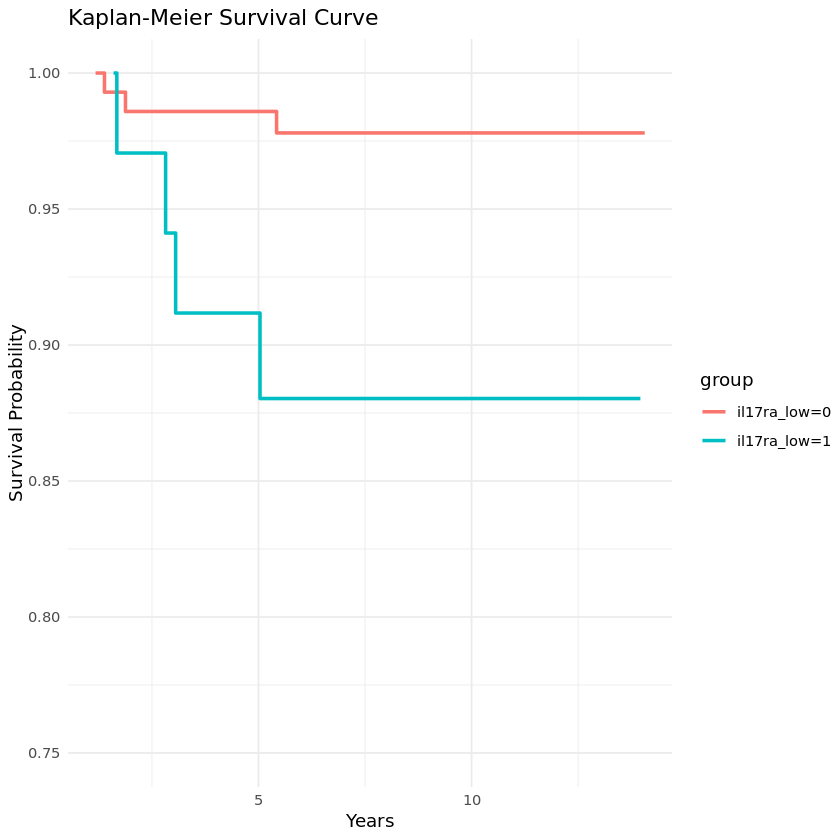

In [182]:
p <- ggplot(km_data, aes(x = time, y = estimate, color = group, fill = group)) +
  geom_step(size = 1) + 
  #geom_ribbon(aes(ymin = conf.low, ymax = conf.high), alpha = 0.2) + 
  labs(title = "Kaplan-Meier Survival Curve",
       x = "Years",
       y = "Survival Probability") +
  theme_minimal() +
  ylim(0.75, 1)
p

In [183]:
library(sjPlot)
save_plot("kmplot_jak2_il17R.svg", fig = p, width=15, height=15)

pdf 
  2

In [174]:
table_counts <- jak2_chip %>%
  mutate(year = floor(surv_CVD)) %>% 
  group_by(year, il17ra_low) %>%      
  summarise(count = n(), .groups = "drop") %>%  
  arrange(year, il17ra_low)         


table_wide <- table_counts %>%
  pivot_wider(names_from = il17ra_low, values_from = count, values_fill = 0) 

print(table_wide)

# A tibble: 14 × 3
    year   `0`   `1`
   <dbl> <int> <int>
 1     1     4     2
 2     2     7     1
 3     3     2     2
 4     4     4     1
 5     5     5     1
 6     6     3     2
 7     7     4     0
 8     8     7     1
 9     9     4     1
10    10     5     2
11    11    34     8
12    12    39     6
13    13    24     8
14    14     1     0


# CVD/MPN~ JAK2 * IL17RA

In [141]:
save(data_all_pheno_cox3, file = "data_all_pheno_cox3_IL17R.Rdata")

In [1]:
x <- load("data_all_pheno_cox3_IL17R.Rdata")
x

[1] "data_all_pheno_cox3"

In [3]:
table(data_all_pheno_cox3$jak2)
table(data_all_pheno_cox3$CVD)
summary(data_all_pheno_cox3$surv_CVD)
summary(data_all_pheno_cox3$Interleukin17_receptor_A)


     0      1 
486879    192 


     0      1 
465956  21115 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
 -20.43   11.50   12.33   11.50   13.05   15.36     338 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
-1.1118  0.3515  0.9603  0.9670  1.5682  3.7822 

In [4]:
data_filter <- filter(data_all_pheno_cox3,data_all_pheno_cox3$surv_CVD >0)

In [125]:
cox_fit <- coxph(Surv(surv_CVD,CVD)~ jak2 + Interleukin17_receptor_A + Interleukin17_receptor_A*jak2 +
                 baseline_age+age2+genetic_sex+smoking_0+PC1+PC2+PC3+PCD4+PC5+ldl_0+baseline_DM+BMI_0+baseline_HTN+AID, data = data_filter)
summary(cox_fit)

Call:
coxph(formula = Surv(surv_CVD, CVD) ~ jak2 + Interleukin17_receptor_A + 
    Interleukin17_receptor_A * jak2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + baseline_DM + 
    BMI_0 + baseline_HTN + AID, data = data_filter)

  n= 449805, number of events= 8697 
   (25343 observations deleted due to missingness)

                                    coef  exp(coef)   se(coef)      z Pr(>|z|)
jak2                           1.433e+00  4.191e+00  4.340e-01  3.302 0.000961
Interleukin17_receptor_A       3.263e-03  1.003e+00  1.369e-02  0.238 0.811652
baseline_age                   5.002e-02  1.051e+00  2.195e-02  2.279 0.022661
age2                           4.258e-05  1.000e+00  1.921e-04  0.222 0.824590
genetic_sex                    5.310e-01  1.701e+00  2.226e-02 23.856  < 2e-16
smoking_0                      2.553e-01  1.291e+00  1.520e-02 16.792  < 2e-16
PC1                           -9.864e-04  9.990e-01  2.772e-04 -3.558 0.000374
PC

In [126]:
log <- glm(CVD ~ jak2 + Interleukin17_receptor_A + Interleukin17_receptor_A*jak2 +
                 baseline_age+age2+genetic_sex+smoking_0+PC1+PC2+PC3+PCD4+PC5+
                 ldl_0+baseline_DM+BMI_0+baseline_HTN+AID, data = data_filter, family = binomial(link = "logit"))

In [127]:
summary(log)


Call:
glm(formula = CVD ~ jak2 + Interleukin17_receptor_A + Interleukin17_receptor_A * 
    jak2 + baseline_age + age2 + genetic_sex + smoking_0 + PC1 + 
    PC2 + PC3 + PCD4 + PC5 + ldl_0 + baseline_DM + BMI_0 + baseline_HTN + 
    AID, family = binomial(link = "logit"), data = data_filter)

Coefficients:
                                Estimate Std. Error z value Pr(>|z|)    
(Intercept)                   -8.7491412  0.6274996 -13.943  < 2e-16 ***
jak2                           1.4448549  0.4725487   3.058 0.002231 ** 
Interleukin17_receptor_A       0.0028683  0.0139209   0.206 0.836756    
baseline_age                   0.0538156  0.0222351   2.420 0.015508 *  
age2                           0.0000044  0.0001947   0.023 0.981972    
genetic_sex                    0.5296015  0.0225836  23.451  < 2e-16 ***
smoking_0                      0.2484367  0.0153914  16.141  < 2e-16 ***
PC1                           -0.0009832  0.0002799  -3.513 0.000442 ***
PC2                           -0.0

#sensitivity analysis

In [6]:
table(data_filter$AID,useNA= "always")


     0      1   <NA> 
465439   9709      0 

In [7]:
data_filter2 <- filter(data_filter,data_filter$AID  == 0)

In [8]:
cox_fit <- coxph(Surv(surv_CVD,CVD)~ jak2 + Interleukin17_receptor_A + Interleukin17_receptor_A*jak2 +
                 baseline_age+age2+genetic_sex+smoking_0+PC1+PC2+PC3+PCD4+PC5+ldl_0+baseline_DM+BMI_0+baseline_HTN, data = data_filter2)
summary(cox_fit)

Call:
coxph(formula = Surv(surv_CVD, CVD) ~ jak2 + Interleukin17_receptor_A + 
    Interleukin17_receptor_A * jak2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + baseline_DM + 
    BMI_0 + baseline_HTN, data = data_filter2)

  n= 440584, number of events= 8113 
   (24855 observations deleted due to missingness)

                                    coef  exp(coef)   se(coef)      z Pr(>|z|)
jak2                           1.4668374  4.3355020  0.4339924  3.380 0.000725
Interleukin17_receptor_A       0.0102605  1.0103134  0.0141759  0.724 0.469188
baseline_age                   0.0560549  1.0576558  0.0227468  2.464 0.013728
age2                          -0.0000101  0.9999899  0.0001991 -0.051 0.959543
genetic_sex                    0.5417107  1.7189449  0.0230898 23.461  < 2e-16
smoking_0                      0.2536920  1.2887748  0.0157632 16.094  < 2e-16
PC1                           -0.0011600  0.9988407  0.0002909 -3.987 6.68e-05
PC2    

#MPN

In [128]:
data_all_pheno_cox3$MPN <- NA
data_all_pheno_cox3$MPN <- ifelse(data_all_pheno_cox3$`Myeloproliferative disorder`==1|
                        data_all_pheno_cox3$`Pulmonary embolism`==1|
                        data_all_pheno_cox3$`Venous thromboembolism`==1|
                        data_all_pheno_cox3$`Chronic myeloproliferative disease*` == 1 ,1, 0)
table(data_all_pheno_cox3$MPN)


     0      1 
471966  15105 

In [129]:
data_all_pheno_cox3$surv_MPD <- NA
data_all_pheno_cox3$surv_MPD <- as.numeric(difftime(data_all_pheno_cox3$`time_Myeloproliferative disorder`, data_all_pheno_cox3$min_date, units ="days"))/365.25
summary(data_all_pheno_cox3$surv_MPD)
data_all_pheno_cox3$surv_MPD <- ifelse(is.na(data_all_pheno_cox3$surv_MPD),data_all_pheno_cox3$surv_all,data_all_pheno_cox3$surv_MPD)
summary(data_all_pheno_cox3$surv_MPD)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
  -19.7    -5.4    -0.5    -1.3     4.1     9.6  486712 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
 -19.68   11.66   12.38   12.09   13.09   15.36     338 

In [130]:
data_all_pheno_cox3$surv_CMD <- NA
data_all_pheno_cox3$surv_CMD <- as.numeric(difftime(data_all_pheno_cox3$`time_Chronic myeloproliferative disease*`, data_all_pheno_cox3$min_date, units ="days"))/365.25
summary(data_all_pheno_cox3$surv_CMD)
data_all_pheno_cox3$surv_CMD <- ifelse(is.na(data_all_pheno_cox3$surv_CMD),data_all_pheno_cox3$surv_all,data_all_pheno_cox3$surv_CMD)
summary(data_all_pheno_cox3$surv_CMD)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
  -15.7    -4.3     2.8     0.7     6.4     9.4  487373 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
 -15.72   11.66   12.38   12.11   13.09   15.36     338 

In [131]:
data_all_pheno_cox3 <- data_all_pheno_cox3 %>% mutate(surv_MPN = pmin(surv_VTE2, surv_MPD, surv_CMD))

In [132]:
summary(data_all_pheno_cox3$surv_MPN)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
 -20.32   11.54   12.34   11.67   13.05   15.36     338 

In [133]:
data_filter <- filter(data_all_pheno_cox3,data_all_pheno_cox3$surv_MPN >0)

In [139]:
cox_fit <- coxph(Surv(surv_MPN,MPN)~ jak2 + Interleukin17_receptor_A + Interleukin17_receptor_A*jak2 +
                 baseline_age+age2+genetic_sex+smoking_0+PC1+PC2+PC3+PCD4+PC5+ldl_0+baseline_DM+BMI_0+baseline_HTN+AID, data = data_filter)
summary(cox_fit)

Call:
coxph(formula = Surv(surv_MPN, MPN) ~ jak2 + Interleukin17_receptor_A + 
    Interleukin17_receptor_A * jak2 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + baseline_DM + 
    BMI_0 + baseline_HTN + AID, data = data_filter)

  n= 453017, number of events= 6396 
   (25629 observations deleted due to missingness)

                                    coef  exp(coef)   se(coef)      z Pr(>|z|)
jak2                           2.261e+00  9.590e+00  3.718e-01  6.081 1.20e-09
Interleukin17_receptor_A      -2.633e-02  9.740e-01  1.601e-02 -1.645   0.0999
baseline_age                   1.883e-02  1.019e+00  2.365e-02  0.797   0.4257
age2                           3.456e-05  1.000e+00  2.103e-04  0.164   0.8695
genetic_sex                    2.280e-02  1.023e+00  2.545e-02  0.896   0.3703
smoking_0                      3.581e-02  1.036e+00  1.784e-02  2.007   0.0447
PC1                           -1.642e-03  9.984e-01  3.100e-04 -5.297 1.18e-07
PC

In [140]:
log <- glm(MPN ~ jak2 + Interleukin17_receptor_A + Interleukin17_receptor_A*jak2 +
                 baseline_age+age2+genetic_sex+smoking_0+PC1+PC2+PC3+PCD4+PC5+
                 ldl_0+baseline_DM+BMI_0+baseline_HTN+AID, data = data_filter, family = binomial(link = "logit"))
summary(log)


Call:
glm(formula = MPN ~ jak2 + Interleukin17_receptor_A + Interleukin17_receptor_A * 
    jak2 + baseline_age + age2 + genetic_sex + smoking_0 + PC1 + 
    PC2 + PC3 + PCD4 + PC5 + ldl_0 + baseline_DM + BMI_0 + baseline_HTN + 
    AID, family = binomial(link = "logit"), data = data_filter)

Coefficients:
                                Estimate Std. Error z value Pr(>|z|)    
(Intercept)                   -6.677e+00  6.593e-01 -10.128  < 2e-16 ***
jak2                           2.308e+00  4.030e-01   5.726 1.03e-08 ***
Interleukin17_receptor_A      -2.710e-02  1.615e-02  -1.678   0.0934 .  
baseline_age                   2.391e-02  2.385e-02   1.003   0.3160    
age2                          -1.825e-05  2.122e-04  -0.086   0.9315    
genetic_sex                    1.457e-02  2.570e-02   0.567   0.5706    
smoking_0                      2.800e-02  1.795e-02   1.560   0.1187    
PC1                           -1.651e-03  3.117e-04  -5.297 1.18e-07 ***
PC2                            9.3

# JAK2 & mCA

In [79]:
data_mca <- filter(data_all_pheno_cox2, data_all_pheno_cox2$mca_status==1)

In [80]:
data_mca <- data_mca[,c("ID_VUMC","CVD","death","Venous thromboembolism","Pulmonary embolism","baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")]

In [85]:
data_mca$VTE <- ifelse(is.na(data_mca$VTE),0,data_mca$VTE)
table(data_mca$VTE,useNA = "always")


    0     1  <NA> 
14582   518     0 

In [98]:
data_chr9_jak <- filter(data_all_pheno_cox2, data_all_pheno_cox2$ID_VUMC %in% chr9CN$ID_VUMC | data_all_pheno_cox2$ID_VUMC %in% jak2$ID_VUMC)

In [102]:
data_chr9_jak_protein <- merge(data_chr9_jak, score_kz, by.x = "ID_VUMC" , by.y = "ID", all.x = T)

In [105]:
dim(data_chr9_jak_protein)

[1]  728 6925

In [110]:
data_chr9_jak_protein$`Venous thromboembolism`<- ifelse(is.na(data_chr9_jak_protein$`Venous thromboembolism`),0,data_chr9_jak_protein$`Venous thromboembolism`)

In [112]:
table(data_chr9_jak_protein$`Venous thromboembolism`)


  0   1 
688  40 

In [115]:
data_chr9_jak_protein$VTE <- NA
data_chr9_jak_protein$VTE <- ifelse(data_chr9_jak_protein$`Pulmonary embolism`==1|
                    data_chr9_jak_protein$`Venous thromboembolism`==1 ,1, 0)

In [116]:
data_chr9_jak_protein$VTE<- ifelse(is.na(data_chr9_jak_protein$VTE),0,data_chr9_jak_protein$VTE)

In [118]:
logistic_mca <- batch_logistic_regression(
  data = data_chr9_jak_protein,
  snp_list = "Interleukin17_receptor_B",
  outcome = "VTE",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")
)
logistic_mca

VTE ~ Interleukin17_receptor_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5911b8a30070>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin17_receptor_B,Interleukin17_receptor_B,-0.7472291,0.4736773,0.5215498,0.1704238,1.316542,0.151941


In [122]:
logistic_mca <- batch_logistic_regression(
  data = data_chr9_jak_protein,
  snp_list = "Interleukin17_receptor_A",
  outcome = "CVD",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")
)
logistic_mca

CVD ~ Interleukin17_receptor_A + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x590a2e35a9b0>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin17_receptor_A,Interleukin17_receptor_A,-0.2211578,0.8015902,0.1878716,0.5546677,1.158436,0.2391255


In [124]:
logistic_mca <- batch_logistic_regression(
  data = data_chr9_jak_protein,
  snp_list = "Interleukin17_receptor_B",
  outcome = "death",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")
)
logistic_mca

death ~ Interleukin17_receptor_B + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x59057380e9b8>


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Interleukin17_receptor_B,Interleukin17_receptor_B,0.3428632,1.408976,0.2824071,0.8100538,2.450718,0.2247193


# IL17RB-each SNP

In [16]:
il17r <- fread("Interleukin17_receptor_B_snp.vcf")

In [18]:
dim(il17r)

[1]     51 487418

In [19]:
ls(il17r)

[1] "-1_-1"           "-10_-10"         "-100_-100"       "-101_-101"      
    [5] "-102_-102"       "-103_-103"       "-104_-104"       "-105_-105"      
    [9] "-106_-106"       "-107_-107"       "-108_-108"       "-109_-109"      
   [13] "-11_-11"         "-110_-110"       "-111_-111"       "-112_-112"      
   [17] "-113_-113"       "-114_-114"       "-115_-115"       "-116_-116"      
   [21] "-117_-117"       "-118_-118"       "-119_-119"       "-12_-12"        
   [25] "-120_-120"       "-121_-121"       "-122_-122"       "-123_-123"      
   [29] "-124_-124"       "-125_-125"       "-126_-126"       "-127_-127"      
   [33] "-128_-128"       "-129_-129"       "-13_-13"         "-130_-130"      
   [37] "-131_-131"       "-132_-132"       "-133_-133"       "-134_-134"      
   [41] "-135_-135"       "-136_-136"       "-137_-137"       "-138_-138"      
   [45] "-139_-139"       "-14_-14"         "-140_-140"       "-141_-141"      
   [49] "-142_-142"       "-143_-143"       "-144_-144"       "-145_-145"      
   [53] "-146_-146"       "-147_-147"       "-148_-148"       "-149_-149"      
   [57] "-15_-15"         "-150_-150"       "-151_-151"       "-152_-152"      
   [61] "-153_-153"       "-154_-154"       "-155_-155"       "-156_-156"      
   [65] "-157_-157"       "-158_-158"       "-159_-159"       "-16_-16"        
   [69] "-160_-160"       "-161_-161"       "-162_-162"       "-163_-163"      
   [73] "-164_-164"       "-165_-165"       "-166_-166"       "-167_-167"      
   [77] "-168_-168"       "-169_-169"       "-17_-17"         "-170_-170"      
   [81] "-171_-171"       "-172_-172"       "-173_-173"       "-174_-174"      
   [85] "-175_-175"       "-176_-176"       "-177_-177"       "-178_-178"      
   [89] "-179_-179"       "-18_-18"         "-180_-180"       "-181_-181"      
   [93] "-182_-182"       "-183_-183"       "-184_-184"       "-185_-185"      
   [97] "-186_-186"       "-187_-187"       "-188_-188"       "-189_-189"      
  [101] "-19_-19"         "-190_-190"       "-191_-191"       "-192_-192"      
  [105] "-193_-193"       "-194_-194"       "-195_-195"       "-196_-196"      
  [109] "-197_-197"       "-198_-198"       "-199_-199"       "-2_-2"          
  [113] "-20_-20"         "-200_-200"       "-201_-201"       "-202_-202"      
  [117] "-203_-203"       "-204_-204"       "-205_-205"       "-206_-206"      
  [121] "-207_-207"       "-208_-208"       "-209_-209"       "-21_-21"        
  [125] "-210_-210"       "-211_-211"       "-212_-212"       "-213_-213"      
  [129] "-214_-214"       "-215_-215"       "-216_-216"       "-217_-217"      
  [133] "-218_-218"       "-219_-219"       "-22_-22"         "-220_-220"      
  [137] "-221_-221"       "-222_-222"       "-223_-223"       "-224_-224"      
  [141] "-225_-225"       "-226_-226"       "-227_-227"       "-228_-228"      
  [145] "-229_-229"       "-23_-23"         "-230_-230"       "-231_-231"      
  [149] "-232_-232"       "-233_-233"       "-234_-234"       "-235_-235"      
  [153] "-236_-236"       "-237_-237"       "-238_-238"       "-239_-239"      
  [157] "-24_-24"         "-240_-240"       "-241_-241"       "-242_-242"      
  [161] "-243_-243"       "-244_-244"       "-245_-245"       "-246_-246"      
  [165] "-247_-247"       "-248_-248"       "-249_-249"       "-25_-25"        
  [169] "-250_-250"       "-251_-251"       "-252_-252"       "-253_-253"      
  [173] "-254_-254"       "-255_-255"       "-256_-256"       "-257_-257"      
  [177] "-258_-258"       "-259_-259"       "-26_-26"         "-260_-260"      
  [181] "-261_-261"       "-262_-262"       "-263_-263"       "-264_-264"      
  [185] "-265_-265"       "-266_-266"       "-267_-267"       "-268_-268"      
  [189] "-269_-269"       "-27_-27"         "-270_-270"       "-271_-271"      
  [193] "-272_-272"       "-273_-273"       "-274_-274"       "-275_-275"      
  [197] "-276_-276"       "-277_-277"       "-278_-278"       "-279_-279"      
  [2

In [20]:
sample_columns <- colnames(il17r)[10:487418]

In [21]:
sample_columns

[1] "1932941_1932941" "5252723_5252723" "5581705_5581705" "5759821_5759821"
    [5] "3698512_3698512" "2506568_2506568" "1624024_1624024" "5122184_5122184"
    [9] "1557160_1557160" "5664412_5664412" "2629510_2629510" "5244798_5244798"
   [13] "5817585_5817585" "3386532_3386532" "3452716_3452716" "3505232_3505232"
   [17] "4643584_4643584" "1207138_1207138" "3299102_3299102" "5338398_5338398"
   [21] "5592893_5592893" "3085052_3085052" "1814414_1814414" "5544383_5544383"
   [25] "3788687_3788687" "3117944_3117944" "2967791_2967791" "3643890_3643890"
   [29] "2242429_2242429" "1434337_1434337" "5441705_5441705" "1097237_1097237"
   [33] "3464829_3464829" "1416901_1416901" "4378753_4378753" "5588619_5588619"
   [37] "4538124_4538124" "5645188_5645188" "4825546_4825546" "1642798_1642798"
   [41] "1114516_1114516" "4554568_4554568" "5136120_5136120" "5122245_5122245"
   [45] "4060844_4060844" "3989534_3989534" "3464117_3464117" "2357253_2357253"
   [49] "5898800_5898800" "1347109_1347109" "2265594_2265594" "2781183_2781183"
   [53] "3448823_3448823" "4292999_4292999" "2927870_2927870" "1575360_1575360"
   [57] "3708507_3708507" "3495498_3495498" "1538215_1538215" "2246586_2246586"
   [61] "4110467_4110467" "2355000_2355000" "1606731_1606731" "2733714_2733714"
   [65] "2404623_2404623" "2602095_2602095" "1881139_1881139" "5858673_5858673"
   [69] "2831433_2831433" "5906036_5906036" "2444051_2444051" "4114514_4114514"
   [73] "4251633_4251633" "3874146_3874146" "1698343_1698343" "3122476_3122476"
   [77] "4315427_4315427" "3151400_3151400" "1900060_1900060" "2101444_2101444"
   [81] "1599971_1599971" "5692522_5692522" "2879992_2879992" "4900314_4900314"
   [85] "5197729_5197729" "3064727_3064727" "2299007_2299007" "2673172_2673172"
   [89] "3813670_3813670" "4948552_4948552" "1231308_1231308" "3699666_3699666"
   [93] "2380738_2380738" "2712830_2712830" "5123250_5123250" "4011852_4011852"
   [97] "2116582_2116582" "4113460_4113460" "3929158_3929158" "4915868_4915868"
  [101] "5980860_5980860" "1764092_1764092" "4525008_4525008" "1973859_1973859"
  [105] "3853095_3853095" "4092453_4092453" "2392442_2392442" "4228864_4228864"
  [109] "1438988_1438988" "5800408_5800408" "3975863_3975863" "1112055_1112055"
  [113] "3856075_3856075" "1272853_1272853" "3232837_3232837" "1086691_1086691"
  [117] "2387242_2387242" "5795864_5795864" "5638643_5638643" "4506108_4506108"
  [121] "2781176_2781176" "1135345_1135345" "3817561_3817561" "1378455_1378455"
  [125] "5958632_5958632" "3620974_3620974" "3929990_3929990" "2558709_2558709"
  [129] "2093542_2093542" "2172823_2172823" "3523392_3523392" "2498547_2498547"
  [133] "3998707_3998707" "3197353_3197353" "2480659_2480659" "1435652_1435652"
  [137] "5572055_5572055" "1794408_1794408" "1675398_1675398" "3417520_3417520"
  [141] "2347911_2347911" "3657799_3657799" "3556573_3556573" "1162120_1162120"
  [145] "2308780_2308780" "2420172_2420172" "5071373_5071373" "2183655_2183655"
  [149] "1479590_1479590" "5439992_5439992" "5108387_5108387" "3295132_3295132"
  [153] "1165966_1165966" "4871607_4871607" "3982553_3982553" "1692951_1692951"
  [157] "5106884_5106884" "3762142_3762142" "5815134_5815134" "5840063_5840063"
  [161] "2187502_2187502" "3416077_3416077" "4160997_4160997" "4049210_4049210"
  [165] "5515581_5515581" "3858379_3858379" "2330052_2330052" "5663411_5663411"
  [169] "2977794_2977794" "5144871_5144871" "1543972_1543972" "4216943_4216943"
  [173] "5425424_5425424" "1922102_1922102" "1027917_1027917" "5226939_5226939"
  [177] "3948643_3948643" "2799952_2799952" "1038508_1038508" "3950568_3950568"
  [181] "2848168_2848168" "5999758_5999758" "1598969_1598969" "5320249_5320249"
  [185] "3137780_3137780" "5563912_5563912" "5409705_5409705" "4341993_4341993"
  [189] "2136590_2136590" "5108107_5108107" "4400803_4400803" "2918338_2918338"
  [193] "4604180_4604180" "3679191_3679191" "2608326_2608326" "5625156_5625156"
  [197] "5020678_5020678" "3598079_3598079" "1570846_1570846" "3813295_3813295"
  [2

In [22]:
#change version
library(tidyr)
library(dplyr)

il17r_long <- il17r %>%
  pivot_longer(
    cols = all_of(sample_columns),  
    names_to = "Sample",           
    values_to = "Genotype"        
  )

In [23]:
il17r_long <- il17r_long[,c(3,10,11)]

In [46]:
il17r_wide <- il17r_long %>%
  pivot_wider(
    names_from = ID,      
    values_from = Genotype 
  )

In [47]:
il17r_wide <- il17r_wide %>%
  mutate(across(all_of(target_columns), ~ case_when(
    . == "0/0" ~ 0,
    . == "0/1" ~ 1,
    . == "1/1" ~ 2,
    TRUE ~ NA_real_  
  )))

In [48]:
il17r_wide <- il17r_wide %>%
  mutate(Sample = sub("_.*", "", Sample))

In [50]:
write.csv(il17r_wide,file= "il17r_SNP_data_UKB.csv")

In [195]:
il17r_wide <- read.csv("il17r_SNP_data_UKB.csv")

In [196]:
target_columns <- colnames(il17r_wide)[3:53]
target_columns

[1] "rs11720018"  "rs11706303"  "rs3774541"   "rs13074345"  "rs2612013"  
 [6] "rs76730871"  "rs3774548"   "rs11708934"  "rs148439616" "rs78234945" 
[11] "rs3774563"   "rs2077460"   "rs3774573"   "rs3774581"   "rs114702541"
[16] "rs3774595"   "rs2289210"   "rs3774600"   "rs3774604"   "rs192454758"
[21] "rs3796348"   "rs893365"    "rs75065476"  "rs893363"    "rs9836592"  
[26] "rs17053532"  "rs6804251"   "rs6793451"   "rs2196663"   "rs35518479" 
[31] "rs28385668"  "rs7627178"   "rs2232333"   "rs55754695"  "rs3774620"  
[36] "rs9875962"   "rs62752960"  "rs34717355"  "rs62252978"  "rs62252980" 
[41] "rs7641429"   "rs150822152" "rs7621469"   "rs6789031"   "rs4632536"  
[46] "rs78020898"  "rs139124335" "rs9810229"   "rs73081940"  "rs116234335"
[51] "rs115526028"

In [17]:
#Load UKB
x <- load("UKB_data_all_1024.Rdata")
x

[1] "data_all_pheno_cox2"

In [199]:
data_chip2$ID_VUMC <- as.character(data_chip2$ID_VUMC)
il17r_wide$Sample <- as.character(il17r_wide$Sample)

In [200]:
data_chip3 <- merge(data_chip2,il17r_wide,by.x = "ID_VUMC", by.y = "Sample", all = F)

In [201]:
ls(data_chip3)

[1] "Acute myeloid leukemia"                        
 [2] "age2"                                          
 [3] "AML"                                           
 [4] "ASCVD"                                         
 [5] "baseline_age"                                  
 [6] "baseline_DM"                                   
 [7] "baseline_HTN"                                  
 [8] "BMI_0"                                         
 [9] "CAD"                                           
[10] "CVD"                                           
[11] "death"                                         
[12] "diastolicBP_0"                                 
[13] "genetic_sex"                                   
[14] "Heart failure"                                 
[15] "ID_VUMC"                                       
[16] "ldl_0"                                         
[17] "Myocardial infarction [Heart attack]"          
[18] "PC1"                                           
[19] "PC2"                                           
[20] "PC3"                                           
[21] "PC5"                                           
[22] "PCD4"                                          
[23] "rs114702541"                                   
[24] "rs115526028"                                   
[25] "rs116234335"                                   
[26] "rs11706303"                                    
[27] "rs11708934"                                    
[28] "rs11720018"                                    
[29] "rs13074345"                                    
[30] "rs139124335"                                   
[31] "rs148439616"                                   
[32] "rs150822152"                                   
[33] "rs17053532"                                    
[34] "rs192454758"                                   
[35] "rs2077460"                                     
[36] "rs2196663"                                     
[37] "rs2232333"                                     
[38] "rs2289210"                                     
[39] "rs2612013"                                     
[40] "rs28385668"                                    
[41] "rs34717355"                                    
[42] "rs35518479"                                    
[43] "rs3774541"                                     
[44] "rs3774548"                                     
[45] "rs3774563"                                     
[46] "rs3774573"                                     
[47] "rs3774581"                                     
[48] "rs3774595"                                     
[49] "rs3774600"                                     
[50] "rs3774604"                                     
[51] "rs3774620"                                     
[52] "rs3796348"                                     
[53] "rs4632536"                                     
[54] "rs55754695"                                    
[55] "rs62252978"                                    
[56] "rs62252980"                                    
[57] "rs62752960"                                    
[58] "rs6789031"                                     
[59] "rs6793451"                                     
[60] "rs6804251"                                     
[61] "rs73081940"                                    
[62] "rs75065476"                                    
[63] "rs7621469"                                     
[64] "rs7627178"                                     
[65] "rs7641429"                                     
[66] "rs76730871"                                    
[67] "rs78020898"                                    
[68] "rs78234945"                                    
[69] "rs893363"                                      
[70] "rs893365"                                      
[71] "rs9810229"                                     
[72] "rs9836592"                                     
[73] "rs9875962"                                     
[74] "smoking_0"                                     
[75] 

In [202]:
data_chip3$jak2 <- ifelse(data_chip3$ID_VUMC %in% jak2$ID_VUMC , 1, 0)

In [203]:
data_jak2 <- filter(data_chip3, data_chip3$jak2 == 1)

In [204]:
dim(data_jak2)

[1] 192  81

#lasso

In [192]:
library(glmnet)

Loading required package: Matrix


Attaching package: ‘Matrix’


The following objects are masked from ‘package:tidyr’:

    expand, pack, unpack


Loaded glmnet 4.1-8



In [205]:
outcome <- data_jak2$"`Venous thromboembolism`"
snp_matrix <- as.matrix(data_jak2[, ..target_columns]) 
snp_matrix <- apply(snp_matrix, 2, as.numeric) 

In [206]:
fill_missing_with_mode <- function(df) {
  apply(df, 2, function(column) {
    if (any(is.na(column))) {
      mode_value <- as.numeric(names(which.max(table(column, useNA = "no"))))
      column[is.na(column)] <- mode_value
    }
    return(column)
  })
}

snp_matrix_filled <- fill_missing_with_mode(snp_matrix)

snp_matrix_filled <- as.matrix(snp_matrix_filled)

sum(is.na(snp_matrix_filled))

[1] 0

In [207]:
X <- as.matrix(data_jak2[, ..target_columns]) 
y <- data_jak2$`Venous thromboembolism`
covariates <- as.matrix(data_jak2[, c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","ldl_0","BMI_0","systolicBP_0","diastolicBP_0","baseline_DM")])

X_combined <- cbind(covariates, X)

In [208]:
fill_missing_with_mode <- function(df) {
  apply(df, 2, function(column) {
    if (any(is.na(column))) {
      mode_value <- as.numeric(names(which.max(table(column, useNA = "no"))))
      column[is.na(column)] <- mode_value
    }
    return(column)
  })
}

X_combined <- fill_missing_with_mode(X_combined)

sum(is.na(X_combined)) 

[1] 0

In [209]:
penalty_factors <- c(rep(0, ncol(covariates)), rep(1, ncol(X)))

lasso_model <- cv.glmnet(
  x = X_combined,
  y = y,
  alpha = 1,  
  family = "binomial",  
  penalty.factor = penalty_factors  
)

best_lambda <- lasso_model$lambda.min
coef(lasso_model, s = best_lambda)

Warning message:
“from glmnet C++ code (error code -42); Convergence for 42th lambda value not reached after maxit=100000 iterations; solutions for larger lambdas returned”


66 x 1 sparse Matrix of class "dgCMatrix"
                       s1
(Intercept)   71.99754036
baseline_age  -2.52889754
age2           0.02088850
genetic_sex    1.85123734
smoking_0     -1.52640158
PC1           -0.06795549
PC2           -0.23643513
PC3           -0.23170410
PCD4          -0.08131164
PC5            0.05043233
ldl_0         -0.13479568
BMI_0          0.05648251
systolicBP_0   0.06282009
diastolicBP_0 -0.13466090
baseline_DM    0.26667688
rs11720018     .         
rs11706303     .         
rs3774541      .         
rs13074345     .         
rs2612013      .         
rs76730871     .         
rs3774548      .         
rs11708934     .         
rs148439616    .         
rs78234945     .         
rs3774563      .         
rs2077460      .         
rs3774573      .         
rs3774581      .         
rs114702541    .         
rs3774595      .         
rs2289210      .         
rs3774600      .         
rs3774604      .         
rs192454758    .         
rs3796348      .      

In [206]:
library(pROC)
predictions <- predict(lasso_model, newx = X_combined, s = best_lambda, type = "response")
roc_curve <- roc(data_jak2$`Venous thromboembolism`, predictions)
auc(roc_curve)

Setting levels: control = 0, case = 1

Warning message in roc.default(data_jak2$`Venous thromboembolism`, predictions):
“Deprecated use a matrix as predictor. Unexpected results may be produced, please pass a numeric vector.”
Setting direction: controls < cases



Area under the curve: 0.9058

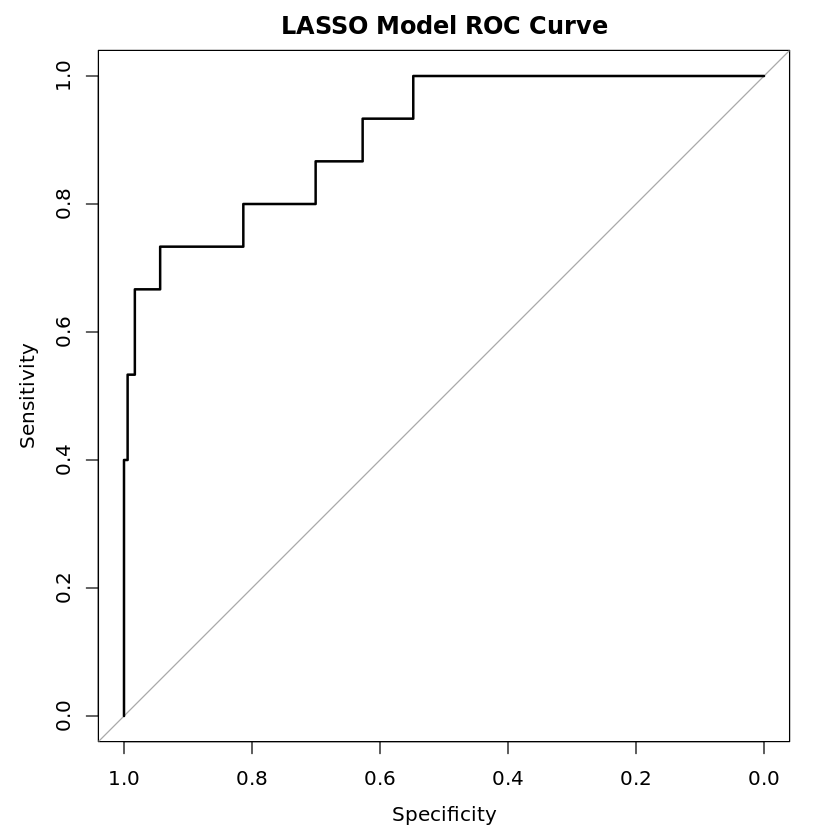

In [207]:
plot(roc_curve, main = "LASSO Model ROC Curve")

In [210]:
predicted_probs <- predict(lasso_model, newx = X_combined, s = best_lambda, type = "response")

Installing package into ‘/home/jupyter/packages’
(as ‘lib’ is unspecified)



Precision-Recall AUC: 0.6965139 


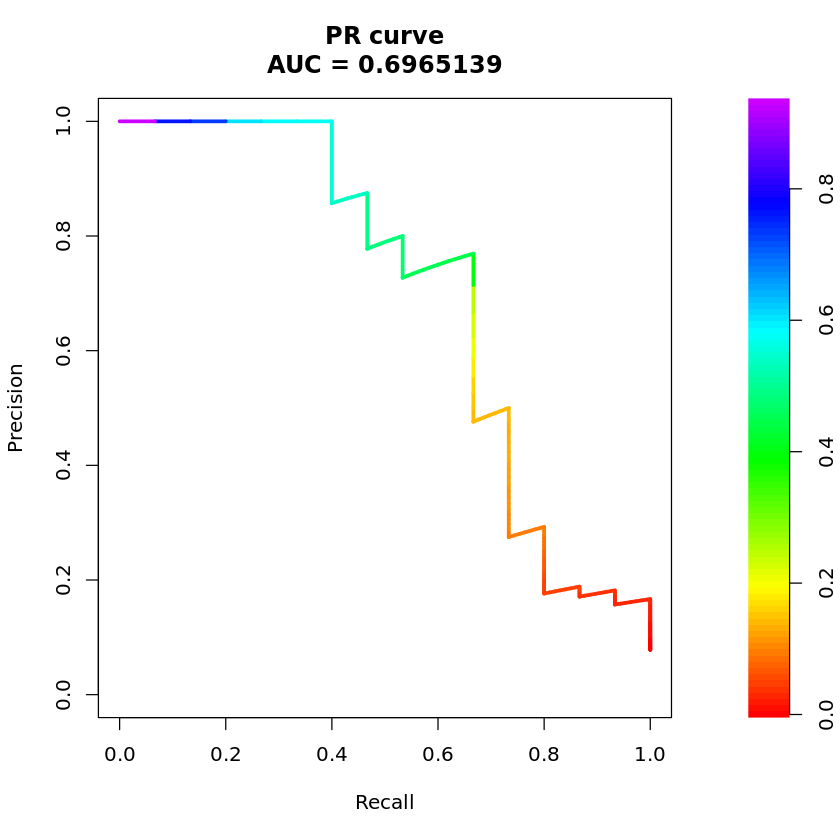

In [211]:
if (!requireNamespace("PRROC", quietly = TRUE)) {
  install.packages("PRROC")
}
library(PRROC)

pr_curve <- pr.curve(scores.class0 = predicted_probs, weights.class0 = y, curve = TRUE)

cat("Precision-Recall AUC:", pr_curve$auc.integral, "\n")

plot(pr_curve)

Installing package into ‘/home/jupyter/packages’
(as ‘lib’ is unspecified)



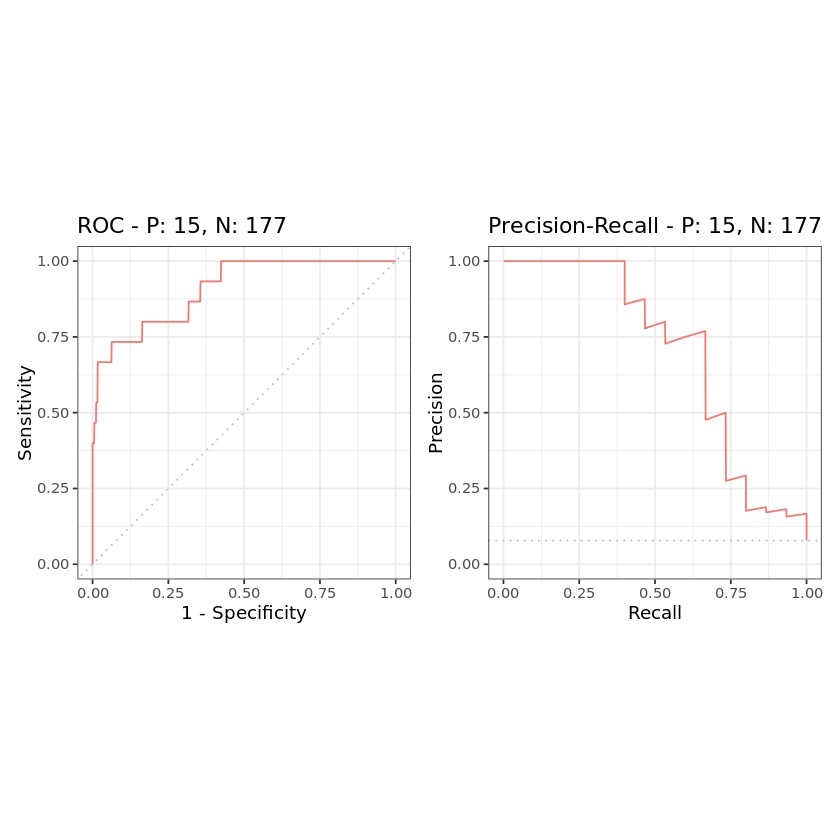

In [212]:
if (!requireNamespace("precrec", quietly = TRUE)) {
  install.packages("precrec")
}
library(precrec)
pr <- evalmod(scores = predicted_probs, labels = y)

autoplot(pr)

In [94]:
logistic_mca <- batch_logistic_regression(
  data = data_jak2,
  snp_list = target_columns,
  outcome = "`Venous thromboembolism`",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")
)

`Venous thromboembolism` ~ rs11720018 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>
`Venous thromboembolism` ~ rs11706303 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>
`Venous thromboembolism` ~ rs3774541 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>
`Venous thromboembolism` ~ rs13074345 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>
`Venous thromboembolism` ~ rs2612013 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>
`Venous thromboembolism` ~ rs76730871 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>
`Venous thromboembolism` ~ rs3774548 + baseline_age + age2 + 
    genetic_sex + smoking_0 

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ rs3774595 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>
`Venous thromboembolism` ~ rs2289210 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ rs3774600 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>
`Venous thromboembolism` ~ rs3774604 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>
`Venous thromboembolism` ~ rs192454758 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>
`Venous thromboembolism` ~ rs3796348 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>
`Venous thromboembolism` ~ rs893365 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>
`Venous thromboembolism` ~ rs75065476 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>
`Venous thromboembolism` ~ rs893363 + baseline_age + age2 + genetic_sex + 
    smoking_0 + P

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ rs35518479 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ rs28385668 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>
`Venous thromboembolism` ~ rs7627178 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>
`Venous thromboembolism` ~ rs2232333 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ rs55754695 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ rs3774620 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ rs9875962 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ rs62752960 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>
`Venous thromboembolism` ~ rs34717355 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>
`Venous thromboembolism` ~ rs62252978 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>
`Venous thromboembolism` ~ rs62252980 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>
`Venous thromboembolism` ~ rs7641429 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>
`Venous thromboembolism` ~ rs150822152 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>
`Venous thromboembolism` ~ rs7621469 + baseline_age + age2 + 
    genetic_sex + smoking_

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ rs115526028 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5
<environment: 0x5beef5757088>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
rs11720018,rs11720018,-0.092044000,9.120650e-01,0.8836057,0.16139329,5.1542577,0.917035520
rs11706303,rs11706303,0.121185340,1.128834e+00,0.5409603,0.39098080,3.2591535,0.822742581
rs3774541,rs3774541,-0.610530307,5.430628e-01,0.4843327,0.21017338,1.4032091,0.207467544
rs13074345,rs13074345,0.067417617,1.069742e+00,0.4433420,0.44864078,2.5507004,0.879134226
rs2612013,rs2612013,-0.254848645,7.750338e-01,0.5118617,0.28419420,2.1136159,0.618564540
rs76730871,rs76730871,-15.312447586,2.238146e-07,1249.7820716,0.00000000,Inf,0.990224488
rs3774548,rs3774548,0.346922636,1.414707e+00,0.4494247,0.58628469,3.4136942,0.440158230
rs11708934,rs11708934,-0.898439213,4.072047e-01,0.6290579,0.11867190,1.3972616,0.153225761
rs148439616,rs148439616,-15.277520613,2.317699e-07,1242.8064267,0.00000000,Inf,0.990192044


In [95]:
logistic_mca <- logistic_mca %>% arrange(P_Value)
logistic_mca

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
rs9836592,rs9836592,2.138026303,8.482679e+00,0.7304662,2.02650490,35.5073608,0.003423215
rs35518479,rs35518479,-1.650670106,1.919213e-01,0.5751819,0.06216105,0.5925538,0.004107019
rs2196663,rs2196663,1.598684860,4.946523e+00,0.5891672,1.55880139,15.6967319,0.006658349
rs2232333,rs2232333,-1.635729079,1.948103e-01,0.6328046,0.05635828,0.6733890,0.009741060
rs55754695,rs55754695,-1.488193712,2.257801e-01,0.5999422,0.06966338,0.7317569,0.013117558
rs893363,rs893363,1.421685302,4.144099e+00,0.5828441,1.32221838,12.9884395,0.014718978
rs6804251,rs6804251,1.268419785,3.555230e+00,0.5508145,1.20782766,10.4647886,0.021289667
rs116234335,rs116234335,2.141269875,8.510238e+00,0.9885205,1.22601577,59.0727683,0.030300793
rs7627178,rs7627178,1.181970328,3.260793e+00,0.5554999,1.09767076,9.6866651,0.033357021


In [128]:
table(data_jak2$`Venous thromboembolism`)
table(data_jak2$CVD)


  0   1 
177  15 


  0   1 
171  21 

In [125]:
logistic_mca <- batch_logistic_regression(
  data = data_jak2,
  snp_list = target_columns,
  outcome = "`Venous thromboembolism`",
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","ldl_0","BMI_0","baseline_HTN","baseline_DM")
)

`Venous thromboembolism` ~ rs11720018 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + baseline_HTN + baseline_DM
<environment: 0x5bd03d6dfb50>
`Venous thromboembolism` ~ rs11706303 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + baseline_HTN + baseline_DM
<environment: 0x5bd03d6dfb50>
`Venous thromboembolism` ~ rs3774541 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + baseline_HTN + baseline_DM
<environment: 0x5bd03d6dfb50>
`Venous thromboembolism` ~ rs13074345 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + baseline_HTN + baseline_DM
<environment: 0x5bd03d6dfb50>
`Venous thromboembolism` ~ rs2612013 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + baseline_HTN + baseline_DM
<environment: 0x5bd03d

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ rs3774600 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + baseline_HTN + baseline_DM
<environment: 0x5bd03d6dfb50>
`Venous thromboembolism` ~ rs3774604 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + baseline_HTN + baseline_DM
<environment: 0x5bd03d6dfb50>
`Venous thromboembolism` ~ rs192454758 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + baseline_HTN + baseline_DM
<environment: 0x5bd03d6dfb50>
`Venous thromboembolism` ~ rs3796348 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + baseline_HTN + baseline_DM
<environment: 0x5bd03d6dfb50>
`Venous thromboembolism` ~ rs893365 + baseline_age + age2 + genetic_sex + 
    smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + 
    baseline_HTN + baseline_DM
<environment: 0x5bd03d6d

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ rs9875962 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + baseline_HTN + baseline_DM
<environment: 0x5bd03d6dfb50>


Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


`Venous thromboembolism` ~ rs62752960 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + baseline_HTN + baseline_DM
<environment: 0x5bd03d6dfb50>
`Venous thromboembolism` ~ rs34717355 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + baseline_HTN + baseline_DM
<environment: 0x5bd03d6dfb50>
`Venous thromboembolism` ~ rs62252978 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + baseline_HTN + baseline_DM
<environment: 0x5bd03d6dfb50>
`Venous thromboembolism` ~ rs62252980 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + baseline_HTN + baseline_DM
<environment: 0x5bd03d6dfb50>
`Venous thromboembolism` ~ rs7641429 + baseline_age + age2 + 
    genetic_sex + smoking_0 + PC1 + PC2 + PC3 + PCD4 + PC5 + 
    ldl_0 + BMI_0 + baseline_HTN + baseline_DM
<environment: 0x5bd03

In [126]:
logistic_mca <- logistic_mca %>% arrange(P_Value)
logistic_mca

,SNP,Beta,OR,SE,CI_Lower,CI_Upper,P_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
rs9836592,rs9836592,2.43495406,1.141529e+01,0.8272946,2.25569152,57.7689554,0.003247617
rs35518479,rs35518479,-1.80607838,1.642972e-01,0.6352376,0.04730477,0.5706309,0.004466949
rs2196663,rs2196663,1.75667746,5.793157e+00,0.6455321,1.63465966,20.5306788,0.006502844
rs2232333,rs2232333,-1.68494810,1.854541e-01,0.6406893,0.05282878,0.6510316,0.008541024
rs55754695,rs55754695,-1.58381995,2.051898e-01,0.6306053,0.05961749,0.7062163,0.012018967
rs893363,rs893363,1.56760302,4.795141e+00,0.6523300,1.33513997,17.2216948,0.016257512
rs6804251,rs6804251,1.42627264,4.163153e+00,0.6068220,1.26731631,13.6760175,0.018753394
rs7627178,rs7627178,1.25202905,3.497432e+00,0.5729709,1.13769703,10.7515726,0.028877636
rs3774620,rs3774620,1.18359298,3.266088e+00,0.5851380,1.03740511,10.2827058,0.043098029


# IL17RA

In [5]:
il17ra <- fread("Interleukin17_receptor_A_snp.vcf")

In [6]:
dim(il17ra)

[1]     76 487418

In [8]:
sample_columns <- colnames(il17ra)[10:487418]
sample_columns

[1] "1932941_1932941" "5252723_5252723" "5581705_5581705" "5759821_5759821"
    [5] "3698512_3698512" "2506568_2506568" "1624024_1624024" "5122184_5122184"
    [9] "1557160_1557160" "5664412_5664412" "2629510_2629510" "5244798_5244798"
   [13] "5817585_5817585" "3386532_3386532" "3452716_3452716" "3505232_3505232"
   [17] "4643584_4643584" "1207138_1207138" "3299102_3299102" "5338398_5338398"
   [21] "5592893_5592893" "3085052_3085052" "1814414_1814414" "5544383_5544383"
   [25] "3788687_3788687" "3117944_3117944" "2967791_2967791" "3643890_3643890"
   [29] "2242429_2242429" "1434337_1434337" "5441705_5441705" "1097237_1097237"
   [33] "3464829_3464829" "1416901_1416901" "4378753_4378753" "5588619_5588619"
   [37] "4538124_4538124" "5645188_5645188" "4825546_4825546" "1642798_1642798"
   [41] "1114516_1114516" "4554568_4554568" "5136120_5136120" "5122245_5122245"
   [45] "4060844_4060844" "3989534_3989534" "3464117_3464117" "2357253_2357253"
   [49] "5898800_5898800" "1347109_1347109" "2265594_2265594" "2781183_2781183"
   [53] "3448823_3448823" "4292999_4292999" "2927870_2927870" "1575360_1575360"
   [57] "3708507_3708507" "3495498_3495498" "1538215_1538215" "2246586_2246586"
   [61] "4110467_4110467" "2355000_2355000" "1606731_1606731" "2733714_2733714"
   [65] "2404623_2404623" "2602095_2602095" "1881139_1881139" "5858673_5858673"
   [69] "2831433_2831433" "5906036_5906036" "2444051_2444051" "4114514_4114514"
   [73] "4251633_4251633" "3874146_3874146" "1698343_1698343" "3122476_3122476"
   [77] "4315427_4315427" "3151400_3151400" "1900060_1900060" "2101444_2101444"
   [81] "1599971_1599971" "5692522_5692522" "2879992_2879992" "4900314_4900314"
   [85] "5197729_5197729" "3064727_3064727" "2299007_2299007" "2673172_2673172"
   [89] "3813670_3813670" "4948552_4948552" "1231308_1231308" "3699666_3699666"
   [93] "2380738_2380738" "2712830_2712830" "5123250_5123250" "4011852_4011852"
   [97] "2116582_2116582" "4113460_4113460" "3929158_3929158" "4915868_4915868"
  [101] "5980860_5980860" "1764092_1764092" "4525008_4525008" "1973859_1973859"
  [105] "3853095_3853095" "4092453_4092453" "2392442_2392442" "4228864_4228864"
  [109] "1438988_1438988" "5800408_5800408" "3975863_3975863" "1112055_1112055"
  [113] "3856075_3856075" "1272853_1272853" "3232837_3232837" "1086691_1086691"
  [117] "2387242_2387242" "5795864_5795864" "5638643_5638643" "4506108_4506108"
  [121] "2781176_2781176" "1135345_1135345" "3817561_3817561" "1378455_1378455"
  [125] "5958632_5958632" "3620974_3620974" "3929990_3929990" "2558709_2558709"
  [129] "2093542_2093542" "2172823_2172823" "3523392_3523392" "2498547_2498547"
  [133] "3998707_3998707" "3197353_3197353" "2480659_2480659" "1435652_1435652"
  [137] "5572055_5572055" "1794408_1794408" "1675398_1675398" "3417520_3417520"
  [141] "2347911_2347911" "3657799_3657799" "3556573_3556573" "1162120_1162120"
  [145] "2308780_2308780" "2420172_2420172" "5071373_5071373" "2183655_2183655"
  [149] "1479590_1479590" "5439992_5439992" "5108387_5108387" "3295132_3295132"
  [153] "1165966_1165966" "4871607_4871607" "3982553_3982553" "1692951_1692951"
  [157] "5106884_5106884" "3762142_3762142" "5815134_5815134" "5840063_5840063"
  [161] "2187502_2187502" "3416077_3416077" "4160997_4160997" "4049210_4049210"
  [165] "5515581_5515581" "3858379_3858379" "2330052_2330052" "5663411_5663411"
  [169] "2977794_2977794" "5144871_5144871" "1543972_1543972" "4216943_4216943"
  [173] "5425424_5425424" "1922102_1922102" "1027917_1027917" "5226939_5226939"
  [177] "3948643_3948643" "2799952_2799952" "1038508_1038508" "3950568_3950568"
  [181] "2848168_2848168" "5999758_5999758" "1598969_1598969" "5320249_5320249"
  [185] "3137780_3137780" "5563912_5563912" "5409705_5409705" "4341993_4341993"
  [189] "2136590_2136590" "5108107_5108107" "4400803_4400803" "2918338_2918338"
  [193] "4604180_4604180" "3679191_3679191" "2608326_2608326" "5625156_5625156"
  [197] "5020678_5020678" "3598079_3598079" "1570846_1570846" "3813295_3813295"
  [2

In [9]:
#change version
library(tidyr)
library(dplyr)

il17r_long <- il17ra %>%
  pivot_longer(
    cols = all_of(sample_columns),  
    names_to = "Sample",           
    values_to = "Genotype"        
  )

In [10]:
il17r_long <- il17r_long[,c(3,10,11)]

In [11]:
il17r_wide <- il17r_long %>%
  pivot_wider(
    names_from = ID,      
    values_from = Genotype 
  )

In [13]:
il17r_wide <- il17r_wide %>%
  mutate(across(all_of(target_columns), ~ case_when(
    . == "0/0" ~ 0,
    . == "0/1" ~ 1,
    . == "1/1" ~ 2,
    TRUE ~ NA_real_  
  )))

In [14]:
il17r_wide <- il17r_wide %>%
  mutate(Sample = sub("_.*", "", Sample))

In [15]:
il17r_wide

Sample,rs2241044,rs2241045,rs41454546,rs12172072,rs2302519,rs187020487,rs4819959,rs2241048,rs2241049,⋯,rs7284498,rs118035169,rs4819973,rs17807317,rs2041119,rs11704361,rs362129,rs5748950,rs112144326,rs5992643
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1932941,0,0,2,NA,0,0,2,2,2,⋯,0,0,1,2,2,2,2,NA,1,1
5252723,0,0,1,NA,0,0,1,1,1,⋯,0,0,1,0,0,0,1,NA,0,0
5581705,0,0,0,0,0,0,0,0,0,⋯,1,0,1,1,2,2,1,2,0,0
5759821,1,1,1,0,1,0,2,2,0,⋯,0,0,1,0,1,0,0,NA,0,0
3698512,1,0,1,NA,0,0,1,1,1,⋯,0,0,0,0,2,2,0,2,0,0
2506568,2,2,0,0,2,0,2,2,0,⋯,0,0,0,0,1,1,0,0,0,0
1624024,0,0,0,0,0,0,0,0,0,⋯,0,0,0,2,2,2,2,1,0,0
5122184,2,2,0,0,2,0,2,2,0,⋯,0,0,0,0,1,1,0,0,0,0
1557160,0,0,1,0,0,0,1,1,1,⋯,0,0,1,2,2,2,2,1,0,0


In [16]:
write.csv(il17r_wide,file= "il17ra_SNP_data_UKB.csv")

In [224]:
il17ra_wide <- read.csv("il17ra_SNP_data_UKB.csv")

In [225]:
target_columns_a <- colnames(il17ra_wide)[3:78]
target_columns_a
length(target_columns_a)

[1] "rs2241044"   "rs2241045"   "rs41454546"  "rs12172072"  "rs2302519"  
 [6] "rs187020487" "rs4819959"   "rs2241048"   "rs2241049"   "rs6518661"  
[11] "rs41372049"  "rs879576"    "rs2895332"   "rs144428545" "rs5992628"  
[16] "rs180834857" "rs1656"      "rs9606618"   "rs9605219"   "rs45618234" 
[21] "rs55654777"  "rs5994165"   "rs75243280"  "rs9606620"   "rs5748871"  
[26] "rs5748872"   "rs9605221"   "rs5748875"   "rs77579439"  "rs8136981"  
[31] "rs80318002"  "rs5994170"   "rs9306247"   "rs560594180" "rs5748890"  
[36] "rs9617958"   "rs2244682"   "rs140756712" "rs5747009"   "rs143144623"
[41] "rs190644915" "rs35665085"  "rs113575196" "rs139923027" "rs174794"   
[46] "rs539061382" "rs149569711" "rs2286956"   "rs73149858"  "rs9606631"  
[51] "rs5748913"   "rs147858017" "rs568338201" "rs7287672"   "rs5748917"  
[56] "rs145618343" "rs5748922"   "rs116905220" "rs5994188"   "rs34466883" 
[61] "rs2159067"   "rs142675332" "rs1076102"   "rs9306251"   "rs3764848"  
[66] "rs7288243"   "rs7284498"   "rs118035169" "rs4819973"   "rs17807317" 
[71] "rs2041119"   "rs11704361"  "rs362129"    "rs5748950"   "rs112144326"
[76] "rs5992643"

[1] 76

In [226]:
data_chip2$ID_VUMC <- as.character(data_chip2$ID_VUMC)
il17ra_wide$Sample <- as.character(il17ra_wide$Sample)
data_chip3a <- merge(data_chip2,il17ra_wide,by.x = "ID_VUMC", by.y = "Sample", all = F)

In [227]:
ls(data_chip3a)

[1] "Acute myeloid leukemia"                        
  [2] "age2"                                          
  [3] "AML"                                           
  [4] "ASCVD"                                         
  [5] "baseline_age"                                  
  [6] "baseline_DM"                                   
  [7] "baseline_HTN"                                  
  [8] "BMI_0"                                         
  [9] "CAD"                                           
 [10] "CVD"                                           
 [11] "death"                                         
 [12] "diastolicBP_0"                                 
 [13] "genetic_sex"                                   
 [14] "Heart failure"                                 
 [15] "ID_VUMC"                                       
 [16] "ldl_0"                                         
 [17] "Myocardial infarction [Heart attack]"          
 [18] "PC1"                                           
 [19] "PC2"                                           
 [20] "PC3"                                           
 [21] "PC5"                                           
 [22] "PCD4"                                          
 [23] "rs1076102"                                     
 [24] "rs112144326"                                   
 [25] "rs113575196"                                   
 [26] "rs116905220"                                   
 [27] "rs11704361"                                    
 [28] "rs118035169"                                   
 [29] "rs12172072"                                    
 [30] "rs139923027"                                   
 [31] "rs140756712"                                   
 [32] "rs142675332"                                   
 [33] "rs143144623"                                   
 [34] "rs144428545"                                   
 [35] "rs145618343"                                   
 [36] "rs147858017"                                   
 [37] "rs149569711"                                   
 [38] "rs1656"                                        
 [39] "rs174794"                                      
 [40] "rs17807317"                                    
 [41] "rs180834857"                                   
 [42] "rs187020487"                                   
 [43] "rs190644915"                                   
 [44] "rs2041119"                                     
 [45] "rs2159067"                                     
 [46] "rs2241044"                                     
 [47] "rs2241045"                                     
 [48] "rs2241048"                                     
 [49] "rs2241049"                                     
 [50] "rs2244682"                                     
 [51] "rs2286956"                                     
 [52] "rs2302519"                                     
 [53] "rs2895332"                                     
 [54] "rs34466883"                                    
 [55] "rs35665085"                                    
 [56] "rs362129"                                      
 [57] "rs3764848"                                     
 [58] "rs41372049"                                    
 [59] "rs41454546"                                    
 [60] "rs45618234"                                    
 [61] "rs4819959"                                     
 [62] "rs4819973"                                     
 [63] "rs539061382"                                   
 [64] "rs55654777"                                    
 [65] "rs560594180"                                   
 [66] "rs568338201"                                   
 [67] "rs5747009"                                     
 [68] "rs5748871"                                     
 [69] "rs5748872"                                     
 [70] "rs5748875"                                     
 [71] "rs5748890"                                     
 [72] "rs5748913"                                     
 [73] "rs5748917"                         

In [252]:
data_chip3a$jak2 <- ifelse(data_chip3a$ID_VUMC %in% jak2$ID_VUMC , 1, 0)
data_jak2a <- filter(data_chip3a, data_chip3a$jak2 == 1)
dim(data_jak2a)

[1] 192 106

#lasso

In [38]:
library(glmnet)

Loading required package: Matrix


Attaching package: ‘Matrix’


The following objects are masked from ‘package:tidyr’:

    expand, pack, unpack


Loaded glmnet 4.1-8



In [253]:
outcome <- data_jak2a$CVD 
snp_matrix <- as.matrix(data_jak2a[, ..target_columns_a]) 
snp_matrix <- apply(snp_matrix, 2, as.numeric) 

In [254]:
fill_missing_with_mode <- function(df) {
  apply(df, 2, function(column) {
    if (any(is.na(column))) {
      mode_value <- as.numeric(names(which.max(table(column, useNA = "no"))))
      column[is.na(column)] <- mode_value
    }
    return(column)
  })
}

snp_matrix_filled <- fill_missing_with_mode(snp_matrix)

snp_matrix_filled <- as.matrix(snp_matrix_filled)

sum(is.na(snp_matrix_filled))

[1] 0

In [255]:
X <- as.matrix(data_jak2a[, ..target_columns_a]) 
y <- data_jak2a$CVD  
covariates <- as.matrix(data_jak2a[, c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5","ldl_0","BMI_0","systolicBP_0","diastolicBP_0","baseline_DM")])

X_combined <- cbind(covariates, X)

In [256]:
fill_missing_with_mode <- function(df) {
  apply(df, 2, function(column) {
    if (any(is.na(column))) {
      mode_value <- as.numeric(names(which.max(table(column, useNA = "no"))))
      column[is.na(column)] <- mode_value
    }
    return(column)
  })
}

X_combined <- fill_missing_with_mode(X_combined)

sum(is.na(X_combined)) 

[1] 0

In [257]:
penalty_factors <- c(rep(0, ncol(covariates)), rep(1, ncol(X)))

lasso_model <- cv.glmnet(
  x = X_combined,
  y = y,
  alpha = 1,  
  family = "binomial",  
  penalty.factor = penalty_factors  
)

best_lambda <- lasso_model$lambda.min
coef(lasso_model, s = best_lambda)

91 x 1 sparse Matrix of class "dgCMatrix"
                         s1
(Intercept)   -21.724257658
baseline_age    0.592571280
age2           -0.003864832
genetic_sex    -0.280594453
smoking_0      -0.219325640
PC1            -0.007456172
PC2             0.018423633
PC3            -0.011487180
PCD4            0.026550460
PC5            -0.003552974
ldl_0          -0.352933054
BMI_0          -0.038361067
systolicBP_0    0.013214427
diastolicBP_0  -0.020612875
baseline_DM     1.042629996
rs2241044       .          
rs2241045       .          
rs41454546      .          
rs12172072      .          
rs2302519       .          
rs187020487     .          
rs4819959      -0.079500065
rs2241048       .          
rs2241049       .          
rs6518661       .          
rs41372049      .          
rs879576        .          
rs2895332       .          
rs144428545     .          
rs5992628       .          
rs180834857     .          
rs1656          .          
rs9606618       .          
rs9605

In [261]:
library("pROC")
predictions <- predict(lasso_model, newx = X_combined, s = best_lambda, type = "response")
roc_curve <- roc(data_jak2a$CVD, predictions)
auc(roc_curve)

Type 'citation("pROC")' for a citation.


Attaching package: ‘pROC’


The following object is masked from ‘package:precrec’:

    auc


The following objects are masked from ‘package:stats’:

    cov, smooth, var


Setting levels: control = 0, case = 1

Warning message in roc.default(data_jak2a$CVD, predictions):
“Deprecated use a matrix as predictor. Unexpected results may be produced, please pass a numeric vector.”
Setting direction: controls < cases



Area under the curve: 0.8151

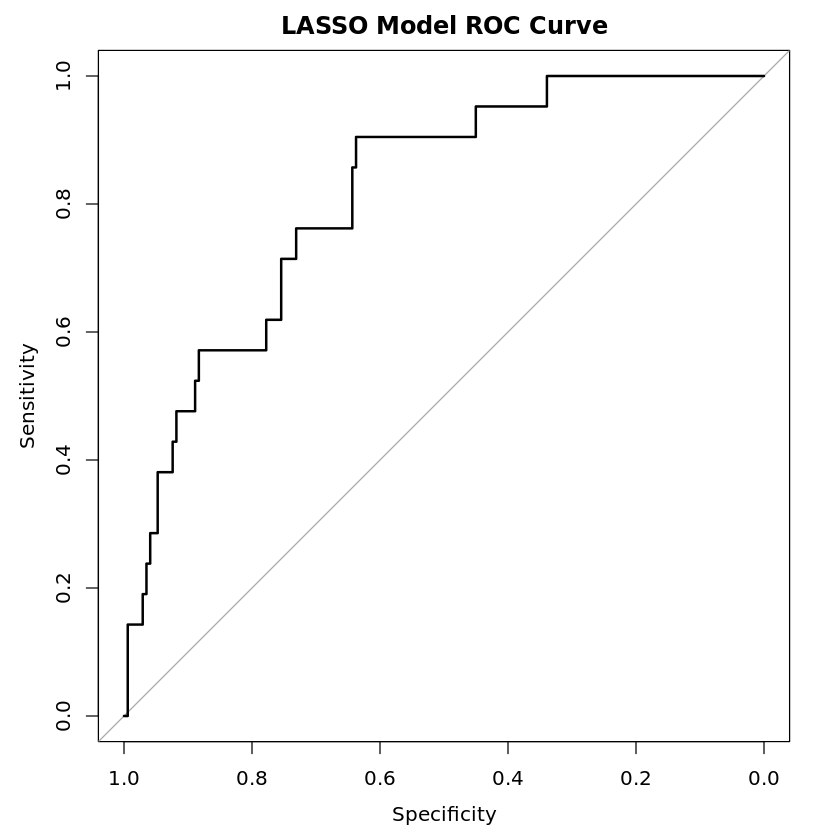

In [262]:
plot(roc_curve, main = "LASSO Model ROC Curve")

In [263]:
predicted_probs <- predict(lasso_model, newx = X_combined, s = best_lambda, type = "response")

Precision-Recall AUC: 0.3465139 


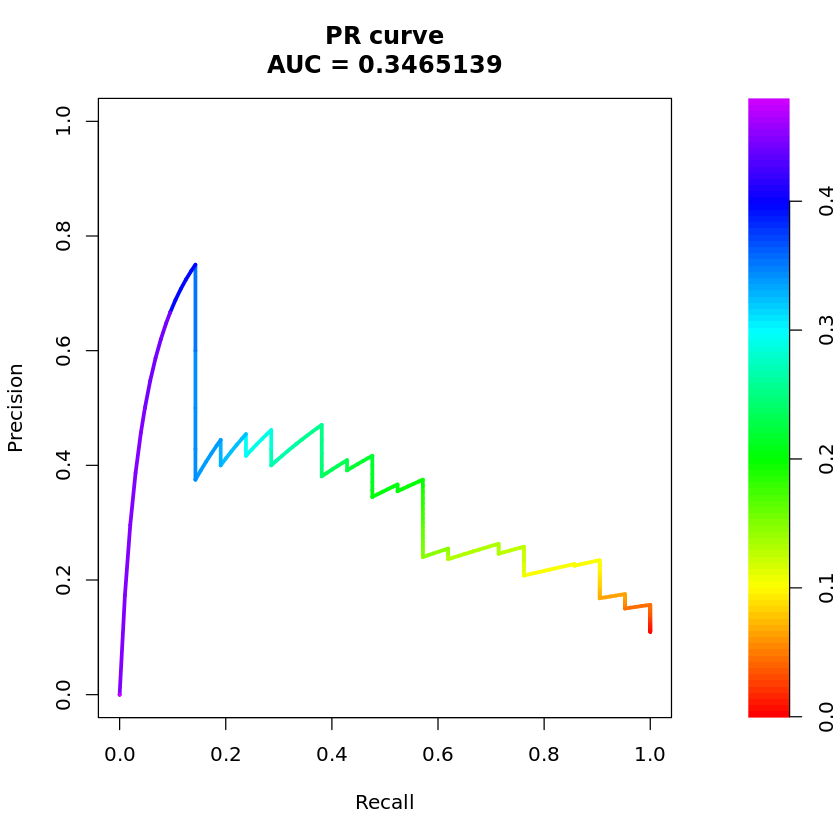

In [265]:
library(PRROC)

pr_curve <- pr.curve(scores.class0 = predicted_probs, weights.class0 = y, curve = TRUE)

cat("Precision-Recall AUC:", pr_curve$auc.integral, "\n")

plot(pr_curve)

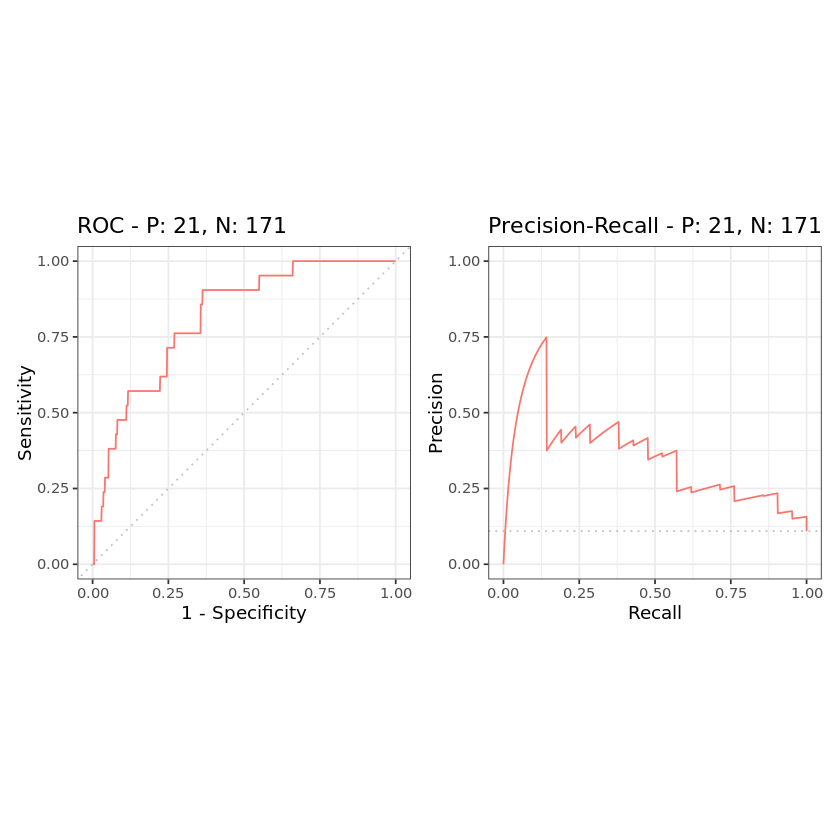

In [266]:
library(precrec)
pr <- evalmod(scores = predicted_probs, labels = y)

autoplot(pr)

In [49]:
system("gsutil cp gs://bicklab-main-storage/Users/Caitlyn_Vlasschaert/demographic_data_Aug15_participant.tsv .", intern = TRUE)

character(0)

In [50]:
data_covari <- fread('demographic_data_Aug15_participant.tsv')

In [54]:
ls(data_covari)
dim(data_covari)

[1] "age_at_death"                 "age2"                        
 [3] "any_cause_of_death_CAD"       "any_cause_of_death_cancer"   
 [5] "any_cause_of_death_infection" "baseline_age"                
 [7] "baseline_DM"                  "baseline_HTN"                
 [9] "BMI_0"                        "CAD_death"                   
[11] "cancer_death"                 "centre_0"                    
[13] "centre_1"                     "centre_2"                    
[15] "centre_3"                     "date_censored"               
[17] "date_lost_to_followup"        "date_of_death"               
[19] "date_of_enrollment"           "death"                       
[21] "diastolicBP_0"                "diastolicBP_measure1"        
[23] "diastolicBP_measure2"         "eversmoked_0"                
[25] "genetic_sex"                  "hdl_0"                       
[27] "ICD_code_death"               "ID_VUMC"                     
[29] "infection_death"              "ldl_0"                       
[31] "lost_to_followup"             "main_cause_of_death"         
[33] "packyears_0"                  "PC1"                         
[35] "PC10"                         "PC2"                         
[37] "PC3"                          "PC5"                         
[39] "PC6"                          "PC7"                         
[41] "PC8"                          "PC9"                         
[43] "PCD4"                         "reason_lost_to_followup"     
[45] "smoking_0"                    "systolicBP_0"                
[47] "systolicBP_measure1"          "systolicBP_measure2"         
[49] "tto_death"

[1] 502413     49

# rs17425819 & VTE

In [127]:
system("gsutil cp gs://bicklab-main-storage/Users/Yash_Pershad/ukb_interaction_hit_dataframes_for_plots_07192024/jak2_plt_interaction_plot_data.tsv .", intern = TRUE)

character(0)

In [3]:
jak2_germ <- fread("jak2_plt_interaction_plot_data.tsv")

In [4]:
dim(jak2_germ)
jak2_germ

[1] 487409     23

0,rs3824433,rs17425819,rs35417585,rs10815160,rs4903127,rs12555131,eid,plt,ID_VUMC,⋯,PC1,PC2,PC3,PCD4,PC5,PC6,PC7,PC8,PC9,PC10
<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1932941,1,1,0,0,0,1,1932941,227.6,1932941,⋯,-12.17250,5.391630,-1.2810300,0.8417650,-5.265210,-1.786570,3.1099200,-2.6308500,2.3928800,0.307537
5252723,0,0,2,0,1,0,5252723,339.5,5252723,⋯,-13.02450,6.415140,-0.1833650,2.9276100,-5.889640,0.940534,1.1410600,-1.9821300,-2.7022600,2.507750
5581705,0,0,0,1,1,0,5581705,215.0,5581705,⋯,-11.47120,3.483830,-1.1545800,3.0838300,7.651600,-0.913399,-1.5487900,1.4789300,-1.2089500,1.064900
5759821,1,1,0,0,0,0,5759821,206.3,5759821,⋯,-12.13270,4.029760,-0.9880800,0.7502940,-2.364310,0.431658,-0.5340710,-0.6543670,-6.5959300,-1.533560
3698512,1,1,1,1,0,0,3698512,273.6,3698512,⋯,-12.21710,3.508210,-1.6259900,-1.2268000,-5.345800,3.816790,0.5791550,-1.1695800,1.0185500,-0.795227
2506568,0,0,2,1,0,0,2506568,190.8,2506568,⋯,-11.58470,5.411310,0.7858150,-0.9403480,-6.085430,1.465410,2.6986000,0.0793596,-2.8534400,3.514010
1624024,0,0,NA,1,1,0,1624024,230.2,1624024,⋯,-11.21340,3.850100,-2.7348800,0.2869410,1.471790,1.105600,2.0884500,0.9305480,-15.8034000,-0.363750
5122184,0,0,2,1,0,0,5122184,219.5,5122184,⋯,-13.60540,5.580370,-0.7939330,-1.2637300,-5.393310,2.089420,2.0383400,-1.6938000,2.9469000,2.282790
1557160,0,0,0,1,0,0,1557160,239.6,1557160,⋯,-12.88080,3.365150,0.2331680,-3.9578700,1.987840,-0.909523,-2.5014500,-1.0400200,-8.8064700,-1.624000


In [131]:
table(jak2_germ$rs17425819, useNA = "always")
ls(jak2_germ)


     0      1      2   <NA> 
261068 190607  35734      0 

[1] "0"            "age2"         "baseline_age" "eid"          "genetic_sex" 
 [6] "ID_VUMC"      "PC1"          "PC10"         "PC2"          "PC3"         
[11] "PC5"          "PC6"          "PC7"          "PC8"          "PC9"         
[16] "PCD4"         "plt"          "rs10815160"   "rs12555131"   "rs17425819"  
[21] "rs35417585"   "rs3824433"    "rs4903127"

In [6]:
jak2_germ <- jak2_germ[,c("ID_VUMC","rs17425819")]

In [7]:
jak2_germ$ID_VUMC <- as.character(jak2_germ$ID_VUMC)

In [8]:
data_il17rb_germ <- merge(jak2_germ,data_il17rb,by.x = "ID_VUMC",by.y = "ID", all = F)

ERROR: Error: object 'data_il17rb' not found


In [141]:
dim(data_il17rb_germ)
ls(data_il17rb_germ)

[1] 487071     30

[1] "age2"                     "baseline_age"            
 [3] "baseline_DM"              "baseline_HTN"            
 [5] "BMI_0"                    "chip"                    
 [7] "CVD"                      "diastolicBP_0"           
 [9] "genetic_sex"              "ID_VUMC"                 
[11] "il17ra_262"               "il17rb_262"              
[13] "il17rb_333"               "Interleukin17_receptor_A"
[15] "Interleukin17_receptor_B" "jak2"                    
[17] "ldl_0"                    "PC1"                     
[19] "PC2"                      "PC3"                     
[21] "PC5"                      "PCD4"                    
[23] "rs17425819"               "smoking_0"               
[25] "surv_CVD"                 "surv_VTE"                
[27] "surv_VTE2"                "systolicBP_0"            
[29] "Venous thromboembolism"   "VTE"

In [142]:
data_il17rb_germ$rs17425819_score <- data_il17rb_germ$rs17425819* data_il17rb_germ$Interleukin17_receptor_B

In [143]:
summary(data_il17rb_germ$rs17425819_score)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
-4.5810 -1.6396  0.0000 -0.8385  0.0000  2.2190 

In [152]:
table(data_il17rb_germ$`Venous thromboembolism`,useNA = "always")
summary(data_il17rb_germ$surv_VTE)
summary(data_il17rb_germ$surv_VTE2)


     0      1   <NA> 
474278  12793      0 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
 -20.32   11.59   12.34   11.73   13.05   15.36 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
 -20.32   11.59   12.34   11.68   13.05   15.36 

In [159]:
table(data_il17rb_germ$VTE)
table(data_il17rb_germ$`Venous thromboembolism`)


     0      1 
472560  14511 


     0      1 
474278  12793 

In [160]:
data_il17rb_germ$VenousThromboEmbolism <- data_il17rb_germ$`Venous thromboembolism`

In [188]:
results <- analyze_cox_model(
  data = data_il17rb_germ, 
  time_var = "surv_VTE", 
  event_var = "VenousThromboEmbolism", 
  group_var = "rs17425819*Interleukin17_receptor_B", 
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1", "PC2", "PC3", "PCD4", "PC5", "ldl_0","baseline_DM","BMI_0","systolicBP_0","diastolicBP_0")
)

Call:
coxph(formula = formula, data = df_filtered)

  n= 454042, number of events= 5226 
   (25686 observations deleted due to missingness)

                                          coef  exp(coef)   se(coef)      z
rs17425819                           0.0947676  1.0994033  0.1011738  0.937
Interleukin17_receptor_B            -0.1143319  0.8919619  0.0527921 -2.166
baseline_age                         0.0095857  1.0096318  0.0259241  0.370
age2                                 0.0001509  1.0001509  0.0002318  0.651
genetic_sex                         -0.0160721  0.9840563  0.0285933 -0.562
smoking_0                            0.0319880  1.0325051  0.0197272  1.622
PC1                                 -0.0018445  0.9981572  0.0003510 -5.254
PC2                                  0.0007878  1.0007881  0.0006507  1.211
PC3                                 -0.0007333  0.9992669  0.0011687 -0.627
PCD4                                -0.0002413  0.9997588  0.0012739 -0.189
PC5                    

In [172]:
data_il17rb_jak2 <- filter(data_il17rb_germ, data_il17rb_germ$jak2 == 1)

In [176]:
dim(data_il17rb_jak2)

[1] 192  32

In [183]:
results <- analyze_cox_model(
  data = data_il17rb_jak2, 
  time_var = "surv_VTE", 
  event_var = "VenousThromboEmbolism", 
  group_var = "rs17425819*Interleukin17_receptor_B", 
  covariates = c("baseline_age", "age2", "genetic_sex", "smoking_0", "PC1", "PC2", "PC3", "PCD4", "PC5", "ldl_0","baseline_DM","BMI_0","systolicBP_0","diastolicBP_0")
)

Warning message in coxph.fit(X, Y, istrat, offset, init, control, weights = weights, :
“Ran out of iterations and did not converge”


Call:
coxph(formula = formula, data = df_filtered)

  n= 166, number of events= 4 
   (15 observations deleted due to missingness)

                                          coef  exp(coef)   se(coef)      z
rs17425819                           1.004e+02  3.879e+43  1.253e+03  0.080
Interleukin17_receptor_B            -3.512e+01  5.614e-16  2.762e+03 -0.013
baseline_age                        -9.526e+01  4.267e-42  6.387e+01 -1.491
age2                                 8.068e-01  2.241e+00  5.772e-01  1.398
genetic_sex                          3.361e+01  3.956e+14  1.631e+03  0.021
smoking_0                           -4.431e+01  5.693e-20  5.854e+03 -0.008
PC1                                 -9.797e+00  5.562e-05  2.351e+02 -0.042
PC2                                 -1.710e+01  3.748e-08  3.683e+02 -0.046
PC3                                 -1.070e+01  2.245e-05  4.403e+02 -0.024
PCD4                                -2.716e+00  6.612e-02  2.981e+02 -0.009
PC5                             

In [191]:
logistic_model <- glm(`Venous thromboembolism`~Interleukin17_receptor_B*rs17425819 + baseline_age+age2+genetic_sex+smoking_0+PC1+PC2+PC3+PCD4+PC5
                      +ldl_0+BMI_0+systolicBP_0+diastolicBP_0+baseline_DM, data = data_il17rb_germ, family = binomial)
summary(logistic_model)


Call:
glm(formula = `Venous thromboembolism` ~ Interleukin17_receptor_B * 
    rs17425819 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + 
    diastolicBP_0 + baseline_DM, family = binomial, data = data_il17rb_germ)

Coefficients:
                                      Estimate Std. Error z value Pr(>|z|)    
(Intercept)                         -5.849e+00  4.805e-01 -12.174  < 2e-16 ***
Interleukin17_receptor_B            -3.963e-02  3.445e-02  -1.151  0.24991    
rs17425819                           3.178e-02  6.640e-02   0.479  0.63224    
baseline_age                         1.981e-02  1.728e-02   1.146  0.25165    
age2                                 6.025e-05  1.544e-04   0.390  0.69646    
genetic_sex                         -8.160e-02  1.905e-02  -4.283 1.85e-05 ***
smoking_0                            3.268e-02  1.308e-02   2.498  0.01250 *  
PC1                                 -2.056e-03  2.364e-04  -8.695  

In [181]:
logistic_model <- glm(`Venous thromboembolism`~Interleukin17_receptor_B*rs17425819 + baseline_age+age2+genetic_sex+smoking_0+PC1+PC2+PC3+PCD4+PC5+ldl_0+BMI_0+systolicBP_0+diastolicBP_0+baseline_DM, data = data_il17rb_jak2, family = binomial)
summary(logistic_model)

Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”



Call:
glm(formula = `Venous thromboembolism` ~ Interleukin17_receptor_B * 
    rs17425819 + baseline_age + age2 + genetic_sex + smoking_0 + 
    PC1 + PC2 + PC3 + PCD4 + PC5 + ldl_0 + BMI_0 + systolicBP_0 + 
    diastolicBP_0 + baseline_DM, family = binomial, data = data_il17rb_jak2)

Coefficients:
                                     Estimate Std. Error z value Pr(>|z|)   
(Intercept)                         68.759670  24.191661   2.842  0.00448 **
Interleukin17_receptor_B            -4.085049   3.654078  -1.118  0.26359   
rs17425819                          -0.117618   4.158593  -0.028  0.97744   
baseline_age                        -2.649277   0.852609  -3.107  0.00189 **
age2                                 0.021828   0.007392   2.953  0.00315 **
genetic_sex                          2.247838   1.061039   2.119  0.03413 * 
smoking_0                           -1.306250   0.743504  -1.757  0.07894 . 
PC1                                 -0.093785   0.217193  -0.432  0.66588   
PC2   

# TEST t2e CHIP CVD

In [2]:
jak2_germ <- fread("jak2_plt_interaction_plot_data.tsv")
dim(jak2_germ)
jak2_germ

[1] 487409     23

0,rs3824433,rs17425819,rs35417585,rs10815160,rs4903127,rs12555131,eid,plt,ID_VUMC,⋯,PC1,PC2,PC3,PCD4,PC5,PC6,PC7,PC8,PC9,PC10
<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1932941,1,1,0,0,0,1,1932941,227.6,1932941,⋯,-12.17250,5.391630,-1.2810300,0.8417650,-5.265210,-1.786570,3.1099200,-2.6308500,2.3928800,0.307537
5252723,0,0,2,0,1,0,5252723,339.5,5252723,⋯,-13.02450,6.415140,-0.1833650,2.9276100,-5.889640,0.940534,1.1410600,-1.9821300,-2.7022600,2.507750
5581705,0,0,0,1,1,0,5581705,215.0,5581705,⋯,-11.47120,3.483830,-1.1545800,3.0838300,7.651600,-0.913399,-1.5487900,1.4789300,-1.2089500,1.064900
5759821,1,1,0,0,0,0,5759821,206.3,5759821,⋯,-12.13270,4.029760,-0.9880800,0.7502940,-2.364310,0.431658,-0.5340710,-0.6543670,-6.5959300,-1.533560
3698512,1,1,1,1,0,0,3698512,273.6,3698512,⋯,-12.21710,3.508210,-1.6259900,-1.2268000,-5.345800,3.816790,0.5791550,-1.1695800,1.0185500,-0.795227
2506568,0,0,2,1,0,0,2506568,190.8,2506568,⋯,-11.58470,5.411310,0.7858150,-0.9403480,-6.085430,1.465410,2.6986000,0.0793596,-2.8534400,3.514010
1624024,0,0,NA,1,1,0,1624024,230.2,1624024,⋯,-11.21340,3.850100,-2.7348800,0.2869410,1.471790,1.105600,2.0884500,0.9305480,-15.8034000,-0.363750
5122184,0,0,2,1,0,0,5122184,219.5,5122184,⋯,-13.60540,5.580370,-0.7939330,-1.2637300,-5.393310,2.089420,2.0383400,-1.6938000,2.9469000,2.282790
1557160,0,0,0,1,0,0,1557160,239.6,1557160,⋯,-12.88080,3.365150,0.2331680,-3.9578700,1.987840,-0.909523,-2.5014500,-1.0400200,-8.8064700,-1.624000


In [3]:
jak2_germ <- jak2_germ[,c(2:7,10)]

In [4]:
t2e_chip <- read.csv("ukb_chip_cvd_t2e_clean.csv")

In [5]:
dim(t2e_chip)
head(t2e_chip)

[1] 15153    25

,X,FID,IID,baseline_age,genetic_sex,PC1,PC2,PC3,PCD4,PC5,⋯,ldl_0,BMI_0,systolicBP_0,diastolicBP_0,baseline_DM,baseline_HTN,gene,vaf_max,CVD,surv_CVDcensor
,<int>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<int>,<dbl>,<int>,<dbl>
1,1,1000349,1000349,50,0,-11.5187,4.55878,-3.339840,-0.728848,-3.894040,⋯,2.447,32.6298,113.0,76.5,0,0,1,0.373,0,13.73854
2,2,1000484,1000484,63,0,-12.5653,2.63247,-1.002950,2.041920,-7.082530,⋯,3.163,23.0177,144.0,86.5,0,0,1,0.159,0,12.06571
3,3,1000543,1000543,51,0,-10.5675,4.34124,-1.410800,-2.689070,-6.167020,⋯,2.576,31.8457,132.5,77.0,0,0,1,0.135,0,13.91923
4,4,1000746,1000746,61,0,-11.0866,1.48433,3.597000,1.436110,-6.485720,⋯,3.770,24.2248,141.0,79.0,0,0,1,0.211,0,12.67351
5,5,1000754,1000754,60,0,-12.0704,2.92746,0.731529,1.163370,0.682129,⋯,2.711,27.1075,129.0,82.0,0,0,0,0.146,0,12.76660
6,6,1001112,1001112,52,1,-13.5407,2.31033,-4.348640,-0.251809,-5.871460,⋯,4.539,30.8898,143.0,88.5,0,0,0,0.286,0,11.66324


In [16]:
t2e_chip_all <- merge(t2e_chip,jak2_germ, by.x = "FID", by.y = "ID_VUMC", all.x = T)

In [17]:
dim(t2e_chip_all)
ls(t2e_chip_all)

[1] 15153    31

[1] "baseline_age"   "baseline_DM"    "baseline_HTN"   "BMI_0"         
 [5] "CVD"            "diastolicBP_0"  "FID"            "gene"          
 [9] "genetic_sex"    "IID"            "ldl_0"          "PC1"           
[13] "PC10"           "PC2"            "PC3"            "PC5"           
[17] "PC6"            "PC7"            "PC8"            "PC9"           
[21] "PCD4"           "rs10815160"     "rs12555131"     "rs17425819"    
[25] "rs35417585"     "rs3824433"      "rs4903127"      "surv_CVDcensor"
[29] "systolicBP_0"   "vaf_max"        "X"

In [50]:
cox <- coxph(Surv(surv_CVDcensor, CVD) ~rs4903127 + baseline_age + genetic_sex +PC1+PC2+PC3+PCD4+PC5+PC6+PC7+PC8+
             PC9+PC10+ baseline_DM + baseline_HTN + ldl_0, data = t2e_chip_all)

In [51]:
summary(cox)

Call:
coxph(formula = Surv(surv_CVDcensor, CVD) ~ rs4903127 + baseline_age + 
    genetic_sex + PC1 + PC2 + PC3 + PCD4 + PC5 + PC6 + PC7 + 
    PC8 + PC9 + PC10 + baseline_DM + baseline_HTN + ldl_0, data = t2e_chip_all)

  n= 15123, number of events= 365 
   (30 observations deleted due to missingness)

                   coef  exp(coef)   se(coef)      z Pr(>|z|)    
rs4903127     9.089e-02  1.095e+00  1.058e-01  0.859 0.390488    
baseline_age  5.528e-02  1.057e+00  9.815e-03  5.633 1.77e-08 ***
genetic_sex   6.412e-01  1.899e+00  1.100e-01  5.827 5.63e-09 ***
PC1          -4.562e-03  9.954e-01  3.350e-03 -1.362 0.173299    
PC2          -7.103e-03  9.929e-01  2.754e-03 -2.579 0.009920 ** 
PC3           1.247e-03  1.001e+00  3.166e-03  0.394 0.693737    
PCD4          5.016e-03  1.005e+00  5.519e-03  0.909 0.363419    
PC5           4.845e-03  1.005e+00  6.740e-03  0.719 0.472236    
PC6          -1.456e-03  9.985e-01  1.272e-02 -0.115 0.908822    
PC7           5.404e-03  1.005e+00 

In [7]:
library(VariantAnnotation)

Loading required package: BiocGenerics


Attaching package: ‘BiocGenerics’


The following objects are masked from ‘package:lubridate’:

    intersect, setdiff, union


The following objects are masked from ‘package:dplyr’:

    combine, intersect, setdiff, union


The following object is masked from ‘package:arrow’:

    type


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are masked from ‘package:base’:

    anyDuplicated, aperm, append, as.data.frame, basename, cbind,
    colnames, dirname, do.call, duplicated, eval, evalq, Filter, Find,
    get, grep, grepl, intersect, is.unsorted, lapply, Map, mapply,
    match, mget, order, paste, pmax, pmax.int, pmin, pmin.int,
    Position, rank, rbind, Reduce, rownames, sapply, setdiff, table,
    tapply, union, unique, unsplit, which.max, which.min


Loading required package: MatrixGenerics

Loading required package: matrixStats


Attaching package: ‘matrixStats’


The following o

In [8]:
vcf_file <- "regenie_t2e_test.vcf"
vcf2 <- readVcf(vcf_file)
print(vcf2)

vcf2_info <- as.data.frame(rowRanges(vcf2))  
vcf2_genotype <- as.data.frame(geno(vcf2)$GT) 
head(vcf2_info)
head(vcf2_genotype)

class: CollapsedVCF 
dim: 1 487409 
rowRanges(vcf):
  GRanges with 5 metadata columns: paramRangeID, REF, ALT, QUAL, FILTER
info(vcf):
  DataFrame with 0 columns: 
geno(vcf):
  List of length 1: GT
geno(header(vcf)):
      Number Type   Description
   GT 1      String Genotype   


,seqnames,start,end,width,strand,paramRangeID,REF,ALT,QUAL,FILTER
,<fct>,<int>,<int>,<int>,<fct>,<fct>,<chr>,<list>,<dbl>,<chr>
rs57306765,16,79517717,79517717,1,*,NA,T,G,NA,.


,1932941_1932941,5252723_5252723,5581705_5581705,5759821_5759821,3698512_3698512,2506568_2506568,1624024_1624024,5122184_5122184,1557160_1557160,5664412_5664412,⋯,4706542_4706542,2960099_2960099,5159034_5159034,2107230_2107230,5237399_5237399,3444006_3444006,3572103_3572103,1411537_1411537,3769254_3769254,5019605_5019605
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
rs57306765,0/0,0/1,0/1,0/0,0/0,0/1,0/0,0/0,0/0,0/0,⋯,0/0,0/1,0/1,0/0,0/1,0/1,0/0,0/0,0/0,0/0


In [9]:
vcf2_genotype[is.na(vcf2_genotype)] <- 0

In [10]:
colnames(vcf2_genotype)[1]<- "variant_id"

In [11]:
transposed_data <- transpose(vcf2_genotype, keep.names = "variant_id", make.names = "variant_id")

setnames(transposed_data, old = names(transposed_data)[-1], new = vcf2_genotype$variant_id)
setnames(transposed_data, old = "variant_id", new = "sample_id")

In [14]:
head(transposed_data)
dim(transposed_data)

,sample_id,0/0
,<chr>,<chr>
1,5252723_5252723,0/1
2,5581705_5581705,0/1
3,5759821_5759821,0/0
4,3698512_3698512,0/0
5,2506568_2506568,0/1
6,1624024_1624024,0/0


[1] 487408      2

In [15]:
colnames(transposed_data)[2]<- "rs57306765"
table(transposed_data$rs57306765)


   0/0    0/1    1/1 
376490 103714   7204 

In [18]:
transposed_data$sample_id <- sub("_.*", "", transposed_data$sample_id)

In [19]:
head(transposed_data)
dim(transposed_data)

,sample_id,rs57306765
,<chr>,<chr>
1,5252723,0/1
2,5581705,0/1
3,5759821,0/0
4,3698512,0/0
5,2506568,0/1
6,1624024,0/0


[1] 487408      2

In [20]:
t2e_chip_all <- merge(t2e_chip,transposed_data, by.x = "FID", by.y = "sample_id", all = F)
dim(t2e_chip_all)

[1] 15123    26

In [21]:
ls(t2e_chip_all)

[1] "baseline_age"   "baseline_DM"    "baseline_HTN"   "BMI_0"         
 [5] "CVD"            "diastolicBP_0"  "FID"            "gene"          
 [9] "genetic_sex"    "IID"            "ldl_0"          "PC1"           
[13] "PC10"           "PC2"            "PC3"            "PC5"           
[17] "PC6"            "PC7"            "PC8"            "PC9"           
[21] "PCD4"           "rs57306765"     "surv_CVDcensor" "systolicBP_0"  
[25] "vaf_max"        "X"

In [24]:
t2e_chip_all$rs57306765 <- ifelse(t2e_chip_all$rs57306765 == "0/0", 0 ,t2e_chip_all$rs57306765)
t2e_chip_all$rs57306765 <- ifelse(t2e_chip_all$rs57306765 == "0/1", 1 ,t2e_chip_all$rs57306765)
t2e_chip_all$rs57306765 <- ifelse(t2e_chip_all$rs57306765 == "1/1", 2 ,t2e_chip_all$rs57306765)

In [26]:
t2e_chip_all$rs57306765 <- as.numeric(t2e_chip_all$rs57306765)

In [27]:
cox <- coxph(Surv(surv_CVDcensor, CVD) ~rs57306765 + baseline_age + genetic_sex +PC1+PC2+PC3+PCD4+PC5+PC6+PC7+PC8+
             PC9+PC10+ baseline_DM + baseline_HTN + ldl_0, data = t2e_chip_all)

In [28]:
summary(cox)

Call:
coxph(formula = Surv(surv_CVDcensor, CVD) ~ rs57306765 + baseline_age + 
    genetic_sex + PC1 + PC2 + PC3 + PCD4 + PC5 + PC6 + PC7 + 
    PC8 + PC9 + PC10 + baseline_DM + baseline_HTN + ldl_0, data = t2e_chip_all)

  n= 15123, number of events= 365 

                   coef  exp(coef)   se(coef)      z Pr(>|z|)    
rs57306765    0.4131082  1.5115086  0.0972886  4.246 2.17e-05 ***
baseline_age  0.0559661  1.0575618  0.0098368  5.689 1.27e-08 ***
genetic_sex   0.6465152  1.9088773  0.1102144  5.866 4.46e-09 ***
PC1          -0.0044781  0.9955319  0.0033231 -1.348 0.177802    
PC2          -0.0068451  0.9931783  0.0027376 -2.500 0.012404 *  
PC3           0.0015809  1.0015821  0.0031644  0.500 0.617363    
PCD4          0.0050066  1.0050192  0.0055331  0.905 0.365548    
PC5           0.0054652  1.0054802  0.0067528  0.809 0.418327    
PC6          -0.0015168  0.9984844  0.0131274 -0.116 0.908016    
PC7           0.0049335  1.0049456  0.0124637  0.396 0.692232    
PC8          -0.

# Protein Measurement

In [83]:
score_yp <- fread("ukb_52k_proteome_dec12_yp.tsv")

In [84]:
dim(score_yp)

[1] 52705  1465

In [67]:
0.05/1465

[1] 3.412969e-05

In [85]:
data_ukb2 <- merge(data_all_pheno_cox2, score_yp, by.x = "ID_VUMC", by.y = "eid", all = F)

#define m-CH and l-CH

In [15]:
table(data_all_pheno_cox2$mca_status)


     0      1 
487313  15100 

In [16]:
calls_mca <- fread('mocha_ukb_autosomal_mca_calls.tsv') #17865
head(calls_mca)

Warning message in fread("mocha_ukb_autosomal_mca_calls.tsv"):
“Detected 23 column names but the data has 24 columns (i.e. invalid file). Added 1 extra default column name for the first column which is guessed to be row names or an index. Use setnames() afterwards if this guess is not correct, or fix the file write command that created the file to create a valid file.”


V1,sample_id,computed_gender,chrom,beg_GRCh38,end_GRCh38,length,p_arm,q_arm,n_sites,⋯,rel_cov,rel_cov_se,lod_lrr_baf,lod_baf_phase,n_flips,baf_conc,lod_baf_conc,type,cf,ID_VUMC
<int>,<chr>,<chr>,<chr>,<int>,<int>,<int>,<chr>,<chr>,<int>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<dbl>,<int>
1,A550465-4195510-082814-462_C08,F,chr14,18173523,107043718,88870195,C,T,21626,⋯,2.0083,0.0061,0.01,11.25,1,0.5007,0.00,CN-LOH,0.0235,3169191
2,A550465-4195510-082814-462_C12,F,chr4,104138084,105764939,1626855,N,Y,380,⋯,1.7346,0.0344,9.83,15.73,0,0.7818,3.98,Loss,0.2904,2014426
3,A550465-4195510-082814-462_H02,F,chr6,0,170805979,170805979,T,T,36711,⋯,1.9946,0.0030,0.23,3.39,0,0.5014,0.18,Undetermined,0.0123,2784781
4,A550465-4195510-082814-463_H04,F,chr7,0,57870669,57870669,T,N,14754,⋯,1.9129,0.0067,0.28,3.11,0,0.4964,0.09,Loss,0.0213,5549009
5,A550465-4195510-082814-463_H04,F,chr7,62262860,159345973,97083113,N,T,21102,⋯,2.0003,0.0057,0.60,0.90,0,0.5096,0.15,Undetermined,0.0098,5549009
6,A550465-4195510-082814-464_A05,F,chr9,0,38652964,38652964,T,N,10528,⋯,1.9995,0.0069,5.19,155.08,1,0.6158,22.79,CN-LOH,0.0912,3496920


In [18]:
#mCH
mca_df <- calls_mca
mca_df$mCH<-NA
mca_df$mCH<-ifelse(mca_df$type=="Loss" & mca_df$chrom =="chr12" & mca_df$q_arm !="N",1,mca_df$mCH)
mca_df$mCH<-ifelse(mca_df$type=="Loss" & mca_df$chrom =="chr20" & mca_df$q_arm !="N",1,mca_df$mCH)
mca_df$mCH<-ifelse(mca_df$type=="Loss" & mca_df$chrom =="chr5" & mca_df$q_arm !="N",1,mca_df$mCH)
mca_df$mCH<-ifelse(mca_df$type=="Gain" & mca_df$chrom =="chr1" & mca_df$q_arm !="N",1,mca_df$mCH)
mca_df$mCH<-ifelse(mca_df$type=="Gain" & mca_df$chrom =="chr9" & mca_df$p_arm !="N",1,mca_df$mCH)
mca_df$mCH<-ifelse(mca_df$type=="CN-LOH" & mca_df$chrom =="chr22" & mca_df$q_arm !="N",1,mca_df$mCH)
mca_df$mCH<-ifelse(mca_df$type=="CN-LOH" & mca_df$chrom =="chr9" & mca_df$p_arm !="N",1,mca_df$mCH)
mca_df$mCH<-ifelse(mca_df$type=="CN-LOH" & mca_df$chrom =="chr14" & mca_df$q_arm !="N",1,mca_df$mCH)
mca_df$mCH<-ifelse(mca_df$type=="Gain" & mca_df$chrom =="chr8" & mca_df$q_arm =="Y" & mca_df$p_arm =="Y",1,mca_df$mCH)
mca_df$mCH<-ifelse(mca_df$type=="Gain" & mca_df$chrom =="chr8" & mca_df$q_arm =="T" & mca_df$p_arm =="T",1,mca_df$mCH)
mca_df$mCH<-ifelse(mca_df$type=="Gain" & mca_df$chrom =="chr8" & mca_df$q_arm =="Y" & mca_df$p_arm =="T",1,mca_df$mCH)
mca_df$mCH<-ifelse(mca_df$type=="Gain" & mca_df$chrom =="chr8" & mca_df$q_arm =="T" & mca_df$p_arm =="Y",1,mca_df$mCH)
table(mca_df$mCH)


   1 
2065 

In [19]:
#lCH
mca_df$lCH<-NA
mca_df$lCH <- ifelse(mca_df$type == "Loss" & mca_df$chrom == "chr10" & mca_df$p_arm != "N", 1, mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Loss" & mca_df$chrom == "chr10" & mca_df$q_arm != "N", 1, mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Loss" & mca_df$chrom == "chr11" & mca_df$q_arm != "N", 1, mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Loss" & mca_df$chrom == "chr13" & mca_df$q_arm != "N", 1, mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Loss" & mca_df$chrom == "chr14" & mca_df$q_arm != "N", 1, mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Loss" & mca_df$chrom == "chr15" & mca_df$q_arm != "N", 1, mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Loss" & mca_df$chrom == "chr17" & mca_df$p_arm != "N", 1, mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Loss" & mca_df$chrom == "chr1" & mca_df$p_arm != "N", 1, mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Loss" & mca_df$chrom == "chr1" & mca_df$q_arm != "N", 1, mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Loss" & mca_df$chrom == "chr22" & mca_df$q_arm != "N", 1, mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Loss" & mca_df$chrom == "chr6" & mca_df$q_arm != "N", 1, mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Loss" & mca_df$chrom == "chr7" & mca_df$q_arm != "N", 1, mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Loss" & mca_df$chrom == "chr8" & mca_df$p_arm != "N", 1, mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Gain" & mca_df$chrom == "chr12" & mca_df$q_arm != "N", 1, mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Gain" & mca_df$chrom == "chr15" & mca_df$q_arm != "N", 1, mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Gain" & mca_df$chrom == "chr17" & mca_df$q_arm != "N", 1, mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Gain" & mca_df$chrom == "chr22" & mca_df$q_arm != "N", 1, mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Gain" & mca_df$chrom == "chr2" & mca_df$p_arm != "N", 1, mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Gain" & mca_df$chrom == "chr3" & mca_df$q_arm != "N", 1, mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Gain" & mca_df$chrom == "chr8" & mca_df$q_arm != "N", 1, mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Gain" & mca_df$chrom == "chr9" & mca_df$q_arm != "N", 1, mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "CN-LOH" & mca_df$chrom == "chr16" & mca_df$p_arm != "N", 1, mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "CN-LOH" & mca_df$chrom == "chr1" & mca_df$q_arm != "N", 1, mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "CN-LOH" & mca_df$chrom == "chr7" & mca_df$q_arm != "N", 1, mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "CN-LOH" & mca_df$chrom == "chr13" & mca_df$q_arm != "N", 1, mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "CN-LOH" & mca_df$chrom == "chr12" & mca_df$q_arm != "N", 1, mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "CN-LOH" & mca_df$chrom == "chr9" & mca_df$q_arm != "N", 1, mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Gain" & mca_df$chrom == "chr12" & mca_df$q_arm =="Y" & mca_df$p_arm =="Y",1,mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Gain" & mca_df$chrom == "chr12" & mca_df$q_arm =="T" & mca_df$p_arm =="Y",1,mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Gain" & mca_df$chrom == "chr12" & mca_df$q_arm =="Y" & mca_df$p_arm =="T",1,mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Gain" & mca_df$chrom == "chr12" & mca_df$q_arm =="T" & mca_df$p_arm =="T",1,mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Gain" & mca_df$chrom == "chr18" & mca_df$q_arm =="Y" & mca_df$p_arm =="Y",1,mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Gain" & mca_df$chrom == "chr18" & mca_df$q_arm =="T" & mca_df$p_arm =="Y",1,mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Gain" & mca_df$chrom == "chr18" & mca_df$q_arm =="Y" & mca_df$p_arm =="T",1,mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Gain" & mca_df$chrom == "chr18" & mca_df$q_arm =="T" & mca_df$p_arm =="T",1,mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Gain" & mca_df$chrom == "chr19" & mca_df$q_arm =="Y" & mca_df$p_arm =="Y",1,mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Gain" & mca_df$chrom == "chr19" & mca_df$q_arm =="T" & mca_df$p_arm =="Y",1,mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Gain" & mca_df$chrom == "chr19" & mca_df$q_arm =="Y" & mca_df$p_arm =="T",1,mca_df$lCH)
mca_df$lCH <- ifelse(mca_df$type == "Gain" & mca_df$chrom == "chr19" & mca_df$q_arm =="T" & mca_df$p_arm =="T",1,mca_df$lCH)
table(mca_df$lCH)


   1 
5413 

In [26]:
mch_person_ids <- mca_df %>%
  filter(mCH == 1) %>%
  pull(ID_VUMC)
lch_person_ids <- mca_df %>%
  filter(lCH == 1) %>%
  pull(ID_VUMC)

In [27]:
data_ukb2$lCH<-NA
data_ukb2 <- data_ukb2 %>%
  mutate(lCH = ifelse(ID_VUMC %in% lch_person_ids, 1, 0))

In [30]:
data_ukb2$mCH<-NA
data_ukb2 <- data_ukb2 %>%
  mutate(mCH = ifelse(ID_VUMC %in% mch_person_ids, 1, 0))

In [32]:
table(data_ukb2$mCH)
table(data_ukb2$lCH)
table(data_ukb2$mca_status)


    0     1 
52502   203 


    0     1 
52221   484 


    0     1 
51043  1662 

In [37]:
proteinlist <- colnames(score_yp)[3:1465] #3:1465
proteinlist

[1] "aarsd1"         "abhd14b"        "abl1"           "acaa1"         
   [5] "acan"           "ace2"           "acox1"          "acp5"          
   [9] "acp6"           "acta2"          "actn4"          "acvrl1"        
  [13] "acy1"           "ada"            "ada2"           "adam15"        
  [17] "adam22"         "adam23"         "adam8"          "adamts13"      
  [21] "adamts15"       "adamts16"       "adamts8"        "adcyap1r1"     
  [25] "adgrb3"         "adgre2"         "adgre5"         "adgrg1"        
  [29] "adgrg2"         "adh4"           "adm"            "afp"           
  [33] "ager"           "agr2"           "agr3"           "agrn"          
  [37] "agrp"           "agxt"           "ahcy"           "ahsp"          
  [41] "aif1"           "aifm1"          "ak1"            "akr1b1"        
  [45] "akr1c4"         "akt1s1"         "akt3"           "alcam"         
  [49] "aldh1a1"        "aldh3a1"        "alpp"           "ambn"          
  [53] "ambp"           "amfr"           "amigo2"         "amn"           
  [57] "amy2a"          "amy2b"          "ang"            "angpt1"        
  [61] "angpt2"         "angptl1"        "angptl2"        "angptl3"       
  [65] "angptl4"        "angptl7"        "ankrd54"        "anpep"         
  [69] "anxa10"         "anxa11"         "anxa3"          "anxa4"         
  [73] "anxa5"          "aoc1"           "aoc3"           "apbb1ip"       
  [77] "apex1"          "aplp1"          "apoh"           "apom"          
  [81] "app"            "aprt"           "areg"           "arg1"          
  [85] "arhgap1"        "arhgap25"       "arhgef12"       "arid4b"        
  [89] "arnt"           "arsa"           "arsb"           "art3"          
  [93] "artn"           "asah2"          "asgr1"          "atf2"          
  [97] "atg4a"          "atox1"          "atp5if1"        "atp5po"        
 [101] "atp6ap2"        "atp6v1d"        "atp6v1f"        "atxn10"        
 [105] "axin1"          "axl"            "azu1"           "b4galt1"       
 [109] "b4gat1"         "bach1"          "bag3"           "bag6"          
 [113] "baiap2"         "bambi"          "bank1"          "bax"           
 [117] "bcam"           "bcan"           "bcl2l11"        "bcr"           
 [121] "bgn"            "bid"            "bin2"           "birc2"         
 [125] "blmh"           "blvrb"          "bmp4"           "bmp6"          
 [129] "boc"            "bpifb1"         "brk1"           "bsg"           
 [133] "bst1"           "bst2"           "btc"            "btn2a1"        
 [137] "btn3a2"         "c19orf12"       "c1qa"           "c1qtnf1"       
 [141] "c2"             "c2cd2l"         "c4bpb"          "ca1"           
 [145] "ca11"           "ca12"           "ca13"           "ca14"          
 [149] "ca2"            "ca3"            "ca4"            "ca5a"          
 [153] "ca6"            "ca9"            "calb1"          "calb2"         
 [157] "calca"          "calcoco1"       "camkk1"         "cant1"         
 [161] "capg"           "carhsp1"        "casp1"          "casp10"        
 [165] "casp2"          "casp3"          "casp8"          "cblif"         
 [169] "cbln4"          "cc2d1a"         "ccdc80"         "ccl11"         
 [173] "ccl13"          "ccl14"          "ccl15"          "ccl16"         
 [177] "ccl17"          "ccl18"          "ccl19"          "ccl2"          
 [181] "ccl20"          "ccl21"          "ccl22"          "ccl23"         
 [185] "ccl24"          "ccl25"          "ccl26"          "ccl27"         
 [189] "ccl28"          "ccl3"           "ccl4"           "ccl5"          
 [193] "ccl7"           "ccl8"           "ccn1"           "ccn2"          
 [197] "ccn3"           "ccn4"           "ccn5"           "ccs"           
 [201] "cct5"           "cd109"          "cd14"           "cd160"         
 [205] "cd163"          "cd164"          "cd177"          "cd1c"          
 [209] "cd200"          "cd200r1"        "cd207"          "cd209"         
 [213] "cd22"           "cd2

In [38]:
result_list <- lapply(proteinlist, function(protein) {
  formula <- as.formula(paste(protein, "~ mca_status + baseline_age + age2+genetic_sex+smoking_0+PC1+PC2+PC3+PCD4+PC5"))  
  model <- lm(formula, data = data_ukb2)                          
  summary_model <- summary(model)
  
  mca_row <- coef(summary_model)["mca_status", ]
  data.frame(
    Protein = protein,
    Beta = mca_row["Estimate"],
    SE = mca_row["Std. Error"],
    P_Value = mca_row["Pr(>|t|)"]
  )
})


result_df <- do.call(rbind, result_list)
print(result_df)

                    Protein          Beta          SE      P_Value
Estimate             aarsd1  5.759690e-02 0.016021996 3.248676e-04
Estimate1           abhd14b  8.851401e-04 0.016366010 9.568684e-01
Estimate2              abl1  1.239043e-03 0.019494432 9.493218e-01
Estimate3             acaa1 -1.063683e-02 0.023726026 6.539247e-01
Estimate4              acan -1.312451e-02 0.008159014 1.077121e-01
Estimate5              ace2  1.893844e-03 0.014990605 8.994670e-01
Estimate6             acox1 -6.202128e-04 0.014005154 9.646777e-01
Estimate7              acp5 -7.990266e-03 0.009319777 3.912582e-01
Estimate8              acp6  2.388988e-02 0.018879620 2.057410e-01
Estimate9             acta2  1.564161e-02 0.012426302 2.081266e-01
Estimate10            actn4 -1.118220e-02 0.009042140 2.162131e-01
Estimate11           acvrl1  9.611649e-03 0.007207359 1.823449e-01
Estimate12             acy1  8.968631e-03 0.018417569 6.262883e-01
Estimate13              ada  3.486026e-03 0.010068842 7.291794

In [39]:
result_df <- as.data.frame(result_df)

In [41]:
result_df <- result_df %>% arrange(P_Value)
result_df

,Protein,Beta,SE,P_Value
,<chr>,<dbl>,<dbl>,<dbl>
Estimate525,fcrl2,0.25131523,0.013836496,1.715257e-73
Estimate1382,tnfrsf9,0.19754472,0.011614412,1.073022e-64
Estimate1209,sema7a,0.09677973,0.007820294,3.980929e-35
Estimate519,fcer2,0.17875409,0.014498774,7.096023e-35
Estimate1234,siglec10,0.11218896,0.009652148,3.438873e-31
Estimate524,fcrl1,0.14791336,0.012893681,1.992753e-30
Estimate691,igsf3,0.11850417,0.010529776,2.392132e-29
Estimate1372,tnfrsf13b,0.10735839,0.009604607,5.658570e-29
Estimate526,fcrl3,0.16802156,0.015368234,8.612458e-28


In [107]:
result_df <- result_df %>% arrange(Protein)
write.csv(result_df,file="Protein_mCAs.csv")

In [95]:
install.packages("sjPlot")
library(sjPlot)

Installing package into ‘/home/jupyter/packages’
(as ‘lib’ is unspecified)

also installing the dependencies ‘effectsize’, ‘bayestestR’, ‘datawizard’, ‘ggeffects’, ‘insight’, ‘parameters’, ‘performance’, ‘sjlabelled’, ‘sjmisc’, ‘sjstats’




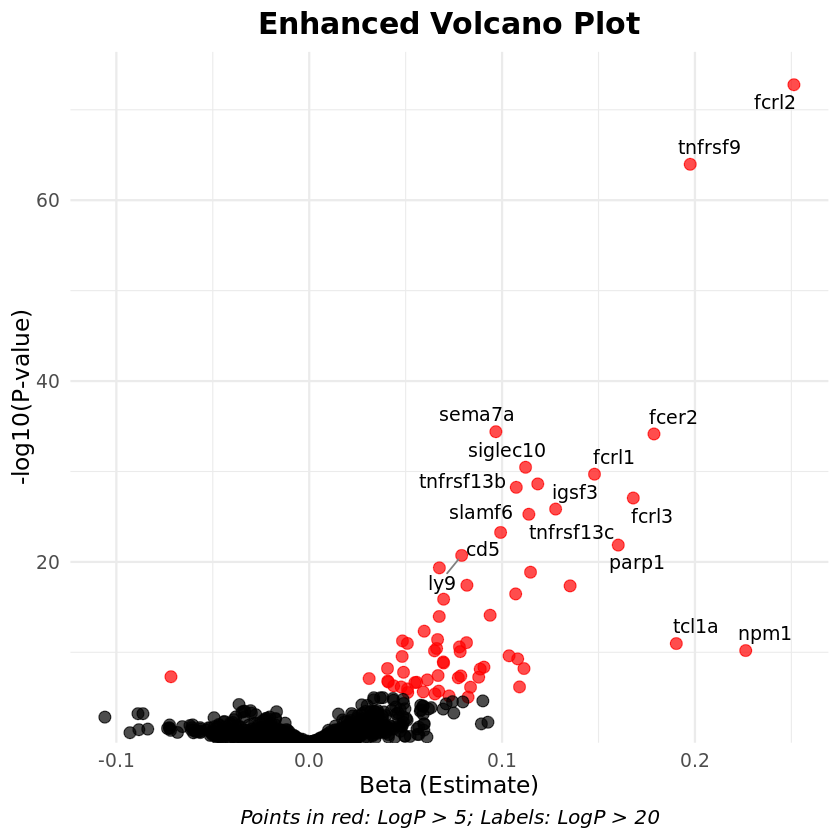

In [96]:
result_df$LogP <- -log10(result_df$P_Value)
result_df$Significant <- ifelse(result_df$LogP > 5, TRUE, FALSE)
result_df$Label <- ifelse(result_df$LogP > 20 | result_df$Beta > 0.15, result_df$Protein, "")

p <- ggplot(result_df, aes(x = Beta, y = LogP, label = Label)) +
  geom_point(aes(color = Significant), alpha = 0.7, size = 3) +  
  scale_color_manual(values = c("black", "red")) +              
  geom_text_repel(                                              
    box.padding = 0.35, 
    point.padding = 0.3, 
    max.overlaps = 10, 
    size = 4, 
    segment.color = "grey50"
  ) +
  theme_minimal(base_size = 14) +                             
  labs(
    x = "Beta (Estimate)", 
    y = "-log10(P-value)", 
    title = "Enhanced Volcano Plot",
    caption = "Points in red: LogP > 5; Labels: LogP > 20"
  ) +
  theme(
    plot.title = element_text(size = 18, face = "bold", hjust = 0.5),  
    plot.caption = element_text(size = 12, face = "italic", hjust = 0.5),  
    legend.position = "none"                            
  ) +
  scale_y_continuous(expand = expansion(mult = c(0, 0.05))) +         
  scale_x_continuous(expand = expansion(mult = c(0.05, 0.05))) 
p

In [99]:
save_plot("volcano_protein_mca.svg", fig = p, width=20, height=16)

pdf 
  2

In [69]:
sig_mca <- filter(result_df, result_df$LogP > 4.5)
dim(sig_mca)

[1] 75  6

In [72]:
sig_mca$Protein

[1] "fcrl2"     "tnfrsf9"   "sema7a"    "fcer2"     "siglec10"  "fcrl1"    
 [7] "igsf3"     "tnfrsf13b" "fcrl3"     "tnfrsf13c" "slamf6"    "cd5"      
[13] "parp1"     "ly9"       "icam3"     "cd79b"     "siglec6"   "eloa"     
[19] "stc1"      "cd48"      "cd70"      "efna4"     "adam8"     "treml2"   
[25] "ezr"       "pdcd1"     "cd200"     "tcl1a"     "cd27"      "cd74"     
[31] "npm1"      "polr2f"    "cd22"      "fcrl5"     "vcam1"     "srp14"    
[37] "fus"       "lag3"      "nbn"       "grn"       "fcrl6"     "lyar"     
[43] "adgre5"    "zbtb17"    "mad1l1"    "sdc4"      "pqbp1"     "crtam"    
[49] "cant1"     "il2ra"     "ckap4"     "lilrb1"    "tnfrsf4"   "ifnlr1"   
[55] "il18bp"    "gzmh"      "tnfrsf10a" "apex1"     "tnfrsf1b"  "cd8a"     
[61] "timd4"     "ly75"      "nfkbie"    "egln1"     "psip1"     "ebi3_il27"
[67] "rnaset2"   "gpkow"     "gzma"      "lta"       "b4galt1"   "il4r"     
[73] "nmnat1"    "pik3ap1"   "fgf2"

In [42]:
result_list <- lapply(proteinlist, function(protein) {
  formula <- as.formula(paste(protein, "~ mCH + baseline_age + age2+genetic_sex+smoking_0+PC1+PC2+PC3+PCD4+PC5"))  
  model <- lm(formula, data = data_ukb2)                          
  summary_model <- summary(model)
  
  mca_row <- coef(summary_model)["mCH", ]
  data.frame(
    Protein = protein,
    Beta = mca_row["Estimate"],
    SE = mca_row["Std. Error"],
    P_Value = mca_row["Pr(>|t|)"]
  )
})


result_mCH <- do.call(rbind, result_list)
print(result_mCH)

                    Protein          Beta          SE      P_Value
Estimate             aarsd1  1.577729e-01 0.045094939 4.679626e-04
Estimate1           abhd14b  8.462898e-02 0.045925883 6.537435e-02
Estimate2              abl1  4.486872e-02 0.054867605 4.134961e-01
Estimate3             acaa1  2.691328e-02 0.066570930 6.860087e-01
Estimate4              acan -6.464923e-02 0.022783478 4.547944e-03
Estimate5              ace2  3.697384e-02 0.042169520 3.806045e-01
Estimate6             acox1  6.985556e-02 0.039251092 7.512938e-02
Estimate7              acp5 -2.967681e-02 0.026033332 2.543106e-01
Estimate8              acp6  7.922480e-03 0.053392265 8.820415e-01
Estimate9             acta2  2.500053e-02 0.034956609 4.744965e-01
Estimate10            actn4  1.997330e-02 0.025414855 4.319352e-01
Estimate11           acvrl1  5.984328e-04 0.020232493 9.764039e-01
Estimate12             acy1  2.795483e-03 0.051619122 9.568111e-01
Estimate13              ada  3.920120e-02 0.028454712 1.683112

In [43]:
result_mCH <- as.data.frame(result_mCH)
result_mCH <- result_mCH %>% arrange(P_Value)
result_mCH

,Protein,Beta,SE,P_Value
,<chr>,<dbl>,<dbl>,<dbl>
Estimate390,cxcl11,0.47208716,0.06328944,8.842790e-14
Estimate610,gp1ba,0.14819041,0.02592221,1.091958e-08
Estimate465,egfr,-0.06481866,0.01292440,5.314827e-07
Estimate54,amigo2,0.09127520,0.01823901,5.622493e-07
Estimate1202,sdc4,-0.18171562,0.03685142,8.205158e-07
Estimate28,adgrg2,-0.10312484,0.02219516,3.388218e-06
Estimate1237,siglec6,0.12242054,0.02663847,4.324660e-06
Estimate669,icam2,0.11415634,0.02511971,5.519230e-06
Estimate433,dner,-0.09298287,0.02075268,7.462222e-06


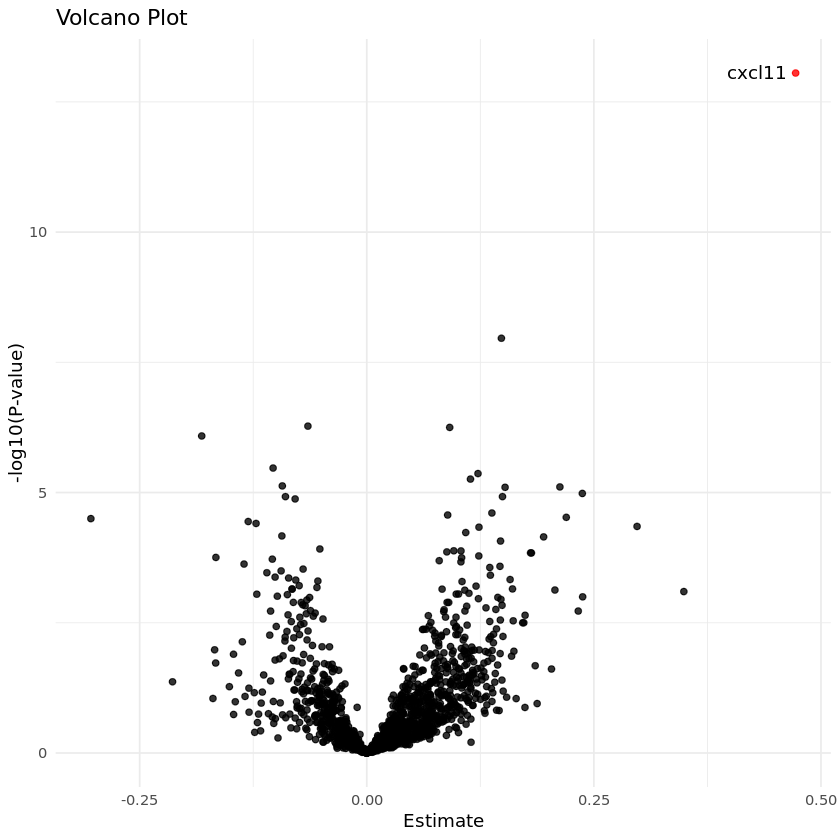

In [50]:
result_mCH$LogP <- -log10(result_mCH$P_Value)

threshold <- 10  
result_mCH$Significant <- ifelse(result_mCH$LogP > threshold, TRUE, FALSE)


ggplot(result_mCH, aes(x = Beta, y = LogP, label = ifelse(Significant, Protein, ""))) +
  geom_point(aes(color = Significant), alpha = 0.8) +  
  scale_color_manual(values = c("black", "red")) +     
  geom_text_repel(box.padding = 0.3, max.overlaps = 10) +  
  theme_minimal() +
  labs(
    x = "Estimate",
    y = "-log10(P-value)",
    title = "Volcano Plot"
  ) +
  theme(
    legend.position = "none"
  )

In [46]:
#lCH
result_list <- lapply(proteinlist, function(protein) {
  formula <- as.formula(paste(protein, "~ lCH + baseline_age + age2+genetic_sex+smoking_0+PC1+PC2+PC3+PCD4+PC5"))  
  model <- lm(formula, data = data_ukb2)                          
  summary_model <- summary(model)
  
  mca_row <- coef(summary_model)["lCH", ]
  data.frame(
    Protein = protein,
    Beta = mca_row["Estimate"],
    SE = mca_row["Std. Error"],
    P_Value = mca_row["Pr(>|t|)"]
  )
})


result_lCH <- do.call(rbind, result_list)
result_lCH <- as.data.frame(result_lCH)
result_lCH <- result_lCH %>% arrange(P_Value)
result_lCH

,Protein,Beta,SE,P_Value
,<chr>,<dbl>,<dbl>,<dbl>
Estimate525,fcrl2,0.7751151,0.02531891,5.460028e-204
Estimate1382,tnfrsf9,0.5947729,0.02113505,6.542436e-173
Estimate519,fcer2,0.7019017,0.02638334,6.971195e-155
Estimate524,fcrl1,0.5237600,0.02341350,2.618547e-110
Estimate1373,tnfrsf13c,0.4548996,0.02191646,2.723507e-95
Estimate526,fcrl3,0.5370277,0.02815993,8.569743e-81
Estimate1209,sema7a,0.2624423,0.01422071,8.359203e-76
Estimate232,cd5,0.3317388,0.01797641,8.495521e-76
Estimate1234,siglec10,0.3210039,0.01757072,2.512857e-74


In [106]:
result_lCH <- result_lCH %>% arrange(Protein)
write.csv(result_lCH,file="Protein_l_mCAs.csv")

Warning message:
“ggrepel: 9 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


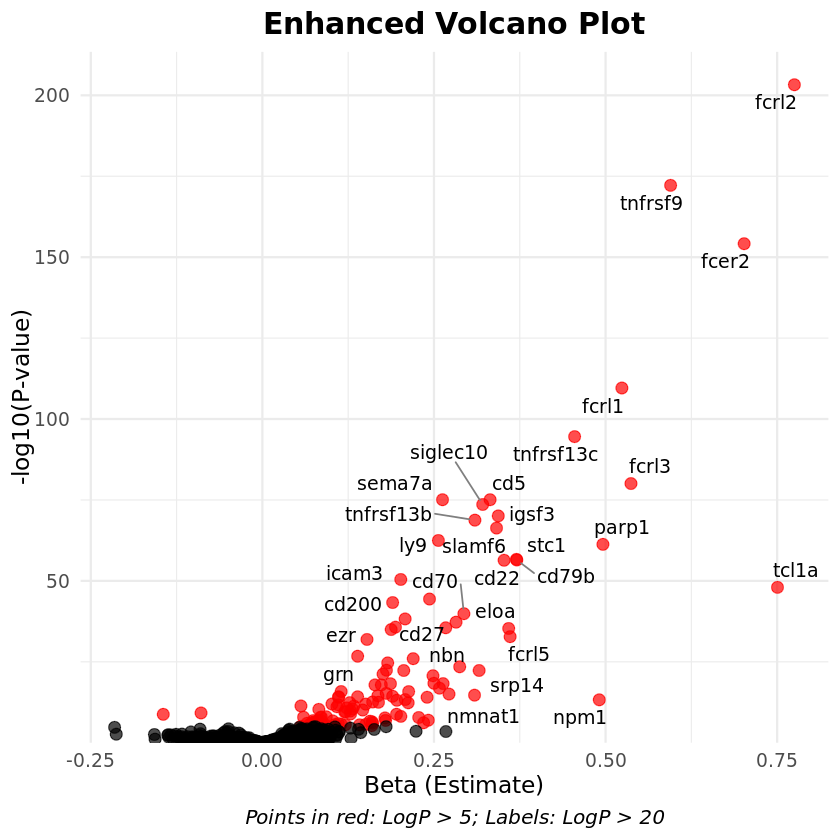

In [100]:
result_lCH$LogP <- -log10(result_lCH$P_Value)
result_lCH$Significant <- ifelse(result_lCH$LogP > 5, TRUE, FALSE)
result_lCH$Label <- ifelse(result_lCH$LogP > 20 | result_lCH$Beta > 0.3, result_lCH$Protein, "")

p <- ggplot(result_lCH, aes(x = Beta, y = LogP, label = Label)) +
  geom_point(aes(color = Significant), alpha = 0.7, size = 3) +  
  scale_color_manual(values = c("black", "red")) +              
  geom_text_repel(                                              
    box.padding = 0.35, 
    point.padding = 0.3, 
    max.overlaps = 10, 
    size = 4, 
    segment.color = "grey50"
  ) +
  theme_minimal(base_size = 14) +                             
  labs(
    x = "Beta (Estimate)", 
    y = "-log10(P-value)", 
    title = "Enhanced Volcano Plot",
    caption = "Points in red: LogP > 5; Labels: LogP > 20"
  ) +
  theme(
    plot.title = element_text(size = 18, face = "bold", hjust = 0.5),  
    plot.caption = element_text(size = 12, face = "italic", hjust = 0.5),  
    legend.position = "none"                            
  ) +
  scale_y_continuous(expand = expansion(mult = c(0, 0.05))) +         
  scale_x_continuous(expand = expansion(mult = c(0.05, 0.05))) 
p

In [101]:
save_plot("volcano_protein_lmca.svg", fig = p, width=20, height=16)

Warning message:
“ggrepel: 15 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


pdf 
  2

In [70]:
sig_l_mca <- filter(result_lCH, result_lCH$LogP > 4.5)
dim(sig_l_mca)

[1] 123   6

In [73]:
#high risk CLL mCA

In [74]:
table(data_ukb2$mca_highrisk)


    0     1     2 
51043   224  1438 

In [80]:
data_ukb_highrisk <- filter(data_ukb2, data_ukb2$mca_highrisk == 0 | data_ukb2$mca_highrisk == 1)

In [82]:
data_ukb_highrisk$mca_highrisk2 <- NA
data_ukb_highrisk$mca_highrisk2 <- ifelse(data_ukb_highrisk$mca_highrisk == 0, 1 ,2)

In [83]:
table(data_ukb_highrisk$mca_highrisk2)


    1     2 
51043   224 

In [86]:
#high risk 
result_list <- lapply(proteinlist, function(protein) {
  formula <- as.formula(paste(protein, "~ mca_highrisk2 + baseline_age + age2+genetic_sex+smoking_0+PC1+PC2+PC3+PCD4+PC5"))  
  model <- lm(formula, data = data_ukb_highrisk)                          
  summary_model <- summary(model)
  
  mca_row <- coef(summary_model)["mca_highrisk2", ]
  data.frame(
    Protein = protein,
    Beta = mca_row["Estimate"],
    SE = mca_row["Std. Error"],
    P_Value = mca_row["Pr(>|t|)"]
  )
})


result_highrisk <- do.call(rbind, result_list)
result_highrisk <- as.data.frame(result_highrisk)
result_highrisk <- result_highrisk %>% arrange(P_Value)
result_highrisk

,Protein,Beta,SE,P_Value
,<chr>,<dbl>,<dbl>,<dbl>
Estimate525,fcrl2,1.3717580,0.03638210,8.726411e-307
Estimate519,fcer2,1.2872590,0.03817556,1.836074e-246
Estimate1382,tnfrsf9,0.9751000,0.03057437,6.010902e-221
Estimate524,fcrl1,0.9180533,0.03401630,2.845834e-159
Estimate1373,tnfrsf13c,0.8311047,0.03217164,3.611488e-146
Estimate526,fcrl3,1.0167946,0.04135916,1.192664e-132
Estimate232,cd5,0.6202462,0.02620052,3.262442e-123
Estimate691,igsf3,0.6478857,0.02806019,2.492319e-117
Estimate1023,parp1,0.9564200,0.04367542,8.559643e-106


In [108]:
result_highrisk <- result_highrisk %>% arrange(Protein)
write.csv(result_highrisk,file="Protein_highrisk_mCAs.csv")

Warning message:
“ggrepel: 27 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


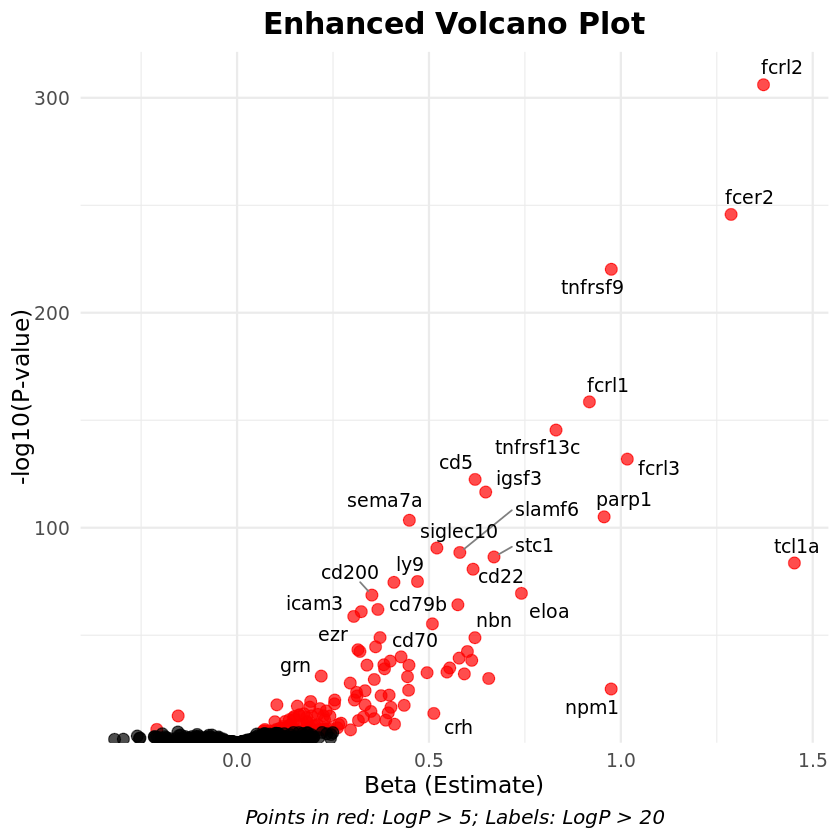

In [102]:
result_highrisk$LogP <- -log10(result_highrisk$P_Value)
result_highrisk$Significant <- ifelse(result_highrisk$LogP > 5, TRUE, FALSE)
result_highrisk$Label <- ifelse(result_highrisk$LogP > 20 | result_highrisk$Beta > 0.5, result_highrisk$Protein, "")

p <- ggplot(result_highrisk, aes(x = Beta, y = LogP, label = Label)) +
  geom_point(aes(color = Significant), alpha = 0.7, size = 3) +  
  scale_color_manual(values = c("black", "red")) +              
  geom_text_repel(                                              
    box.padding = 0.35, 
    point.padding = 0.3, 
    max.overlaps = 10, 
    size = 4, 
    segment.color = "grey50"
  ) +
  theme_minimal(base_size = 14) +                             
  labs(
    x = "Beta (Estimate)", 
    y = "-log10(P-value)", 
    title = "Enhanced Volcano Plot",
    caption = "Points in red: LogP > 5; Labels: LogP > 20"
  ) +
  theme(
    plot.title = element_text(size = 18, face = "bold", hjust = 0.5),  
    plot.caption = element_text(size = 12, face = "italic", hjust = 0.5),  
    legend.position = "none"                            
  ) +
  scale_y_continuous(expand = expansion(mult = c(0, 0.05))) +         
  scale_x_continuous(expand = expansion(mult = c(0.05, 0.05))) 
p

In [103]:
save_plot("volcano_protein_highriskmca.svg", fig = p, width=20, height=16)

Warning message:
“ggrepel: 33 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


pdf 
  2

#CF-mCA

In [111]:
dim(data_ukb2)

[1] 52705  6317

In [113]:
data_ukb_mca <- filter(data_ukb2, data_ukb2$mca_status == 1)

In [114]:
dim(data_ukb_mca)

[1] 1662 6317

In [116]:
summary(data_ukb_mca$cf_max)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
0.00820 0.02690 0.04495 0.11228 0.12390 0.82310      64 

In [128]:
result_list <- lapply(proteinlist, function(protein) {
  formula <- as.formula(paste(protein, "~ cf_max + baseline_age + age2+genetic_sex+smoking_0+PC1+PC2+PC3+PCD4+PC5"))  
  model <- lm(formula, data = data_ukb_mca)                          
  summary_model <- summary(model)
  
  mca_row <- coef(summary_model)["cf_max", ]
  data.frame(
    Protein = protein,
    Beta = mca_row["Estimate"],
    SE = mca_row["Std. Error"],
    P_Value = mca_row["Pr(>|t|)"]
  )
})


In [129]:
result_cf_mca <- do.call(rbind, result_list)
result_cf_mca <- as.data.frame(result_cf_mca)
result_cf_mca <- result_cf_mca %>% arrange(P_Value)
result_cf_mca

,Protein,Beta,SE,P_Value
,<chr>,<dbl>,<dbl>,<dbl>
Estimate519,fcer2,2.3404160,0.17109627,2.648609e-40
Estimate1382,tnfrsf9,1.7106884,0.13210283,1.779951e-36
Estimate524,fcrl1,1.6576135,0.13043503,2.859041e-35
Estimate1023,parp1,1.9263263,0.15446289,4.290212e-34
Estimate1373,tnfrsf13c,1.4960689,0.12245120,8.363667e-33
Estimate1209,sema7a,0.9159044,0.07704631,2.942751e-31
Estimate1248,slamf6,1.1367706,0.09600562,5.457662e-31
Estimate18,adam8,0.8288046,0.07201346,1.769701e-29
Estimate1234,siglec10,1.0682972,0.09357308,4.753442e-29


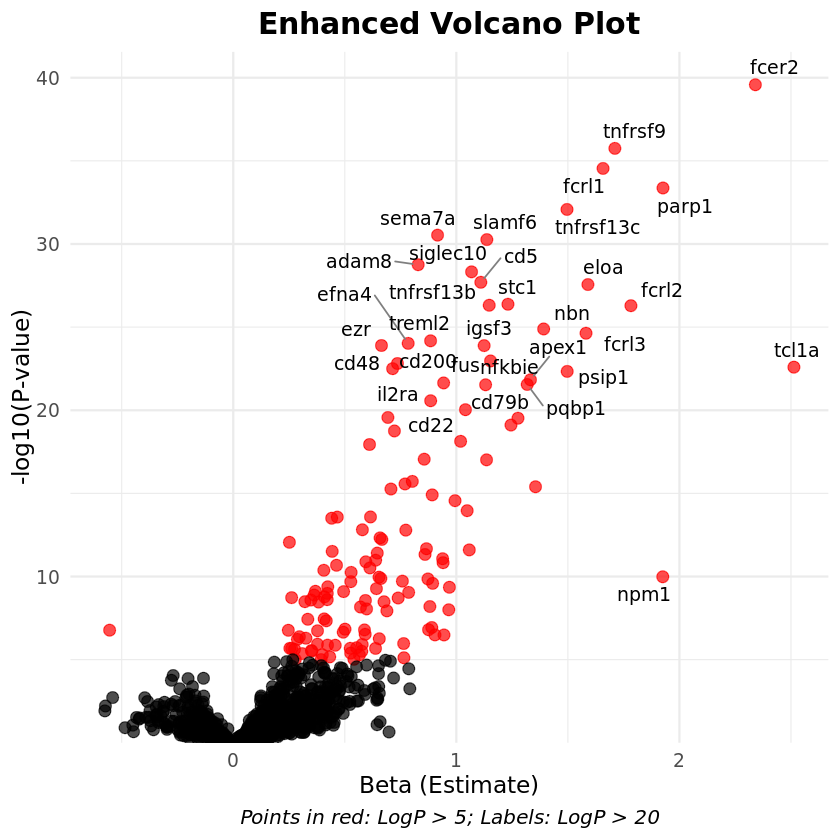

In [130]:
result_cf_mca$LogP <- -log10(result_cf_mca$P_Value)
result_cf_mca$Significant <- ifelse(result_cf_mca$LogP > 5, TRUE, FALSE)
result_cf_mca$Label <- ifelse(result_cf_mca$LogP > 20 | result_cf_mca$Beta > 1.5, result_cf_mca$Protein, "")

p <- ggplot(result_cf_mca, aes(x = Beta, y = LogP, label = Label)) +
  geom_point(aes(color = Significant), alpha = 0.7, size = 3) +  
  scale_color_manual(values = c("black", "red")) +              
  geom_text_repel(                                              
    box.padding = 0.35, 
    point.padding = 0.3, 
    max.overlaps = 10, 
    size = 4, 
    segment.color = "grey50"
  ) +
  theme_minimal(base_size = 14) +                             
  labs(
    x = "Beta (Estimate)", 
    y = "-log10(P-value)", 
    title = "Enhanced Volcano Plot",
    caption = "Points in red: LogP > 5; Labels: LogP > 20"
  ) +
  theme(
    plot.title = element_text(size = 18, face = "bold", hjust = 0.5),  
    plot.caption = element_text(size = 12, face = "italic", hjust = 0.5),  
    legend.position = "none"                            
  ) +
  scale_y_continuous(expand = expansion(mult = c(0, 0.05))) +         
  scale_x_continuous(expand = expansion(mult = c(0.05, 0.05))) 
p

In [121]:
save_plot("volcano_protein_CF.svg", fig = p, width=20, height=16)

pdf 
  2

In [148]:
result_cf_mca <- result_cf_mca %>% arrange(Protein)
write.csv(result_cf_mca,file="Protein_CF_mCAs.csv")

#CF-lmCA

In [124]:
data_ukb_lmca <- filter(data_ukb2, data_ukb2$lCH == 1)

In [125]:
dim(data_ukb_lmca)

[1]  484 6317

In [131]:
result_list <- lapply(proteinlist, function(protein) {
  formula <- as.formula(paste(protein, "~ cf_max + baseline_age + age2+genetic_sex+smoking_0+PC1+PC2+PC3+PCD4+PC5"))  
  model <- lm(formula, data = data_ukb_lmca)                          
  summary_model <- summary(model)
  
  mca_row <- coef(summary_model)["cf_max", ]
  data.frame(
    Protein = protein,
    Beta = mca_row["Estimate"],
    SE = mca_row["Std. Error"],
    P_Value = mca_row["Pr(>|t|)"]
  )
})


In [132]:
result_cf_lmca <- do.call(rbind, result_list)
result_cf_lmca <- as.data.frame(result_cf_lmca)
result_cf_lmca <- result_cf_lmca %>% arrange(P_Value)
result_cf_lmca

,Protein,Beta,SE,P_Value
,<chr>,<dbl>,<dbl>,<dbl>
Estimate519,fcer2,4.623218,0.3644310,8.340798e-32
Estimate524,fcrl1,3.144670,0.2629733,7.064464e-29
Estimate1023,parp1,3.897119,0.3284281,1.589907e-28
Estimate499,ezr,1.512802,0.1287827,4.713383e-28
Estimate471,eloa,3.203866,0.2731027,6.080076e-28
Estimate1382,tnfrsf9,3.238861,0.2779660,1.308423e-27
Estimate1373,tnfrsf13c,2.954666,0.2555948,3.575125e-27
Estimate18,adam8,1.656565,0.1444433,5.934208e-27
Estimate1298,stc1,2.428601,0.2156409,3.703706e-26


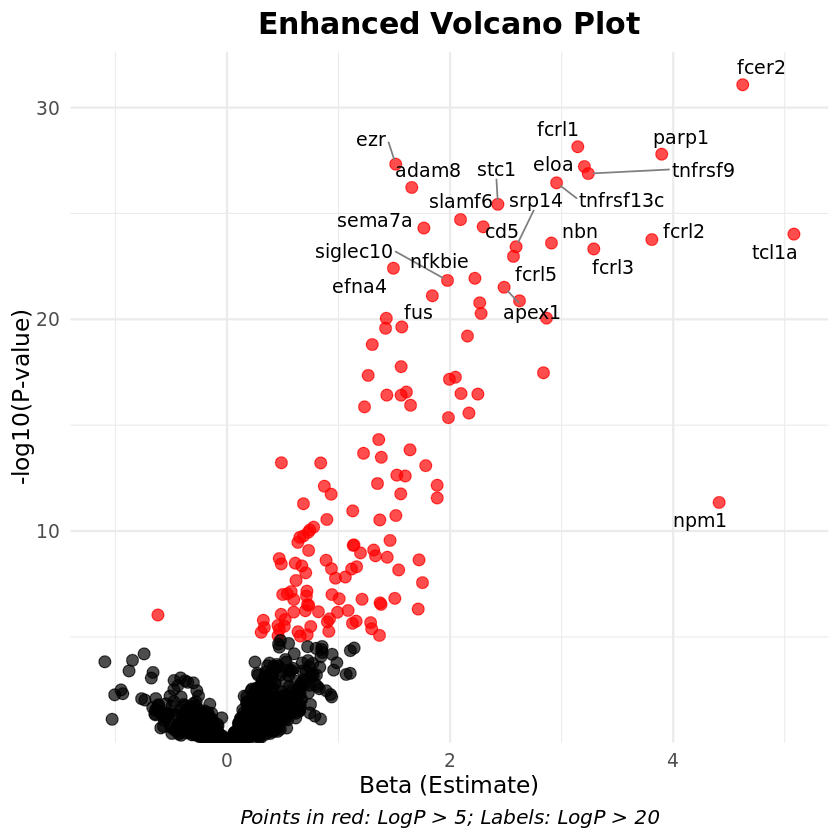

In [137]:
result_cf_lmca$LogP <- -log10(result_cf_lmca$P_Value)
result_cf_lmca$Significant <- ifelse(result_cf_lmca$LogP > 5, TRUE, FALSE)
result_cf_lmca$Label <- ifelse(result_cf_lmca$LogP > 21 | result_cf_lmca$Beta > 3, result_cf_lmca$Protein, "")

p <- ggplot(result_cf_lmca, aes(x = Beta, y = LogP, label = Label)) +
  geom_point(aes(color = Significant), alpha = 0.7, size = 3) +  
  scale_color_manual(values = c("black", "red")) +              
  geom_text_repel(                                              
    box.padding = 0.35, 
    point.padding = 0.3, 
    max.overlaps = 10, 
    size = 4, 
    segment.color = "grey50"
  ) +
  theme_minimal(base_size = 14) +                             
  labs(
    x = "Beta (Estimate)", 
    y = "-log10(P-value)", 
    title = "Enhanced Volcano Plot",
    caption = "Points in red: LogP > 5; Labels: LogP > 20"
  ) +
  theme(
    plot.title = element_text(size = 18, face = "bold", hjust = 0.5),  
    plot.caption = element_text(size = 12, face = "italic", hjust = 0.5),  
    legend.position = "none"                            
  ) +
  scale_y_continuous(expand = expansion(mult = c(0, 0.05))) +         
  scale_x_continuous(expand = expansion(mult = c(0.05, 0.05))) 
p

In [138]:
save_plot("volcano_protein_CF_lmCA.svg", fig = p, width=20, height=16)

pdf 
  2

In [149]:
result_cf_lmca <- result_cf_lmca %>% arrange(Protein)
write.csv(result_cf_lmca,file="Protein_CF_lmCAs.csv")

#CF-highrisk

In [142]:
data_ukb_highrisk <- filter(data_ukb2, data_ukb2$mca_highrisk == 1)

In [143]:
dim(data_ukb_highrisk)

[1]  224 6317

In [144]:
result_list <- lapply(proteinlist, function(protein) {
  formula <- as.formula(paste(protein, "~ cf_max + baseline_age + age2+genetic_sex+smoking_0+PC1+PC2+PC3+PCD4+PC5"))  
  model <- lm(formula, data = data_ukb_highrisk)                          
  summary_model <- summary(model)
  
  mca_row <- coef(summary_model)["cf_max", ]
  data.frame(
    Protein = protein,
    Beta = mca_row["Estimate"],
    SE = mca_row["Std. Error"],
    P_Value = mca_row["Pr(>|t|)"]
  )
})


In [145]:
result_cf_highr <- do.call(rbind, result_list)
result_cf_highr <- as.data.frame(result_cf_highr)
result_cf_highr <- result_cf_highr %>% arrange(P_Value)
result_cf_highr

,Protein,Beta,SE,P_Value
,<chr>,<dbl>,<dbl>,<dbl>
Estimate1023,parp1,5.076674,0.4979216,5.646720e-20
Estimate519,fcer2,5.455728,0.5649447,2.139171e-18
Estimate963,nfkbie,2.966927,0.3077844,3.361067e-18
Estimate232,cd5,2.901444,0.3068305,8.408487e-18
Estimate462,efna4,1.952985,0.2091615,1.958853e-17
Estimate1382,tnfrsf9,3.908018,0.4187070,2.006680e-17
Estimate1050,pik3ap1,2.894168,0.3146060,4.445119e-17
Estimate524,fcrl1,3.513176,0.3875761,1.046879e-16
Estimate1248,slamf6,2.575911,0.2828364,1.075109e-16


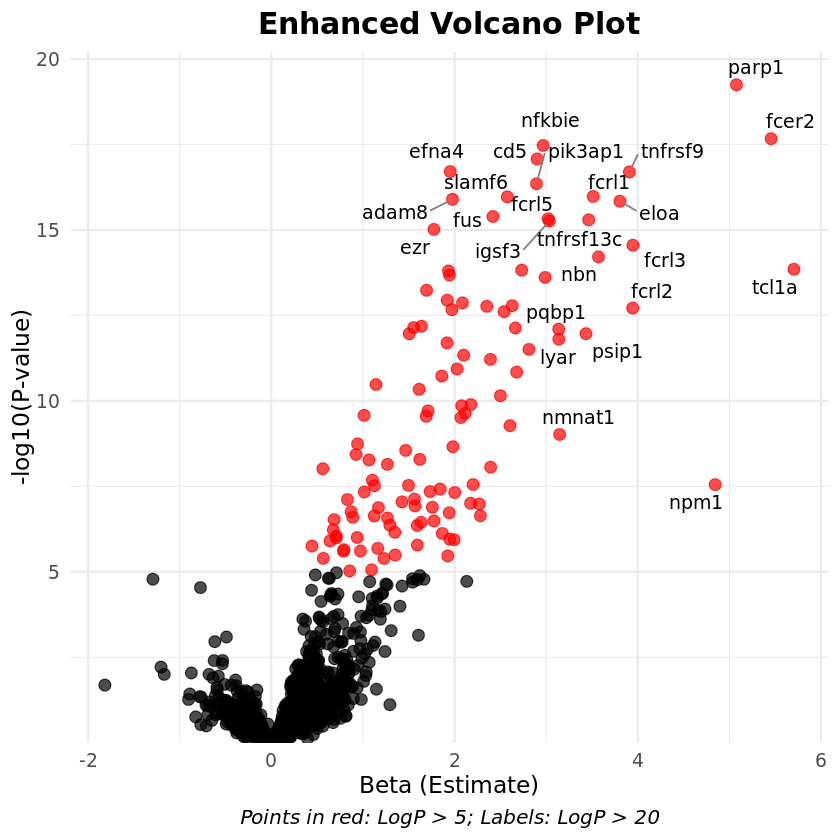

In [146]:
result_cf_highr$LogP <- -log10(result_cf_highr$P_Value)
result_cf_highr$Significant <- ifelse(result_cf_highr$LogP > 5, TRUE, FALSE)
result_cf_highr$Label <- ifelse(result_cf_highr$LogP > 15 | result_cf_highr$Beta > 3, result_cf_highr$Protein, "")

p <- ggplot(result_cf_highr, aes(x = Beta, y = LogP, label = Label)) +
  geom_point(aes(color = Significant), alpha = 0.7, size = 3) +  
  scale_color_manual(values = c("black", "red")) +              
  geom_text_repel(                                              
    box.padding = 0.35, 
    point.padding = 0.3, 
    max.overlaps = 10, 
    size = 4, 
    segment.color = "grey50"
  ) +
  theme_minimal(base_size = 14) +                             
  labs(
    x = "Beta (Estimate)", 
    y = "-log10(P-value)", 
    title = "Enhanced Volcano Plot",
    caption = "Points in red: LogP > 5; Labels: LogP > 20"
  ) +
  theme(
    plot.title = element_text(size = 18, face = "bold", hjust = 0.5),  
    plot.caption = element_text(size = 12, face = "italic", hjust = 0.5),  
    legend.position = "none"                            
  ) +
  scale_y_continuous(expand = expansion(mult = c(0, 0.05))) +         
  scale_x_continuous(expand = expansion(mult = c(0.05, 0.05))) 
p

In [147]:
save_plot("volcano_protein_CF_highrisk.svg", fig = p, width=20, height=16)

pdf 
  2

In [ ]:
result_cf_highr <- result_cf_highr %>% arrange(Protein)
write.csv(result_cf_highr,file="Protein_CF_hr_mCAs.csv")

# Genetically predicted proteins and mCAs (Quit)

In [55]:
head(data_all_pheno_cox2)

ID_VUMC,min_date,baseline_age,age2,death,tto_death,CAD_death,cancer_death,infection_death,main_cause_of_death,⋯,mca_status,chip,surv_Sepsis,surv_SIRS,SIRS,surv_cll,cll,cf_max,cf_cat,mca_highrisk
<int>,<IDate>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<chr>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<fct>
1000013,2007-11-08,48,2304,0,5004,0,0,0,,⋯,0,0,13.70021,13.70021,0,13.70021,0,NA,0,0
1000024,2009-11-30,54,2916,0,4251,0,0,0,,⋯,0,0,11.63860,11.63860,0,11.63860,0,NA,0,0
1000036,2008-04-12,67,4489,0,4848,0,0,0,,⋯,0,0,13.27310,13.27310,0,13.27310,0,NA,0,0
1000048,2007-08-07,60,3600,0,5097,0,0,0,,⋯,0,0,13.95483,13.95483,0,13.95483,0,NA,0,0
1000055,2009-01-29,40,1600,0,4556,0,0,0,,⋯,0,0,12.47365,12.47365,0,12.47365,0,NA,0,0
1000067,2008-04-12,64,4096,0,4848,0,0,0,,⋯,0,0,13.27310,13.27310,0,13.27310,0,NA,0,0


In [56]:
data_clean <- data_all_pheno_cox2[,c("ID_VUMC","mca_status","baseline_age", "age2", "genetic_sex", "smoking_0", "PC1","PC2","PC3","PCD4","PC5")]

In [57]:
data_clean2 <- merge(data_clean, score_kz, by.x = "ID_VUMC", by.y = "ID", all = F)

In [59]:
dim(data_clean2)

[1] 487071   2084

In [60]:
data_clean2$lCH<-NA
data_clean2 <- data_clean2 %>%
  mutate(lCH = ifelse(ID_VUMC %in% lch_person_ids, 1, 0))

data_clean2$mCH<-NA
data_clean2 <- data_clean2 %>%
  mutate(mCH = ifelse(ID_VUMC %in% mch_person_ids, 1, 0))

In [61]:
table(data_clean2$mCH)
table(data_clean2$lCH)
table(data_clean2$mca_status)


     0      1 
485137   1934 


     0      1 
482643   4428 


     0      1 
472009  15062 

In [63]:
pro_list <- colnames(score_kz)[-1]

In [64]:
result_list <- lapply(pro_list, function(protein) {
  formula <- as.formula(paste(protein, "~ mca_status + baseline_age + age2+genetic_sex+smoking_0+PC1+PC2+PC3+PCD4+PC5"))  
  model <- lm(formula, data = data_clean2)                          
  summary_model <- summary(model)
  
  mca_row <- coef(summary_model)["mca_status", ]
  data.frame(
    Protein = protein,
    Beta = mca_row["Estimate"],
    SE = mca_row["Std. Error"],
    P_Value = mca_row["Pr(>|t|)"]
  )
})


result_gp_mca <- do.call(rbind, result_list)

# Meta-JAK2&CVD

In [78]:
install.packages("metafor")
library(metafor)

Installing package into ‘/home/jupyter/packages’
(as ‘lib’ is unspecified)

also installing the dependencies ‘metadat’, ‘mathjaxr’


Loading required package: Matrix


Attaching package: ‘Matrix’


The following objects are masked from ‘package:tidyr’:

    expand, pack, unpack


Loading required package: metadat

Loading required package: numDeriv


Loading the 'metafor' package (version 4.8-0). For an
introduction to the package please type: help(metafor)




In [95]:
meta_data <- data.frame(
  study = c("U", "A", "B"),
  beta = c(-1.5333, -0.03018827, -1.835992),
  se = c(0.4868, 0.2190812, 0.7468469)
)

In [92]:
exp(-1.835992)

[1] 0.1594552

In [96]:
meta_analysis <- rma(
  yi = beta,       
  sei = se,        
  data = meta_data,
  method = "REML"  
)

summary(meta_analysis)


Random-Effects Model (k = 3; tau^2 estimator: REML)

  logLik  deviance       AIC       BIC      AICc   
 -2.8547    5.7094    9.7094    7.0957   21.7094   

tau^2 (estimated amount of total heterogeneity): 0.8295 (SE = 1.0808)
tau (square root of estimated tau^2 value):      0.9108
I^2 (total heterogeneity / total variability):   80.41%
H^2 (total variability / sampling variability):  5.10

Test for Heterogeneity:
Q(df = 2) = 11.9617, p-val = 0.0025

Model Results:

estimate      se     zval    pval    ci.lb   ci.ub    
 -0.9991  0.5978  -1.6712  0.0947  -2.1708  0.1726  . 

---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1


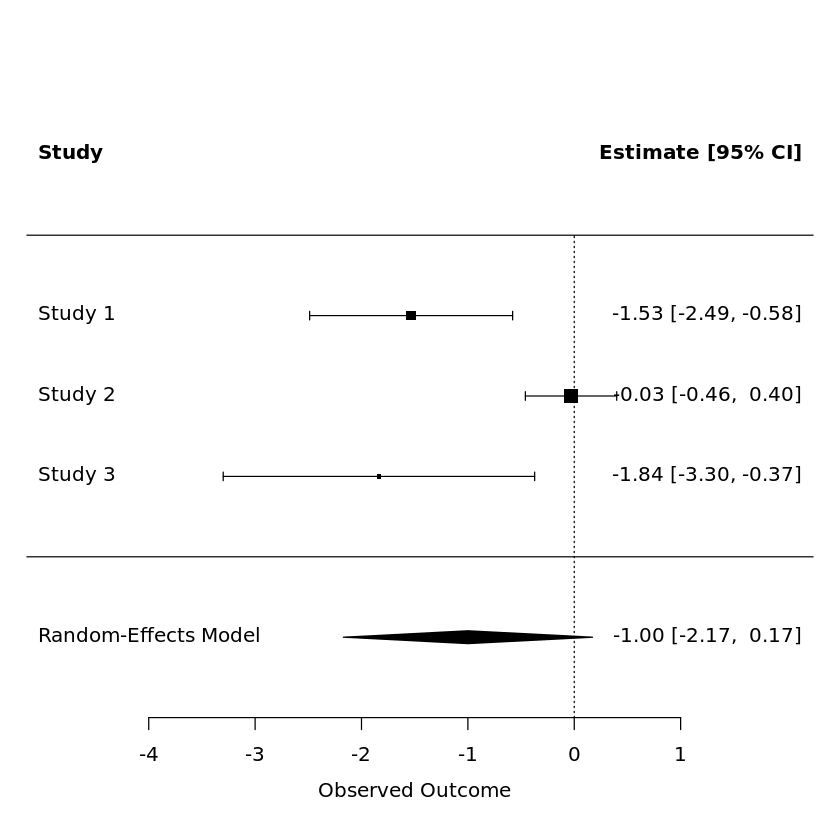

In [97]:
forest(meta_analysis)